In [22]:
import numpy as np
import os
import sys
sys.path.append(os.path.abspath('../'))
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
from IonTrace.io.coreio import EDHReader
import glob
import importlib
import seaborn as sns
import gc
from IonTrace.DataTypes import coretypes as ct
from IonTrace.Parsers.parsers import SpeedyStatSplit
from IonTrace.DataTypes import DataTypes as dt
from IonTrace.Parsers.parsers import SpikeParser
from concurrent.futures import ThreadPoolExecutor

sfm=dt.SessionFileManager()


In [3]:
# importlib.reload(ct)
# importlib.reload(dt)
# sfm=dt.SessionFileManager()


## Move the cell below to py scr

In [24]:
def select(tracefile,n_remove=1000,rank="vstep",newrank="vstepgap"):
    for v in tracefile.traverse_to_rank(rank):
        # print(v)
        try:
            v.add_child(ct.MetaSegment(start=v.start+n_remove,end=v.end,rank=newrank,parent=v))
        
        except:
            pass
        print(v.children)


from scipy import signal
def filt(current,sampling_freq,cutoff_freq,order=2,inplace=True):
    lo_end_over_Nyquist = cutoff_freq/(sampling_freq/2)

    # b,a = signal.iirfilter(forder,Wn=[lo_end_over_Nyquist],btype="lowpass",ftype="bessel",output="ba",analog=False)

    b,a = signal.bessel(order,Wn=[lo_end_over_Nyquist],btype="lowpass",output="ba",analog=False,norm='mag')
    if inplace:
        current[:]=signal.filtfilt(b,a,current,axis=0)
        return
    else: 
        return signal.filtfilt(b,a,current,axis=0)
def filt_butter(current,sampling_freq,cutoff_freq,order=2,inplace=True):
    sos=signal.butter(order,cutoff_freq,btype="lowpass",analog=False,output='sos',fs=sampling_freq)
    if inplace:
        current[:]=signal.sosfiltfilt(sos,current,axis=0)
        return
    else: 
        return signal.sosfiltfilt(sos,current,axis=0)
def notch(current,sampling_freq,low_freq,high_freq,order,inplace=True):
    lo_end_over_Nyquist = low_freq/(sampling_freq/2)
    hi_end_over_Nyquist = high_freq/(sampling_freq/2)
    b,a = signal.iirfilter(order,Wn=[lo_end_over_Nyquist,hi_end_over_Nyquist],btype="bandstop",ftype="bessel",output="ba",analog=False)
    if inplace:
        current[:]=signal.filtfilt(b,a,current,axis=0)
    else:
        return signal.filtfilt(b,a,current,axis=0)

In [27]:
def folder_size(directory):
    size=0
    for path, dirs, files in os.walk(directory):
        for f in files:
            fp = os.path.join(path, f)
            size += os.stat(fp).st_size
    return size

size_threshold=30e6 #drop files under 30MB


root_directory=r"OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR"
# files=glob.glob(root_directory+'\\'+'8e4_1u1[1-9]*SATBead*x[0-1]_*\*[0-9].edh')
# files=glob.glob(root_directory+'\\'+'8e4_1u3[0-9]*SplusNminus_F45*\*.edh')
files=glob.glob(root_directory+'\\'+'8e7_80n1[1-9]*AAV2*\*.edh')
sizes=[folder_size(os.path.dirname(fname)) for fname in files]

large_enough_files=[]
for fname in files:
    s=folder_size(os.path.dirname(fname))
    if s>size_threshold:
        large_enough_files.append(fname)


# for fname,size in zip(files,sizes):
#     print(fname.split("\\")[-2],size,"<"*(int(size<30e6)*10))


print(len(files),len(large_enough_files))


# large_enough_files.pop(-1)
# large_enough_files.pop(1)

print(*large_enough_files,sep='\n')

0 0



In [21]:

def plot_events(tf,save_to=None,file=None):
    plt.ioff()
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.401<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40 and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=2
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    plt.figure(figsize=(4,5),dpi=250)
    x=-1
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            # if np.isclose(segment.get_feature('voltage'), -0.1, rtol=1e-05, atol=1e-08, equal_nan=False):
            #     x+=1
            # if x==0:
            plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
            # plt.plot(t+x*length,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.2)
            
            plt.plot(t,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.2)
            
                
            # plt.scatter()
            idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
                try:
                    # t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start+x*length
                    t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start
                    peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
                    plt.scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='r',s=1.5)
                    
                except: 
                    pass
                
                t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start
                
                # t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start+x*length
                
                peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
                plt.scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=1.5)
                # plt.text(t_rel_1[0],1e9*peak_vals_1[0],f"{segment.std*1e9:.3g}")
            x+=1
            if x>5:
                break
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
    plt.title(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
    
    # plt.savefig("\\export_example_traces_T317M2.svg",bbox_inches="tight")
    if save_to:
        try:
            os.mkdir(save_to)
        except FileExistsError:
            pass
        # print(os.path.join(save_to,os.path.split(file)[-2]+'.png'))
        plt.savefig(os.path.join(save_to,os.path.split(os.path.split(file)[0])[-1]+'monorun.png'),bbox_inches="tight")


In [11]:

def plot_events(tf,save_to=None,file=None,tlim=200):
    plt.ioff()
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.401<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40 and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=2
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    plt.figure(figsize=(9,6),dpi=250)
    x=-1
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=1
            if x==0:
                plt.text(0,segment.mean*1e9-3 , f"{segment.get_feature('voltage')*1000:.0f} mV")
            plt.plot(t+x*length,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.2)
            
                
            # plt.scatter()
            idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
                try:
                    t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start+x*length
                    peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
                    plt.scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='r',s=1.5)
                    
                except: 
                    pass
                
                t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start+x*length
                
                peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
                plt.scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=1.5)
                # plt.text(t_rel_1[0],1e9*peak_vals_1[0],f"{segment.std*1e9:.3g}")
            x+=1
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
        if segment.t[0]>tlim:
            break
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
    plt.title(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
    
    # plt.savefig("\\export_example_traces_T317M2.svg",bbox_inches="tight")
    if save_to:
        try:
            os.mkdir(save_to)
        except FileExistsError:
            pass
        # print(os.path.join(save_to,os.path.split(file)[-2]+'.png'))
        plt.savefig(os.path.join(save_to,os.path.split(os.path.split(file)[0])[-1]+'.png'),bbox_inches="tight")


In [12]:
## Multi threaded approach for parsing files
def worker_process_file(file,save_to="VLP_paper_exports/pickled_aav_events",plot=True):
    print(file)
    metadata,current,voltage=EDHReader().read(file,voltage_compress=True)
    tf=dt.TraceFile(current,voltage,parent=sfm,metadata=metadata,
                         unique_features={"sampling_freq":metadata["Sampling frequency (SR)"]})
    
    filt_butter(tf.current[:],200000,20000,8)
    select(tf,n_remove=4000)
    
    for step in tf.traverse_to_rank('vstepgap'):
        
        # parser_params={"height":(1.0,0.8),
        #        "prominence_snr":(0.002,0.2),
        #         # "prominence":(-0.012,-0.2),
        #        "width":(5e-6,5e-2),
        #        "distance":200e-6
        #        }
        p2p_samples=100
        p2p_count=35
        p2p_multiplier=2.5
        # if "1u25" in tf.get_feature('metadata')["HeaderFile"]:
        #     p2p_multiplier=2
        iticks=np.linspace(0,len(step.current),p2p_count).astype(int)
        p2p_arr=np.array([np.max(step.current[ii:jj])-np.min(step.current[ii:jj]) for ii,jj in zip(iticks[:-1],iticks[:-1]+p2p_samples)])
        p2p_thresh=np.quantile(p2p_arr,q=0.5)*p2p_multiplier
        # print(p2p_thresh)
        parser_params={
               "prominence":(p2p_thresh,12e-9),
                # "prominence":(-0.012,-0.2),
               "width":(5e-6,5e-2),
               "distance":200e-6,
               "fractional":False
               }
        step.clear_children()
        parser=SpikeParser(**parser_params)
        
        # if -0.41<step.get_feature('voltage')<-0.19 and step.std<2.2e-9:
            
        if -0.401<step.get_feature('voltage')<-0.024 and step.std<0.6e-9:
            try:
                step.parse(parser,newrank="event")
            except AssertionError:
                pass
        
    if plot:
        plot_events(tf,save_to,file)
    
    
    feature_list=['voltage','deli','dwell','dt','peak_val']

    # selection=[step for step in tf.traverse_to_rank("vstepgap") if -0.41<=step.get_feature("voltage")<=-0.099 and 4.5<step.duration<40.1]
    _d={key: [] for key in feature_list+['file','dil','frac','tpeak','baseline','baseline_std','step_id','deli_to_avg']}
    for i,vstep in enumerate (tf.children):
        for event in vstep.traverse_to_rank('event'):
            if event.get_feature("deli")>0.35e-9:
                try:
                    idx_rel=event.get_feature('idx_rel')
                    
                    _d["tpeak"].append(event.parent.t[idx_rel])
                    for feature in feature_list:
                        _d[feature].append(event.get_feature(feature))
                    _d['baseline'].append(np.median(np.concatenate([event.parent.current[idx_rel-230:idx_rel-30],event.parent.current[idx_rel+30:idx_rel+230]])))
                    _d['baseline_std'].append(np.std(np.concatenate([event.parent.current[idx_rel-230:idx_rel-30],event.parent.current[idx_rel+30:idx_rel+230]])))
                    _d['deli_to_avg'].append(_d["peak_val"][-1]-_d['baseline'][-1])
                    _d["frac"].append(-_d["deli_to_avg"][-1]/_d['baseline'][-1])
                    _d["step_id"].append(i)
                except Exception as e:
                    print(e)
    _d["file"]=(tf.get_feature('metadata')["HeaderFile"])
    _d["dil"]=_d["file"].split("\\")[-1].split('.')[0].split('x')[-1].replace('_','.')
    df=pd.DataFrame(_d)
    df['voltage']= df['voltage'].round(3)

    df["pore_id"]=df["file"].apply(lambda x: "".join(x.split('\\')[-2].split('_')[0:2]))
    df["chip_id"]=df["pore_id"].apply(lambda x: x.split("M")[0])
    tf.delete()
    del current,voltage,metadata
    if save_to:
        try:
            os.mkdir(save_to)
        except FileExistsError:
            pass
        print(os.path.join(save_to,os.path.split(os.path.split(file)[0])[-1]+'.pkl'))
        df.to_pickle(os.path.join(save_to,os.path.split(os.path.split(file)[0])[-1]+'.pkl'))

# res=worker_process_file(large_enough_files[10])
# print(res.head())
# print(res.tail())

    

In [13]:
%%time
plt.close('all')
with ThreadPoolExecutor(max_workers=3) as executor:
    future = executor.map(worker_process_file, large_enough_files)
plt.close('all')
plt.ion()

CPU times: user 9.53 ms, sys: 14.8 ms, total: 24.3 ms
Wall time: 551 ms


In [14]:
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
# matplotlib.rcParams['ps.fonttype'] = 42
plt.rcParams["pdf.use14corefonts"] = False
plt.rcParams["font.family"]=["Arial"]
plt.rcParams["ps.useafm"] = True
plt.rcParams["figure.dpi"]=150

In [16]:
# master_df=pd.concat ([pd.read_pickle(picklefname) for picklefname in glob.glob(r'VLP_paper_exports\pickled_virus_events\*.pkl')],ignore_index=True)
# master_df=pd.concat ([pd.read_pickle(picklefname) for picklefname in glob.glob(r'VLP_paper_exports\pickled_virus_events\*PVDF*.pkl')],ignore_index=True)

master_df=pd.concat([pd.read_pickle(picklefname) for picklefname in glob.glob(r'VLP_paper_exports\pickled_aav_events\*.pkl')],ignore_index=True)
master_df["vlp_type"]="AAV2GC"
# master_df.loc[master_df["file"].apply(lambda x: "FSBSATBead" in x.split('\\')[-2]),"vlp_type"]="S-VLP"
master_df['Voltage (V)']=(master_df['voltage'].round(3)).astype(str)
master_df.head()
master_df["vlp_type"]="AAV2GC"
# master_df.loc[master_df["file"].apply(lambda x: "FSBSATBead" in x.split('\\')[-2]),"vlp_type"]="S-VLP"
master_df['Voltage (V)']=(master_df['voltage'].round(3)).astype(str)
master_df.head()

ValueError: No objects to concatenate

In [17]:
master_df.pore_id.unique()

NameError: name 'master_df' is not defined

In [207]:
concentration_df=pd.read_pickle("VLP_paper_exports\stock_concentrations\concentration_of_stocks_24-1-20.pkl")

# master_df.chip_id.unique()
master_df["Dilution"] = master_df["dil"].astype(float)
master_df["stock_concentration"]=1
for (chip_id,dilution), _dfconc in concentration_df.groupby(["chip","run_id"]):
    if chip_id:
        # print(chip_id,dilution,_dfconc["Concentration"].values[0])
        master_df.loc[(master_df["chip_id"]==chip_id)&(master_df["Dilution"]==float(dilution)),  "stock_concentration"]=_dfconc["Concentration"].values[0]

# concentration_df.head(30)
master_df.loc[(master_df["chip_id"]=="8e41u19") & (master_df["Dilution"]==1.0),'stock_concentration']=concentration_df.loc[concentration_df['chip']=='8e41u19',"Concentration"].values[0]*10
# print(*master_df.stock_concentration.unique(),sep='\n')
concentration_df.head(30)
    

dilution_factor  volume  \
stock_id       pore_id            run_id                            
FBSATBead1102  stock_F1110        0.022             0.010     1.0   
                                  0.046             0.010     1.0   
                                  0.100             0.010     1.0   
                                  0.220             0.001     1.0   
                                  0.460             0.001     1.0   
                                  1.000             0.001     1.0   
FBSATBead1114  stock_F1128        0.100             0.010     1.0   
               stock_F1201        0.100             0.001     1.0   
               stock_F1201_PL1216 0.100             0.010     1.0   
FBSATBead1219  Stock_F0104        1.000             0.002     1.0   
               Stock_F0108        0.400             0.002     1.0   
FSBSATBead1205 Stock_F1207        0.100             0.010     1.0   
               Stock_F1216        0.200             0.010     1.0   
FSBSATBead1219 Stock_F0104        0.400             0.005     1.0   
               Stock_F0112        0.500             0.002     1.0   
               Stock_F1220        0.300             0.005     1.0   

                                           blob_count  blob_per_area  \
stock_id       pore_id            run_id                               
FBSATBead1102  stock_F1110        0.022    342.333333     750.949038   
                                  0.046   1013.666667    2223.598856   
                                  0.100   2068.333333    4537.136107   
                                  0.220         341.0     748.024212   
                                  0.460    802.666667    1760.745164   
                                  1.000   1786.333333    3918.535439   
FBSATBead1114  stock_F1128        0.100   1978.666667    4340.441568   
               stock_F1201        0.100    165.666667     363.409612   
               stock_F1201_PL1216 0.100         810.0    1776.831707   
FBSATBead1219  Stock_F0104        1.000    947.333333     2078.08877   
               Stock_F0108        0.400   1128.333333    2475.133879   
FSBSATBead1205 Stock_F1207        0.100         699.0    1533.339954   
               Stock_F1216        0.200    754.666667    1655.451434   
FSBSATBead1219 Stock_F0104        0.400    436.666667     957.880467   
               Stock_F0112        0.500    941.333333    2064.927053   
               Stock_F1220        0.300   1409.666667    3092.272135   

                                          log_per_area        Concentration  \
stock_id       pore_id            run_id                                      
FBSATBead1102  stock_F1110        0.022       2.875608   17375671286.533607   
                                  0.046       3.347054   51984194205.161911   
                                  0.100       3.656779  106792980544.231766   
                                  0.220       2.873911   173072689774.52121   
                                  0.460        3.24569   410717676555.69165   
                                  1.000       3.593091  920977686577.673096   
FBSATBead1114  stock_F1128        0.100       3.637532  102120361988.440613   
               stock_F1201        0.100       2.560347   83499342072.611343   
               stock_F1201_PL1216 0.100       3.249625   41449194861.249695   
FBSATBead1219  Stock_F0104        1.000       3.317603   242722704488.57309   
               Stock_F0108        0.400       3.393411   289493895384.42572   
FSBSATBead1205 Stock_F1207        0.100       3.185626   35719732174.599495   
               Stock_F1216        0.200       3.218902   38592293209.244499   
FSBSATBead1219 Stock_F0104        0.400       2.981287   44427914589.368149   
               Stock_F0112        0.500       3.314895  241199984047.594299   
               Stock_F1220        0.300       3.490251  145031089421.213043   

                                             chip  
stock_id       pore_id     

In [46]:
i=0
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
# matplotlib.rcParams['ps.fonttype'] = 42
plt.rcParams["pdf.use14corefonts"] = False
plt.rcParams["font.family"]=["Arial"]
plt.rcParams["ps.useafm"] = True
plt.rcParams["figure.dpi"]=150
plt.close('all')
plt.ioff()
for file,_df in master_df.groupby("file"):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(4,4))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli_to_avg"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    # print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(15,5000)
    # plt.xlim(0.02e-9,0.5e-9)
    plt.ylim(0.1,4)
    plt.xscale('log')
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    plt.title(os.path.split(file)[-1])
    root_path='VLP_paper_exports/pickled_aav_events'
    destination=root_path+'/scatter'
    try:
        os.mkdir(destination)
    except FileExistsError:
        pass
    plt.savefig(os.path.join(destination,os.path.split(os.path.split(file)[0])[-1]+'.png'),bbox_inches="tight")
    
    i+=1
    # if i>8:
    #     break
plt.close('all')
plt.ion()

In [47]:
i=0
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
# matplotlib.rcParams['ps.fonttype'] = 42
plt.rcParams["pdf.use14corefonts"] = False
plt.rcParams["font.family"]=["Arial"]
plt.rcParams["ps.useafm"] = True
plt.rcParams["figure.dpi"]=150
plt.close('all')
plt.ioff()
for file,_df in master_df.groupby("file"):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(4,3.25))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli_to_avg"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    # print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='frac',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.ylabel("Fractional Blockade")
    plt.xlim(20,1200)
    # plt.xlim(0.02e-9,0.5e-9)
    plt.ylim(0.002,0.15)
    plt.xscale('log')
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    plt.title(os.path.split(file)[-1])
    root_path='VLP_paper_exports/pickled_aav_events'
    destination=root_path+'/scatter_fractional'
    try:
        os.mkdir(destination)
    except FileExistsError:
        pass
    plt.savefig(os.path.join(destination,os.path.split(os.path.split(file)[0])[-1]+'.png'),bbox_inches="tight")
    
    i+=1
    # if i>8:
    #     break
plt.close('all')
plt.ion()

In [66]:
plt.ion()


['-0.4']
['-0.35']
['-0.3']
['-0.25']
['-0.2']


['-0.4']
['-0.35']
['-0.3']
['-0.25']
['-0.2']


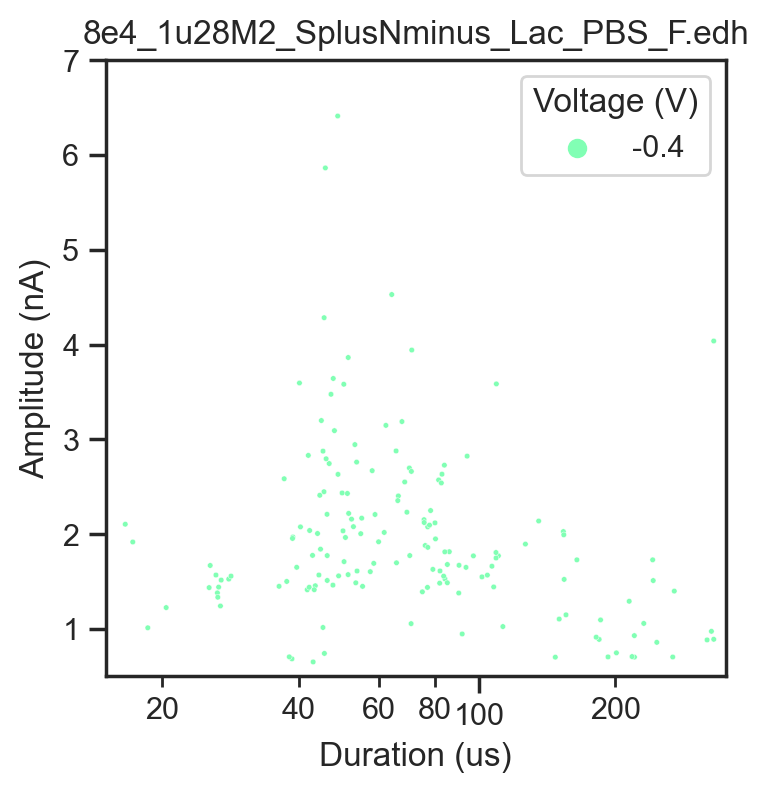

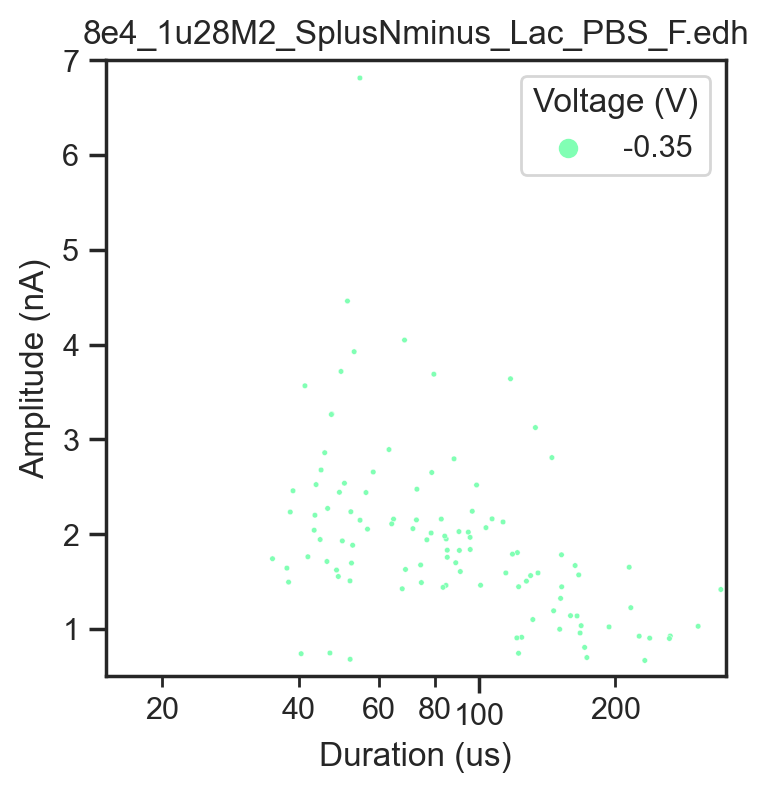

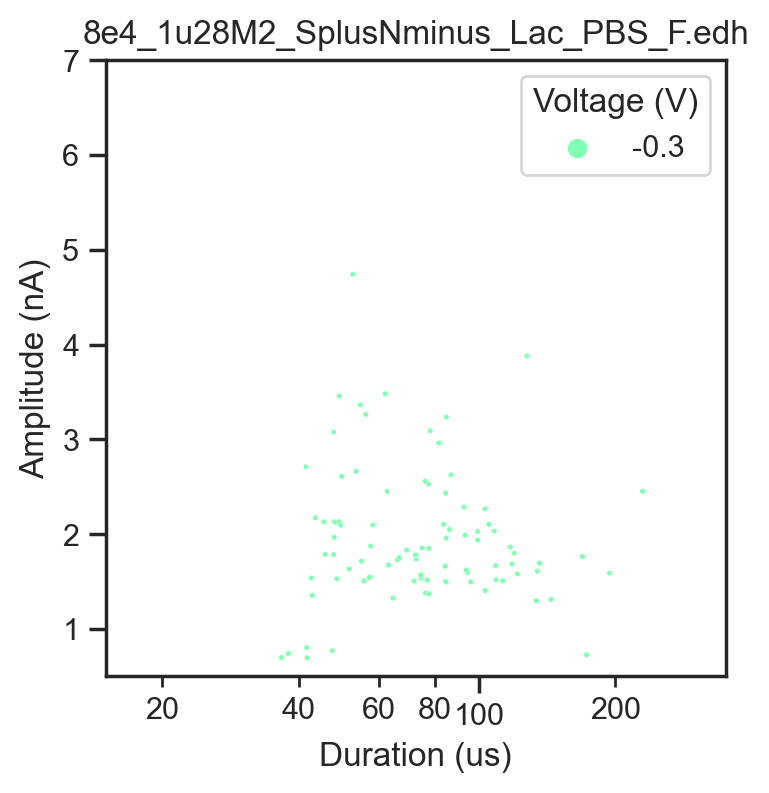

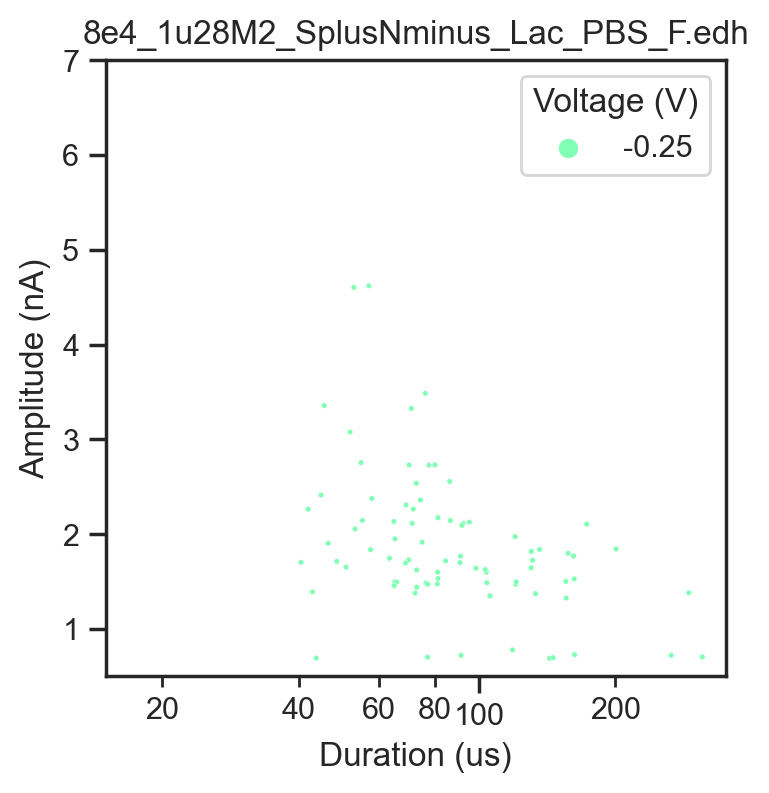

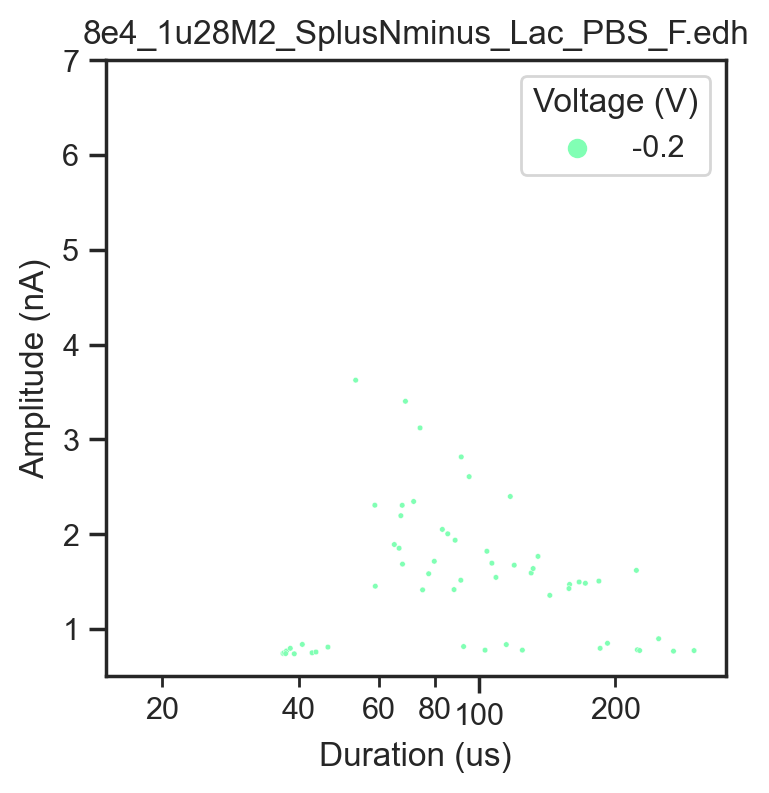

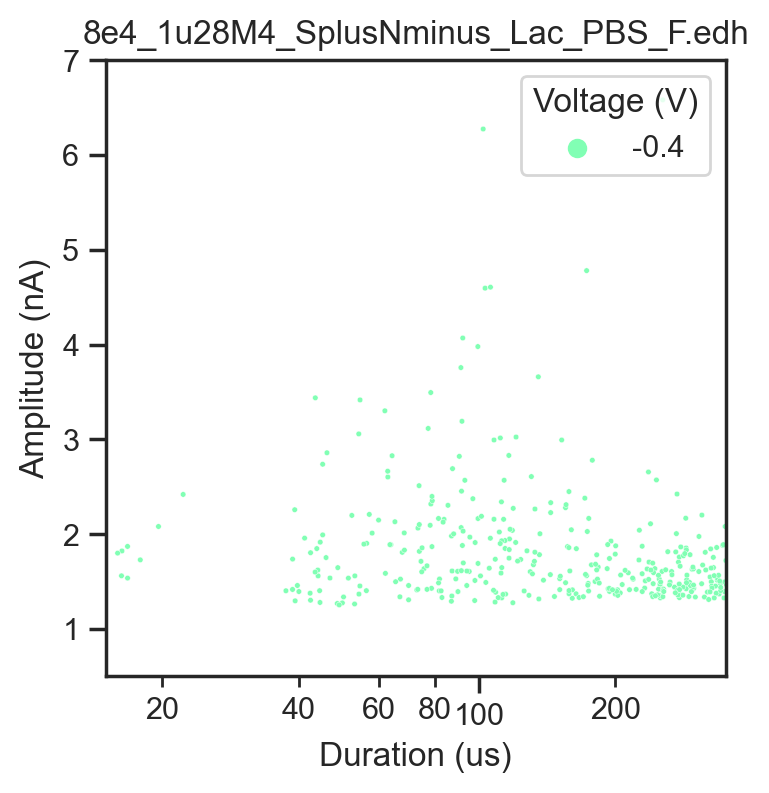

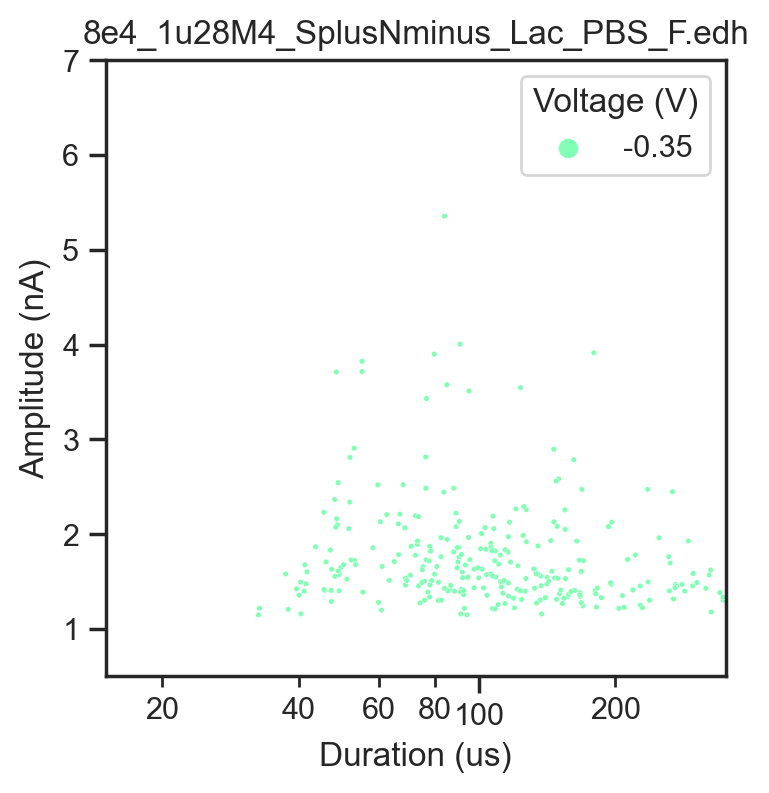

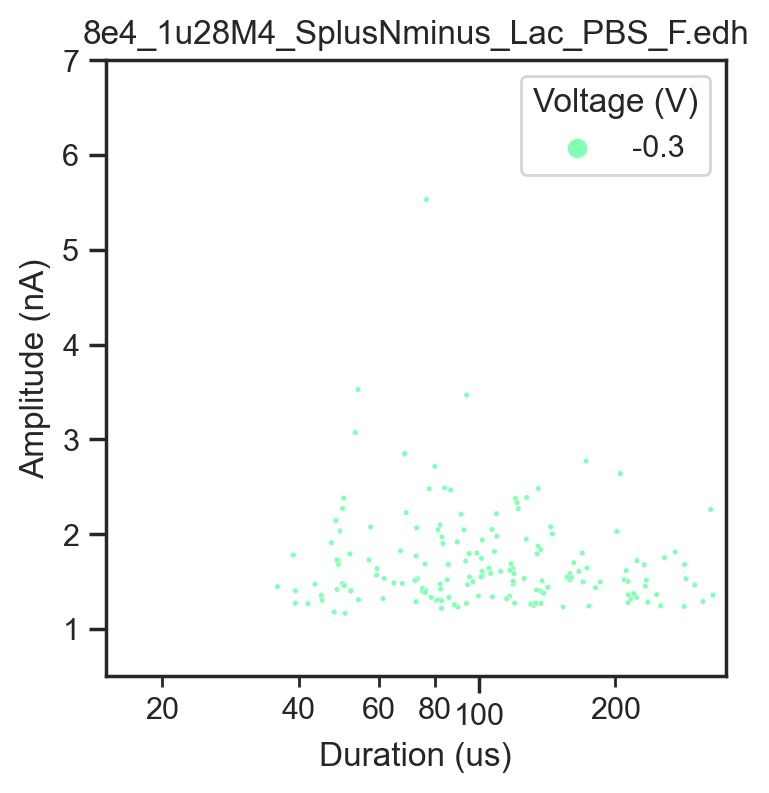

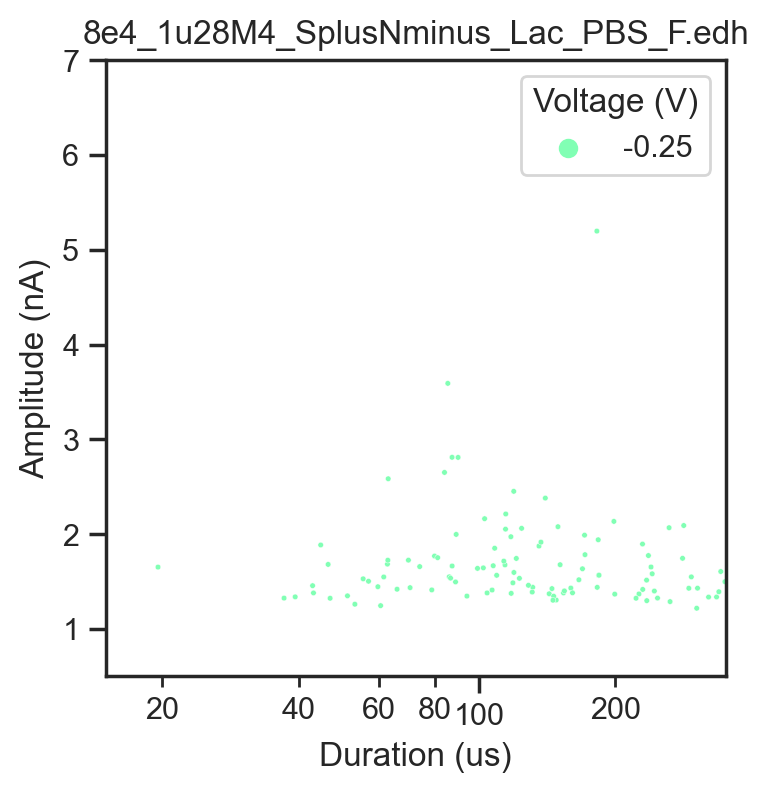

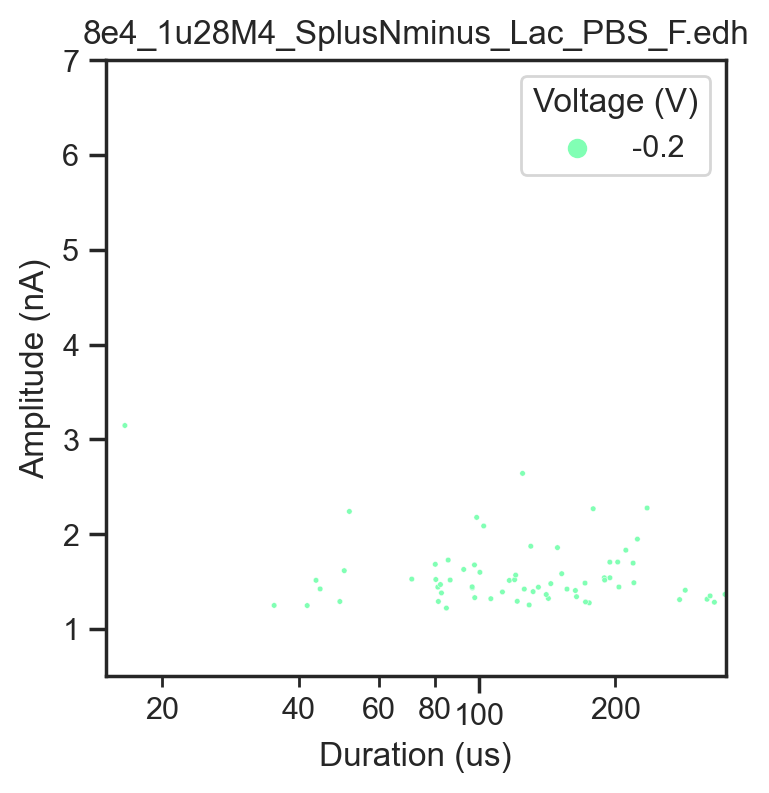

In [21]:
for (file,voltage),_df in master_df.groupby(["file",'voltage']):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(4,4),dpi=200)
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=4,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(15,350)
    # plt.xlim(0.02e-9,0.5e-9)
    plt.ylim(0.5,7)
    plt.xscale('log')
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    plt.title(os.path.split(file)[-1])


['-0.4']


TypeError: expected str, bytes or os.PathLike object, not float

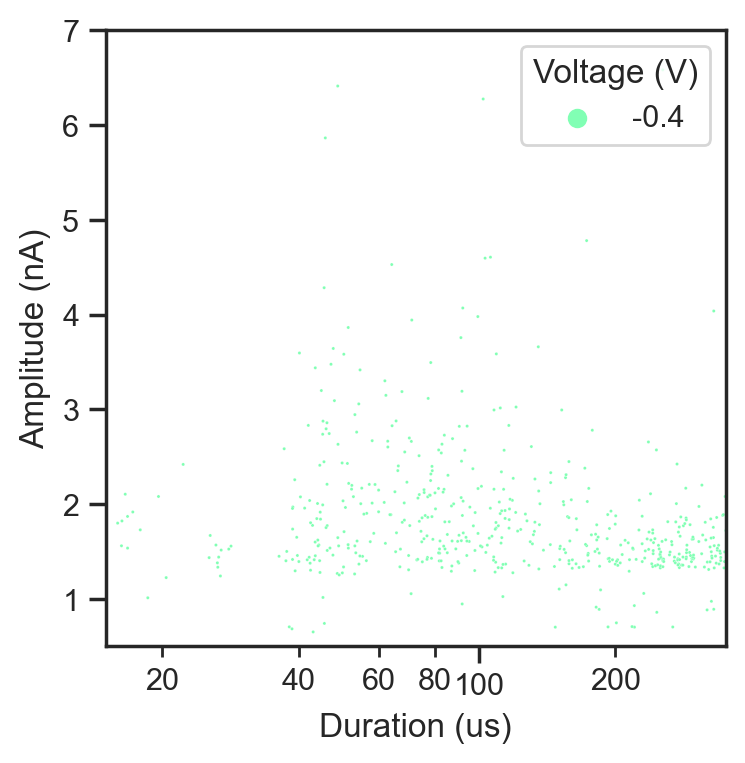

In [19]:
for file,_df in master_df.groupby("file"):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(4,4),dpi=200)
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(15,350)
    # plt.xlim(0.02e-9,0.5e-9)
    plt.ylim(0.5,7)
    plt.xscale('log')
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    plt.title(os.path.split(file)[-1])



C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3380930887.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3380930887.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3380930887.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3380930887.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3380930887.py:13: OptimizeWarning:

[]

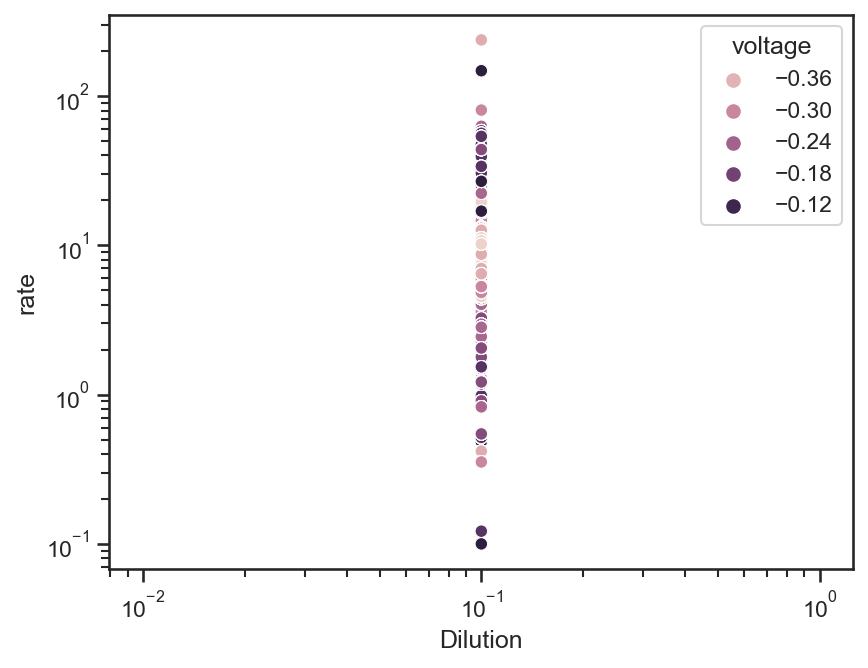

In [50]:
from scipy.optimize import curve_fit
def single_exp(t,A,Rt):
    return A*np.exp(-Rt*t)
def linear(t,B,Rt):
    return B-Rt*t
def single_exponential_fit(x_data,y_data):
    r=np.argwhere(y_data==0)
    if len(r)==0:
        r=len(y_data)
    else:
        r=r.ravel()[0]
    # print(r)
    popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
    popt[0]=np.exp(popt[0])
    return popt

# ax=sns.histplot(data=_df,hue="Voltage (V)",hue_order=hueorder,x="dt",stat="proportion",common_norm=False,palette="rainbow",element="poly",
#              binwidth=0.004,binrange=(0,0.1),fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)



#     y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=True)
#     y_vals/=np.sum(y_vals)
#     x_vals=bin_edges[:-1]+(binwidth/2)
    
bin_count=11  

i=0
for file,_df in master_df.groupby("file"):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    # plt.figure(figsize=(4,4),dpi=200)
    
    
    
    
    for step_id, _dfs in _df.groupby("step_id"):
        dt_values=_dfs['dt'].values
        dt_median=np.median(dt_values)
        if dt_median>0.1:
            bin_range=(0,0.9)
        elif dt_median>0.02:
            bin_range=(0,0.3)
        elif dt_median>0.007:
            bin_range=(0,0.05)
        else:
            bin_range=(0,0.02)
        # print(f"{dt_median:.3g}", bin_range)
        y_vals,bin_edges=np.histogram(dt_values,bins=bin_count,range=bin_range)
        y_vals=y_vals/np.sum(y_vals)
        bin_width=bin_edges[1]-bin_edges[0]
        x_vals=bin_edges[:-1]+(bin_width/2)
        
        popt=single_exponential_fit(x_vals,y_vals)
        # print(popt)
        _df.loc[_dfs.index,'rate']=popt[1]
        
        # plt.figure(figsize=(4,4),dpi=200)
        # plt.semilogy(x_vals,y_vals,'kx',label="Histogram")
        # plt.semilogy(x_vals,single_exp(x_vals,*popt))
        
    # print(_df['rate'].unique())
    
    # print(_df.groupby("voltage")["rate"].median())
    master_df.loc[_df.index,'rate']=_df['rate']
    i+=1
    # if i>30:
    #     break
plt.figure()


sns.scatterplot(master_df,x='Dilution',y='rate',hue="voltage")
plt.loglog()

    
    # _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    # _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    # _df['Amplitude (nA)']=1e9*_df["deli"]

['-0.1' '-0.15' '-0.2' ... '-0.3' '-0.35' '-0.4']


C:\Users\alito\AppData\Local\Temp\ipykernel_36136\556663841.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\556663841.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\556663841.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\556663841.py:13: OptimizeWarning: Covariance of the parameters could not be estimated
  popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))


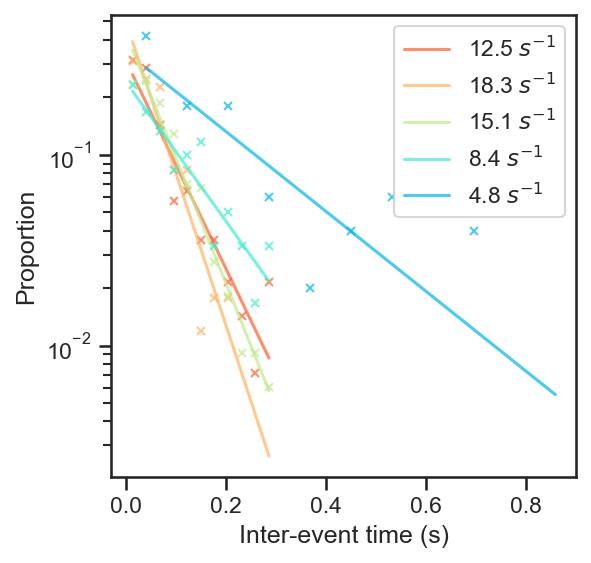

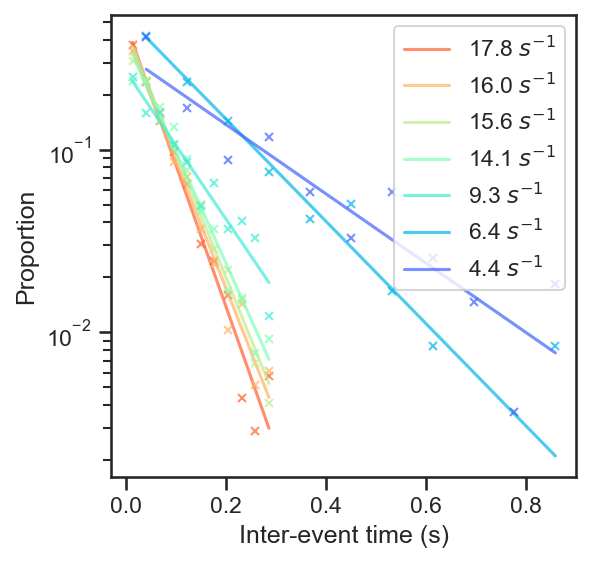

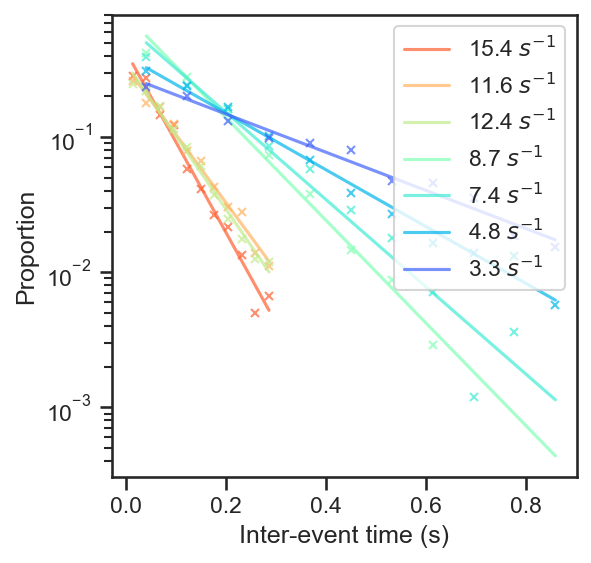

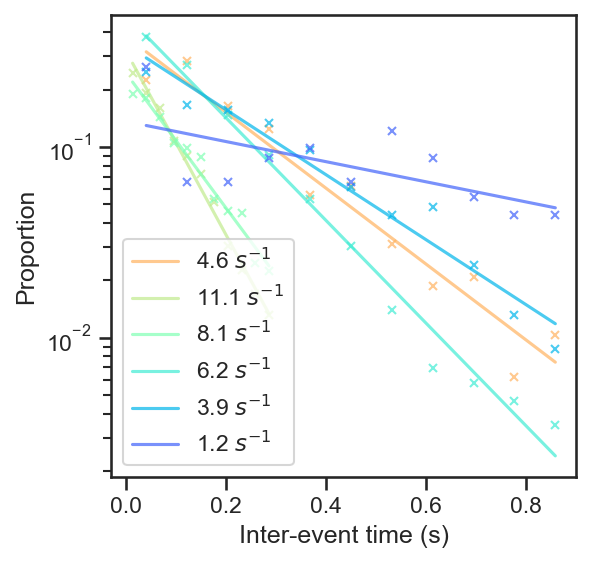

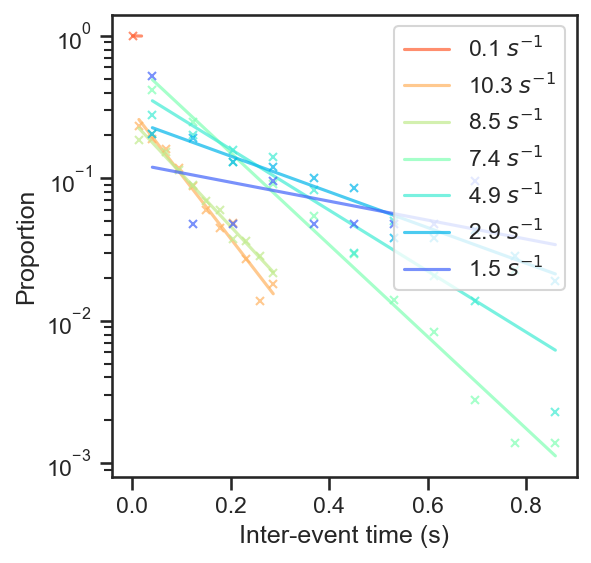

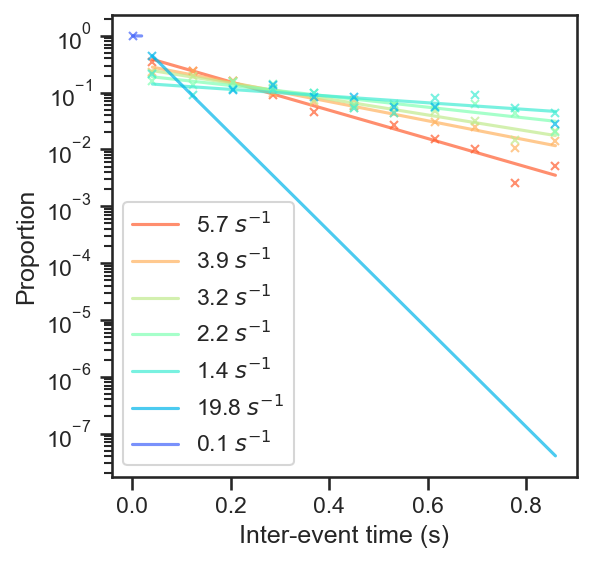

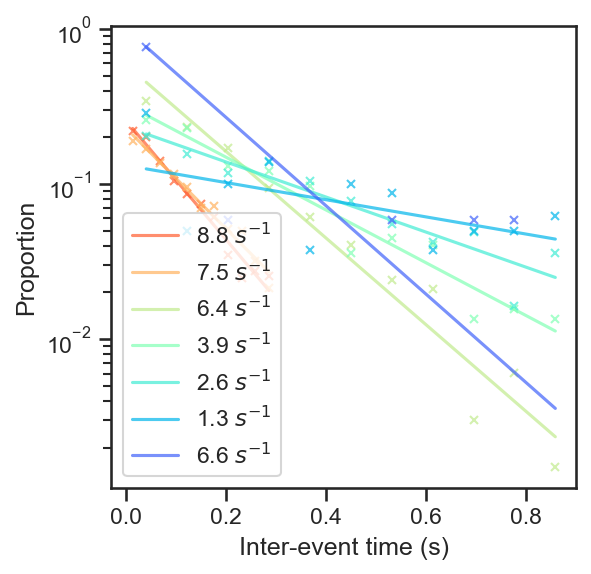

In [51]:
from scipy.optimize import curve_fit
def single_exp(t,A,Rt):
    return A*np.exp(-Rt*t)
def linear(t,B,Rt):
    return B-Rt*t
def single_exponential_fit(x_data,y_data):
    r=np.argwhere(y_data==0)
    if len(r)==0:
        r=len(y_data)
    else:
        r=r.ravel()[0]
    # print(r)
    popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-5,0.1],[0,2000]))
    popt[0]=np.exp(popt[0])
    return popt

# ax=sns.histplot(data=_df,hue="Voltage (V)",hue_order=hueorder,x="dt",stat="proportion",common_norm=False,palette="rainbow",element="poly",
#              binwidth=0.004,binrange=(0,0.1),fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)



#     y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=True)
#     y_vals/=np.sum(y_vals)
#     x_vals=bin_edges[:-1]+(binwidth/2)
    
bin_count=11  
print(hueorder)
i=0
for file,_df in master_df.groupby("file"):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")

    plt.figure(figsize=(4,4))
    
    for step_id, _dfs in _df.groupby("voltage"):
        dt_values=_dfs['dt'].values
        dt_median=np.median(dt_values)
        if dt_median>0.1: 
            bin_range=(0,0.9)
        elif dt_median>0.02:
            bin_range=(0,0.3)
            # bin_range=(0,0.15) ##just for show, the bin ranges are made the same here. the actual rates are calculated with more careful binning in another block
        elif dt_median>0.007:
            # bin_range=(0,0.05)
            bin_range=(0,0.15)
        else:
            bin_range=(0,0.02)
            
        y_vals,bin_edges=np.histogram(dt_values,bins=bin_count,range=bin_range)
        y_vals=y_vals/np.sum(y_vals)#len(dt_values)
        bin_width=bin_edges[1]-bin_edges[0]
        x_vals=bin_edges[:-1]+(bin_width/2)
        
        ax=sns.histplot(data=_dfs,hue="Voltage (V)",hue_order=hueorder,x="dt",stat="proportion",common_norm=False,palette="rainbow",element="poly",
             binwidth=bin_width,binrange=bin_range,fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)
        
        # print(f"{dt_median:.3g}", bin_range)
        
        popt=single_exponential_fit(x_vals,y_vals)
        # print(popt)
        # _df.loc[_dfs.index,'rate']=popt[1]
        
        # plt.figure(figsize=(4,4),dpi=200)
        # sns.histplot()
        # plt.semilogy(x_vals,y_vals,'x',label="Histogram")
        # plt.semilogy(x_vals,)
        
        hists=ax.get_lines()[::-1]
        c=hists[0].get_color()
        ax.plot(x_vals,single_exp(x_vals,*popt),c=c ,label=f"{popt[1]:.1f}"+r" $ s^{-1}$")
    plt.legend()
    plt.title(f"")
    root_path='VLP_paper_exports/pickled_aav_events'
    destination=root_path+'/interevent_hist_for_show'
    try:
        os.mkdir(destination)
    except FileExistsError:
        pass
    plt.xlabel('Inter-event time (s)')
    plt.savefig(os.path.join(destination,os.path.split(os.path.split(file)[0])[-1]+'.png'),bbox_inches="tight")
    
    
    
    # plt.savefig(f"VLP_paper_exports\pickled_virus_events\interevent_hist_for_show\{_df.pore_id.unique()[0]} {_df.Dilution.unique()[0]}.pdf")
    # ax=sns.histplot(data=_df,hue="Voltage (V)",hue_order=hueorder,x="dt",stat="proportion",common_norm=False,palette="rainbow",element="poly",
        # binwidth=0.004,binrange=(0,0.1),fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)
    # print(_df['rate'].unique())
    
    
    # print(_df.groupby("voltage")["rate"].median())
    # master_df.loc[_df.index,'rate']=_df['rate']
    
    i+=1
    # if i>3:
    #     break



C:\Users\alito\AppData\Local\Temp\ipykernel_36136\593089191.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ratedf.loc[_rdf.index,"rate_median"]=med
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\593089191.py:31: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\593089191.py:33: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="crest")


,voltage,file,dil,baseline,pore_id,chip_id,vlp_type,Voltage (V),Dilution,rate_median
0,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.208637e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
1,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.209875e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
2,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.213104e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
3,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.208949e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
4,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.204760e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
5,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.213543e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
6,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.202627e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
7,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.215880e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
8,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.211806e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456
9,-0.3,c:\Users\alito\OneDrive - Northeastern Univers...,0.1,-1.210380e-07,8e780n11M2,8e780n11,AAV2GC,-0.3,0.1,14.24456


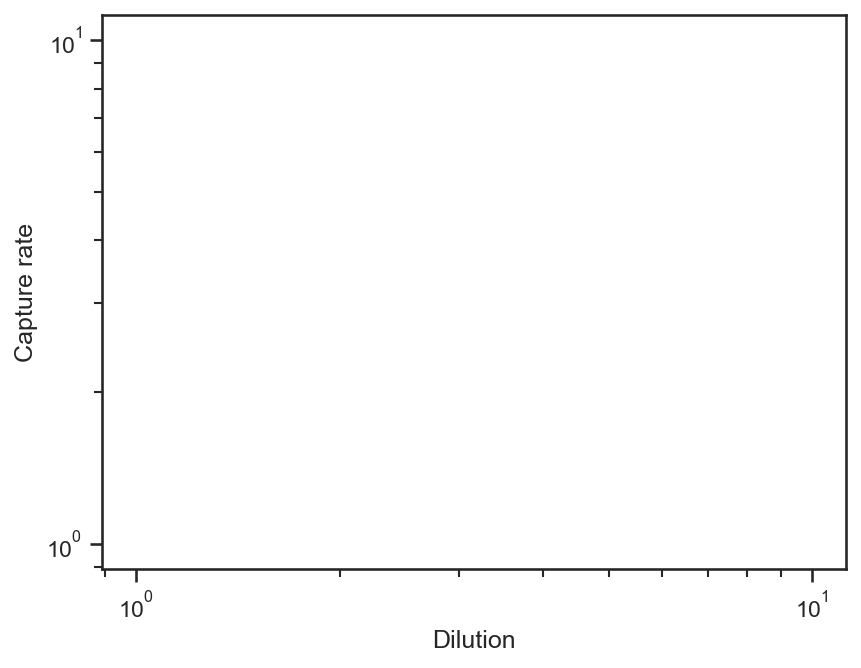

In [52]:
# for pore_id, _df in master_df.groupby(["pore_id","dil"]):
    # print()
    # print(pore_id)

tempdf=master_df.drop(columns=["frac","deli","deli_to_avg","dt","tpeak","baseline_std","dwell","peak_val"]).copy()




ratedf=tempdf.drop_duplicates(ignore_index=True)
for gp, _rdf in ratedf.groupby(["pore_id","Dilution","voltage"],as_index=False):
    med=_rdf["rate"].median()
    ratedf.loc[_rdf.index,"rate_median"]=med
    


ratedf=ratedf.drop(columns=["step_id","rate"])
ratedf=ratedf.drop_duplicates(ignore_index=True)
# ratedf["median_rate"]=ratedf["
# ratedf=ratedf.groupby(["pore_id","Dilution"])


# ratedf=tempdf.groupby(["pore_id","dil","voltage"])
# ratedf.head()
ratedf=ratedf.loc[ratedf["rate_median"]>1]

ratedf=ratedf.loc[(ratedf["pore_id"]!="8e41u14M1") & (ratedf["pore_id"]!="8e41u14M3")]
ratedf=ratedf.loc[ratedf["chip_id"]!="8e41u25"]

# sns.lineplot(ratedf.loc[ratedf["chip_id"]=='8e41u14'],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")
sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="crest")
plt.ylabel("Capture rate")
plt.xlabel("Dilution")
plt.loglog()
ratedf.head(24)


In [512]:

sns.reset_defaults()
%matplotlib inline

In [53]:

tempdf=master_df.drop(columns=["frac","deli","deli_to_avg","dt","tpeak","baseline_std","dwell","peak_val"]).copy()
for group,_df in tempdf.groupby(["pore_id","Dilution","voltage","step_id"]):
    tempdf.loc[_df.index,"baseline_step_median"]=_df["baseline"].median()
tempdf=tempdf.drop(columns=['baseline'])

sratedf=tempdf.drop_duplicates(ignore_index=True)
# for gp, _rdf in ratedf.groupby(["pore_id","Dilution","stock_concentration","Voltage (V)"],as_index=False):
#     baseline=_rdf["baseline"].median()
#     ratedf.loc[_rdf.index,"baseline_median"]=baseline
    
for gp, _rdf in sratedf.groupby(["pore_id","Dilution","stock_concentration","Voltage (V)"],as_index=False):
    med=_rdf["rate"].median()
    # print(med)
    sratedf.loc[_rdf.index,"rate_median"]=med
    
    baseline_median=_rdf["baseline_step_median"].median()
    sratedf.loc[_rdf.index,"baseline_median"]=baseline_median*1e9

    
sratedf=sratedf.loc[sratedf["rate_median"]>1]
sratedf=sratedf.drop(columns=["step_id","rate","baseline_step_median"])
sratedf=sratedf.drop_duplicates(ignore_index=True)
sratedf["rate_per_unit_conc"]=sratedf["rate_median"]/sratedf["stock_concentration"]

sratedf["rate_per_current"]=sratedf["rate_median"]/np.abs(sratedf["baseline_median"])*1000
sratedf["log10_rate"]=np.log10(sratedf["rate_median"])
sratedf["log10_rate_per_current"]=np.log10(sratedf["rate_per_current"])

sratedf.head()
sratedf.to_pickle("VLP_paper_exports/pickled_events/rates/rates_for_mesh_analysis_24-1-25.pkl")

KeyError: 'stock_concentration'

c:\Users\alito\OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR\8e7_80n11M2_10xPBS_AAV2GC_x0_1\8e7_80n11M2_10xPBS_AAV2GC_x0_1.edh [96.7433 92.2861 99.7124 69.6685 91.1157]
c:\Users\alito\OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR\8e7_80n11M2_10xPBS_AAV2GC_x0_1_02\8e7_80n11M2_10xPBS_AAV2GC_x0_1.edh [91.1157 85.4858 96.7433 ... 55.8322 99.7124 69.6685]
c:\Users\alito\OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR\8e7_80n11M2_10xPBS_AAV2GC_x0_1_03\8e7_80n11M2_10xPBS_AAV2GC_x0_1.edh [99.7124 96.7433 85.4858 ... 91.1157 55.8322 92.2861]
c:\Users\alito\OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR\8e7_80n11M3_10xPBS_AAV2GC_x0_1\8e7_80n11M3_10xPBS_AAV2GC_x0_1.edh [283.0711  34.0984  62.299   68.3745  67.75    15.7927]
c:\Users\alito\OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR\8e7_80n12M1_10xPBS_AAV2GC_x0_1\8e7_80n1

C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3162332966.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ratedf.loc[_rdf.index,"rate_median"]=med
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3162332966.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ratedf.loc[_rdf.index,"baseline_median"]=baseline_median*1e9
C:\Users\alito\AppData\Local\Temp\ipykernel_36136\3162332966.py:23: FutureWarning: In a future version of pandas, a length 1 tuple will be returned when iterating over a groupby with

<Axes: xlabel='voltage', ylabel='rate_per_current'>

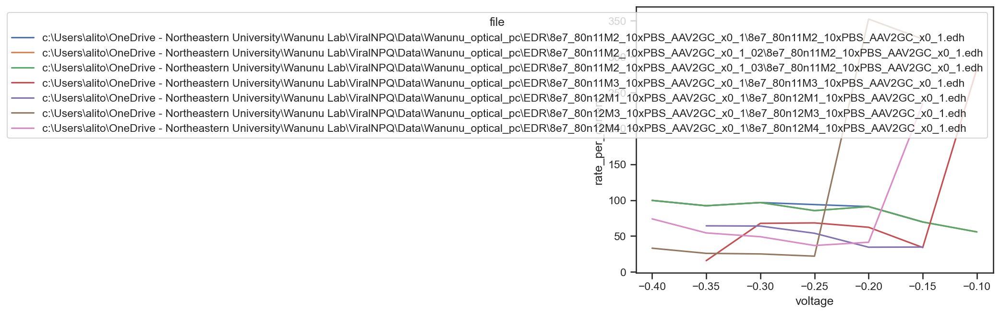

In [54]:
master_df["Dilution"]=0.1
tempdf=master_df.drop(columns=["frac","deli","deli_to_avg","dt","tpeak","baseline_std","dwell","peak_val"])
for group,_df in tempdf.groupby(["pore_id","Dilution","voltage","step_id"]):
    tempdf.loc[_df.index,"baseline_step_median"]=_df["baseline"].median()
tempdf=tempdf.drop(columns=['baseline'])

ratedf=tempdf.drop_duplicates(ignore_index=True)
for gp, _rdf in ratedf.groupby(["pore_id","Dilution","Voltage (V)"],as_index=False):
    med=_rdf["rate"].median()
    # print(med)
    ratedf.loc[_rdf.index,"rate_median"]=med
    
    baseline_median=_rdf["baseline_step_median"].median()
    ratedf.loc[_rdf.index,"baseline_median"]=baseline_median*1e9


ratedf=ratedf.drop(columns=["step_id","rate","baseline_step_median"])
ratedf=ratedf.drop_duplicates(ignore_index=True)
ratedf=ratedf.loc[ratedf["rate_median"]>0.3]

ratedf["rate_per_current"]=ratedf["rate_median"]/np.abs(ratedf["baseline_median"])*1000

for gp,_rdf in ratedf.groupby(["file"]):
    print(gp,_rdf["rate_per_current"].unique())
sns.lineplot(ratedf,x="voltage",y="rate_per_current",hue="file")

C:\Users\alito\AppData\Local\Temp\ipykernel_16864\1371013774.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ratedf.loc[_rdf.index,"rate_median"]=med
C:\Users\alito\AppData\Local\Temp\ipykernel_16864\1371013774.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ratedf.loc[_rdf.index,"baseline_median"]=baseline_median*1e9


LinregressResult(slope=0.9720604620809652, intercept=-7.964656092328375, rvalue=0.9858544897107335, pvalue=3.6220772001306156e-73, stderr=0.017229376745187954, intercept_stderr=0.19117002921249285)


Text(0.5, 41.50000000000001, 'log10 [Concentration (particles/mL)]')

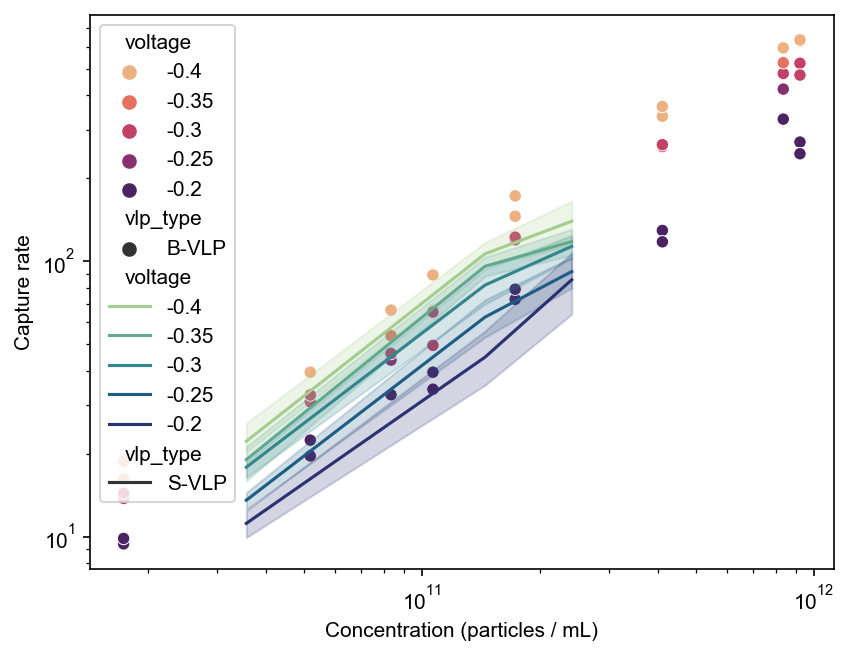

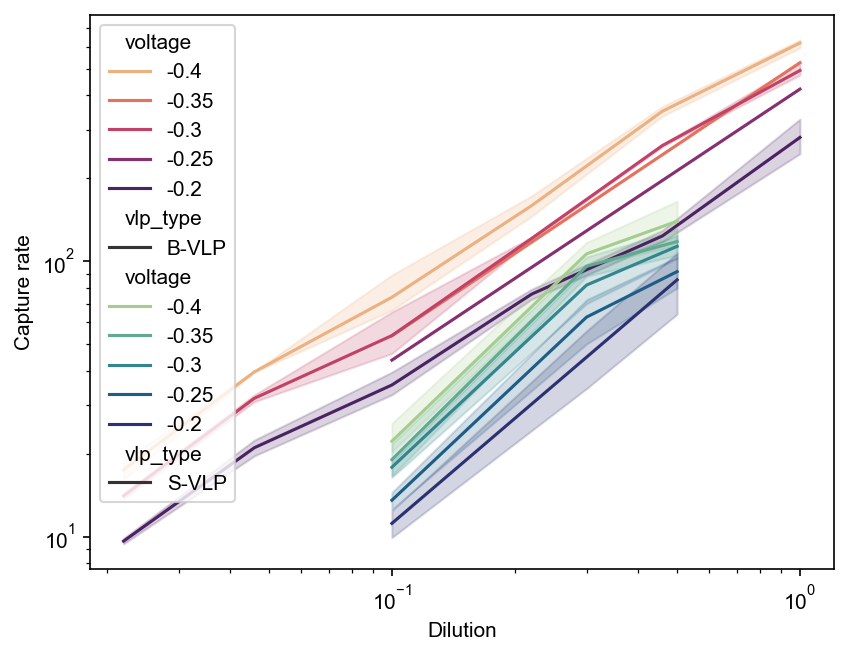

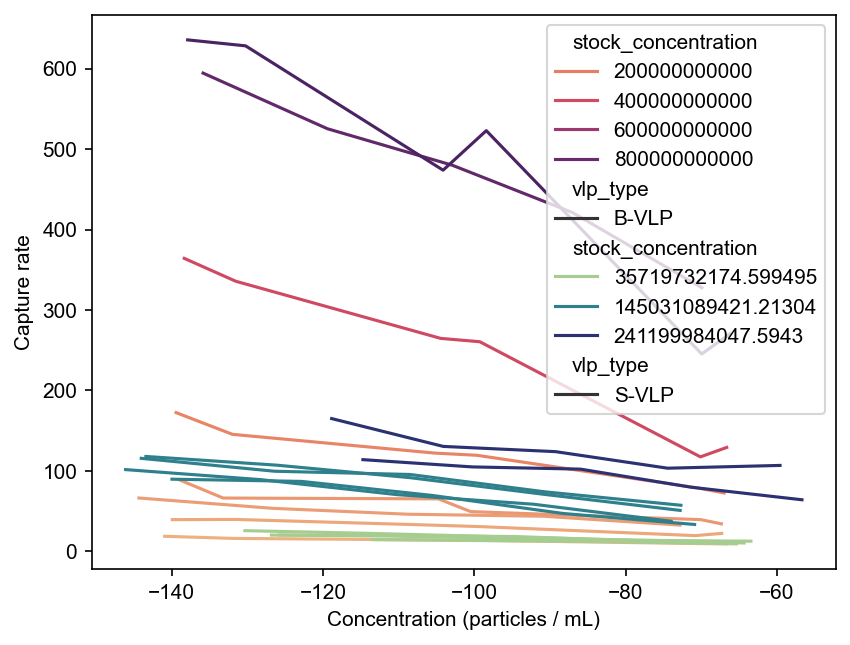

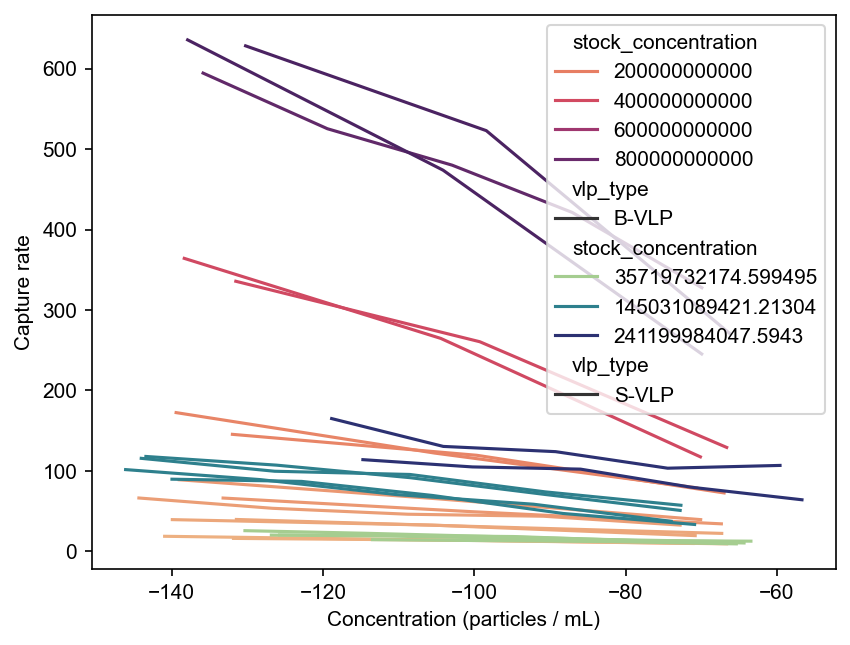

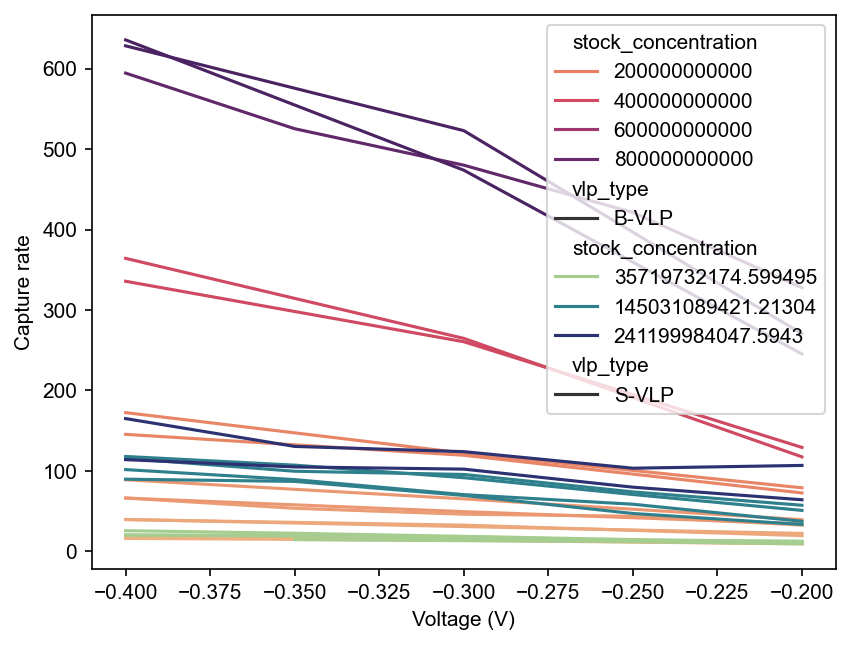

...

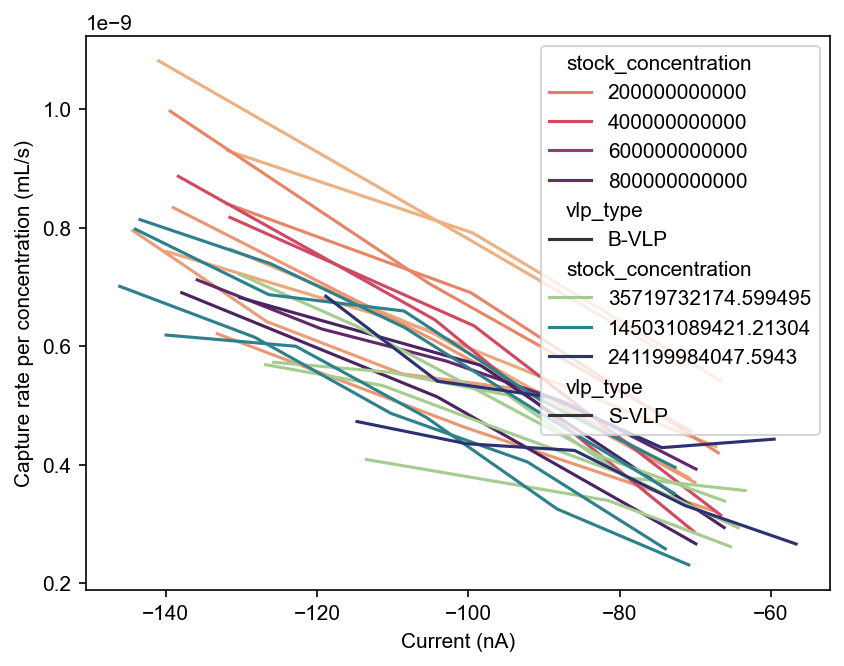

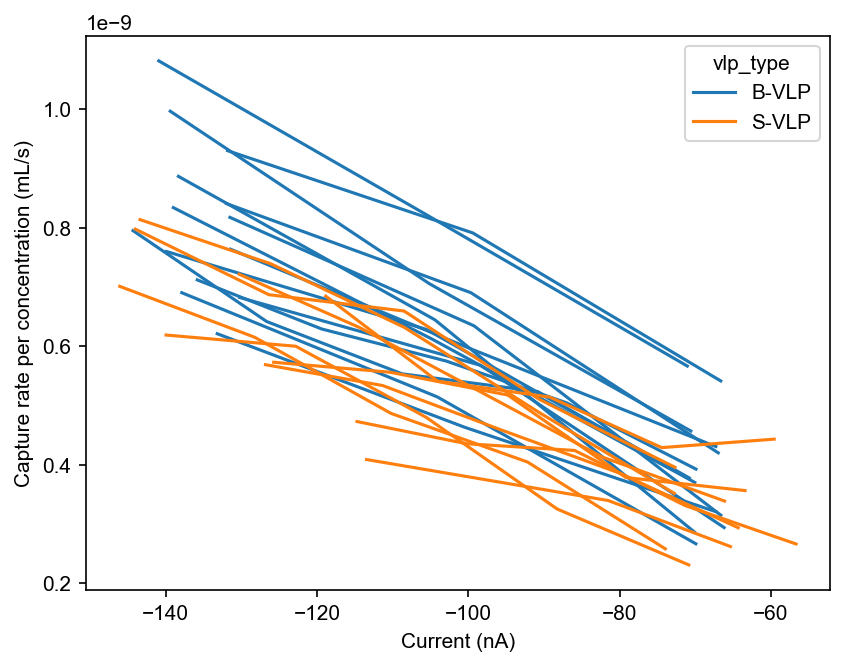

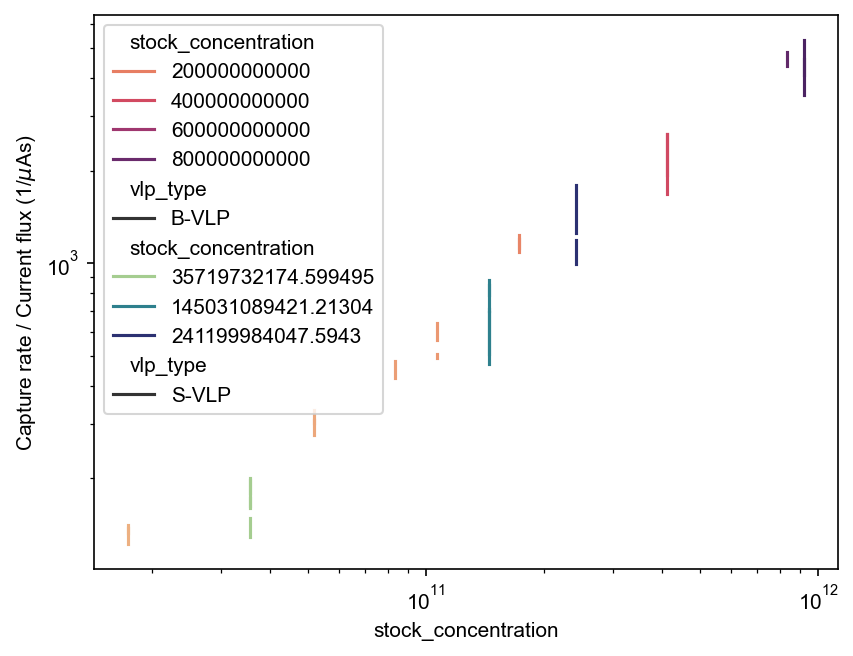

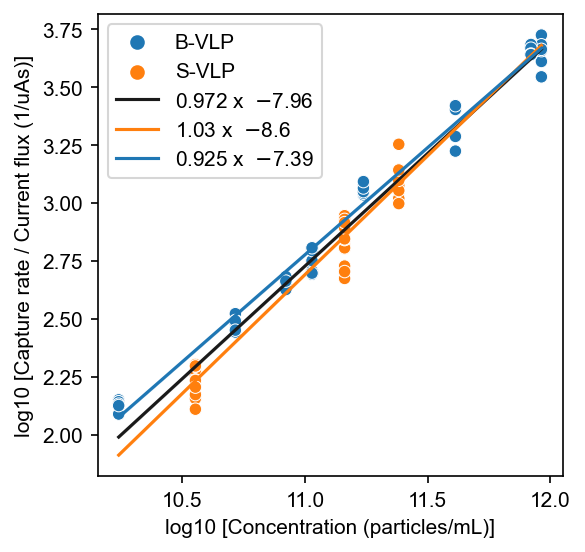

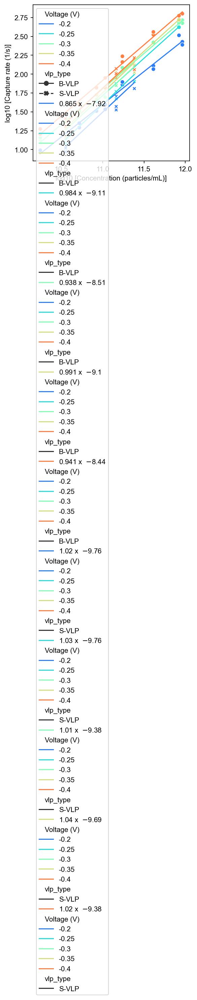

<Figure size 600x600 with 0 Axes>

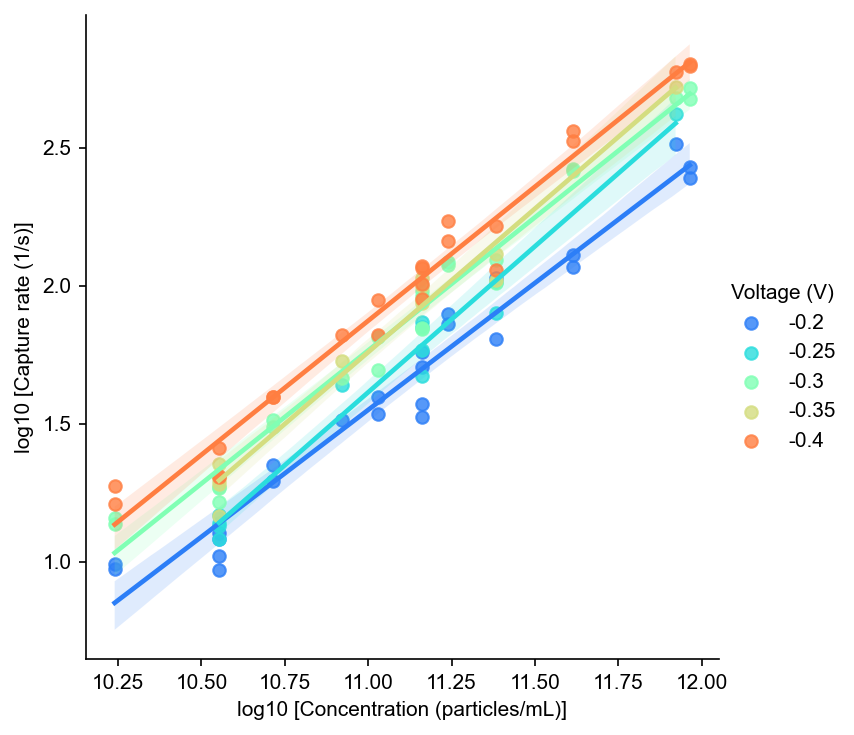

In [535]:
# for pore_id, _df in master_df.groupby(["pore_id","dil"]):
    # print()
    # print(pore_id)
# %matplotlib inline
master_df["Dilution"]=0.1
tempdf=master_df.drop(columns=["frac","deli","deli_to_avg","dt","tpeak","baseline_std","dwell","peak_val"])
for group,_df in tempdf.groupby(["pore_id","Dilution","voltage","step_id"]):
    tempdf.loc[_df.index,"baseline_step_median"]=_df["baseline"].median()
tempdf=tempdf.drop(columns=['baseline'])

ratedf=tempdf.drop_duplicates(ignore_index=True)
# for gp, _rdf in ratedf.groupby(["pore_id","Dilution","stock_concentration","Voltage (V)"],as_index=False):
#     baseline=_rdf["baseline"].median()
#     ratedf.loc[_rdf.index,"baseline_median"]=baseline
    
for gp, _rdf in ratedf.groupby(["pore_id","Dilution","stock_concentration","Voltage (V)"],as_index=False):
    med=_rdf["rate"].median()
    # print(med)
    ratedf.loc[_rdf.index,"rate_median"]=med
    
    baseline_median=_rdf["baseline_step_median"].median()
    ratedf.loc[_rdf.index,"baseline_median"]=baseline_median*1e9

    

ratedf=ratedf.drop(columns=["step_id","rate","baseline_step_median"])
ratedf=ratedf.drop_duplicates(ignore_index=True)
# ratedf["median_rate"]=ratedf["
# ratedf=ratedf.groupby(["pore_id","Dilution"])


# ratedf=tempdf.groupby(["pore_id","dil","voltage"])
# ratedf.head()
ratedf=ratedf.loc[ratedf["rate_median"]>1]
# ratedf.loc[ratedf["chip_id"]=="8e41u23","stock_concentration"]*=5

ratedf=ratedf.loc[(ratedf["pore_id"]!="8e41u14M1") & (ratedf["pore_id"]!="8e41u14M3") & (ratedf["stock_concentration"]>2)]
ratedf=ratedf.loc[~ratedf["chip_id"].isin(["8e41u18","8e41u21","8e41u23","8e41u24","8e41u215"])]
# ratedf=ratedf.loc[~ratedf["Voltage (V)"].isin(['-0.35','-0.25'])]
ratedf["log10_stock_concentration"]=np.log10(ratedf["stock_concentration"])

# sns.reset_defaults()
plt.figure()
# sns.lineplot(ratedf.loc[ratedf["chip_id"]=='8e41u14'],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")

sns.scatterplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='stock_concentration',y='rate_median',hue="voltage",style="vlp_type",palette="flare")


sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='stock_concentration',y='rate_median',hue="voltage",style="vlp_type",palette="crest")
plt.ylabel("Capture rate")
plt.xlabel("Concentration (particles / mL)")
plt.loglog()
ratedf.tail(70)
ratedf.chip_id.unique()

plt.figure()
sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="crest")
plt.ylabel("Capture rate")
plt.xlabel("Dilution")
plt.loglog()

plt.figure()
# sns.lineplot(ratedf.loc[ratedf["chip_id"]=='8e41u14'],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='baseline_median',y='rate_median',hue="stock_concentration",style="vlp_type",palette="flare")


sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='baseline_median',y='rate_median',units="pore_id",hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel("Capture rate")
plt.xlabel("Concentration (particles / mL)")

plt.figure()
# sns.lineplot(ratedf.loc[ratedf["chip_id"]=='8e41u14'],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='baseline_median',y='rate_median',units="pore_id",hue="stock_concentration",style="vlp_type",palette="flare")


sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='baseline_median',y='rate_median',units="pore_id",hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel("Capture rate")
plt.xlabel("Concentration (particles / mL)")

plt.figure()
# sns.lineplot(ratedf.loc[ratedf["chip_id"]=='8e41u14'],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='voltage',y='rate_median',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="flare")


sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='voltage',y='rate_median',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel("Capture rate")
plt.xlabel("Voltage (V)")

plt.figure()
ratedf["rate_per_unit_conc"]=ratedf["rate_median"]/ratedf["stock_concentration"]

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='voltage',y='rate_per_unit_conc',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="flare")


sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='voltage',y='rate_per_unit_conc',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel("Capture rate per concentration (mL/s)")
plt.xlabel("Voltage (V)")



plt.figure()
ratedf["rate_per_unit_conc"]=ratedf["rate_median"]/ratedf["stock_concentration"]

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='baseline_median',y='rate_per_unit_conc',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="flare")


sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='baseline_median',y='rate_per_unit_conc',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel("Capture rate per concentration (mL/s)")
plt.xlabel("Current (nA)")


plt.figure()


sns.lineplot(ratedf,x='baseline_median',y='rate_per_unit_conc',estimator=None,units="file",hue="vlp_type")#,style="vlp_type",palette="flare")


# sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='baseline_median',y='rate_per_unit_conc',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel("Capture rate per concentration (mL/s)")
plt.xlabel("Current (nA)")


ratedf["rate_per_current"]=ratedf["rate_median"]/np.abs(ratedf["baseline_median"])*1000
ratedf["log10_rate"]=np.log10(ratedf["rate_median"])
ratedf["log10_rate_per_current"]=np.log10(ratedf["rate_per_current"])

plt.figure()

sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='stock_concentration',y='rate_per_current',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="flare")


sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='stock_concentration',y='rate_per_current',estimator=None,units="pore_id",hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel(r"Capture rate / Current flux (1/$\mu$As)")
plt.xlabel("stock_concentration")


plt.loglog()


from scipy.stats import linregress
def affine(x,slope,intercept):
    return x*slope+intercept

ratedfb=ratedf.loc[ratedf["vlp_type"]=="B-VLP"]
ratedfs=ratedf.loc[ratedf["vlp_type"]=="S-VLP"]
popt,_=curve_fit(affine,ratedf["log10_stock_concentration"],ratedf["log10_rate_per_current"])

# ratedf["log10_stock_concentration"],ratedf["log10_rate_per_current"]
result=linregress(ratedf["log10_stock_concentration"],ratedf["log10_rate_per_current"])
result_s=linregress(ratedfs["log10_stock_concentration"],ratedfs["log10_rate_per_current"])
result_b=linregress(ratedfb["log10_stock_concentration"],ratedfb["log10_rate_per_current"])

print(result)
plt.figure(figsize=(4,4))

ax=sns.scatterplot(ratedf,x='log10_stock_concentration',y='log10_rate_per_current',hue="vlp_type")

# sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='stock_concentration',y='rate_per_current',hue="stock_concentration",style="vlp_type",palette="crest")
plt.ylabel(r"log10 [Capture rate / Current flux (1/uAs)]")
plt.xlabel(r"log10 [Concentration (particles/mL)]")
sns.move_legend(ax,'upper left',title=None)
sns.lineplot(x=ratedf["log10_stock_concentration"],y=affine(ratedf["log10_stock_concentration"],result.slope,result.intercept),color='k',label=f"{result.slope:.3g} x  $-${-result.intercept:.3g}")#, r={result.rvalue:.3g}")
sns.lineplot(x=ratedf["log10_stock_concentration"],y=affine(ratedf["log10_stock_concentration"],result_s.slope,result_s.intercept),dashes=True,color='tab:orange',label=f"{result_s.slope:.3g} x  $-${-result_s.intercept:.3g}")#, r={result_s.rvalue:.3g}")

sns.lineplot(x=ratedf["log10_stock_concentration"],y=affine(ratedf["log10_stock_concentration"],result_b.slope,result_b.intercept),dashes=True,color='tab:blue',label=f"{result_b.slope:.3g} x  $-${-result_b.intercept:.3g}")#, r={result_b.rvalue:.3g}")
# plt.savefig("VLP_paper_exports\pickled_events\\rates\\rate-per-current_v_concentration.pdf")

plt.figure(figsize=(4,4))
ax=sns.lineplot(ratedf,x='log10_stock_concentration',y='log10_rate',style='vlp_type',units='file',estimator=None,markers=True,hue_order=hueorder,hue="Voltage (V)",palette="rainbow")
for (vlp_type,voltage),_dff in ratedf.groupby(["vlp_type","Voltage (V)"]):
    result=linregress(_dff["log10_stock_concentration"],_dff["log10_rate"])
    sns.lineplot(_dff,x="log10_stock_concentration",y=affine(_dff["log10_stock_concentration"],result.slope,result.intercept),style='vlp_type',dashes=True,hue="Voltage (V)",palette="rainbow",hue_order=hueorder,label=f"{result.slope:.3g} x  $-${-result.intercept:.3g}",ax=ax)#, r={result.rvalue:.3g}")
plt.ylabel(r"log10 [Capture rate (1/s)]")
plt.xlabel(r"log10 [Concentration (particles/mL)]")

# plt.savefig("VLP_paper_exports\pickled_events\\rates\\rate_v_concentration.pdf")
# plt.loglog()
# plt.semilogy()


plt.figure(figsize=(4,4))
ax=sns.lmplot(ratedf,x='log10_stock_concentration',y='log10_rate',hue_order=hueorder,hue="Voltage (V)",palette="rainbow")
# for (vlp_type,voltage),_dff in ratedf.groupby(["vlp_type","Voltage (V)"]):
#     result=linregress(_dff["log10_stock_concentration"],_dff["log10_rate"])
#     sns.lineplot(_dff,x="log10_stock_concentration",y=affine(_dff["log10_stock_concentration"],result.slope,result.intercept),style='vlp_type',dashes=True,hue="Voltage (V)",palette="rainbow",hue_order=hueorder,label=f"{result.slope:.3g} x  $-${-result.intercept:.3g}",ax=ax)#, r={result.rvalue:.3g}")
plt.ylabel(r"log10 [Capture rate (1/s)]")
plt.xlabel(r"log10 [Concentration (particles/mL)]")


In [226]:
ratedf.to_pickle("VLP_paper_exports/pickled_events/rates/rates_for_concentration_24-1-21.pkl")
master_df.to_pickle("VLP_paper_exports/pickled_events/master_df_24-1-21.pkl")

['-0.1' '-0.15' '-0.2' ... '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


array(['8e780n11M2', '8e780n11M3', '8e780n12M1', '8e780n12M3',
       '8e780n12M4'], dtype=object)

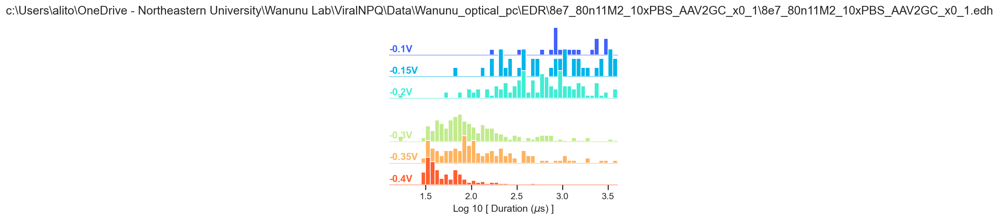

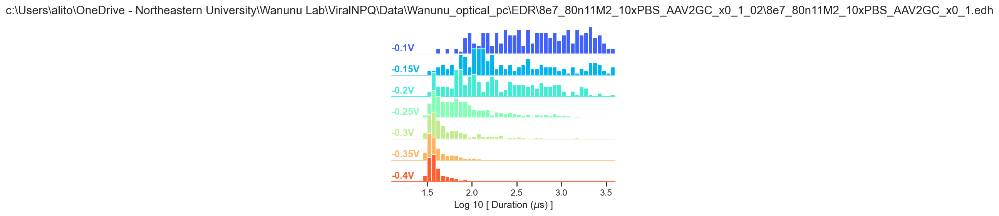

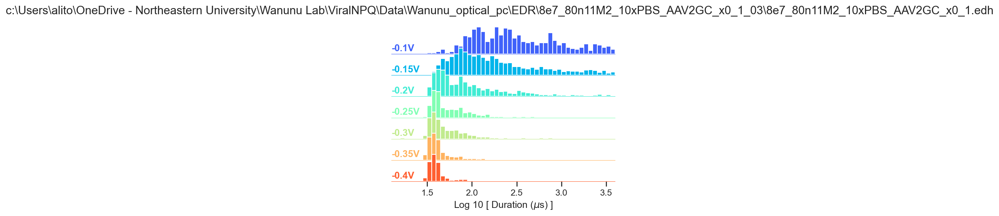

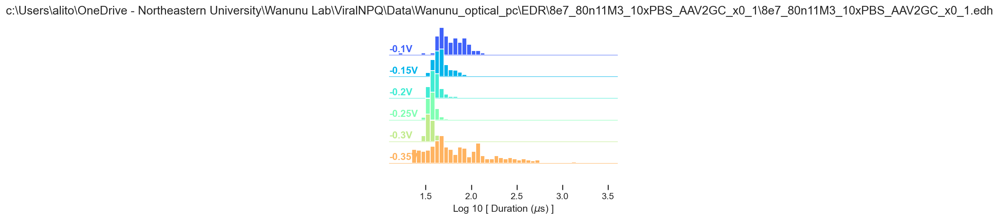

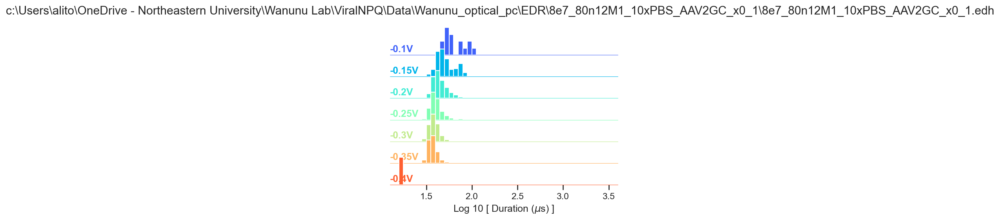

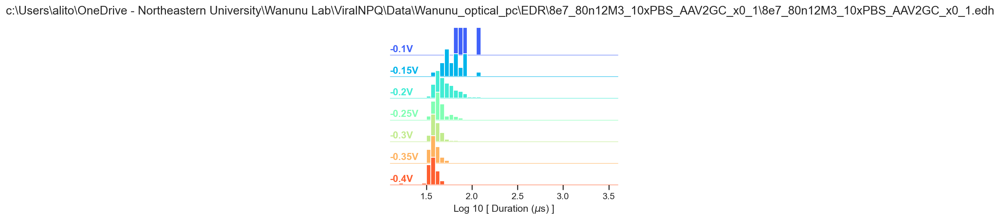

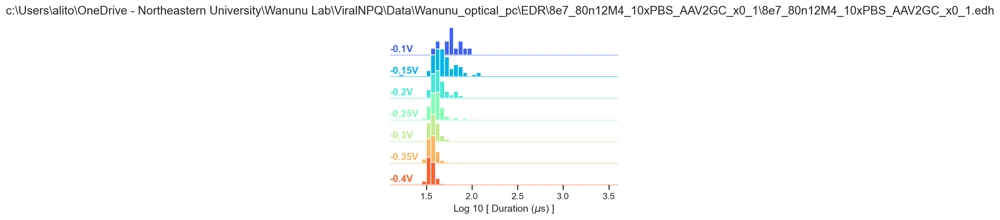

In [31]:
# for group,_df in master_df.groupby("chip_id"):
#     sns.histplot(_df,x="dwell",hue="voltage",bin_range=(10,350),bins=30,logscale=True)
    
mpl.rcParams['pdf.fonttype'] = 42
# matplotlib.rcParams['ps.fonttype'] = 42
plt.rcParams["pdf.use14corefonts"] = False
plt.rcParams["font.family"]=["Arial"]
plt.rcParams["ps.useafm"] = True
plt.rcParams["figure.dpi"]=150
# %matplotlib inline
# for file,_df in df.groupby('file'):
#     sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
#     # plt.figure(figsize=(5,5))
#     _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
#     _df['Amplitude (nA)']=1e9*_df["deli"]
#     hueorder=_df['Voltage (V)'].unique()
#     hueorder.sort()
#     print(hueorder)
#     # print(huedf)
#     g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=(10,100))
#     g.map(sns.kdeplot, "dwell",
#       bw_adjust=.5, clip_on=True,
#       fill=True, alpha=1, linewidth=1,common_norm=True)
#     # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
#     g.map(sns.kdeplot, "dwell", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
#     # plt.semilogy()
#     g.refline(y=0, linewidth=0.5, linestyle="-", color=None, clip_on=False)
    
#     def label(x, color, label):
#         ax = plt.gca()
#         ax.text(0, .2, label, fontweight="bold", color=color,
#             ha="left", va="center", transform=ax.transAxes)
#     g.map(label,'dwell')
#     g.figure.subplots_adjust(hspace=-0.25)
#     g.set_titles("")
#     g.set(yticks=[], ylabel="",xlabel="Duration (us)")
#     g.despine(bottom=True, left=True)
# # df['chip_id']=df['chip_id'].astype(str)
# df.info()
# plt.figure(dpi=150)

dwelldf=master_df.copy()
dwelldf['dwell_log']=np.log10(dwelldf['dwell'])


# dwelldf=dwelldf.loc[~dwelldf["pore_id"].isin(["8e41u14M1","8e41u14M3","8e41u20M3"]) & (dwelldf["stock_concentration"]>2)]
# dwelldf=dwelldf.loc[~dwelldf["chip_id"].isin(["8e41u181","8e41u211","8e41u23","8e41u241","8e41u25"])]
# dwelldf=dwelldf.loc[dwelldf['Voltage (V)'].isin(['-0.025','-0.05','-0.075','-0.1','-0.125'])]
hueorder=dwelldf['Voltage (V)'].unique()
hueorder.sort()
print(hueorder)
for gp, _dfd in dwelldf.groupby("file"):
    
    # plt.figure()
    # sns.violinplot(data=_dfd, x="voltage", y="dwell_log", hue="vlp_type",
    #            split=False, inner="quart", fill=False, linewidth=0.6,)
    # plt.ylim(1,2.5)
    # plt.ylabel(r"Log$_{10}$ dwell time ($\mu$s)")
    # plt.title(gp)
    
    
    
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    # _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    
    # hueorder=_df['Voltage (V)'].unique()
    
    binrange=[1.1,3.6]
    binwidth=0.05
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    # print(huedf)
    g = sns.FacetGrid(_dfd, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=binrange)
    g.map(sns.histplot, "dwell_log",
      binwidth=binwidth,binrange=binrange, clip_on=True,
      fill=True, alpha=1, linewidth=1,common_norm=True)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
    # g.map(sns.histplot, "frac", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0, linewidth=0.5, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label+"V", fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'dwell_log')
    g.figure.subplots_adjust(hspace=-0.25)
    g.set_titles("")
    g.figure.suptitle(gp)
    g.set(yticks=[], ylabel="",xlabel=r"Log 10 [ Duration ($\mu$s) ]")
    g.despine(bottom=True, left=True)
    # print(g.axes.shape)
    g.axes[-1,0].tick_params(axis='x',reset=True,top=False)
    # plt.gca().set_xticks(np.arange(binrange[0],binrange[1],0.2))
    # plt.xlim(-0.1,-0.5)
    # for voltage,_df in df.groupby('Voltage (V)'):
    #     plt.figure(voltage)
    #     sns.histplot(_df,row="dwell",hue="chip_id",binwidth=4)
    fname=gp.split('\\')[-2]
    g.figure.savefig(f"VLP_paper_exports\pickled_aav_events\dwell_hist\{fname}.png",bbox_inches="tight")
dwelldf.pore_id.unique()



In [306]:
# dwelldf.to_pickle("VLP_paper_exports\pickled_events\dwell_hist\subset_for_dwell_time.pkl")
# dwelldf.to_csv("VLP_paper_exports\pickled_events\dwell_hist\subset_for_dwell_time.csv")

# dwelldf.to_csv("VLP_paper_exports\pickled_events\dwell_hist\subset_for_dwell_time.csv")
tempdwelldf=dwelldf.drop(columns=["deli","dt","peak_val","frac","tpeak","baseline",
                      "stock_concentration","rate","deli_to_avg","step_id",
                      "baseline_std","file"])#.to_csv(r"VLP_paper_exports\pickled_events\dwell_hist\truncated_subset_for_dwell_time.csv")

# for pore_id , _dfdwell in tempdwelldf.groupby("pore_id"):
#     _dfdwell.to_csv(f"VLP_paper_exports\pickled_events\dwell_hist\\{pore_id}_truncated_dwell_time.csv")
for (pore_id ,voltage), _dfdwell in tempdwelldf.groupby(["pore_id","Voltage (V)"]):
    _dfdwell.to_csv(f"VLP_paper_exports\pickled_events\dwell_hist\\{pore_id}_{voltage}_truncated_dwell_time.csv")


2752.5577243379134 0.8195754127657935 1.7147153435043874
3317.31437553762 0.49868136359015863 1.8766807117392745
3837.943513983051 0.38661775485896616 1.9855135622902245
4429.826768947308 0.29661117333494613 2.068230879737666
5219.1870420483465 0.25517009949173247 2.1519665016449125
[0.8195754127657935, 0.49868136359015863, 0.38661775485896616, 0.29661117333494613, 0.25517009949173247]


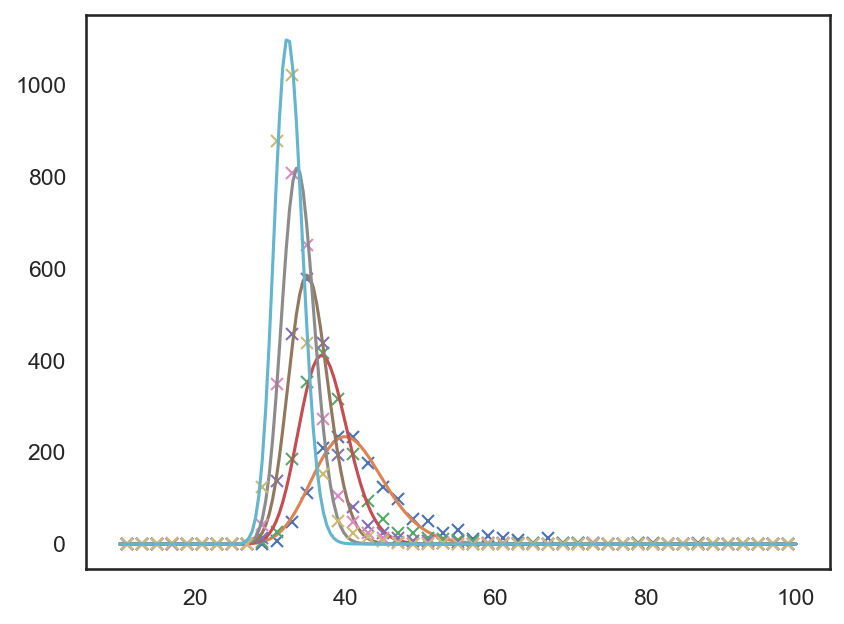

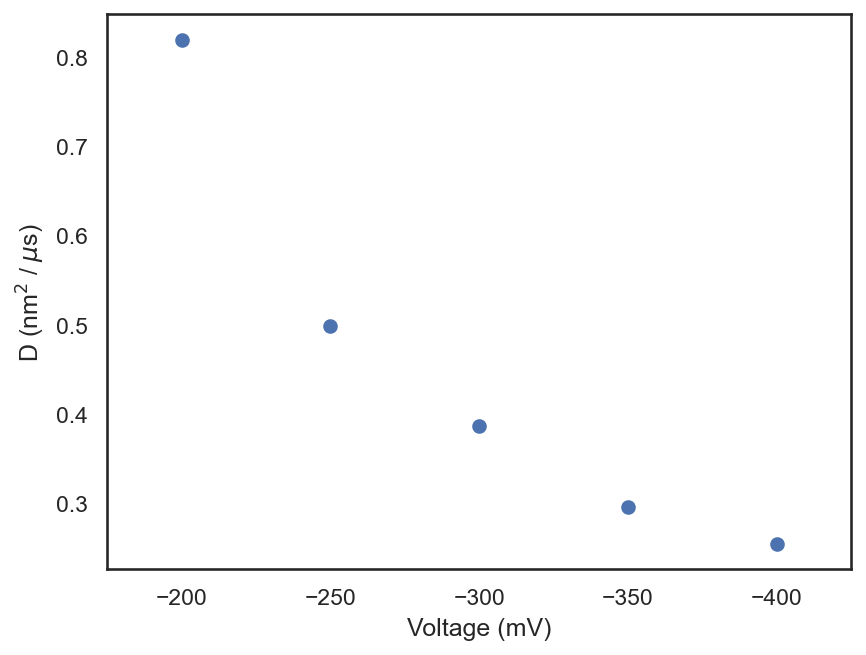

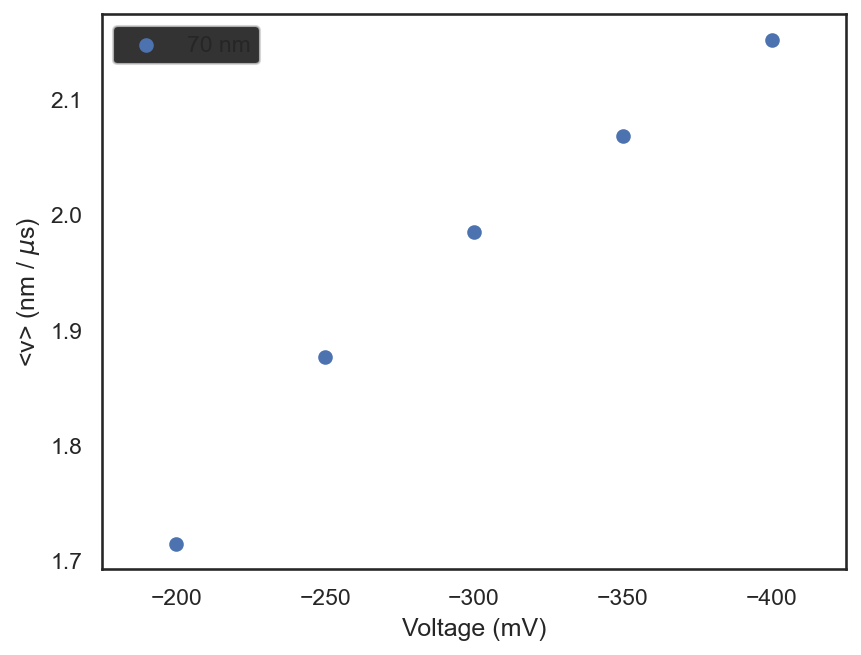

In [496]:
def diff_drift(t,thickness,A,diff_coeff,velocity):
    return A*(thickness/np.sqrt(4*np.pi*diff_coeff*t**3))*np.exp(-((thickness-velocity*t)**2)/(4*diff_coeff*t))

selpore=dwelldf.loc[dwelldf["pore_id"]=="8e41u21M2"]
# plt.figure()

thicknesses=[70]
popt_arr=[]
for thickness in thicknesses:
    popt_arr.append({})
    plt.figure()
    for voltage,_df in selpore.groupby("Voltage (V)"):
        binrange=(10,100)
        binwidth=2
        bins=(binrange[1]-binrange[0])//binwidth
        ydata,bin_edges=np.histogram(_df.dwell,bins=bins,range=binrange)
        x=bin_edges[:-1]+binwidth/2
        # print(x,np.sum(ydata))
        
        popt,_=curve_fit(lambda t,A,diff_coeff,velocity:diff_drift(t,thickness,A,diff_coeff,velocity), x,ydata, p0=(np.sum(ydata),0.5,2),bounds=([1000,1e-1,1],[7000,3,10]) )
        print(*popt)
        
        popt_arr[-1][voltage]=popt
        plt.plot(x,ydata,'x')
        xx=np.linspace(*binrange,200)
        plt.plot(xx,diff_drift(xx,thickness,*popt))

for popts,thickness in zip(popt_arr,thicknesses):
    voltages=np.array(list(map(float,popts.keys())))
    diff_coeffs=[popt[1] for popt in popts.values()]
    vs=[popt[2] for popt in popts.values()]
    print(diff_coeffs)
    plt.figure(40)
    plt.scatter(1000*voltages,diff_coeffs,label=f"{thickness} nm")
    plt.ylabel(r"D (nm$^2$ / $\mu$s)")
    plt.xlim(-175,-425)
    plt.xlabel("Voltage (mV)")
    plt.figure(41)
    plt.scatter(1000*voltages,vs,label=f"{thickness} nm")
    plt.xlim(-175,-425)
    plt.ylabel(r"<v> (nm / $\mu$s)")
    plt.xlabel("Voltage (mV)")
plt.legend()
  
    
    

In [469]:
# from scipy.optimize import curve_fit
def single_gauss(x,A,mean,sigma):
    return A*np.exp(-0.5*(x-mean)**2/sigma**2)
def bimodal_gauss(x,A1,mean1,sigma1,A2,mean2,sigma2):
    return single_gauss(x,A1,mean1,sigma1)+single_gauss(x,A2,mean2,sigma2)
def trimodal_gauss(x,A1,mean1,sigma1,A2,mean2,sigma2,A3,mean3,sigma3):
    return single_gauss(x,A1,mean1,sigma1)+single_gauss(x,A2,mean2,sigma2)+single_gauss(x,A3,mean3,sigma3)

def tetramodal_gauss(x,A1,mean1,sigma1,A2,mean2,sigma2,A3,mean3,sigma3,A4,mean4,sigma4):
    return trimodal_gauss(x,A1,mean1,sigma1,A2,mean2,sigma2,A3,mean3,sigma3)+single_gauss(x,A4,mean4,sigma4)

def bimodal_fit(arr,binwidth,binrange):
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    me1=np.mean(arr)
    me2=me1*1.6
    me2low=me1*1.4
    me2high=me1*2.3
    sigma1low=np.std(arr)*0.2
    sigma1high=np.std(arr)*1.1
    sigma2low=np.std(arr)*0.2
    sigma2high=np.std(arr)*5
    
    y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=True)
    y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
      
    popt, pcov = curve_fit(bimodal_gauss, x_vals, y_vals,bounds=([0,me1*0.5,sigma1low,0,me2low,sigma2low],[1,1.3*me1,sigma1high,0.5,me2high,sigma2high]))

    return popt

def trimodal_fit(arr,binwidth,binrange):
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    me1=np.median(arr)
    me2=me1*1.6
    me2low=me1*1.4
    me2high=me1*2.3
    sigma1low=np.std(arr)*0.2
    sigma1high=np.std(arr)*1.1
    sigma2low=np.std(arr)*0.2
    sigma2high=np.std(arr)*1
    me3low=me1*1.9
    me3high=me1*4.5
    sigma3low=np.std(arr)*0.2
    sigma3high=0.01
    
    y_vals, bin_edges=np.histogram(arr,bins=bin_count,range=binrange,density=True)
    y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
      
    popt, pcov = curve_fit(trimodal_gauss, x_vals, y_vals,bounds=([0,me1*0.5,sigma1low,0,me2low,sigma2low,0,me3low,sigma3low],[1,1.3*me1,sigma1high,0.5,me2high,sigma2high,0.5,me3high,sigma3high]))

    return popt


def tetramodal_fit(arr,binwidth,binrange):
    popt=trimodal_fit(arr,binwidth,binrange)
    popt_lo=popt.copy()
    popt_lo[7:]=popt_lo[7:]*0.88
    popt_lo[6]=popt_lo[6]*0.6
    popt_hi=popt.copy()*1.01
    print(popt,type(popt))
    lower_bound=np.concatenate([popt_lo,[popt[6]*0.2, popt[7]*1.12,popt[8]*0.8]])
    
    upper_bound=np.concatenate([popt_hi,[popt[6]*0.9, popt[7]*1.3,popt[8]*1.6]])
    
    y_vals, bin_edges=np.histogram(arr,bins=bin_count,range=binrange,density=True)
    y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
    
    popt,pcov=curve_fit(tetramodal_gauss,x_vals, y_vals,bounds=(lower_bound,upper_bound))
    return popt

['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


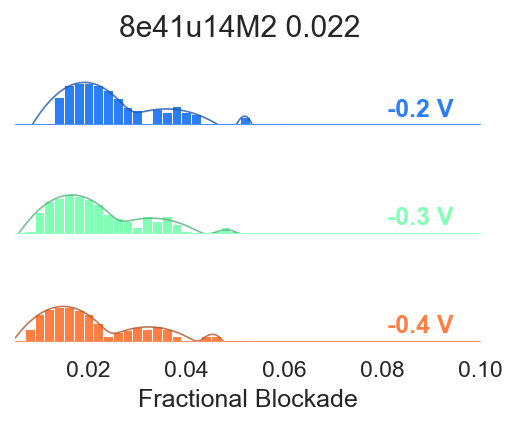

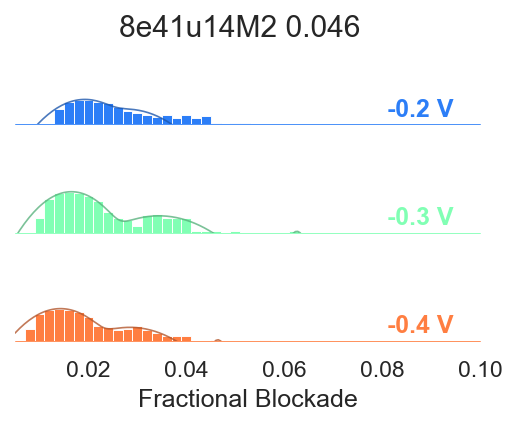

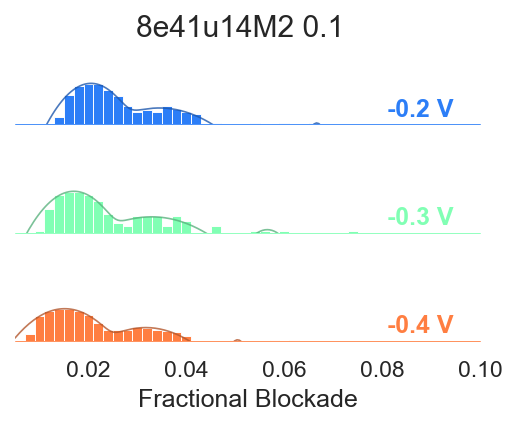

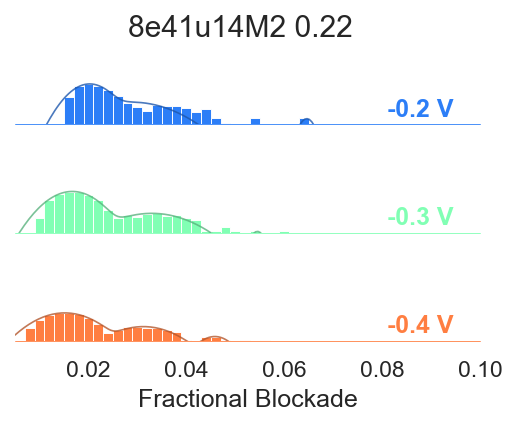

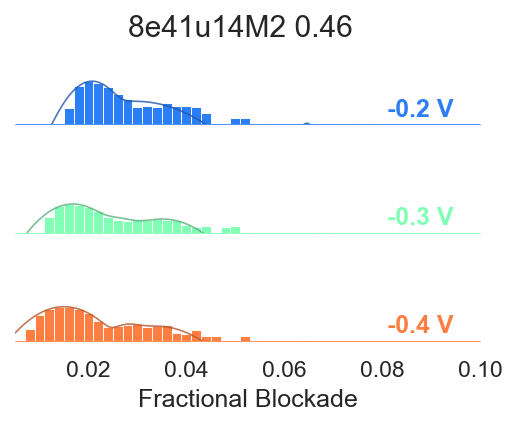

...

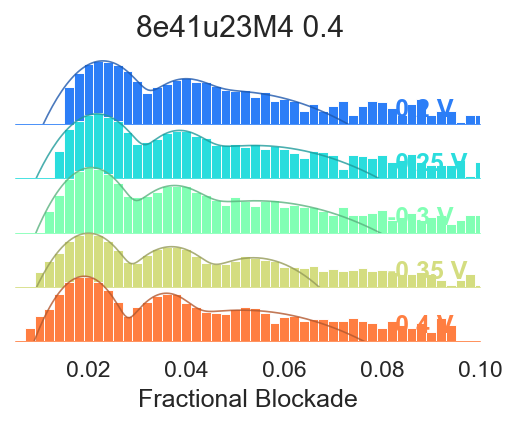

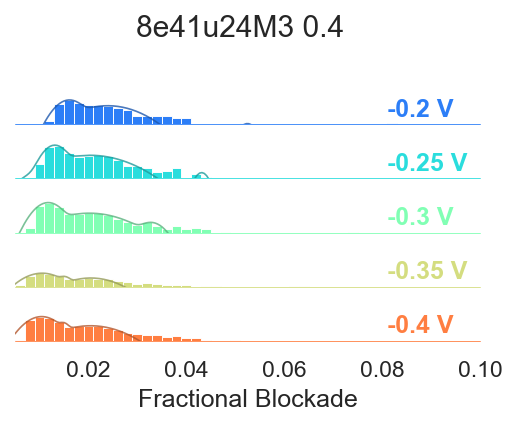

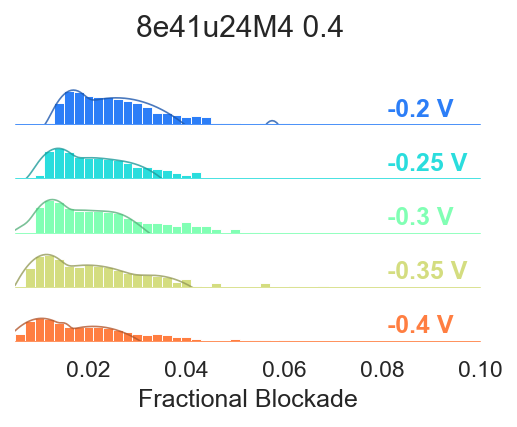

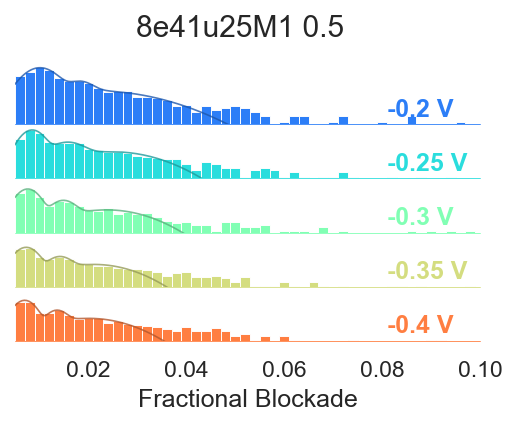

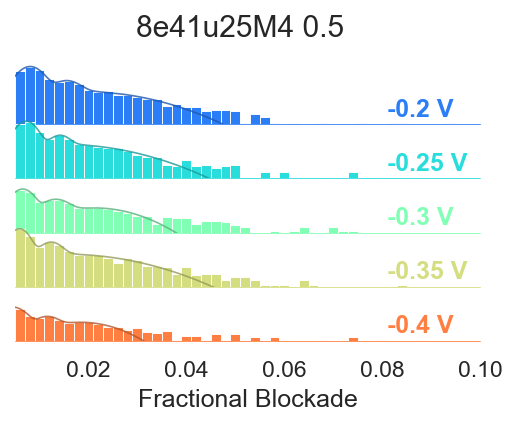

In [451]:
# %matplotlib inline
master_df['Voltage (V)']=(master_df['voltage'].round(3)).astype(str)
frac_df=master_df.loc[~master_df["pore_id"].isin(["8e41u14M1","8e41u14M3",'8e41u16M2','8e41u19M1','8e41u19M2'])]
frac_df=frac_df.loc[~((frac_df["chip_id"]=="8e41u17" )&(frac_df["Voltage (V)"]=="-0.4"))]


hueorder=frac_df['Voltage (V)'].unique()
hueorder.sort()
print(hueorder)


#     plt.plot(xfine,ns*single_gauss(xfine,*popt[:3]),'r--',alpha=0.9,lw=1,label=f"$A_1={popt[0]:.4f},$\n$ \mu_1 = {popt[1]:.2g},$\n$ \sigma_1 = {popt[2]:.2g}$")
    
i=0
for (pore_id,dilution,file),_df in frac_df.groupby(['pore_id','Dilution','file']):
    
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    # _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    # _df['Amplitude (nA)']=1e9*_df["deli"]
    binrange=[0.005,0.1]
    binwidth=0.002
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=8, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=binrange)
    g.map(sns.histplot, "frac",
      binwidth=binwidth,binrange=binrange, clip_on=True,
      fill=True, alpha=1, linewidth=0.45,common_norm=True,log_scale=(False,True))
    
    def fit_and_plot(data, color='k',label=None,binrange=None,binwidth=None):
      # print(kwargs)
      # print()
      df=frac_df.loc[data.index]
      # print(df["Voltage (V)"].unique())
      # print(color)
      bin_count=int((binrange[1]-binrange[0])/binwidth)
      y_vals, bin_edges=np.histogram(df["frac"],bins=bin_count,range=binrange,density=False)
      ns=int(np.sum(y_vals))
      y_vals=y_vals/ns
      x_vals=bin_edges[:-1]+(binwidth/2)
      popt=trimodal_fit(df["frac"].values,binwidth=binwidth,binrange=binrange)
      # print(popt)
      # popt[0]=popt[0]*ns
      
      xfine=np.linspace(binrange[0],binrange[1],200)
      ax=plt.gca()
      ax.plot(xfine,ns*trimodal_gauss(xfine,*popt),lw=0.8,alpha=0.8,c=np.array(color)*0.7)
      ax.set_ylim(0.8,None)
    g.map(fit_and_plot,'frac',binrange=binrange,binwidth=binwidth)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    # g.map(sns.histplot, "frac", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0.8, linewidth=0.4, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0.8, .2, f"{label} V", fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'frac')
    g.figure.subplots_adjust(hspace=-0.25)
    
    g.set_titles("")
    g.set(yticks=[], ylabel="",xlabel="Fractional Blockade")
    g.despine(bottom=True, left=True)
    g.figure.suptitle(f"{pore_id} {dilution}")
    g.figure.savefig(f"VLP_paper_exports\pickled_events\\frac_hist\log_{pore_id}_{dilution}.pdf")
    
    # plt.title(f"{chip_id} {dilution}")
    i+=1
    # if i>3:
      # break
# print(df.head())

# for [chip_id,dilution,voltage],_dff in frac_df.groupby(["Dilution","chip_id","Voltage (V)"]):   
     
    
#     y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=False)
#     # y_vals/=np.sum(y_vals)
#     x_vals=bin_edges[:-1]+(binwidth/2)
#     plt.figure(dpi=150)
#     ns=int(np.sum(y_vals))
#     plt.plot(x_vals,y_vals,'kx',label="Histogram")
#     plt.title(f"{chip_id} {dilution} {voltage} V, n={ns}")
#     popt=trimodal_fit(_dff["frac"].values,binwidth=binwidth,binrange=binrange)
#     xfine=np.linspace(binrange[0],binrange[1],200)
#     plt.plot(xfine,ns*trimodal_gauss(xfine,*popt),lw=1.5,alpha=0.7,c='k',label="Trimodal gaussian")
#     plt.plot(xfine,ns*single_gauss(xfine,*popt[:3]),'r--',alpha=0.9,lw=1,label=f"$A_1={popt[0]:.4f},$\n$ \mu_1 = {popt[1]:.2g},$\n$ \sigma_1 = {popt[2]:.2g}$")
    
    
#     plt.plot(xfine,ns*single_gauss(xfine,*popt[3:6]),'--',c='orange',alpha=0.9,lw=1,label=f"$A_2={popt[3]:.4f},$\n$ \mu_2 = {popt[4]:.2g},$\n$ \sigma_2 = {popt[5]:.2g}$")
    
#     plt.plot(xfine,ns*single_gauss(xfine,*popt[6:]),'--',c='cyan',alpha=0.9,lw=1,label=f"$A_3={popt[6]:.4f},$\n$ \mu_3 = {popt[7]:.2g},$\n$ \sigma_3 = {popt[8]:.2g}$")
    
    
#     plt.xlabel("Fractional blockade $\Delta I/I_0$")
#     plt.legend(frameon=False,facecolor="w")
#     # print(len(hist_result),len(x_vals))
  

['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2406 0.0192 0.0032 ... 0.0032 0.0519 0.0011] <class 'numpy.ndarray'>
[0.2457 0.0166 0.0032 ... 0.0011 0.0483 0.0023] <class 'numpy.ndarray'>
[0.2636 0.0149 0.003  ... 0.0019 0.0454 0.0014] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2492 0.0192 0.0029 ... 0.     0.0636 0.001 ] <class 'numpy.ndarray'>
[0.2496 0.0165 0.0031 ... 0.0008 0.0626 0.001 ] <class 'numpy.ndarray'>
[0.2649 0.0143 0.003  ... 0.0006 0.0465 0.0008] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2745 0.0205 0.0028 ... 0.0015 0.0666 0.001 ] <class 'numpy.ndarray'>
[0.2797 0.017  0.0028 ... 0.0012 0.0565 0.0021] <class 'numpy.ndarray'>
[0.2584 0.0151 0.003  ... 0.0007 0.0505 0.0009] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2903 0.0202 0.0025 ... 0.0014 0.0646 0.001 ] <class 'numpy.ndarray'>
[0.2612 0.0167 0.003  ... 0.0004 0.0545 0.001 ] <class 'numpy.ndarray'>
[0.2558 0.0152 0.0031 ... 0.0008 0.0458 0.0018] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3083 0.0207 0.0023 ... 0.0008 0.0646 0.0011] <class 'numpy.ndarray'>
[0.2942 0.0168 0.0025 ... 0.0084 0.0352 0.0032] <class 'numpy.ndarray'>
[0.2572 0.015  0.0031 ... 0.0049 0.0339 0.0038] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2872 0.0209 0.0025 ... 0.     0.0676 0.0011] <class 'numpy.ndarray'>
[0.273  0.0169 0.0028 ... 0.0016 0.0482 0.001 ] <class 'numpy.ndarray'>
[0.2705 0.0152 0.0029 ... 0.0067 0.0334 0.0044] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2831 0.0179 0.0026 ... 0.0013 0.0565 0.0011] <class 'numpy.ndarray'>
[0.2725 0.0149 0.0029 ... 0.     0.066  0.0009] <class 'numpy.ndarray'>
[0.2743 0.0136 0.0029 ... 0.0007 0.0485 0.0009] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2683 0.0188 0.0028 ... 0.     0.0362 0.0009] <class 'numpy.ndarray'>
[0.2644 0.0149 0.003  ... 0.0019 0.0478 0.0011] <class 'numpy.ndarray'>
[0.2826 0.013  0.0028 ... 0.0036 0.0267 0.0066] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2919 0.018  0.0027 ... 0.0013 0.0565 0.0009] <class 'numpy.ndarray'>
[0.2907 0.0152 0.0027 ... 0.0008 0.0505 0.0008] <class 'numpy.ndarray'>
[0.2974 0.0136 0.0027 ... 0.0013 0.0434 0.0008] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3043 0.0186 0.0024 ... 0.0007 0.0586 0.001 ] <class 'numpy.ndarray'>
[0.2973 0.0155 0.0026 ... 0.0004 0.0525 0.0009] <class 'numpy.ndarray'>
[0.2884 0.0138 0.0027 ... 0.0009 0.0425 0.0008] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3069 0.0198 0.0022 ... 0.0008 0.0626 0.0012] <class 'numpy.ndarray'>
[0.2987 0.0154 0.0025 ... 0.0096 0.0317 0.0028] <class 'numpy.ndarray'>
[0.2881 0.0139 0.0027 ... 0.0015 0.0464 0.0011] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3391 0.0195 0.0021 ... 0.0003 0.0646 0.0009] <class 'numpy.ndarray'>
[0.3002 0.0156 0.0025 ... 0.0104 0.0318 0.0029] <class 'numpy.ndarray'>
[0.2848 0.0141 0.0027 ... 0.0004 0.0396 0.0081] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3284 0.0157 0.0022 ... 0.0129 0.0312 0.0021] <class 'numpy.ndarray'>
[0.3275 0.0141 0.0023 ... 0.0006 0.0444 0.0008] <class 'numpy.ndarray'>
[0.3006 0.0132 0.0026 ... 0.0005 0.0444 0.0007] <class 'numpy.ndarray'>
[0.3018 0.0125 0.0026 ... 0.0005 0.0404 0.0007] <class 'numpy.ndarray'>
[0.3074 0.0118 0.0025 ... 0.     0.0395 0.0008] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3261 0.0164 0.002  ... 0.0174 0.0333 0.0027] <class 'numpy.ndarray'>
[0.3301 0.0145 0.0022 ... 0.0009 0.0505 0.0008] <class 'numpy.ndarray'>
[0.3573 0.0141 0.002  ... 0.0116 0.0291 0.0026] <class 'numpy.ndarray'>
[0.3957 0.0136 0.0018 ... 0.0134 0.0278 0.0025] <class 'numpy.ndarray'>
[0.2984 0.012  0.0026 ... 0.0006 0.0344 0.0081] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2652 0.0195 0.0029 ... 0.0001 0.0636 0.001 ] <class 'numpy.ndarray'>
[0.2729 0.0177 0.0029 ... 0.     0.0575 0.0009] <class 'numpy.ndarray'>
[0.306  0.0166 0.0025 ... 0.     0.0535 0.0008] <class 'numpy.ndarray'>
[0.3009 0.0157 0.0026 ... 0.     0.0515 0.0007] <class 'numpy.ndarray'>
[0.3112 0.0149 0.0025 ... 0.0046 0.0304 0.0073] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3062 0.019  0.0024 ... 0.0004 0.0626 0.001 ] <class 'numpy.ndarray'>
[0.2862 0.017  0.0027 ... 0.0003 0.0565 0.0009] <class 'numpy.ndarray'>
[0.2985 0.0161 0.0026 ... 0.0009 0.0434 0.0031] <class 'numpy.ndarray'>
[0.2909 0.0152 0.0026 ... 0.0084 0.0318 0.0031] <class 'numpy.ndarray'>
[0.2878 0.0146 0.0027 ... 0.0008 0.0398 0.0066] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3053 0.0147 0.0026 ... 0.     0.0474 0.0006] <class 'numpy.ndarray'>
[0.3358 0.0136 0.0023 ... 0.0011 0.0464 0.0007] <class 'numpy.ndarray'>
[0.3575 0.0127 0.0021 ... 0.0011 0.0384 0.0007] <class 'numpy.ndarray'>
[0.3677 0.0119 0.0021 ... 0.001  0.0384 0.0007] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3584 0.0151 0.0021 ... 0.0006 0.0505 0.0007] <class 'numpy.ndarray'>
[0.3502 0.0136 0.0022 ... 0.0008 0.0424 0.0007] <class 'numpy.ndarray'>
[0.3654 0.0127 0.0021 ... 0.     0.0414 0.0007] <class 'numpy.ndarray'>
[0.3644 0.012  0.0021 ... 0.002  0.0358 0.0007] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3183 0.0151 0.0024 ... 0.     0.0495 0.0007] <class 'numpy.ndarray'>
[0.3173 0.0138 0.0025 ... 0.0002 0.0454 0.0007] <class 'numpy.ndarray'>
[0.3478 0.0131 0.0022 ... 0.     0.0414 0.0007] <class 'numpy.ndarray'>
[0.3616 0.0122 0.0021 ... 0.0001 0.0394 0.0007] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3808 0.0126 0.0019 ... 0.     0.0414 0.0006] <class 'numpy.ndarray'>
[0.3726 0.0116 0.002  ... 0.0047 0.0357 0.0009] <class 'numpy.ndarray'>
[0.3429 0.0103 0.0023 ... 0.0011 0.0331 0.0016] <class 'numpy.ndarray'>
[0.3286 0.0099 0.0024 ... 0.0067 0.0229 0.0029] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:447: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and m

[0.4265 0.0133 0.0017 ... 0.     0.0434 0.0007] <class 'numpy.ndarray'>
[0.3686 0.0116 0.002  ... 0.0111 0.0236 0.0021] <class 'numpy.ndarray'>
[0.4648 0.0109 0.0015 ... 0.0103 0.0234 0.0019] <class 'numpy.ndarray'>
[0.3887 0.01   0.0019 ... 0.012  0.0212 0.0025] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3743 0.0125 0.002  ... 0.     0.0414 0.0006] <class 'numpy.ndarray'>
[0.3599 0.0111 0.0022 ... 0.0025 0.0484 0.0007] <class 'numpy.ndarray'>
[0.357  0.0099 0.0022 ... 0.     0.0326 0.0007] <class 'numpy.ndarray'>
[0.4044 0.01   0.002  ... 0.0018 0.0305 0.0006] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.4776 0.0123 0.0014 ... 0.0042 0.0394 0.0007] <class 'numpy.ndarray'>
[0.4394 0.0105 0.0016 ... 0.0173 0.0221 0.002 ] <class 'numpy.ndarray'>
[0.3951 0.0094 0.0019 ... 0.0026 0.0294 0.0007] <class 'numpy.ndarray'>
[0.9654 0.0051 0.0013 ... 0.     0.0194 0.0012] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2686 0.0204 0.0029 ... 0.     0.0656 0.0009] <class 'numpy.ndarray'>
[0.305  0.0197 0.0025 ... 0.     0.0636 0.0008] <class 'numpy.ndarray'>
[0.2921 0.0189 0.0027 ... 0.     0.0616 0.0009] <class 'numpy.ndarray'>
[0.3174 0.018  0.0024 ... 0.001  0.0565 0.0009] <class 'numpy.ndarray'>
[0.2991 0.0176 0.0026 ... 0.0009 0.0565 0.0008] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2633 0.0202 0.0029 ... 0.0001 0.0656 0.0009] <class 'numpy.ndarray'>
[0.2782 0.0187 0.0028 ... 0.     0.0616 0.0008] <class 'numpy.ndarray'>
[0.3134 0.0176 0.0025 ... 0.001  0.0535 0.0009] <class 'numpy.ndarray'>
[0.3189 0.0168 0.0024 ... 0.0005 0.0525 0.0008] <class 'numpy.ndarray'>
[0.3142 0.016  0.0025 ... 0.     0.0515 0.0007] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2688 0.0199 0.0029 ... 0.     0.0636 0.0009] <class 'numpy.ndarray'>
[0.3012 0.0183 0.0026 ... 0.     0.0596 0.0009] <class 'numpy.ndarray'>
[0.3141 0.0176 0.0025 ... 0.0006 0.0565 0.0008] <class 'numpy.ndarray'>
[0.3302 0.0164 0.0023 ... 0.0001 0.0535 0.0009] <class 'numpy.ndarray'>
[0.3192 0.0157 0.0025 ... 0.0006 0.0454 0.0025] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2504 0.0196 0.0031 ... 0.     0.0636 0.0008] <class 'numpy.ndarray'>
[0.2944 0.0185 0.0026 ... 0.     0.0596 0.001 ] <class 'numpy.ndarray'>
[0.2985 0.0174 0.0026 ... 0.0001 0.0555 0.0008] <class 'numpy.ndarray'>
[0.3243 0.0165 0.0024 ... 0.0001 0.0535 0.0009] <class 'numpy.ndarray'>
[0.3332 0.0159 0.0024 ... 0.     0.0515 0.0007] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.261  0.0212 0.003  ... 0.0004 0.0541 0.0039] <class 'numpy.ndarray'>
[0.271  0.0196 0.0028 ... 0.0005 0.0544 0.0038] <class 'numpy.ndarray'>
[0.2751 0.0183 0.0028 ... 0.0007 0.0493 0.0054] <class 'numpy.ndarray'>
[0.2849 0.0173 0.0027 ... 0.0006 0.0463 0.0067] <class 'numpy.ndarray'>
[0.2803 0.0165 0.0027 ... 0.0044 0.0362 0.004 ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2489 0.0207 0.0031 ... 0.0001 0.0572 0.0061] <class 'numpy.ndarray'>
[0.2634 0.019  0.0029 ... 0.0002 0.0626 0.001 ] <class 'numpy.ndarray'>
[0.2918 0.0177 0.0026 ... 0.0002 0.0585 0.0009] <class 'numpy.ndarray'>
[0.2889 0.0167 0.0027 ... 0.0052 0.0362 0.0038] <class 'numpy.ndarray'>
[0.2882 0.0159 0.0027 ... 0.0005 0.0464 0.0064] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1667 0.0225 0.0039 ... 0.003  0.0738 0.0039] <class 'numpy.ndarray'>
[0.1864 0.0204 0.0035 ... 0.0052 0.0543 0.01  ] <class 'numpy.ndarray'>
[0.2018 0.0182 0.0031 ... 0.009  0.0562 0.0044] <class 'numpy.ndarray'>
[0.2053 0.0164 0.003  ... 0.0059 0.0519 0.0076] <class 'numpy.ndarray'>
[0.215  0.015  0.0029 ... 0.0097 0.0487 0.0044] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.178  0.0227 0.0035 ... 0.012  0.0459 0.01  ] <class 'numpy.ndarray'>
[0.1957 0.0203 0.0033 ... 0.0061 0.0529 0.01  ] <class 'numpy.ndarray'>
[0.2155 0.0182 0.0029 ... 0.0065 0.0553 0.0068] <class 'numpy.ndarray'>
[0.2188 0.0166 0.0029 ... 0.0077 0.0466 0.01  ] <class 'numpy.ndarray'>
[0.2126 0.0154 0.003  ... 0.0066 0.044  0.0082] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2056 0.024  0.0032 ... 0.0031 0.0622 0.01  ] <class 'numpy.ndarray'>
[0.2039 0.0215 0.003  ... 0.0111 0.0603 0.0034] <class 'numpy.ndarray'>
[0.211  0.0167 0.0029 ... 0.0061 0.0478 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1738 0.0226 0.0037 ... 0.0049 0.06   0.01  ] <class 'numpy.ndarray'>
[0.2094 0.0198 0.0031 ... 0.0045 0.057  0.008 ] <class 'numpy.ndarray'>
[0.2089 0.018  0.0031 ... 0.0053 0.0539 0.0088] <class 'numpy.ndarray'>
[0.2179 0.0163 0.003  ... 0.0059 0.0463 0.01  ] <class 'numpy.ndarray'>
[0.2203 0.015  0.003  ... 0.0062 0.0441 0.0099] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1987 0.0205 0.003  ... 0.0097 0.0482 0.01  ] <class 'numpy.ndarray'>
[0.214  0.018  0.0029 ... 0.0065 0.0493 0.01  ] <class 'numpy.ndarray'>
[0.2215 0.0164 0.0027 ... 0.007  0.0476 0.0097] <class 'numpy.ndarray'>
[0.2266 0.0149 0.0027 ... 0.0082 0.0433 0.009 ] <class 'numpy.ndarray'>
[0.2282 0.0138 0.0027 ... 0.0074 0.0416 0.0099] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1936 0.0222 0.0031 ... 0.0076 0.0531 0.01  ] <class 'numpy.ndarray'>
[0.2229 0.02   0.0028 ... 0.007  0.0527 0.01  ] <class 'numpy.ndarray'>
[0.2214 0.0183 0.0028 ... 0.0067 0.052  0.01  ] <class 'numpy.ndarray'>
[0.2187 0.0168 0.0028 ... 0.0079 0.0479 0.0078] <class 'numpy.ndarray'>
[0.2247 0.0155 0.0026 ... 0.0083 0.0466 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1886 0.0228 0.0031 ... 0.006  0.0531 0.01  ] <class 'numpy.ndarray'>
[0.211  0.0205 0.0028 ... 0.0073 0.0554 0.0094] <class 'numpy.ndarray'>
[0.2202 0.0187 0.0027 ... 0.0075 0.0504 0.01  ] <class 'numpy.ndarray'>
[0.2372 0.0173 0.0027 ... 0.0084 0.0506 0.0048] <class 'numpy.ndarray'>
[0.2286 0.0162 0.0027 ... 0.0084 0.047  0.0055] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1848 0.0216 0.0032 ... 0.0056 0.0606 0.01  ] <class 'numpy.ndarray'>
[0.1977 0.0195 0.003  ... 0.007  0.0512 0.01  ] <class 'numpy.ndarray'>
[0.1961 0.0178 0.003  ... 0.0067 0.0509 0.01  ] <class 'numpy.ndarray'>
[0.203  0.0164 0.003  ... 0.0079 0.0476 0.01  ] <class 'numpy.ndarray'>
[0.2034 0.0152 0.003  ... 0.0069 0.0462 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2083 0.0171 0.0027 ... 0.0142 0.0416 0.0082] <class 'numpy.ndarray'>
[0.2344 0.0145 0.0026 ... 0.0131 0.0379 0.0075] <class 'numpy.ndarray'>
[0.2524 0.0133 0.0023 ... 0.0112 0.0378 0.0089] <class 'numpy.ndarray'>
[0.2619 0.0121 0.0022 ... 0.0078 0.0421 0.0068] <class 'numpy.ndarray'>
[0.266  0.0112 0.0022 ... 0.0085 0.0361 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1999 0.0151 0.0027 ... 0.015  0.0376 0.0091] <class 'numpy.ndarray'>
[0.2317 0.0128 0.0024 ... 0.0109 0.0372 0.0089] <class 'numpy.ndarray'>
[0.2658 0.0115 0.0022 ... 0.0098 0.0356 0.0091] <class 'numpy.ndarray'>
[0.2798 0.0105 0.0021 ... 0.0083 0.0345 0.01  ] <class 'numpy.ndarray'>
[0.2797 0.0097 0.002  ... 0.0096 0.0323 0.0096] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1883 0.0158 0.0029 ... 0.0123 0.0413 0.01  ] <class 'numpy.ndarray'>
[0.2108 0.0135 0.0026 ... 0.0087 0.0421 0.01  ] <class 'numpy.ndarray'>
[0.2287 0.0122 0.0023 ... 0.0092 0.0368 0.01  ] <class 'numpy.ndarray'>
[0.2337 0.0111 0.0024 ... 0.0079 0.0374 0.01  ] <class 'numpy.ndarray'>
[0.2352 0.0103 0.0024 ... 0.0082 0.0346 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1926 0.0159 0.0029 ... 0.0125 0.0421 0.0099] <class 'numpy.ndarray'>
[0.2242 0.0138 0.0025 ... 0.009  0.0413 0.01  ] <class 'numpy.ndarray'>
[0.2397 0.0123 0.0024 ... 0.0087 0.0399 0.01  ] <class 'numpy.ndarray'>
[0.2496 0.0111 0.0023 ... 0.0072 0.0388 0.01  ] <class 'numpy.ndarray'>
[0.2493 0.0105 0.0023 ... 0.0078 0.0367 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1774 0.0245 0.0034 ... 0.0069 0.0557 0.01  ] <class 'numpy.ndarray'>
[0.1868 0.0224 0.0033 ... 0.0073 0.0577 0.01  ] <class 'numpy.ndarray'>
[0.1937 0.0209 0.0032 ... 0.0067 0.0583 0.01  ] <class 'numpy.ndarray'>
[0.2089 0.0198 0.0029 ... 0.0071 0.0558 0.0089] <class 'numpy.ndarray'>
[0.2123 0.0186 0.0029 ... 0.0088 0.0531 0.0069] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1718 0.0199 0.0034 ... 0.0106 0.0504 0.01  ] <class 'numpy.ndarray'>
[0.1985 0.0173 0.0031 ... 0.0088 0.0487 0.01  ] <class 'numpy.ndarray'>
[0.2006 0.0157 0.003  ... 0.0093 0.046  0.01  ] <class 'numpy.ndarray'>
[0.2161 0.0145 0.0028 ... 0.0083 0.0446 0.01  ] <class 'numpy.ndarray'>
[0.2189 0.0135 0.0027 ... 0.0075 0.0451 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1725 0.0209 0.0035 ... 0.0075 0.0566 0.01  ] <class 'numpy.ndarray'>
[0.1865 0.0186 0.0033 ... 0.0078 0.0529 0.01  ] <class 'numpy.ndarray'>
[0.1998 0.0173 0.003  ... 0.0067 0.053  0.01  ] <class 'numpy.ndarray'>
[0.2055 0.016  0.0029 ... 0.0073 0.0504 0.01  ] <class 'numpy.ndarray'>
[0.2057 0.0151 0.003  ... 0.0076 0.0469 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.1798 0.0229 0.0034 ... 0.0092 0.0485 0.0096] <class 'numpy.ndarray'>
[0.1785 0.0217 0.0035 ... 0.0079 0.0539 0.01  ] <class 'numpy.ndarray'>
[0.2008 0.0206 0.0031 ... 0.0067 0.054  0.01  ] <class 'numpy.ndarray'>
[0.2111 0.02   0.0029 ... 0.0094 0.0537 0.0049] <class 'numpy.ndarray'>
[0.2128 0.0191 0.0028 ... 0.007  0.0513 0.01  ] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3512 0.0161 0.0015 ... 0.0008 0.0525 0.001 ] <class 'numpy.ndarray'>
[0.4587 0.0131 0.0013 ... 0.0011 0.0431 0.0009] <class 'numpy.ndarray'>
[0.4882 0.0118 0.0014 ... 0.0023 0.0328 0.0015] <class 'numpy.ndarray'>
[0.4817 0.0105 0.0015 ... 0.0237 0.0205 0.0021] <class 'numpy.ndarray'>
[0.469  0.0104 0.0016 ... 0.0178 0.0204 0.0031] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3182 0.0169 0.0015 ... 0.0011 0.0575 0.001 ] <class 'numpy.ndarray'>
[0.4292 0.0138 0.0015 ... 0.0085 0.027  0.0028] <class 'numpy.ndarray'>
[0.4587 0.0126 0.0014 ... 0.0127 0.0247 0.0021] <class 'numpy.ndarray'>
[0.4557 0.0114 0.0016 ... 0.0017 0.033  0.0033] <class 'numpy.ndarray'>
[0.4252 0.0105 0.0017 ... 0.017  0.021  0.0028] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.2157 0.0101 0.0026 ... 0.0177 0.0213 0.01  ] <class 'numpy.ndarray'>
[0.3508 0.0085 0.0017 ... 0.0137 0.025  0.0065] <class 'numpy.ndarray'>
[0.4177 0.0076 0.0016 ... 0.0128 0.0237 0.0056] <class 'numpy.ndarray'>
[0.4259 0.0073 0.0015 ... 0.0151 0.0212 0.005 ] <class 'numpy.ndarray'>
[0.4596 0.007  0.0014 ... 0.0158 0.0201 0.0053] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


[0.3125 0.0081 0.002  ... 0.0141 0.019  0.01  ] <class 'numpy.ndarray'>
[0.3964 0.0073 0.0015 ... 0.019  0.0146 0.01  ] <class 'numpy.ndarray'>
[0.4498 0.0066 0.0015 ... 0.015  0.0213 0.0056] <class 'numpy.ndarray'>
[0.5165 0.0059 0.0014 ... 0.0155 0.0153 0.01  ] <class 'numpy.ndarray'>
[0.9963 0.0043 0.0017 ... 0.0211 0.0185 0.0042] <class 'numpy.ndarray'>


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


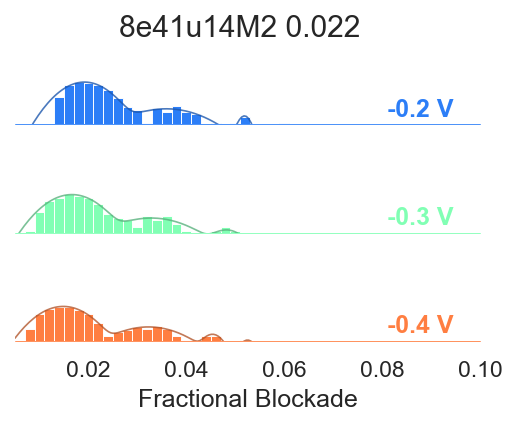

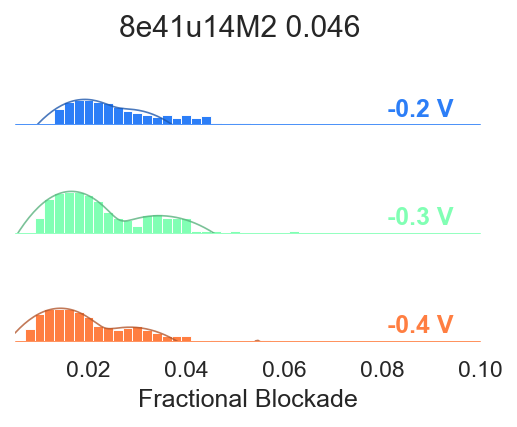

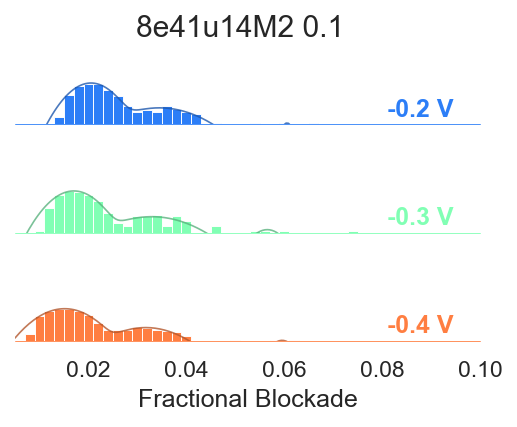

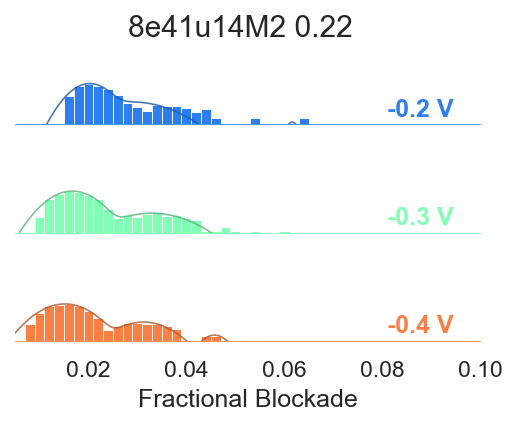

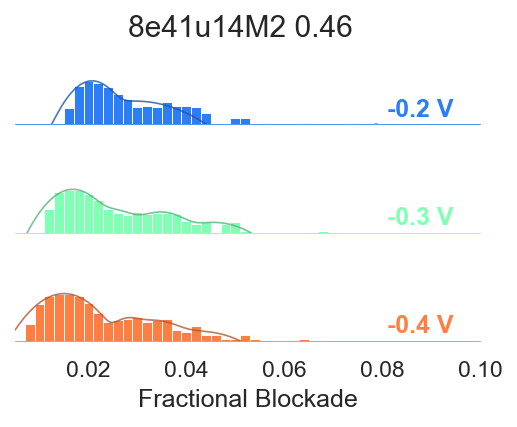

...

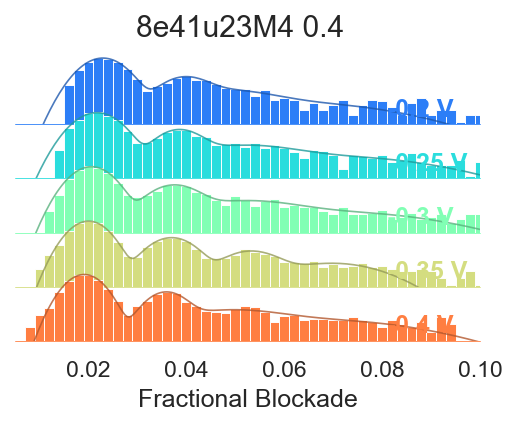

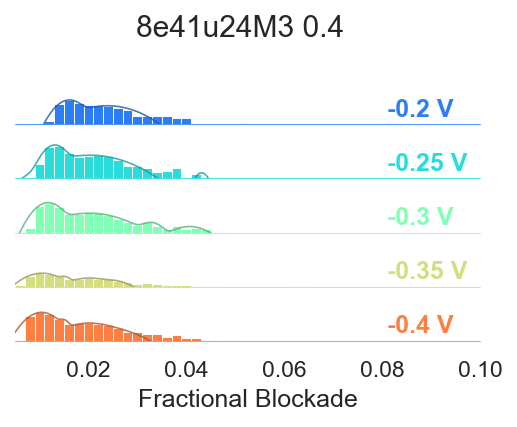

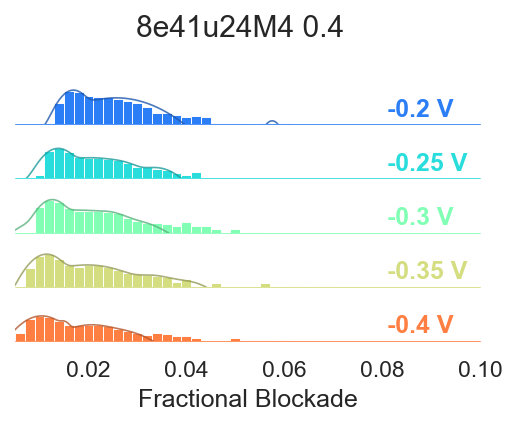

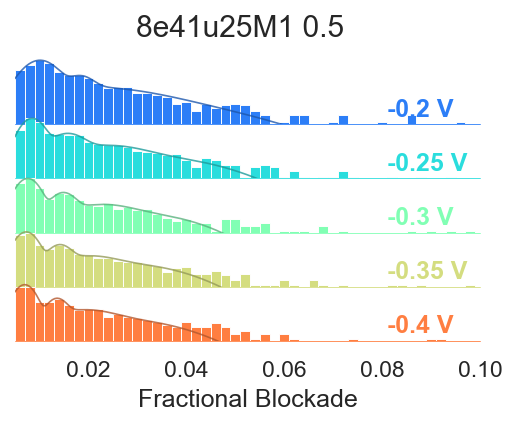

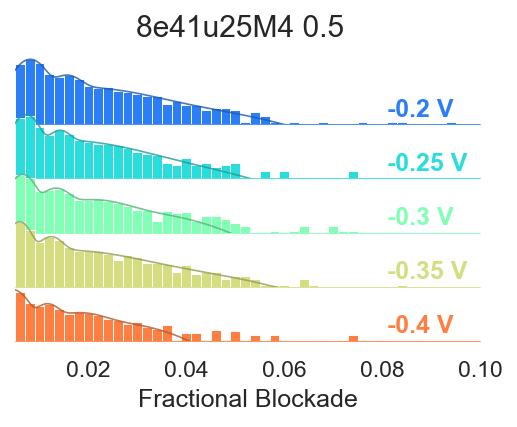

In [495]:
# %matplotlib inline
master_df['Voltage (V)']=(master_df['voltage'].round(3)).astype(str)
frac_df=master_df.loc[~master_df["pore_id"].isin(["8e41u14M1","8e41u14M3",'8e41u16M2','8e41u19M1','8e41u19M2'])]
frac_df=frac_df.loc[~((frac_df["chip_id"]=="8e41u17" )&(frac_df["Voltage (V)"]=="-0.4"))]


hueorder=frac_df['Voltage (V)'].unique()
hueorder.sort()
print(hueorder)


#     plt.plot(xfine,ns*single_gauss(xfine,*popt[:3]),'r--',alpha=0.9,lw=1,label=f"$A_1={popt[0]:.4f},$\n$ \mu_1 = {popt[1]:.2g},$\n$ \sigma_1 = {popt[2]:.2g}$")
    
i=0
for (pore_id,dilution,file),_df in frac_df.groupby(['pore_id','Dilution','file']):
    
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    # _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    # _df['Amplitude (nA)']=1e9*_df["deli"]
    binrange=[0.005,0.1]
    binwidth=0.002
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=8, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=binrange)
    g.map(sns.histplot, "frac",
      binwidth=binwidth,binrange=binrange, clip_on=True,
      fill=True, alpha=1, linewidth=0.45,common_norm=True,log_scale=(False,True))
    
    def fit_and_plot(data, color='k',label=None,binrange=None,binwidth=None):
      # print(kwargs)
      # print()
      df=frac_df.loc[data.index]
      # print(df["Voltage (V)"].unique())
      # print(color)
      bin_count=int((binrange[1]-binrange[0])/binwidth)
      y_vals, bin_edges=np.histogram(df["frac"],bins=bin_count,range=binrange,density=False)
      ns=int(np.sum(y_vals))
      y_vals=y_vals/ns
      x_vals=bin_edges[:-1]+(binwidth/2)
      popt=tetramodal_fit(df["frac"].values,binwidth=binwidth,binrange=binrange)
      # print(popt)
      # popt[0]=popt[0]*ns
      
      xfine=np.linspace(binrange[0],binrange[1],200)
      ax=plt.gca()
      ax.plot(xfine,ns*tetramodal_gauss(xfine,*popt),lw=0.8,alpha=0.8,c=np.array(color)*0.7)
      ax.set_ylim(0.8,None)
    g.map(fit_and_plot,'frac',binrange=binrange,binwidth=binwidth)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    # g.map(sns.histplot, "frac", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0.8, linewidth=0.4, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0.8, .2, f"{label} V", fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'frac')
    g.figure.subplots_adjust(hspace=-0.25)
    
    g.set_titles("")
    g.set(yticks=[], ylabel="",xlabel="Fractional Blockade")
    g.despine(bottom=True, left=True)
    g.figure.suptitle(f"{pore_id} {dilution}")
    g.figure.savefig(f"VLP_paper_exports\pickled_events\\frac_hist\log_{pore_id}_{dilution}.pdf")
    
    # plt.title(f"{chip_id} {dilution}")
    i+=1
    # if i>3:
      # break
# print(df.head())

# for [chip_id,dilution,voltage],_dff in frac_df.groupby(["Dilution","chip_id","Voltage (V)"]):   
     
    
#     y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=False)
#     # y_vals/=np.sum(y_vals)
#     x_vals=bin_edges[:-1]+(binwidth/2)
#     plt.figure(dpi=150)
#     ns=int(np.sum(y_vals))
#     plt.plot(x_vals,y_vals,'kx',label="Histogram")
#     plt.title(f"{chip_id} {dilution} {voltage} V, n={ns}")
#     popt=trimodal_fit(_dff["frac"].values,binwidth=binwidth,binrange=binrange)
#     xfine=np.linspace(binrange[0],binrange[1],200)
#     plt.plot(xfine,ns*trimodal_gauss(xfine,*popt),lw=1.5,alpha=0.7,c='k',label="Trimodal gaussian")
#     plt.plot(xfine,ns*single_gauss(xfine,*popt[:3]),'r--',alpha=0.9,lw=1,label=f"$A_1={popt[0]:.4f},$\n$ \mu_1 = {popt[1]:.2g},$\n$ \sigma_1 = {popt[2]:.2g}$")
    
    
#     plt.plot(xfine,ns*single_gauss(xfine,*popt[3:6]),'--',c='orange',alpha=0.9,lw=1,label=f"$A_2={popt[3]:.4f},$\n$ \mu_2 = {popt[4]:.2g},$\n$ \sigma_2 = {popt[5]:.2g}$")
    
#     plt.plot(xfine,ns*single_gauss(xfine,*popt[6:]),'--',c='cyan',alpha=0.9,lw=1,label=f"$A_3={popt[6]:.4f},$\n$ \mu_3 = {popt[7]:.2g},$\n$ \sigma_3 = {popt[8]:.2g}$")
    
    
#     plt.xlabel("Fractional blockade $\Delta I/I_0$")
#     plt.legend(frameon=False,facecolor="w")
#     # print(len(hist_result),len(x_vals))
  

['-0.2' '-0.3' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


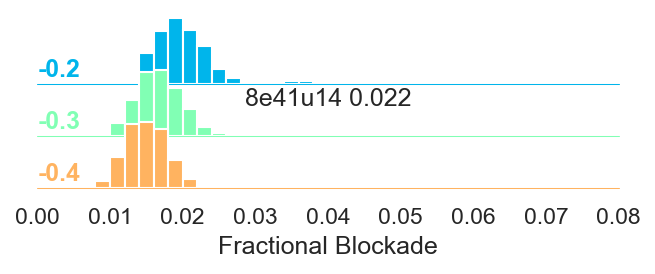

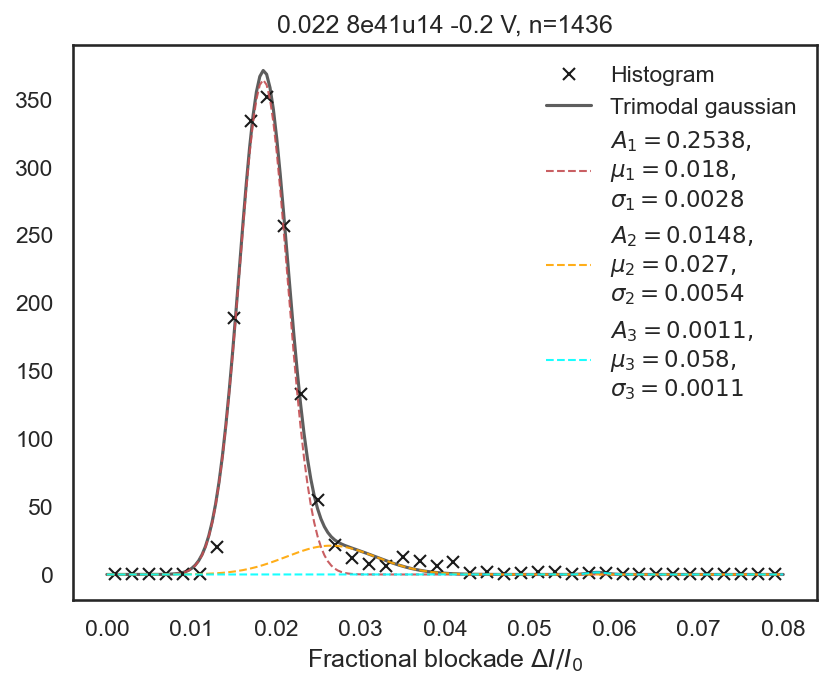

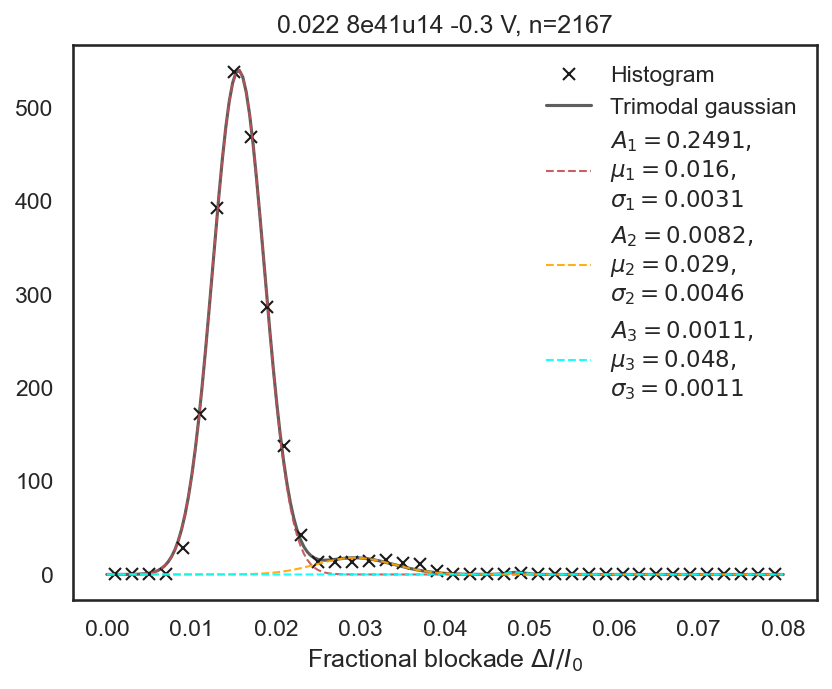

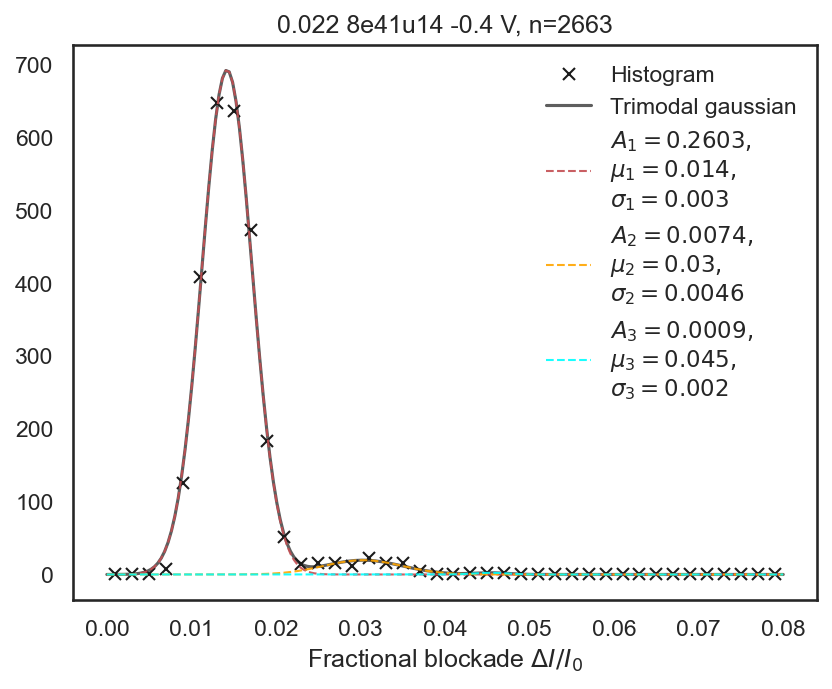

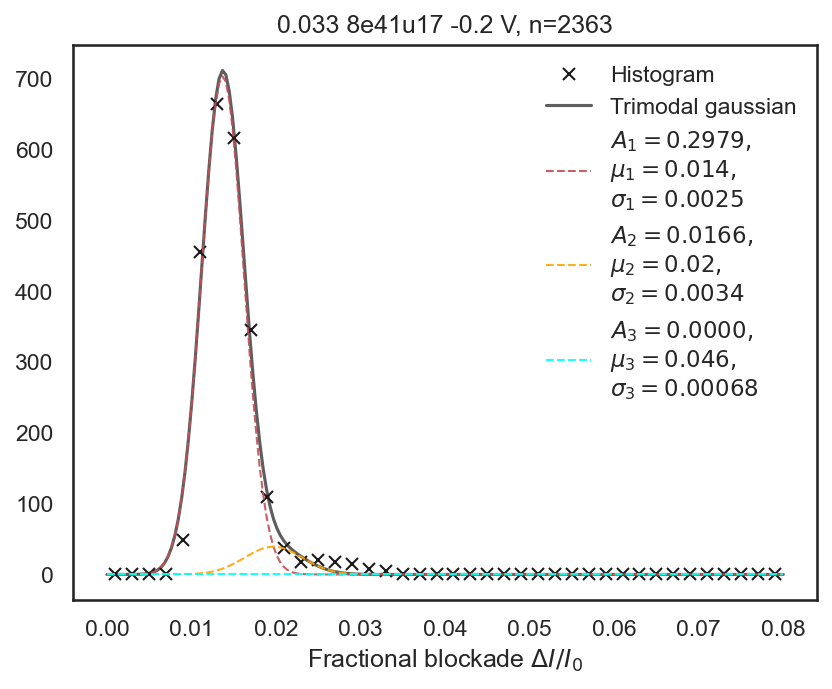

...

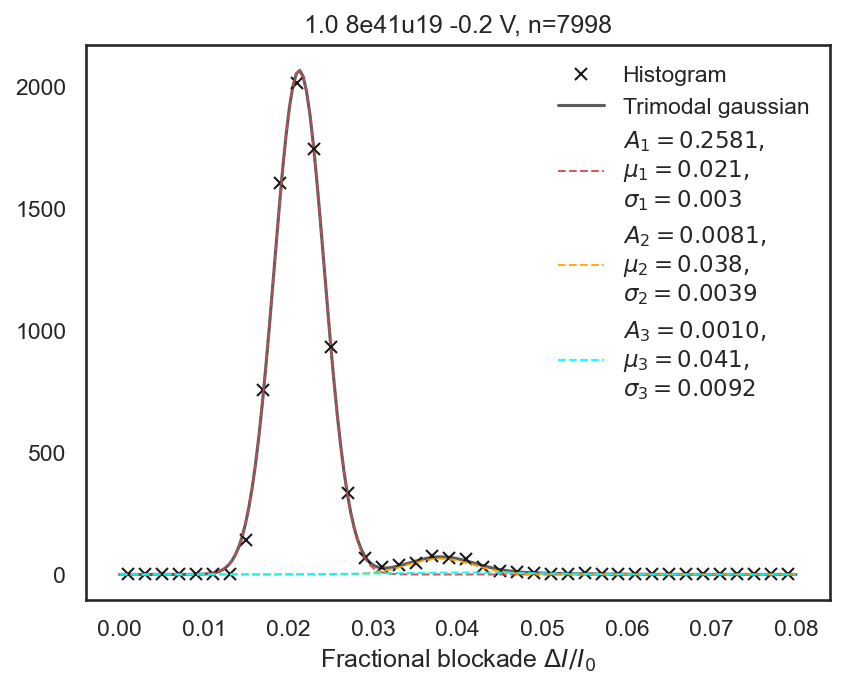

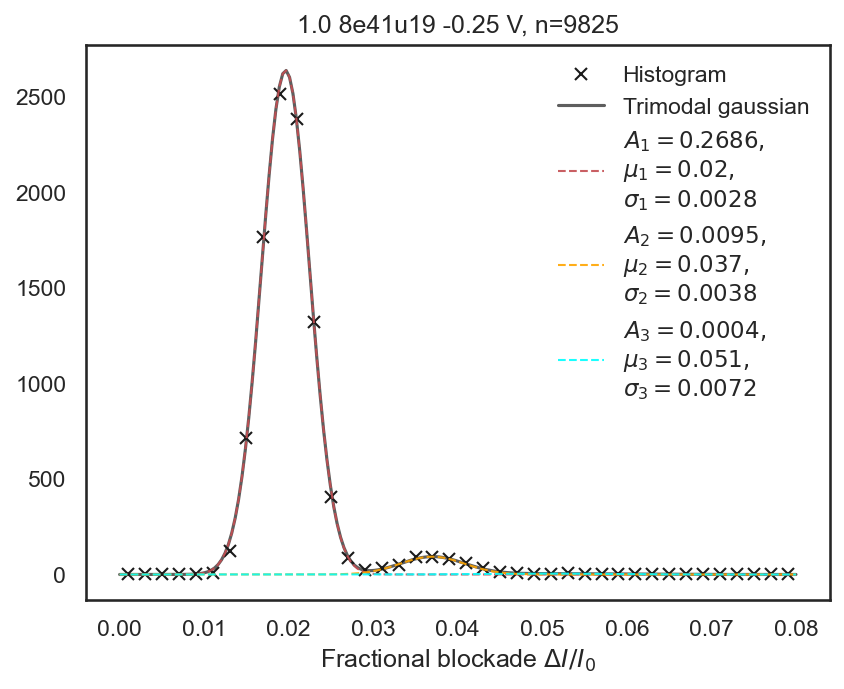

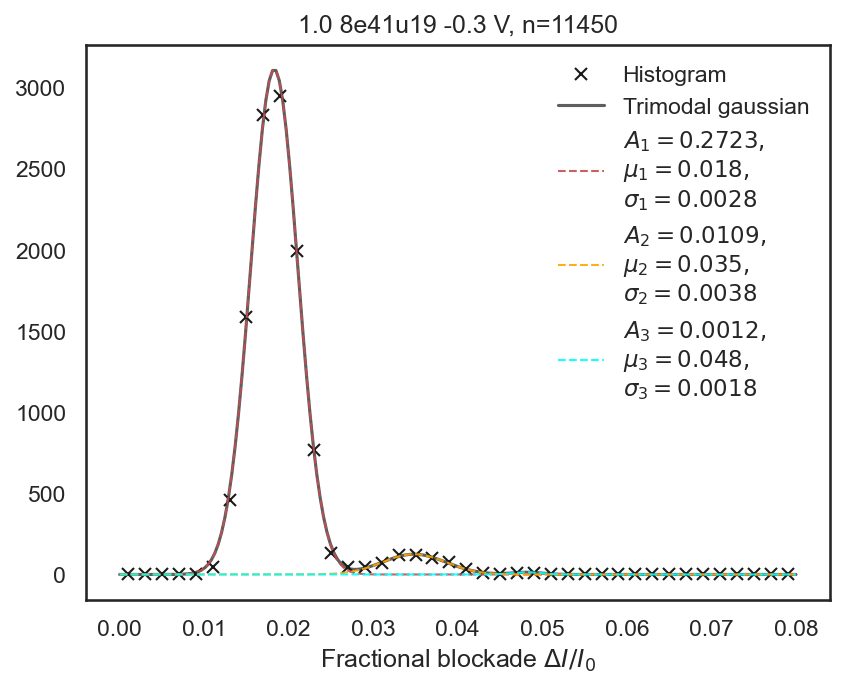

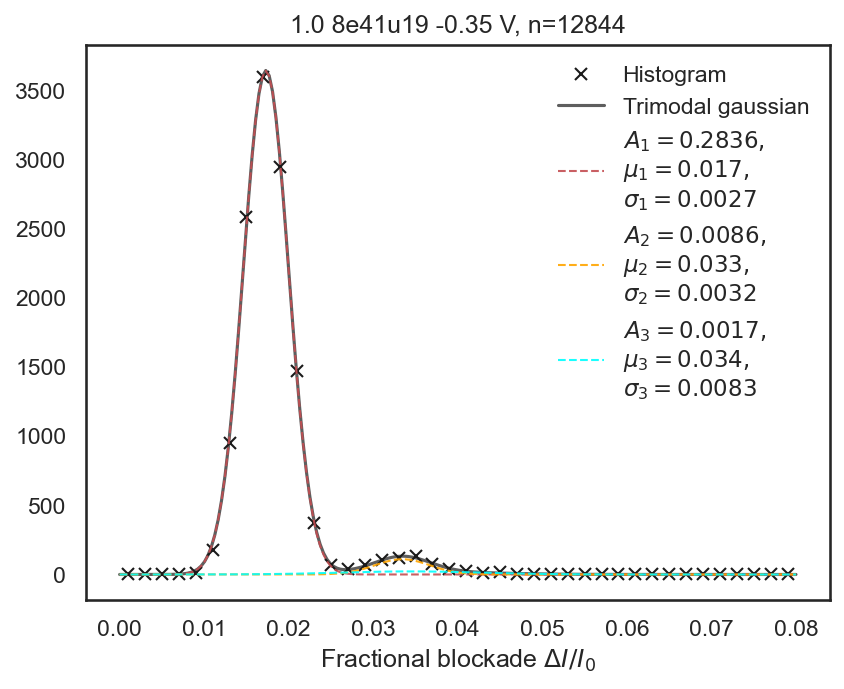

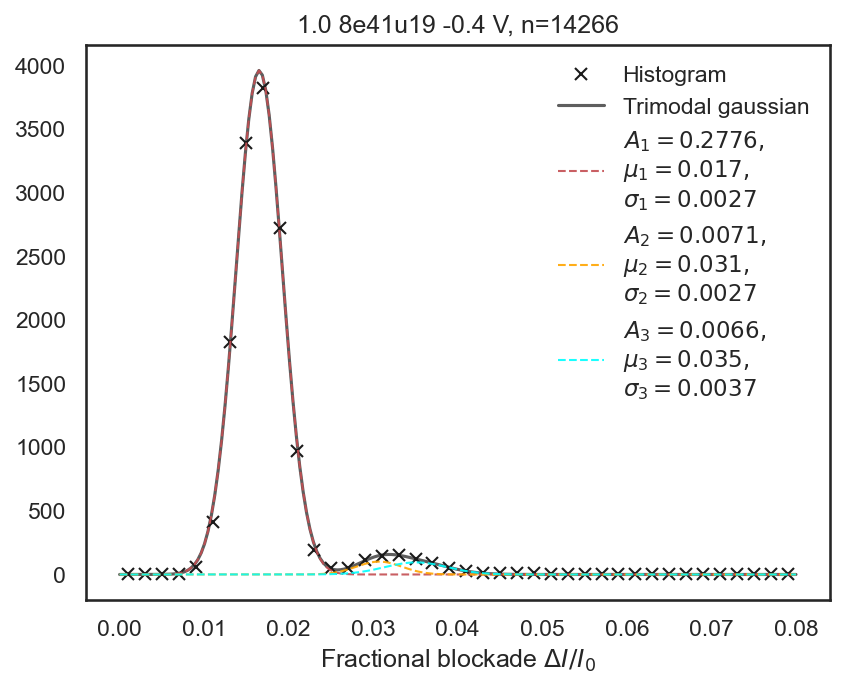

In [419]:
# %matplotlib inline
master_df['Voltage (V)']=(master_df['voltage'].round(3)).astype(str)
frac_df=master_df.loc[~master_df["pore_id"].isin(["8e41u14M1","8e41u14M3",'8e41u16M2','8e41u19M1','8e41u19M2'])]
frac_df=frac_df.loc[~((frac_df["chip_id"]=="8e41u17" )&(frac_df["Voltage (V)"]=="-0.4"))]
for (chip_id,dilution,file),_df in frac_df.groupby(['chip_id','Dilution','file']):
    
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    # _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    binrange=[0,0.08]
    binwidth=0.002
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=binrange)
    g.map(sns.histplot, "frac",
      binwidth=binwidth,binrange=binrange, clip_on=True,
      fill=True, alpha=1, linewidth=1,common_norm=True)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
    # g.map(sns.histplot, "frac", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0, linewidth=0.5, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'Amplitude (nA)')
    g.figure.subplots_adjust(hspace=-0.25)
    g.set_titles("")
    g.set(yticks=[], ylabel="",xlabel="Fractional Blockade")
    g.despine(bottom=True, left=True)
    plt.title(f"{chip_id} {dilution}")
    break
# print(df.head())

for [chip_id,dilution,voltage],_dff in frac_df.groupby(["Dilution","chip_id","Voltage (V)"]):   
     
    
    y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=False)
    # y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
    plt.figure(dpi=150)
    ns=int(np.sum(y_vals))
    plt.plot(x_vals,y_vals,'kx',label="Histogram")
    plt.title(f"{chip_id} {dilution} {voltage} V, n={ns}")
    popt=trimodal_fit(_dff["frac"].values,binwidth=binwidth,binrange=binrange)
    xfine=np.linspace(binrange[0],binrange[1],200)
    plt.plot(xfine,ns*trimodal_gauss(xfine,*popt),lw=1.5,alpha=0.7,c='k',label="Trimodal gaussian")
    plt.plot(xfine,ns*single_gauss(xfine,*popt[:3]),'r--',alpha=0.9,lw=1,label=f"$A_1={popt[0]:.4f},$\n$ \mu_1 = {popt[1]:.2g},$\n$ \sigma_1 = {popt[2]:.2g}$")
    
    
    plt.plot(xfine,ns*single_gauss(xfine,*popt[3:6]),'--',c='orange',alpha=0.9,lw=1,label=f"$A_2={popt[3]:.4f},$\n$ \mu_2 = {popt[4]:.2g},$\n$ \sigma_2 = {popt[5]:.2g}$")
    
    plt.plot(xfine,ns*single_gauss(xfine,*popt[6:]),'--',c='cyan',alpha=0.9,lw=1,label=f"$A_3={popt[6]:.4f},$\n$ \mu_3 = {popt[7]:.2g},$\n$ \sigma_3 = {popt[8]:.2g}$")
    
    
    plt.xlabel("Fractional blockade $\Delta I/I_0$")
    plt.legend(frameon=False,facecolor="w")
    # print(len(hist_result),len(x_vals))
  

In [ ]:
# for pore_id, _df in master_df.groupby(["pore_id","dil"]):
    # print()
    # print(pore_id)


frac_rate


# tempdf=master_df.drop(columns=["frac","deli","deli_to_avg","dt","tpeak","baseline","baseline_std","dwell","peak_val"])
# ratedf=tempdf.drop_duplicates(ignore_index=True)
# for gp, _rdf in ratedf.groupby(["pore_id","Dilution","voltage"],as_index=False):
#     med=_rdf["rate"].median()
#     ratedf.loc[_rdf.index,"rate_median"]=med

# ratedf=ratedf.drop(columns=["step_id","rate"])
# ratedf=ratedf.drop_duplicates(ignore_index=True)
# # ratedf["median_rate"]=ratedf["
# # ratedf=ratedf.groupby(["pore_id","Dilution"])


# # ratedf=tempdf.groupby(["pore_id","dil","voltage"])
# # ratedf.head()
# ratedf=ratedf.loc[ratedf["rate_median"]>1]

# # ratedf=ratedf.loc[(ratedf["pore_id"]!="8e41u14M1") & (ratedf["pore_id"]!="8e41u14M3")]
# # ratedf=ratedf.loc[ratedf["chip_id"]!="8e41u25"]

# # sns.lineplot(ratedf.loc[ratedf["chip_id"]=='8e41u14'],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")
# sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="B-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="flare")

# sns.lineplot(ratedf.loc[ratedf["vlp_type"]=="S-VLP"],x='Dilution',y='rate_median',hue="voltage",style="vlp_type",palette="crest")
# plt.ylabel("Capture rate")
# plt.xlabel("Dilution")
# plt.loglog()
# ratedf.head(24)


In [13]:
experimentfilelist=list(EDHReader().read(files,voltage_compress=True))
# experimentfilelist=[]
# for file in files:
#     print(file)
#     experimentfilelist.append(EDHReader().read(file,voltage_compress=True))

experiment=[dt.TraceFile(current,voltage,parent=sfm,metadata=metadata,
                         unique_features={"sampling_freq":metadata["Sampling frequency (SR)"]}) for metadata,current,voltage in experimentfilelist]
for tf in experiment:
    # filt(tf.current[:],200000,25000,4)
    filt_butter(tf.current[:],200000,25000,8)
    select(tf,n_remove=4000)
    
    
    

print(gc.collect())

100059


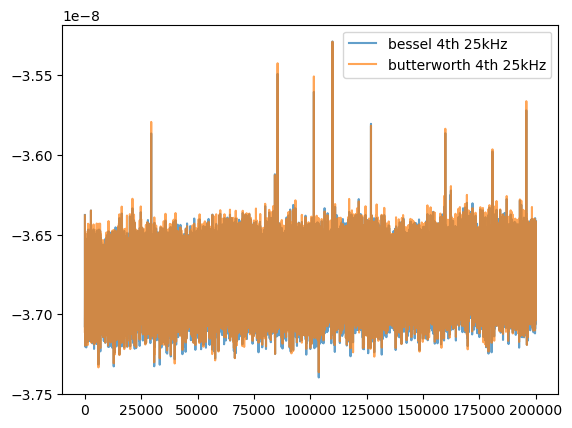

In [5]:
# experimentfilelist=list(EDHReader().read(files,voltage_compress=True))
# experiment=[dt.TraceFile(current,voltage,parent=sfm,metadata=metadata,
#                          unique_features={"sampling_freq":metadata["Sampling frequency (SR)"]}) for metadata,current,voltage in experimentfilelist]
# for tf in experiment[0:1]:
#     bessel_signal=filt(tf.current[3000000:3200000],200000,25000,4,inplace=False)
#     butter_signal=filt_butter(tf.current[3000000:3200000],200000,25000,4,inplace=False)
#     plt.plot(bessel_signal,alpha=0.7,label="bessel 4th 25kHz")
#     plt.plot(butter_signal,alpha=0.7,label="butterworth 4th 25kHz")
    
# plt.legend()
#     # select(tf,n_remove=4000)

(5000.0, 100000.0)

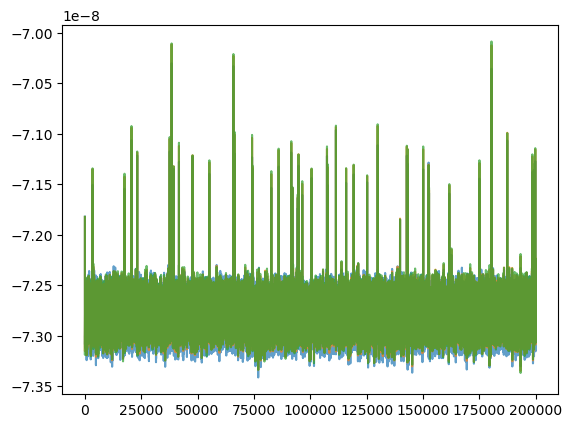

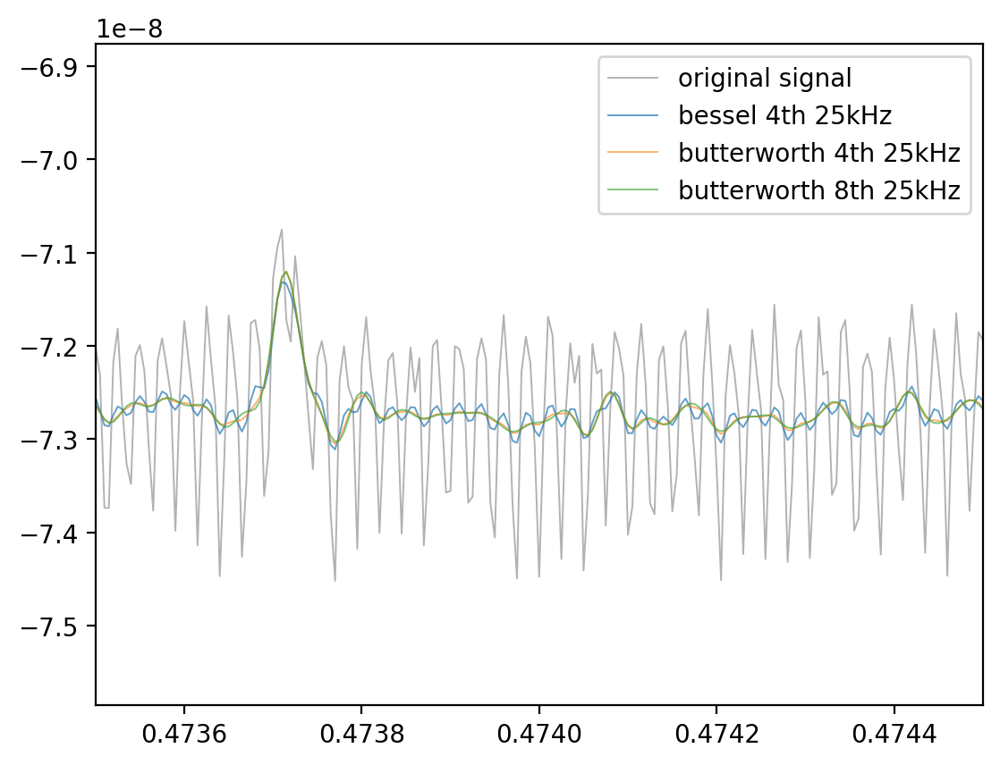

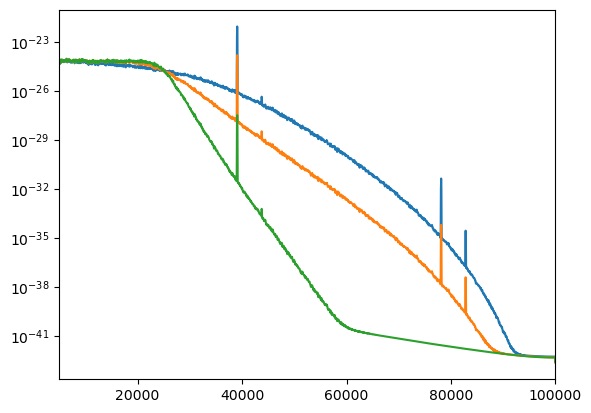

In [37]:
plt.figure()
start=83000000
end=83200000
for tf in experiment[0:1]:
    bessel_signal=filt(tf.current[start:end],200000,25000,4,inplace=False)
    butter_signal=filt_butter(tf.current[start:end],200000,25000,4,inplace=False)
    butter_signal8=filt_butter(tf.current[start:end],200000,25000,8,inplace=False)
    plt.plot(bessel_signal,alpha=0.7,label="bessel 4th 25kHz")
    plt.plot(butter_signal,alpha=0.7,label="butterworth 4th 25kHz")
    plt.plot(butter_signal8,alpha=0.7,label="butterworth 4th 25kHz")
plt.figure(dpi=200)
t=np.arange(0,end-start)/200000
plt.plot(t,tf.current[start:end],c='k',lw=0.7,alpha=0.3,label="original signal")
plt.plot(t,bessel_signal,lw=0.7,alpha=0.7,label="bessel 4th 25kHz")
plt.plot(t,butter_signal,lw=0.7,alpha=0.6,label="butterworth 4th 25kHz")
plt.plot(t,butter_signal8,lw=0.7,alpha=0.6,label="butterworth 8th 25kHz")
plt.legend()
plt.xlim(94700/200000,94900/200000)

plt.figure()
fs = 200e3
f, Pxx_den = signal.welch(bessel_signal, fs, nperseg=2*2048)
f2, Pxx_den2 = signal.welch(butter_signal, fs, nperseg=2*2048)
f3, Pxx_den3 = signal.welch(butter_signal8, fs, nperseg=2*2048)
# fnotch,Pxx_denNotch=signal.welch(cn,fs,nperseg=2*4096)
plt.semilogy(f, Pxx_den)
plt.semilogy(f2, Pxx_den2)
plt.semilogy(f3, Pxx_den3)
# plt.semilogy(fnotch, Pxx_denNotch)
# # plt.xlim(48,49)
plt.xlim(5000,100000)


In [40]:
sfm.clear_children()

{'EDH Version': '2.0', 'Channels': '1', 'Range': 2e-07, 'Sampling frequency (SR)': 200000.0, 'Final Bandwidth': 100000.0, 'Oversampling x4': 'disabled', 'Acquisition start time': '06/01/2023 20:46:43.653\n', 'Active channels': '1', 'DataFiles': ['R506M1_FSBSATBead_CH001_000.abf', 'R506M1_FSBSATBead_CH001_001.abf'], 'StorageFormat': '.abf', 'HeaderFile': 'c:\\Users\\alito\\EDR\\R506M1_FSBSATBead_01\\R506M1_FSBSATBead.edh'}


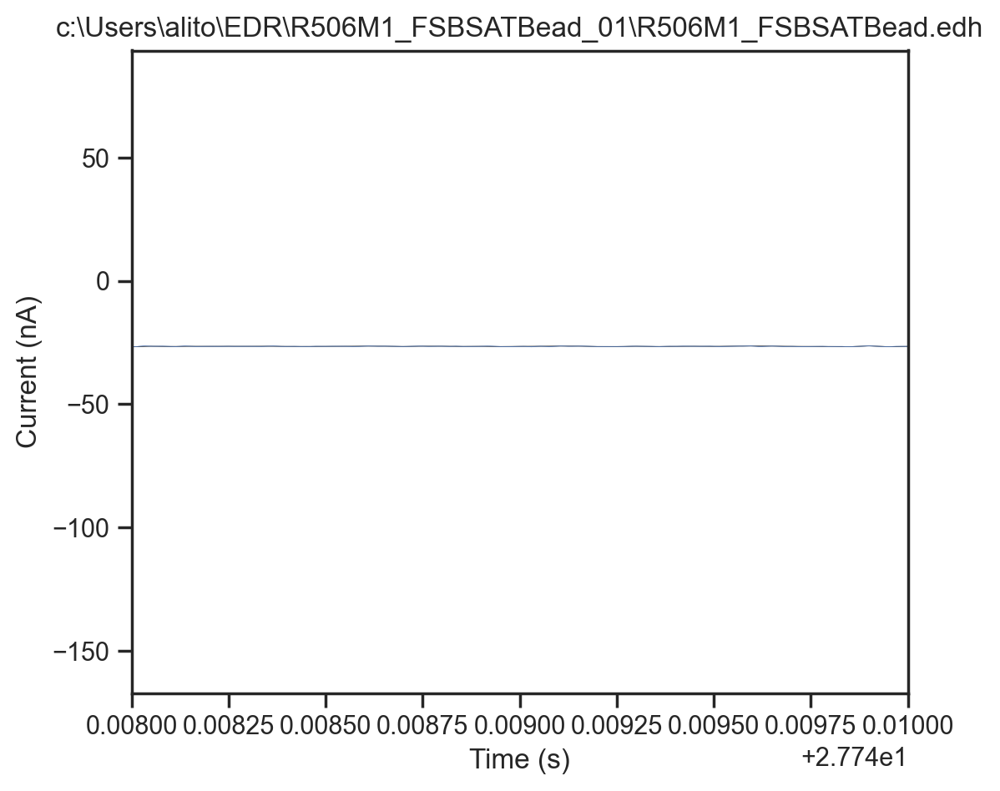

In [60]:
# %matplotlib inline


def plot(tracefile):
    plt.figure(figsize=[6,5],dpi=200)
    plt.plot(tracefile.t[::file_ds],1e9*tracefile.current[::file_ds],lw=0.3,c='k')
    for child in tracefile.traverse_to_rank("vstepgap"):
        plt.plot(child.t[::ds],1e9*child.current[::ds],lw=0.3)
        plt.xlabel("Time (s)")
        plt.ylabel("Current (nA)")
        plt.title(tracefile.metadata["HeaderFile"])
ds=1
file_ds=10
def plot_stds(tracefile):
    plt.figure(figsize=[10,5],dpi=250)
    for child in tracefile.children:
        plt.plot(child.t,np.ones(len(child.t))*child.std)

for tf in experiment:
    
    plot(tf)
    print(tf.metadata)
    plt.xlim(27.748,27.75)
    # plt.ylim(70,90)
    break
    # plot_stds(tf)




In [25]:
tf.metadata

{'EDH Version': '2.0',
 'Channels': '1',
 'Range': 2e-07,
 'Sampling frequency (SR)': 200000.0,
 'Final Bandwidth': 100000.0,
 'Oversampling x4': 'disabled',
 'Acquisition start time': '19/04/2023 23:32:08.274\n',
 'Active channels': '1',
 'DataFiles': ['T311M1_FBSATBead_419_CH001_000.abf',
  'T311M1_FBSATBead_419_CH001_001.abf',
  'T311M1_FBSATBead_419_CH001_002.abf'],
 'StorageFormat': '.abf',
 'HeaderFile': 'C:\\Users\\alito\\OneDrive - Northeastern University\\Wanunu Lab\\ViralNPQ\\Data\\Wanunu_optical_pc\\EDR\\T311M1_FBSATBead_419_01\\T311M1_FBSATBead_419.edh'}

In [8]:
%matplotlib qt
downsample=10

for tf in experiment:
    plt.figure(figsize=(8,8))#,dpi=300)
    ax1=plt.subplot(2,1,1)
    ax1.plot(tf.t[::downsample],tf.current[::downsample]*1e9,lw=0.3,c='k')
    ax1.set_ylabel("Current (nA)")
    name=os.path.split(os.path.split(tf.metadata["HeaderFile"])[0])[1]
    print(name)
    # print(tf.children[0].get_feature('file'))
    
    ax1.set_title(name)
    
    
    ax2=plt.subplot(2,1,2)
    ax2.plot(tf.t[200000*60*1:200000*60*3:1],tf.current[200000*60*1:200000*60*3:1]*1e9,lw=0.3,c='k')
    ax2.set_ylabel("Current (nA)")
    ax2.set_xlabel("Time (s)")
    # ax1.set_ylim(-200,100)
    ax2.set_ylim(-200,100)
    ax1.grid()
    ax2.grid()
    plt.savefig(os.path.join('exports-6-12-23',name+'.svg'))
    
    
    

T321M1_FBSATBead_601
T321M2_FBSATBead_601
T322M1_FBSATBead_601
T322M2_FBSATBead_601
T323M1_FBSATBead_601
T323M2_FBSATBead_601
T324M1_FSBSAT_606
T324M2_FSBSAT_606


In [9]:
import PythIon.parsers.parsers as parsers
importlib.reload(parsers)

parser_params={"height":(1.0,0.8),
               "prominence":(-0.01,-0.15),
               "width":(5e-6,2e-2)
               }
# parser=parsers.SpikeParser(**parser_params)
# step=experiment[1].traverse_to_rank("vstepgap")[12]
# step.parse(parser,newrank="event")
# print(step.t[0],step.parent.t[0],step.parent.unique_features['voltage'])
# print(step.parent.parent.metadata)
# print(len(experiment[1].traverse_to_rank("vstepgap")[13].children))

In [39]:
for child in sfm.traverse_to_rank("vstepgap"):
    child.clear_children()

In [27]:
import PythIon.parsers.parsers as parsers
importlib.reload(parsers)
# parser_params={"height":(1.0,0.8),
#                "prominence":(-0.02,-0.2),
#                "width":(10e-6,3e-2),
#                "distance":500e-6
#                }
# parser_params={"height":(1.0,0.8),
#                "prominence_snr":(0.002,0.15),
#                "width":(10e-6,5e-2),
#                "distance":200e-6
            #    }
# parser_params={"height":(1.0,0.8),
#                "prominence_snr":(0.0019,0.2),
#                "width":(10e-6,5e-2),
#                "distance":400e-6
#                }
parser_params={"height":(1.0,0.8),
               "prominence_snr":(0.0027,0.2),
            #    "prominence":(-0.019,-0.2),
               "width":(5e-6,5e-2),
               "distance":200e-6
               }
parser=parsers.SpikeParser(**parser_params)
print(len(sfm.children))
files_to_pick=["8e4_1u18M2","8e4_1u22M2"]

selection_for_plot=[tf for tf in sfm.children if "8e4_1u16M3" in tf.metadata["HeaderFile"] or "8e4_1u22M2" in tf.metadata["HeaderFile"]]
for tf in selection_for_plot:
    for child in tf.traverse_to_rank("vstepgap"):
    # if -0.31<child.get_feature('voltage')<-0.29 and child.std<4e-9:
    #     child.parse(parser,newrank="event")
        child.clear_children()
        
        if -0.41<child.get_feature('voltage')<-0.19 and child.std<1.2e-9:
            try:
                child.parse(parser,newrank="event")
            except AssertionError:
                pass
len(experiment[0].traverse_to_rank("event"))


48


0

In [31]:
print(len(selection_for_plot))

2


In [62]:
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
# matplotlib.rcParams['ps.fonttype'] = 42
plt.rcParams["pdf.use14corefonts"] = False
plt.rcParams["font.family"]=["Arial"]
plt.rcParams["ps.useafm"] = True
plt.rcParams["figure.dpi"]=150

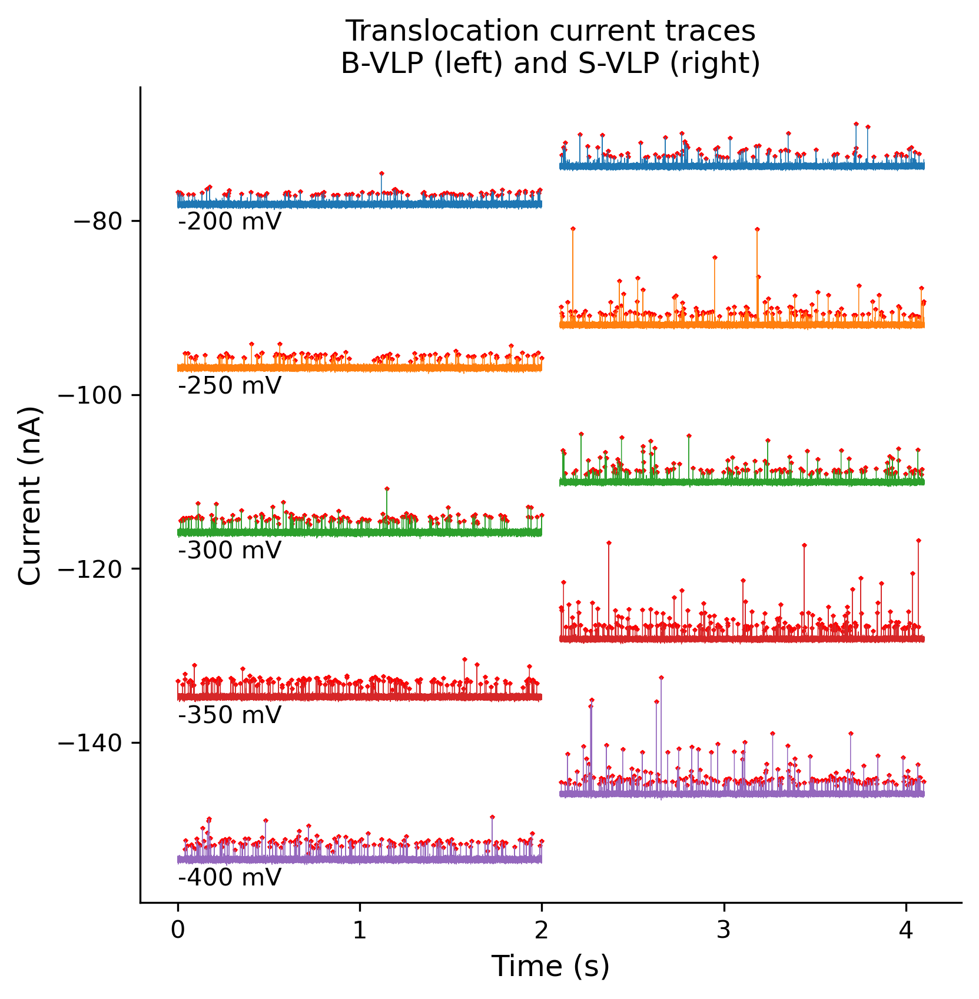

In [43]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]
plt.close("all")
plt.figure(figsize=(6,6),dpi=300)
x=-1

for tf in selection_for_plot:
    selected_vstep={}
    
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.199 and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    for step in selection:
        selected_vstep[f"{step.get_feature('voltage')*1000:.0f}"]=step
    selection=list(selected_vstep.values())
    start=2
    length=2
    gap=0.1
    
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    
    
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=1
            if x==0:
                plt.text(0,segment.mean*1e9-3 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            plt.plot(t+x*length+x*gap,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            # plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
                try:
                    t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start+x*length+x*gap
                    peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
                    plt.scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='r',s=1)
                except: 
                    pass
                t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start+x*length+x*gap
                
                peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
                plt.scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=1)
            # x+=1
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
    
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    # plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")
    plt.gca().set_prop_cycle(None)

        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
    plt.title("Translocation current traces\nB-VLP (left) and S-VLP (right)")
    
    
# plt.savefig("EDR\\export_example_traces_T317M2.svg",bbox_inches="tight")


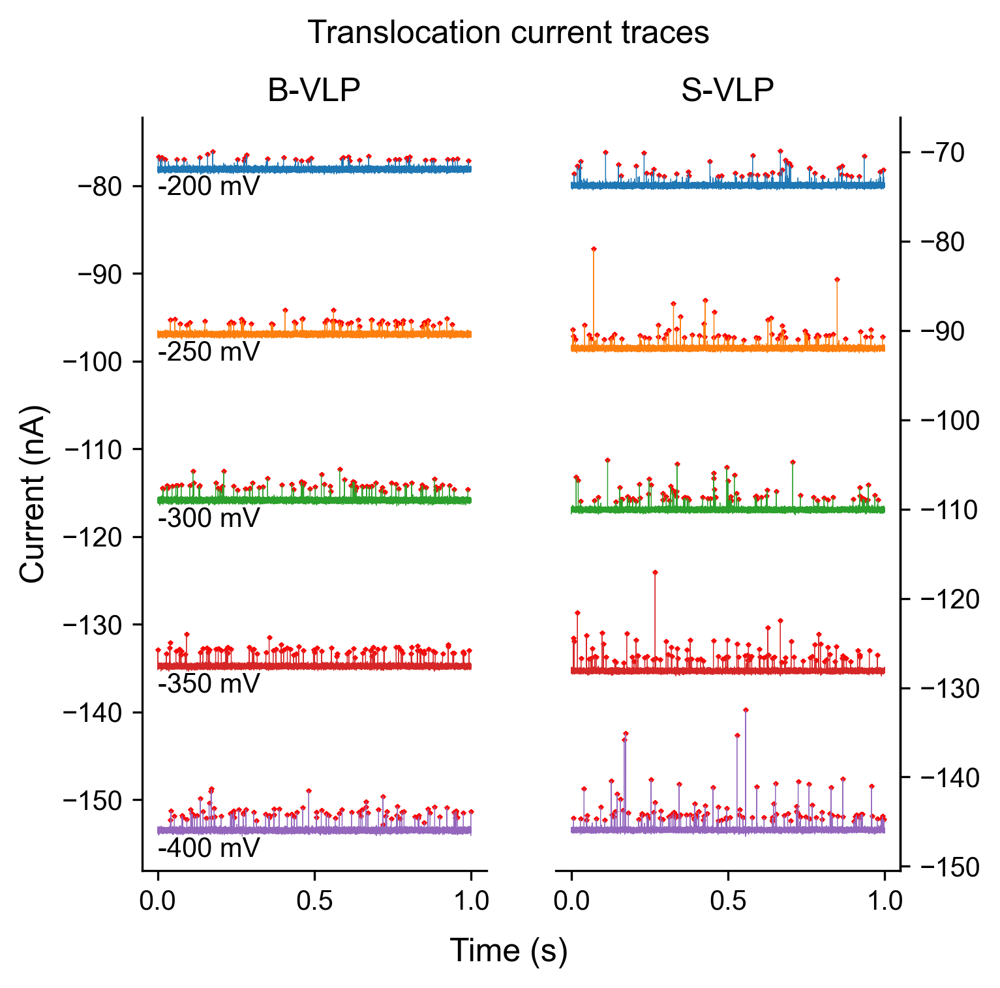

In [64]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]
plt.close("all")
fig,axs=plt.subplots(1,2,figsize=(5,5),dpi=300)
x=-1

for i,tf in enumerate(selection_for_plot):
    selected_vstep={}
    
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.199 and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    for step in selection:
        selected_vstep[f"{step.get_feature('voltage')*1000:.0f}"]=step
    selection=list(selected_vstep.values())
    start=2
    length=1
    gap=0.1
    
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    
    
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=1
            if x==0:
                axs[i].text(0,segment.mean*1e9-3 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            axs[i].plot(t,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            # plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
                try:
                    t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start
                    peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
                    axs[i].scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='r',s=1)
                except: 
                    pass
                t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start
                
                peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
                axs[i].scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=1)
            # x+=1
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
    axs[i].spines["top"].set_visible(False)
axs[0].spines["right"].set_visible(False)
axs[1].spines["left"].set_visible(False)
    # plt.gca().spines["top"].set_visible(False)
axs[0].set_ylabel("Current (nA)")
axs[1].secondary_yaxis("right")
axs[1].set_yticks([])
fig.supxlabel("Time (s)")
    # plt.gca().set_prop_cycle(None)

        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()

fig.suptitle("Translocation current traces")
axs[0].set_title("B-VLP")
axs[1].set_title("S-VLP")
    
    
plt.savefig("VLP_paper_exports\Fig2\\export_example_traces_B-S_1sec_split-y.pdf",bbox_inches="tight")



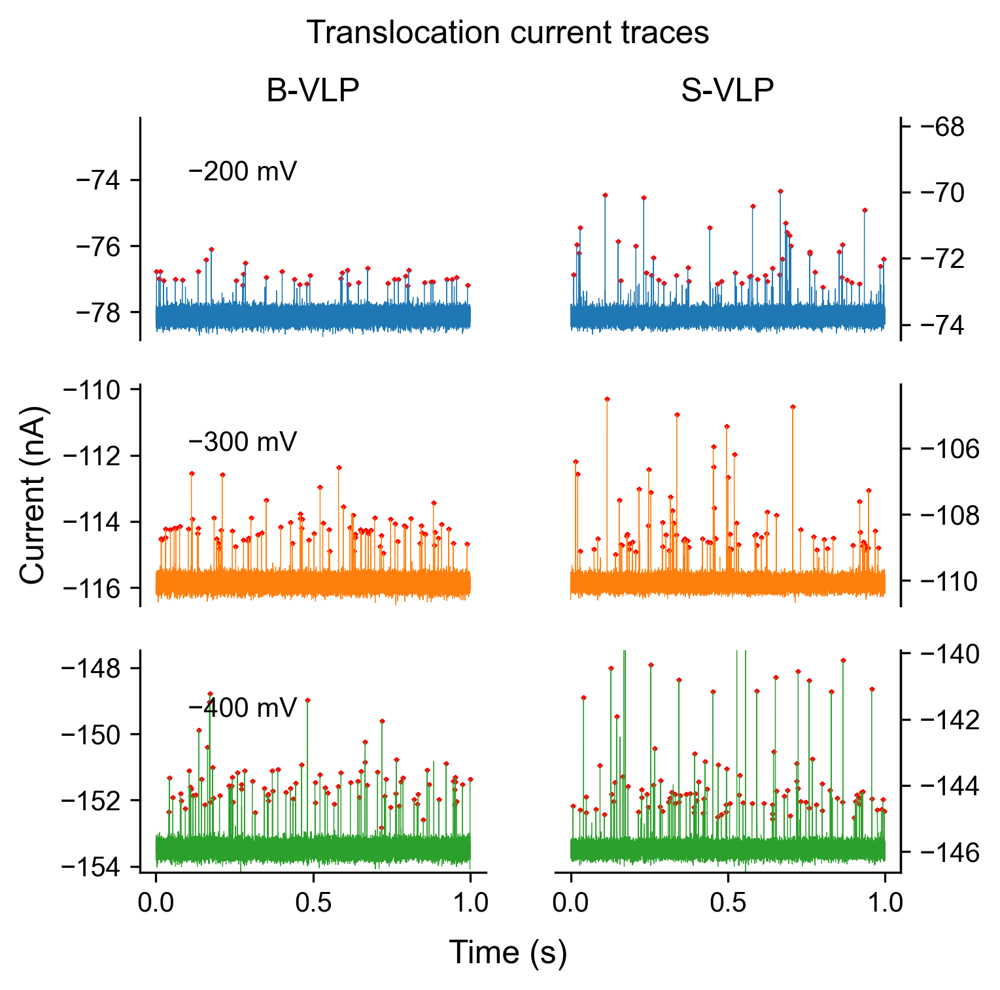

In [99]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]
plt.close("all")
fig,axs=plt.subplots(3,2,figsize=(5,5),dpi=300,sharex='row')
axs=axs.transpose()
x=-1

from itertools import cycle

prop_cycle = plt.rcParams['axes.prop_cycle']
colors = cycle(prop_cycle.by_key()['color'])


for i,tf in enumerate(selection_for_plot):
    selected_vstep={}
    
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.199 and not np.isclose(step.get_feature('voltage'), -0.25) and not np.isclose(step.get_feature('voltage'), -0.35) and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    for step in selection:
        selected_vstep[f"{step.get_feature('voltage')*1000:.0f}"]=step
    selection=list(selected_vstep.values())
    start=2
    length=1
    gap=0.1
    
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    
    # sub=4
    colors = cycle(prop_cycle.by_key()['color'])
    for j,segment in enumerate(selection):
        try:
            
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=1
            if x==0:
                axs[i,j].text(0.1,segment.mean*1e9+4 , f"−{-segment.get_feature('voltage')*1000:.0f} mV")
            
            current_base=np.mean(1e9*segment.current[start*sampling_freq:start*sampling_freq+int(0.01*sampling_freq)])
            
            axs[i,j].plot(t,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3,color=next(colors))
            # plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
                try:
                    t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start
                    peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
                    axs[i*3+j].scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='r',s=1)
                except: 
                    pass
                t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start
                
                peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
                axs[i,j].scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=1)
            # x+=1
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
        axs[i,j].spines["top"].set_visible(False)
        axs[i,j].set_ylim(current_base-0.7,current_base+6)
axs[0,0].spines["right"].set_visible(False)
axs[0,1].spines["right"].set_visible(False)
axs[0,2].spines["right"].set_visible(False)
axs[1,0].spines["left"].set_visible(False)
axs[1,1].spines["left"].set_visible(False)
axs[1,2].spines["left"].set_visible(False)
    # plt.gca().spines["top"].set_visible(False)
axs[0,1].set_ylabel("Current (nA)")
axs[1,0].secondary_yaxis("right")
axs[1,0].set_yticks([])
axs[1,1].secondary_yaxis("right")
axs[1,1].set_yticks([])
axs[1,2].secondary_yaxis("right")
axs[1,2].set_yticks([])
axs[0,0].set_title("B-VLP")
axs[1,0].set_title("S-VLP")
    
for ax in axs.transpose().ravel()[:4]:
    ax.set_xticks([])
    ax.spines["bottom"].set_visible(False)

fig.supxlabel("Time (s)")
    # plt.gca().set_prop_cycle(None)

        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()

fig.suptitle("Translocation current traces")

    
# plt.savefig("VLP_paper_exports\Fig2\\export_example_traces_B-S_1sec_split-y_subplots.pdf",bbox_inches="tight")



8e4_1u14M2_FBSATBead1102_x0_022
8e4_1u14M2_FBSATBead1102_x0_046
8e4_1u14M2_FBSATBead1102_x0_1
8e4_1u14M2_FBSATBead1102_x0_22
8e4_1u14M2_FBSATBead1102_x0_46
8e4_1u14M2_FBSATBead1102_x1_0
8e4_1u14M4_FBSATBead1102_x0_022
8e4_1u14M4_FBSATBead1102_x0_046
8e4_1u14M4_FBSATBead1102_x0_1
8e4_1u14M4_FBSATBead1102_x0_22
8e4_1u14M4_FBSATBead1102_x0_46
8e4_1u14M4_FBSATBead1102_x1_0


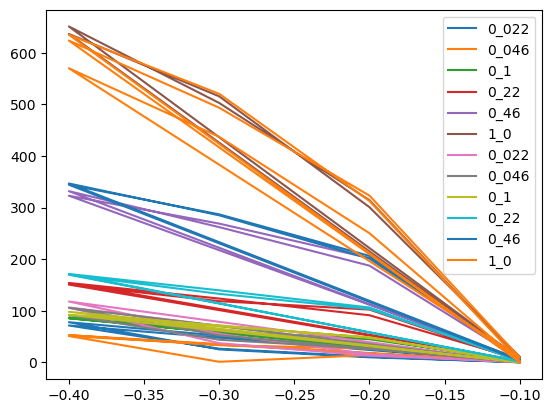

In [193]:
plt.figure(clear=True)
for tf in sfm.traverse_to_rank("file"):
    print(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
    voltage_event_pairs=np.array([(step.get_feature("voltage"), len(step.children)/step.duration) for step in tf.traverse_to_rank('vstepgap') if step.get_feature('voltage')<-0.099]).transpose()
    # print(voltage_event_pairs)
    plt.plot(voltage_event_pairs[0],voltage_event_pairs[1],label=tf.get_feature('metadata')['HeaderFile'].split("\\")[-2].split('x')[1])
    
# plt.semilogy()
plt.legend()

C:\Users\alito\AppData\Local\Temp\ipykernel_40288\1027210057.py:36: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  plt.semilogy(f, Pxx_den)


(5000.0, 100000.0)

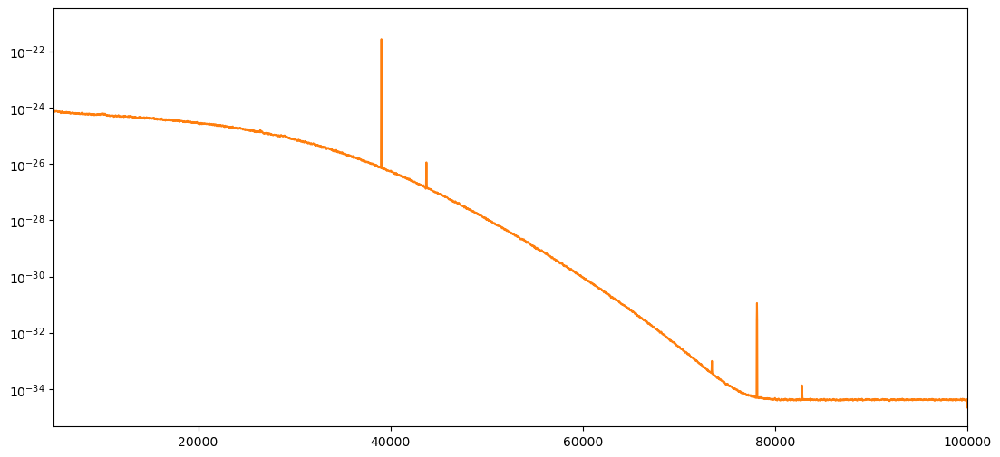

In [10]:
%matplotlib inline
from scipy import signal
plt.figure(figsize=[13,6])
step=sfm.children[-2].traverse_to_rank("vstepgap")[6]
plt.plot(step.t,step.current)
# fcenter=18000
# w=300

# cn=notch(step.current,200000,fcenter-w/2,fcenter+w/2,2,inplace=False)
# fcenter=21200
# w=300

# cn=notch(cn,200000,fcenter-w/2,fcenter+w/2,2,inplace=False)
# plt.plot(step.t,cn,c='r')
# # b=blob_log(step.current*1e9,threshold_rel=0.1,num_sigma=6,min_sigma=4,max_sigma=11)
# # idxs=np.array([round(blob[0])for blob in b])
# # peaks=step.current[idxs]
# # plt.scatter(step.t[idxs],peaks,c='r')

# %timeit

# b=blob_log(step.current*1e9,threshold_rel=0.2,num_sigma=7,min_sigma=3,max_sigma=12,log_scale=True)
# idxs=np.array([round(blob[0])for blob in b])
# peaks=step.current[idxs]
# plt.scatter(step.t[idxs],peaks,c='g',alpha=0.4)


# # pc=signal.find_peaks_cwt(step.current[:80000],widths=8,min_snr=3)
# # plt.scatter(step.t[pc],step.current[pc],c='k',alpha=0.4)
# plt.xlim(180,181)
# plt.figure()
# # plt.hist(b[...,1])
fs = 200e3
f, Pxx_den = signal.welch(step.current, fs, nperseg=2*4096)
# fnotch,Pxx_denNotch=signal.welch(cn,fs,nperseg=2*4096)
plt.semilogy(f, Pxx_den)
# plt.semilogy(fnotch, Pxx_denNotch)
# # plt.xlim(48,49)
plt.xlim(5000,100000)
# plt.ylim(1e-26,1e-24)

8e4_1u19M4_FBSATBead1114_x0_1
0.1
8e4_1u20M1_FSBSATBead1205_x0_1
0.1
8e4_1u20M2_FSBSATBead1205_x0_1
0.1
8e4_1u20M3_FSBSATBead1205_x0_1
0.1
8e4_1u20M4_FSBSATBead1205_x0_1
0.1


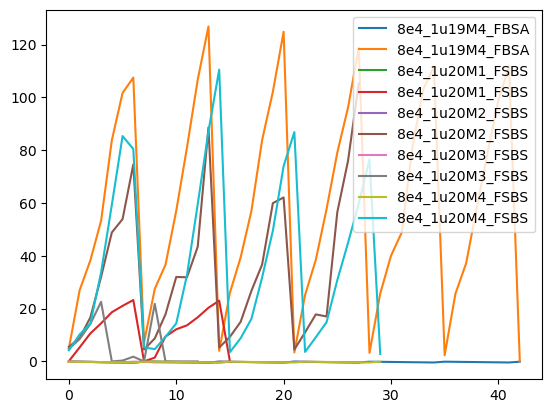

In [49]:
for tf in sfm.traverse_to_rank("file"):
    print(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
    # max_set=(events)
    c=tf.unique_features["concentration"]=float(tf.get_feature('metadata')['HeaderFile'].split('\\')[-1].split('.')[0].split("x")[-1].replace("_",'.'))
    print(c)
    voltage_event_pairs=[(step.get_feature("voltage"), len(step.children)/step.duration) for step in tf.traverse_to_rank('vstepgap') if step.get_feature('voltage')<-0.099]
    
    plt.plot(voltage_event_pairs,label=tf.get_feature('metadata')['HeaderFile'].split('\\')[-2][:15])
# plt.semilogy()
plt.legend()

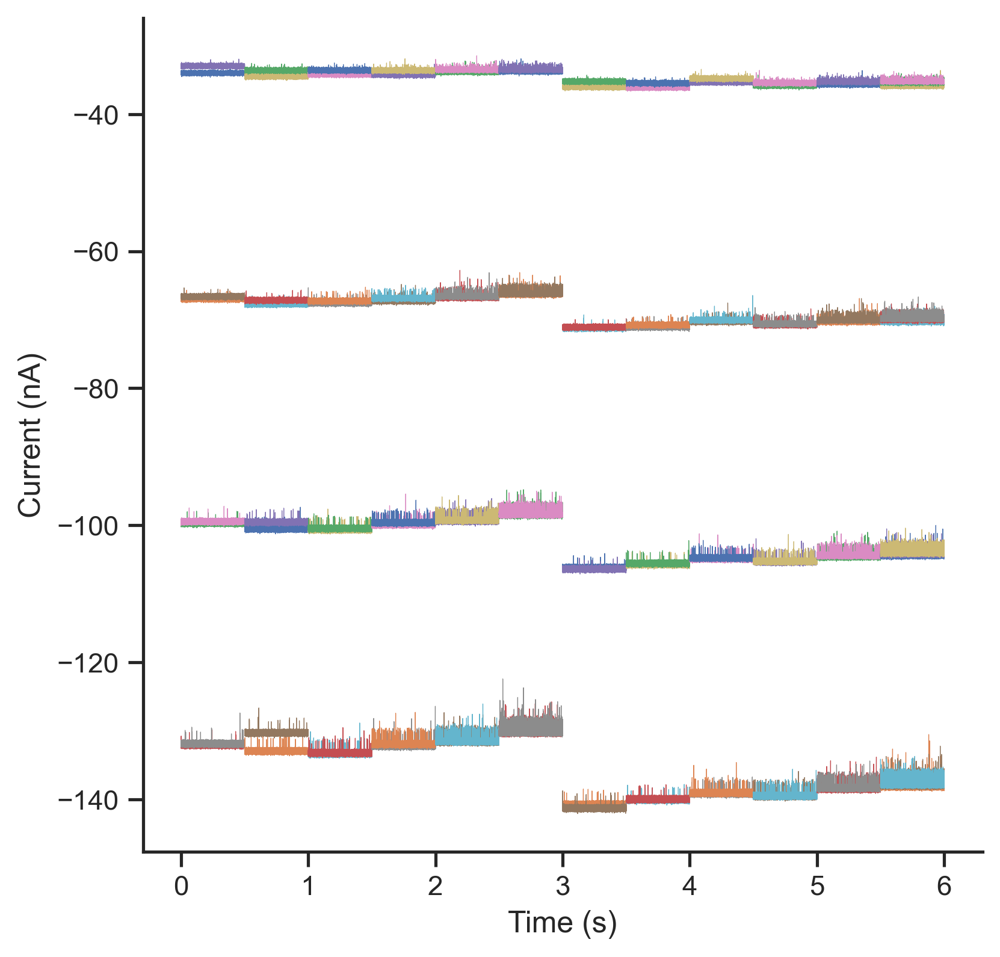

In [259]:
# %matplotlib qt
# plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]
plt.figure(figsize=(6,6),dpi=300)
t0=0
for tf in sfm.traverse_to_rank("file"):
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=0.5
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    
    for i,segment in enumerate(selection):
        # if i==6:
        #     break
        try:
            plt.plot(t+t0,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            # plt.text(1.017*length,segment.mean*1e9 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            idx_rel=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length])
            
            if len(idx_rel)>0:    
                t_rel=segment.t[idx_rel]-segment.t[0]-start
                peak_vals=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length])
                
                # plt.scatter(t_rel, 1e9*peak_vals,marker=7,c='r',s=2)
            # t+=length/2
            # plt.text()
        except Exception as e:
            raise (e)
    t0+=length
    
plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)
plt.ylabel("Current (nA)")
plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
# plt.title(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
plt.savefig("export_example_traces_1u14_1110.svg",bbox_inches="tight")


C:\Users\alito\AppData\Local\Temp\ipykernel_3772\1829398994.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(4.5,6),dpi=200)


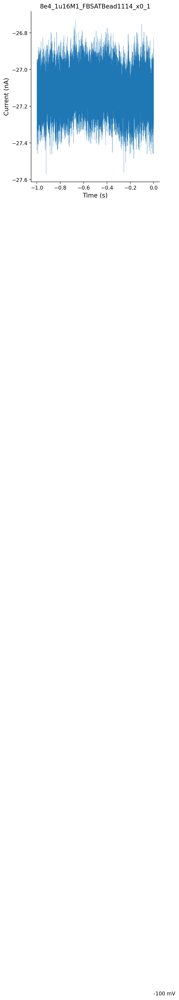

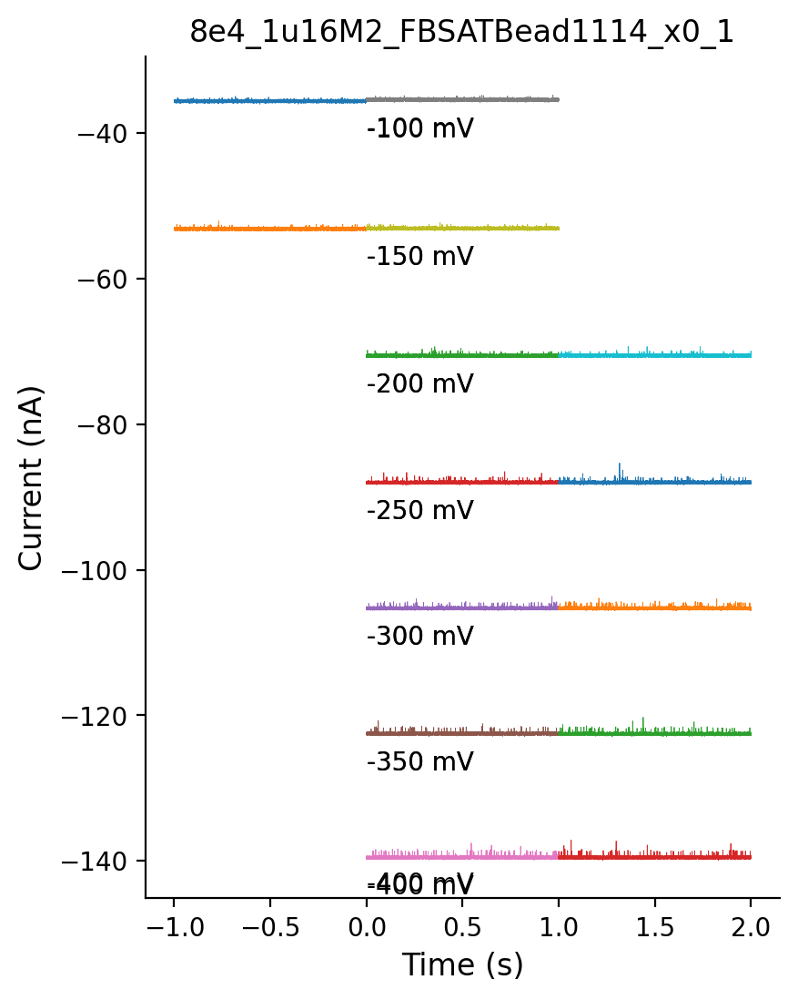

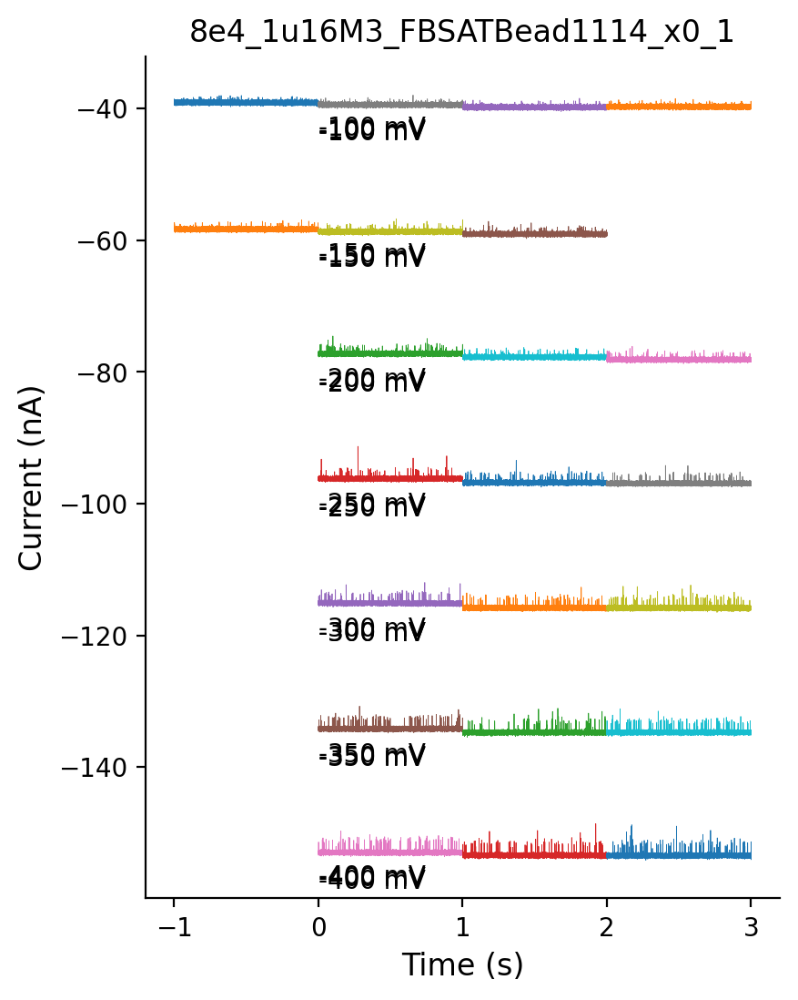

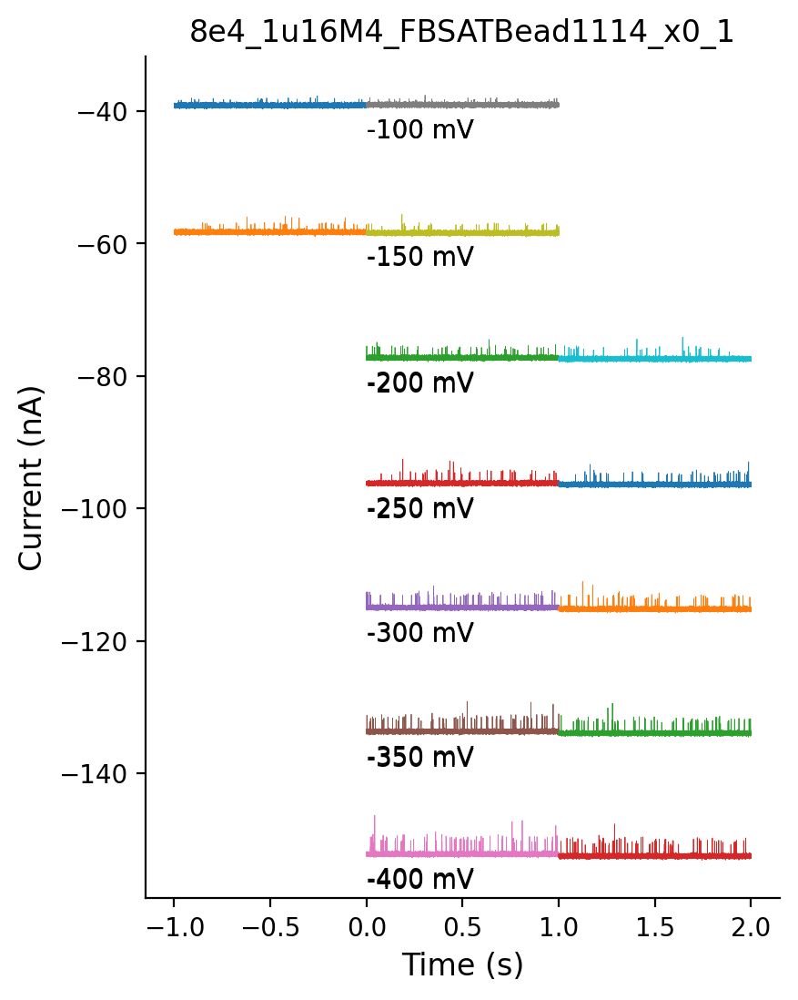

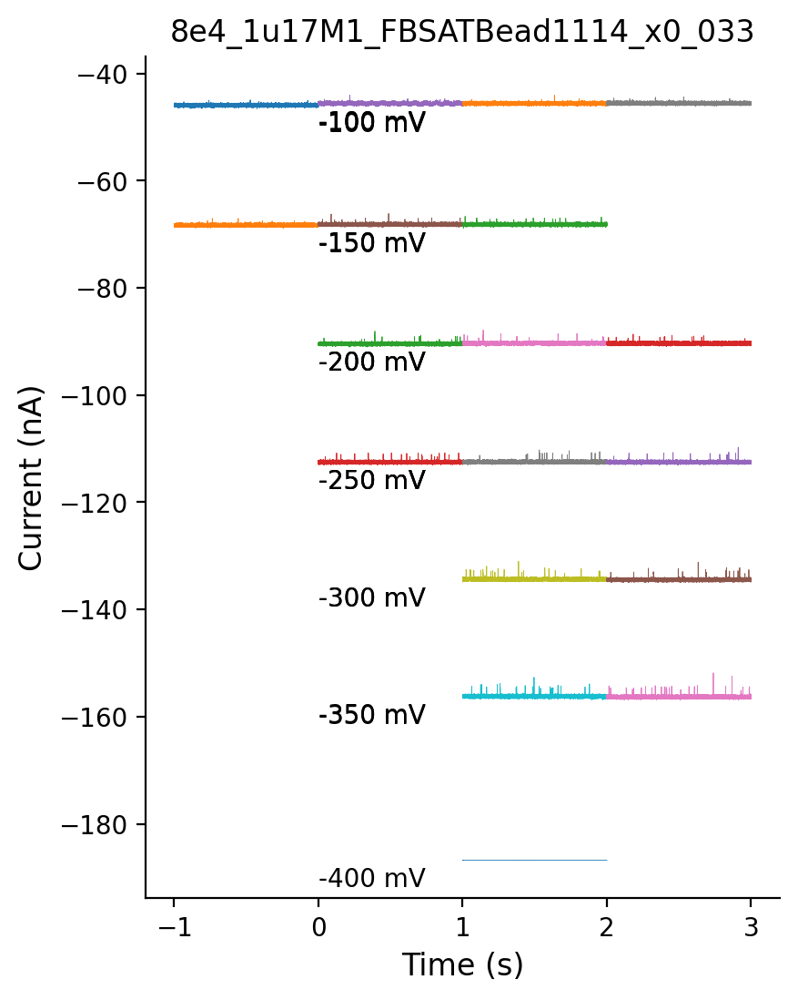

...

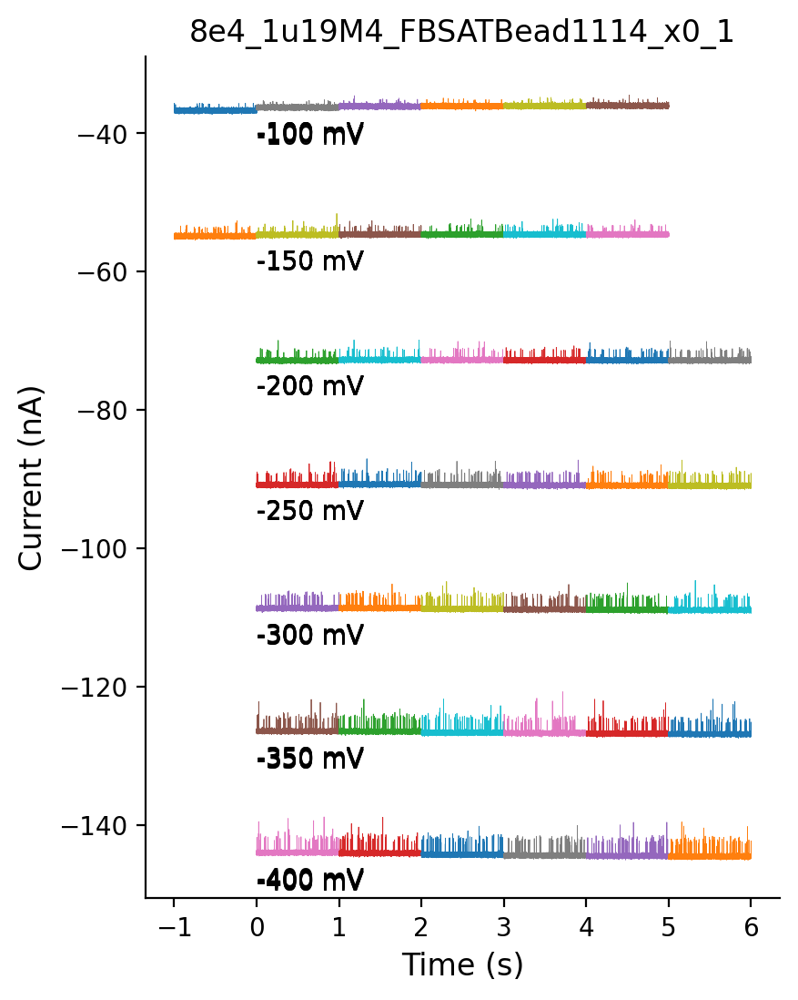

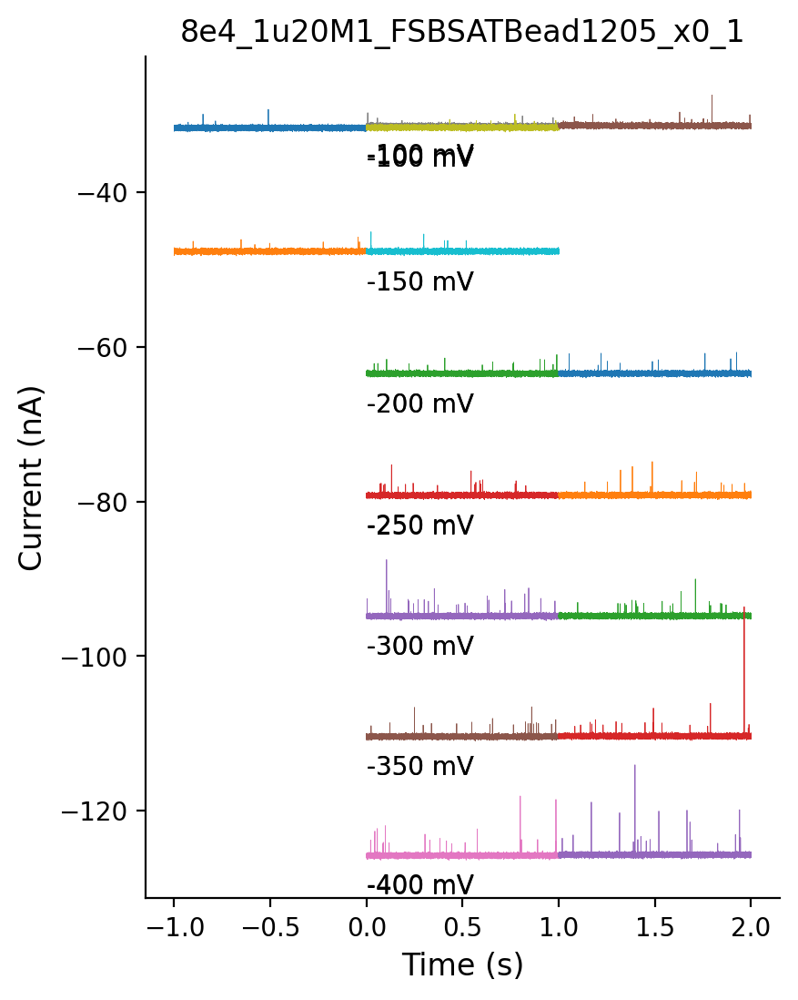

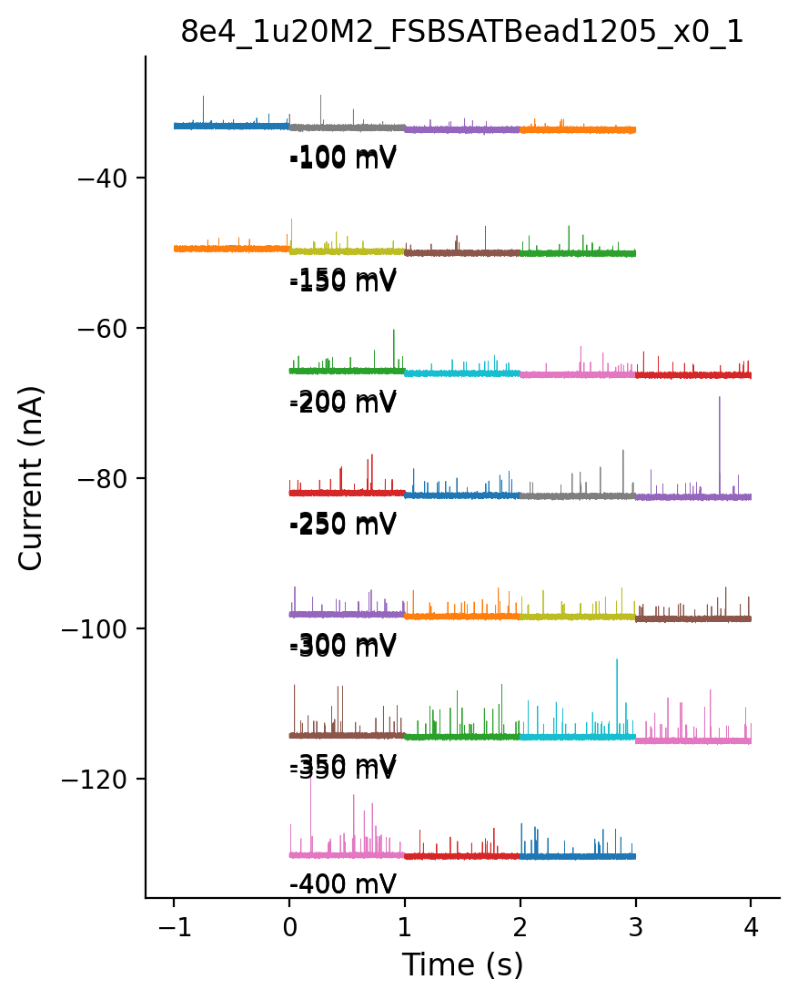

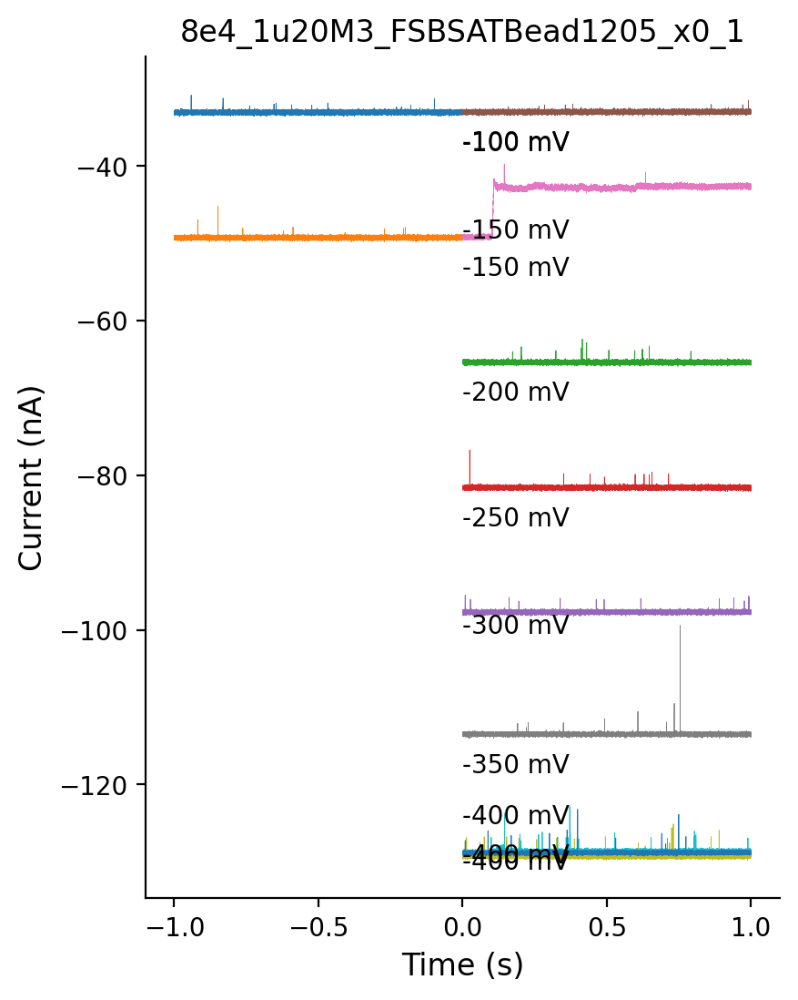

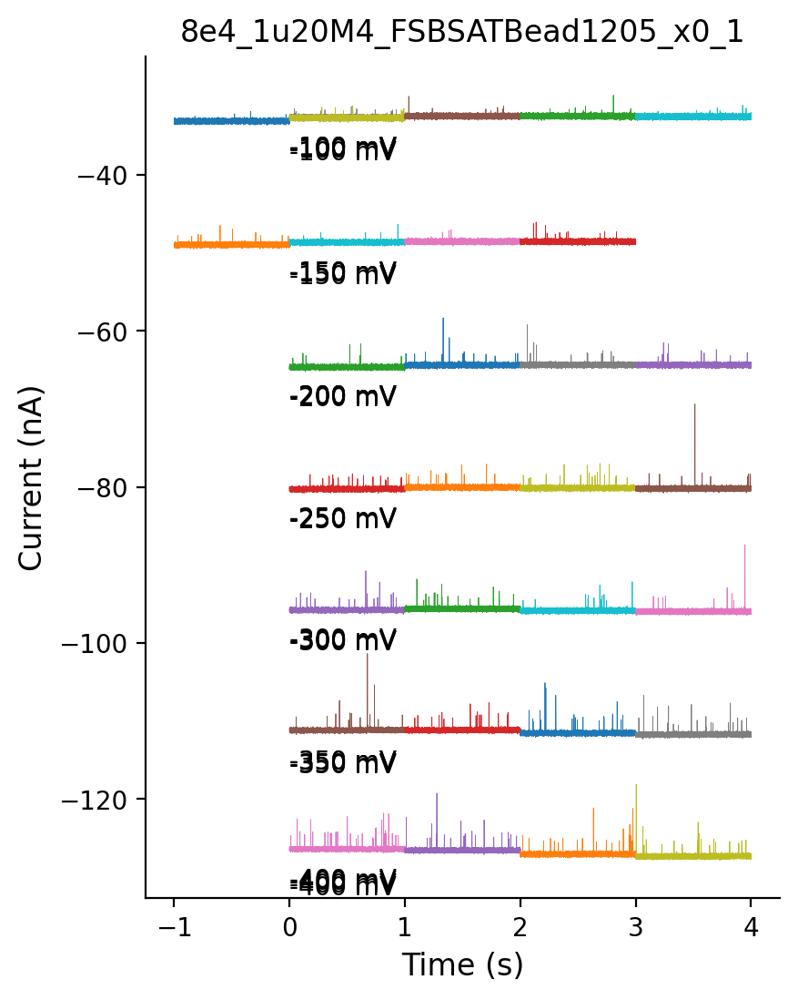

In [11]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]

for tf in sfm.traverse_to_rank("file"):
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40.1]# and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=1
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    plt.figure(figsize=(4.5,6),dpi=200)
    x=-1
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=1
            plt.plot(t+x,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            # idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            # idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            # if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
            #     try:
            #         t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start+x
            #         peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
            #         plt.scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='g',s=2)
            #     except: 
            #         pass
            #     t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start+x
                
            #     peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
            #     plt.scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=2)
            # # x+=1
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
    plt.title(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
# plt.savefig("EDR\\export_example_traces_T317M2.svg",bbox_inches="tight")


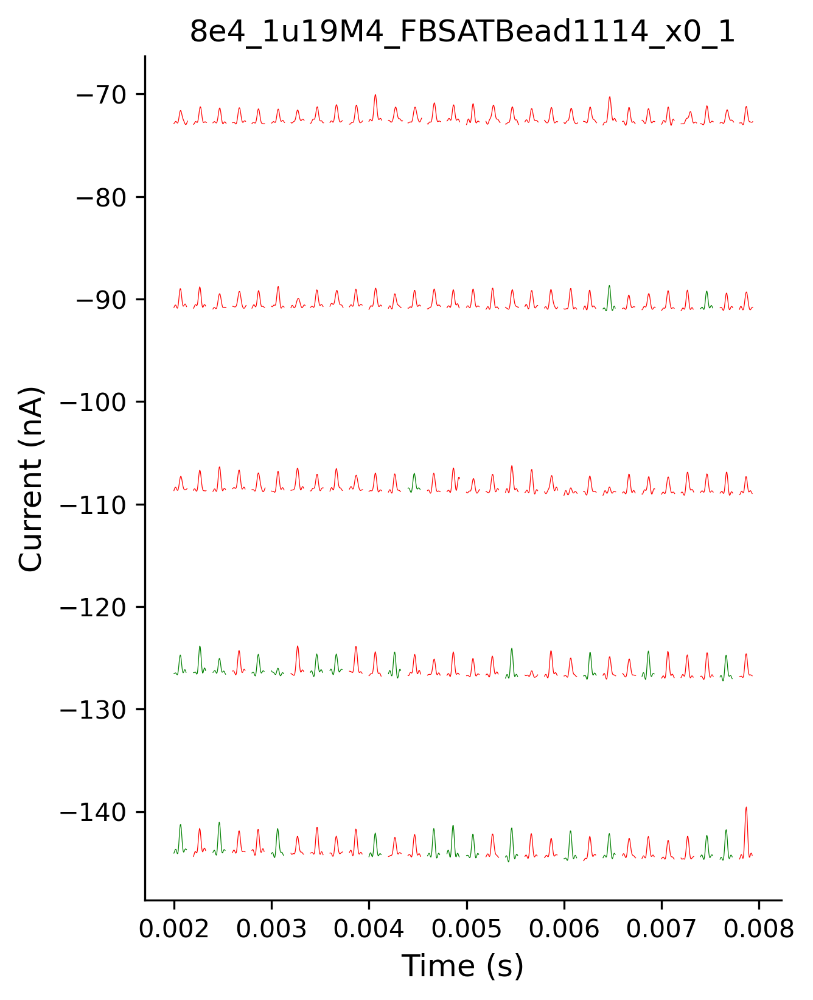

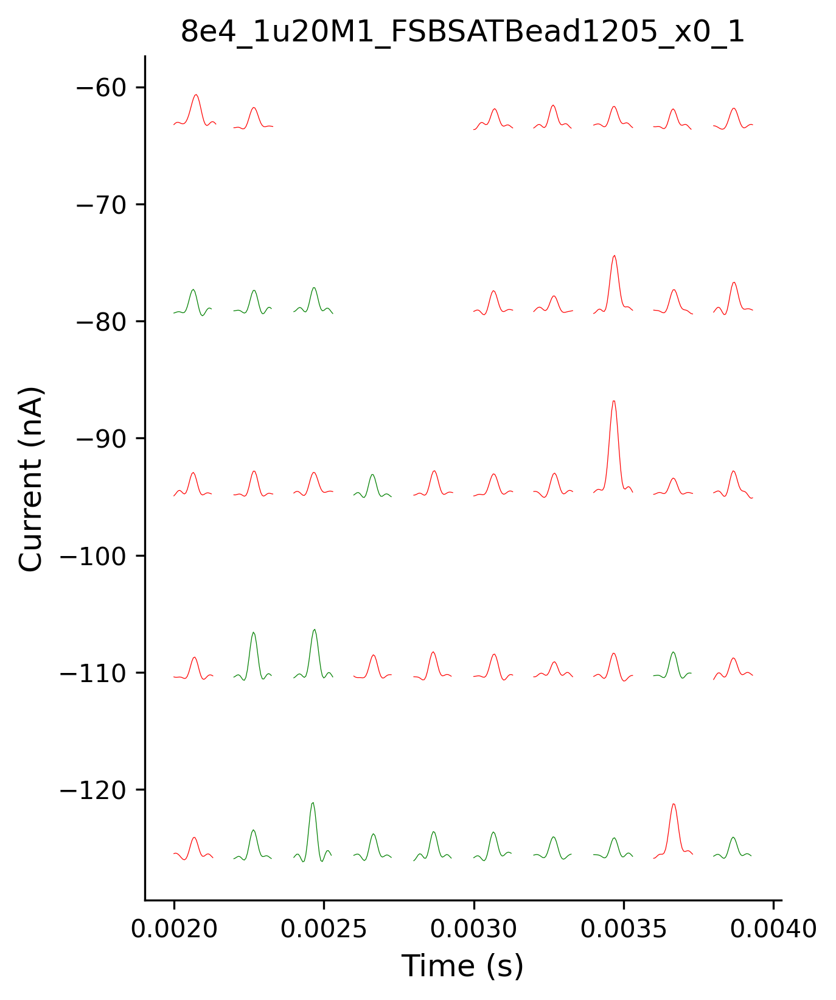

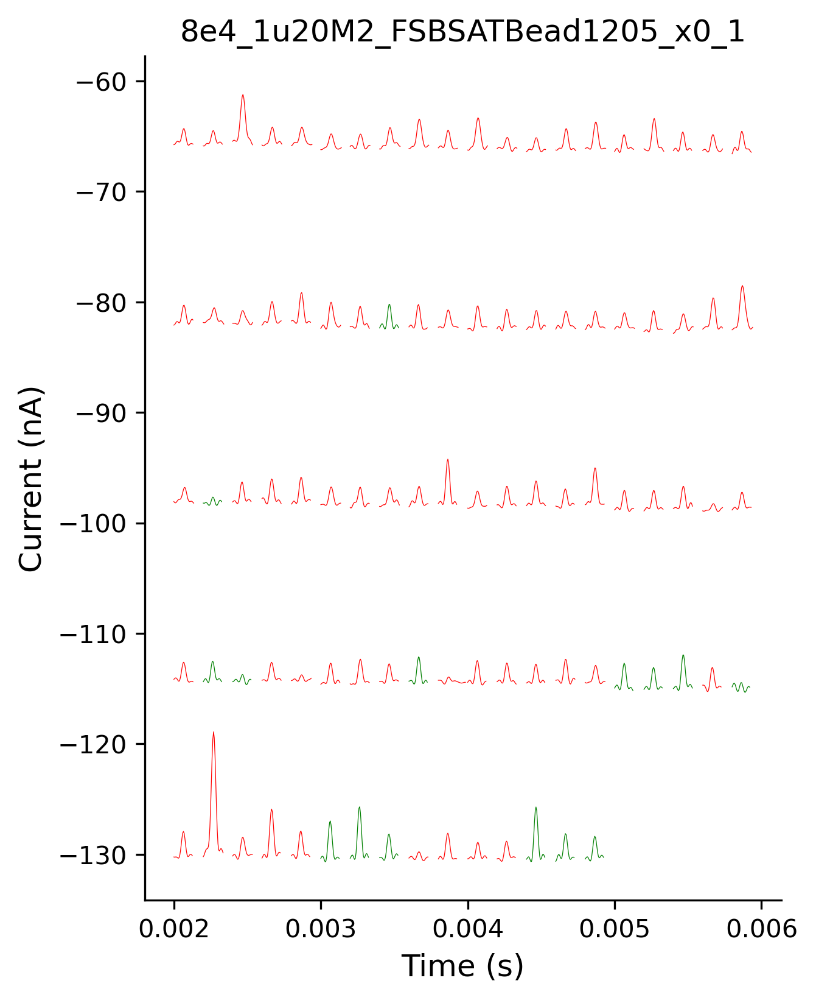

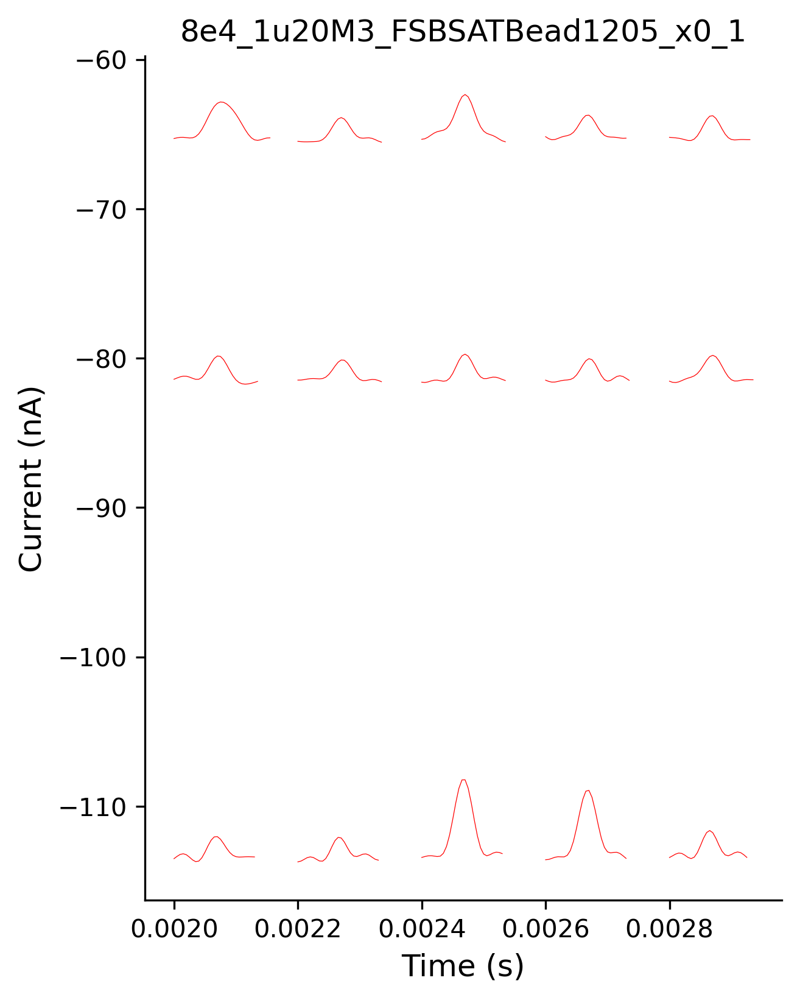

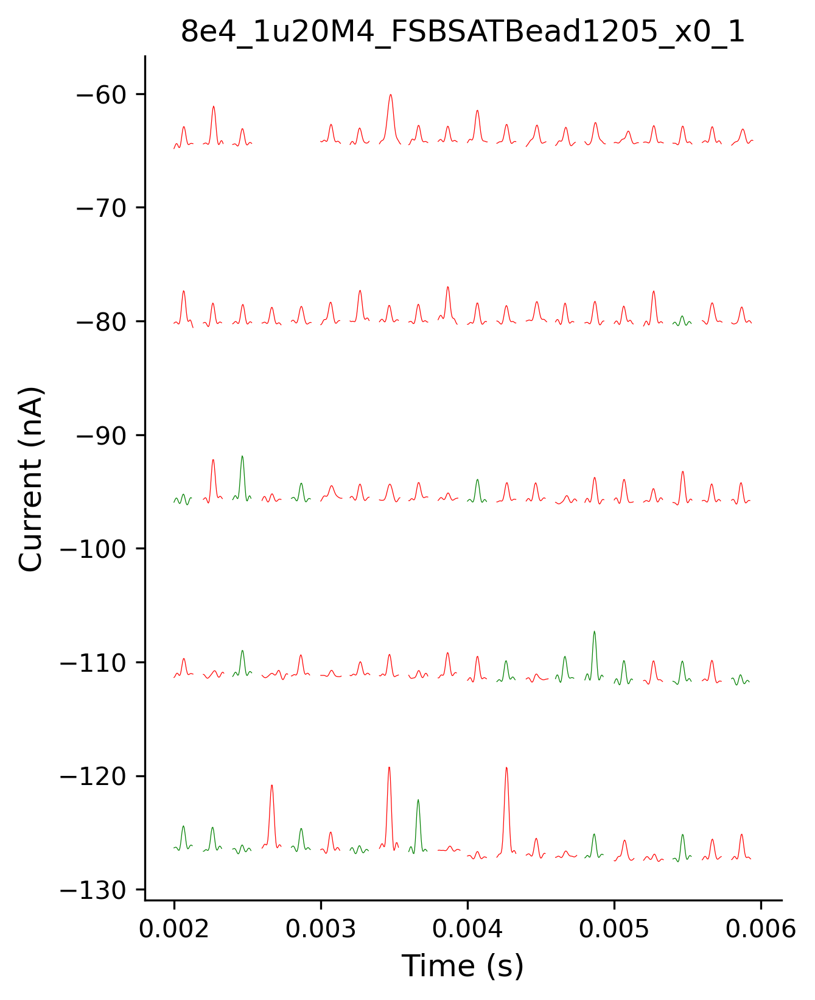

In [54]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]

for tf in sfm.traverse_to_rank("file"):
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=0.001
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    plt.figure(figsize=(4.5,6),dpi=300)
    x=length
    n_per_seg=5
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=length
            # plt.plot(t+x,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            # plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
            for i,event in enumerate(segment.children[25:30*n_per_seg:30]):
                
                idx_rel=event.get_feature('idx_rel')
                padding=10
                # print(segment.start,event.start-segment.start,event.end-segment.start)
                
                current=segment.current[event.start-segment.start-padding:event.end-segment.start+padding]
                # print(len(current))
                et=np.arange(0,len(current))/sampling_freq
                color='r' if event.get_feature("dwell")>= 32 else 'g'
                # event.current
                plt.plot(et+0.0002*i+x,1e9*current,lw=0.3,c=color)
            # plt.scatter()
            # idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            # idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            # if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
            #     try:
            #         t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start+x
            #         peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
            #         plt.scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='g',s=2)
            #     except: 
            #         pass
            #     try:
                    
            #         t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start+x
                
            #         peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
            #         plt.scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=2)
            #     except:
            #         pass
           
                
        except Exception as e:
            raise (e)
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.xlim(0.004,0.004)
    # plt.constrained_layout()
    title=tf.get_feature('metadata')['HeaderFile'].split('\\')[-2]
    plt.title(title)
    # plt.savefig(f"EDR\\export_example_events_{title}.svg",bbox_inches="tight")


In [20]:
file=large_enough_files[0]

metadata,current,voltage=EDHReader().read(file,voltage_compress=True)
tf=dt.TraceFile(current,voltage,parent=sfm,metadata=metadata,
                        unique_features={"sampling_freq":metadata["Sampling frequency (SR)"]})

filt_butter(tf.current[:],200000,25000,8)
select(tf,n_remove=4000)

In [18]:
print(file)

OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR\8e4_1u28M2_SplusNminus_Lac_PBS_F_01\8e4_1u28M2_SplusNminus_Lac_PBS_F.edh


15800193 9.979995000000002
17800193 9.979995000000002
19800194 9.979995000000002
21800194 9.979995000000002
23800194 9.979995000000002
25800194 9.979995000000002
27800194 9.979995000000002


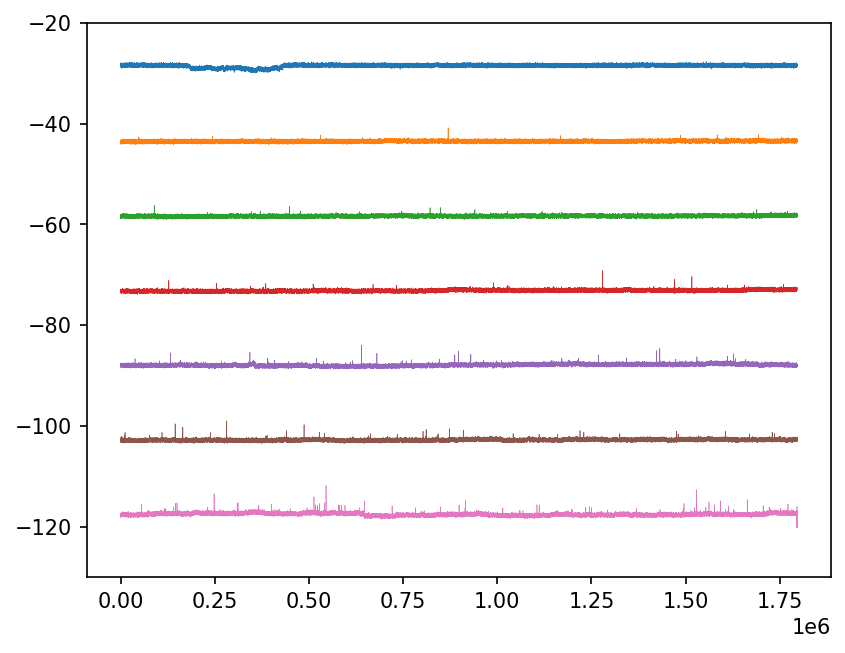

In [21]:
# for tf in sfm.traverse_to_rank("file"):
#     if "1u19M4" in tf.metadata["HeaderFile"]:
#         selected_file=tf
#         print (tf.metadata["HeaderFile"])

selected_file=tf
x=-1
duration=9
gap=1
sampling_freq=200000

selection=[step for step in selected_file.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40.1]
selected_currents={}
for segment in selection:
    if np.isclose(segment.get_feature('voltage'), -0.1, rtol=1e-05, atol=1e-08, equal_nan=False):
        x+=1
    if x==1:
        print(segment.start,segment.duration)
    if x==2:
        break
    selected_currents[f"{segment.get_feature('voltage')*1000:.0f} mV"]=1e9*segment.current[gap*sampling_freq:sampling_freq*(gap+duration)]
    
    
plt.figure(dpi=150)
for key,current in selected_currents.items():
    plt.plot(current,label=key,lw=0.3)
plt.ylim(-130,-20)
pd.DataFrame(selected_currents).to_csv(r"C:\Users\alito\VLP_paper_exports\Fig1\8e4_1u28M2_SplusNminus_Lac_PBS_F.edh.csv")

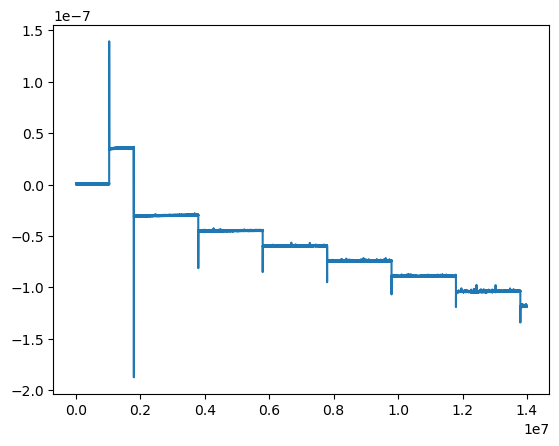

In [10]:
plt.plot(selected_file.current[:200000*70])

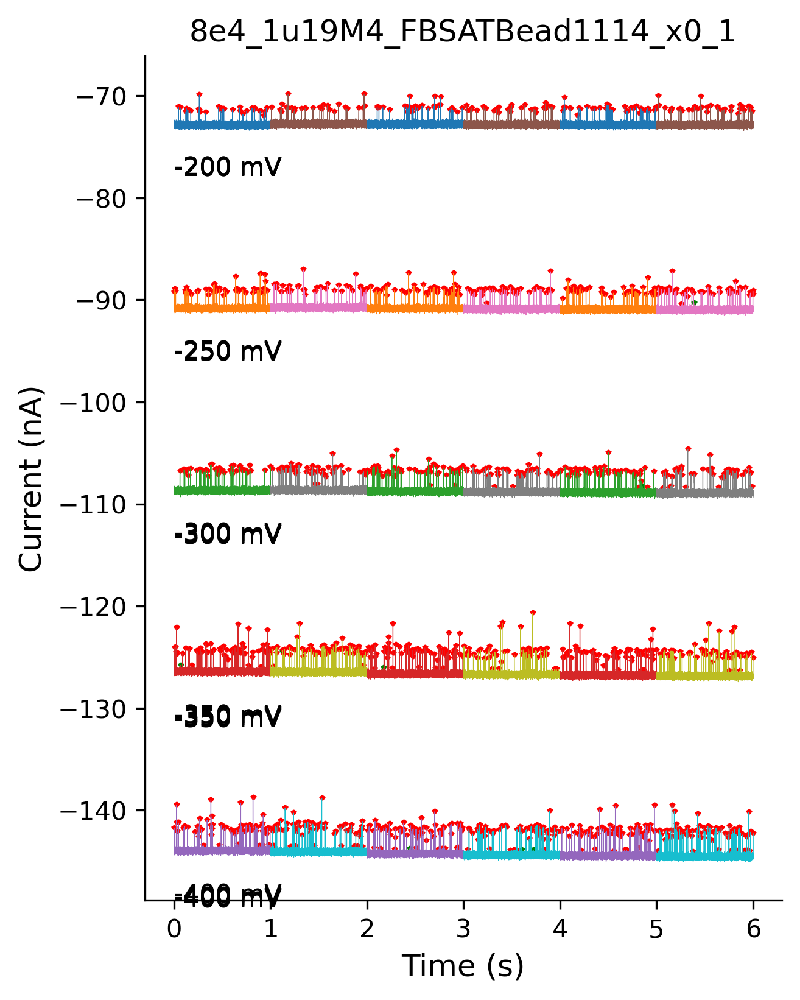

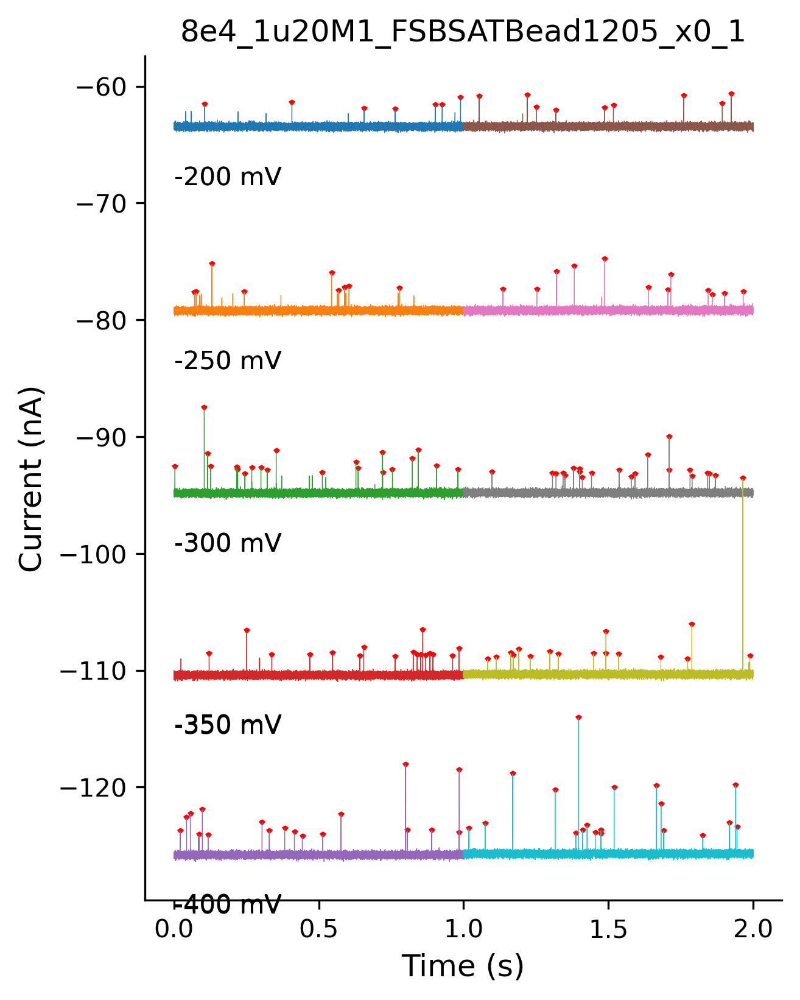

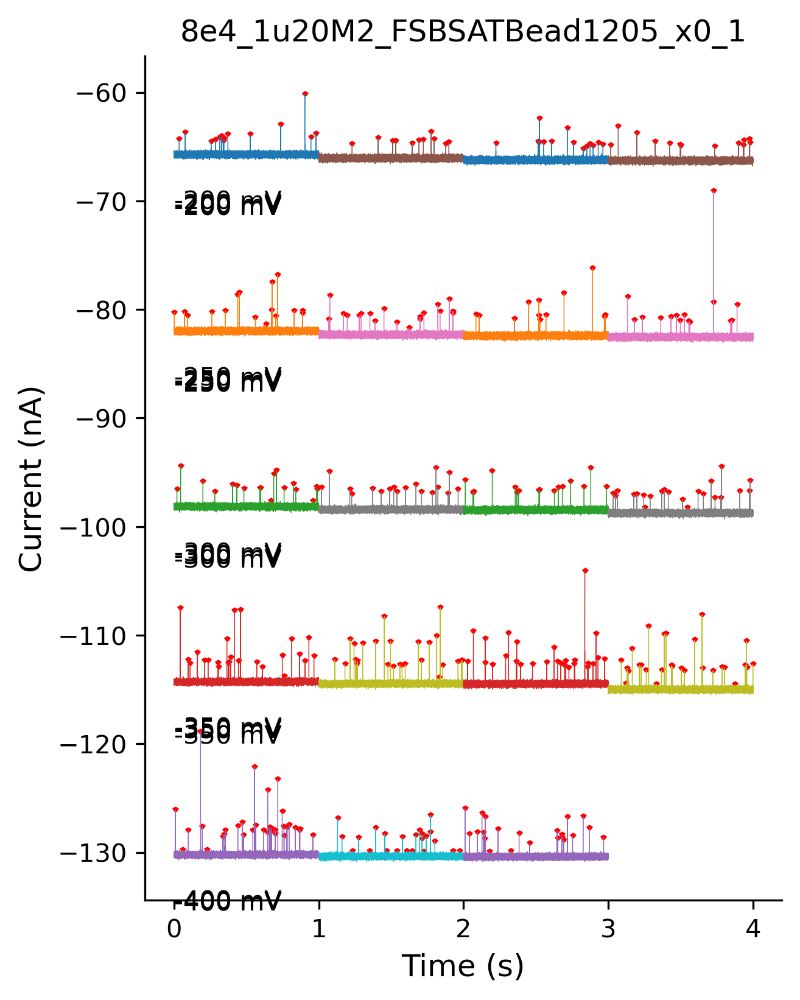

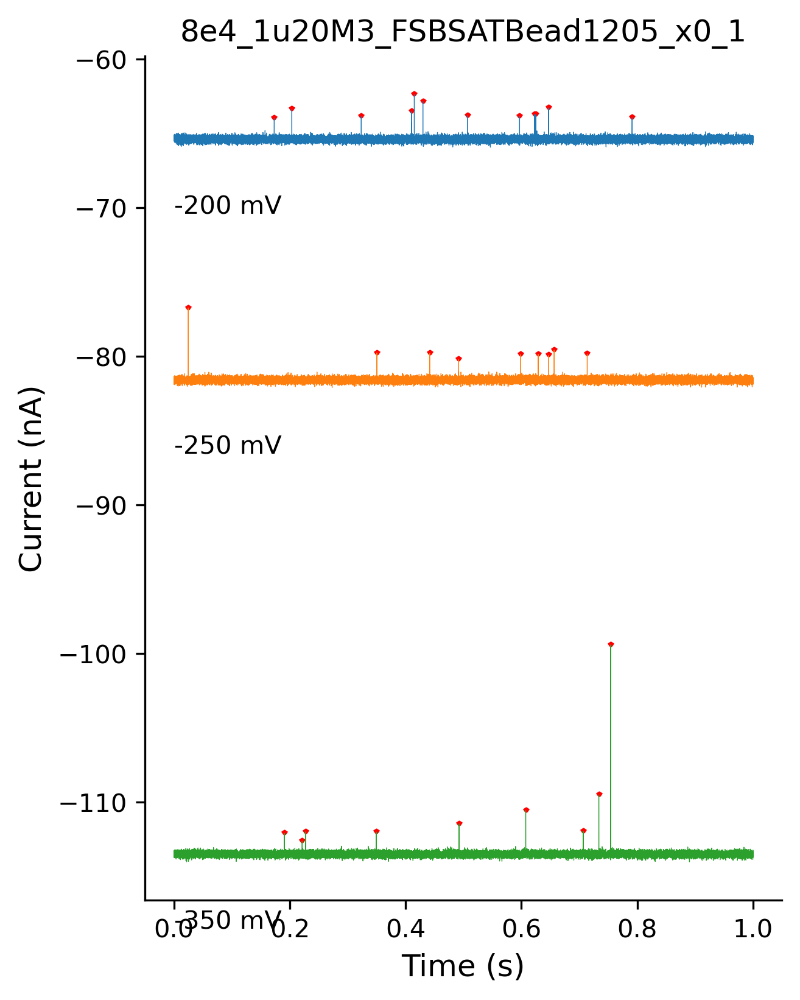

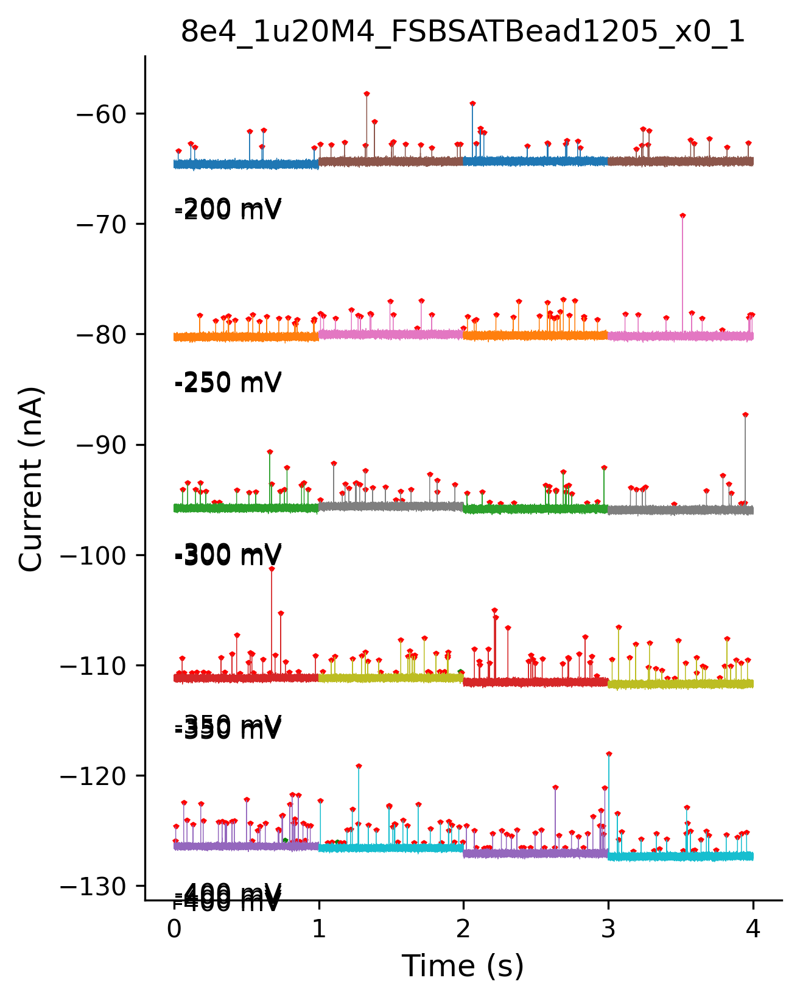

In [55]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]

for tf in sfm.traverse_to_rank("file"):
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=1
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    plt.figure(figsize=(4.5,6),dpi=300)
    x=-1
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=1
            plt.plot(t+x,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
                try:
                    t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start+x
                    peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
                    plt.scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='g',s=2)
                except: 
                    pass
                t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start+x
                
                peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
                plt.scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=2)
            # x+=1
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
    plt.title(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
# plt.savefig("EDR\\export_example_traces_T317M2.svg",bbox_inches="tight")


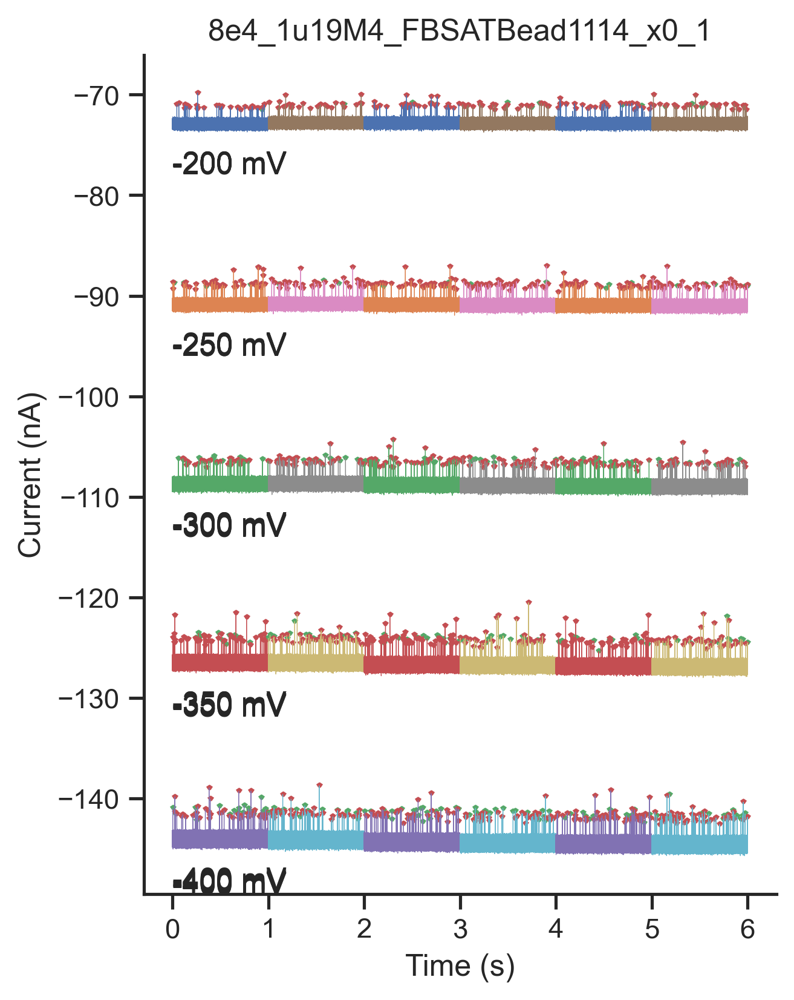

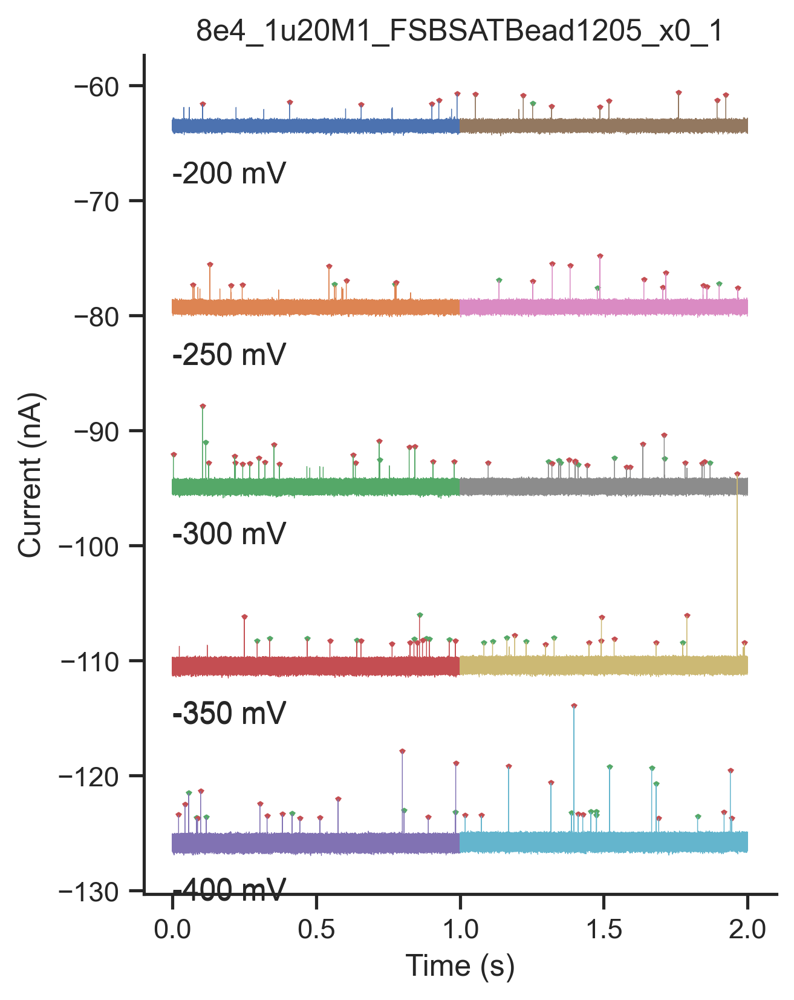

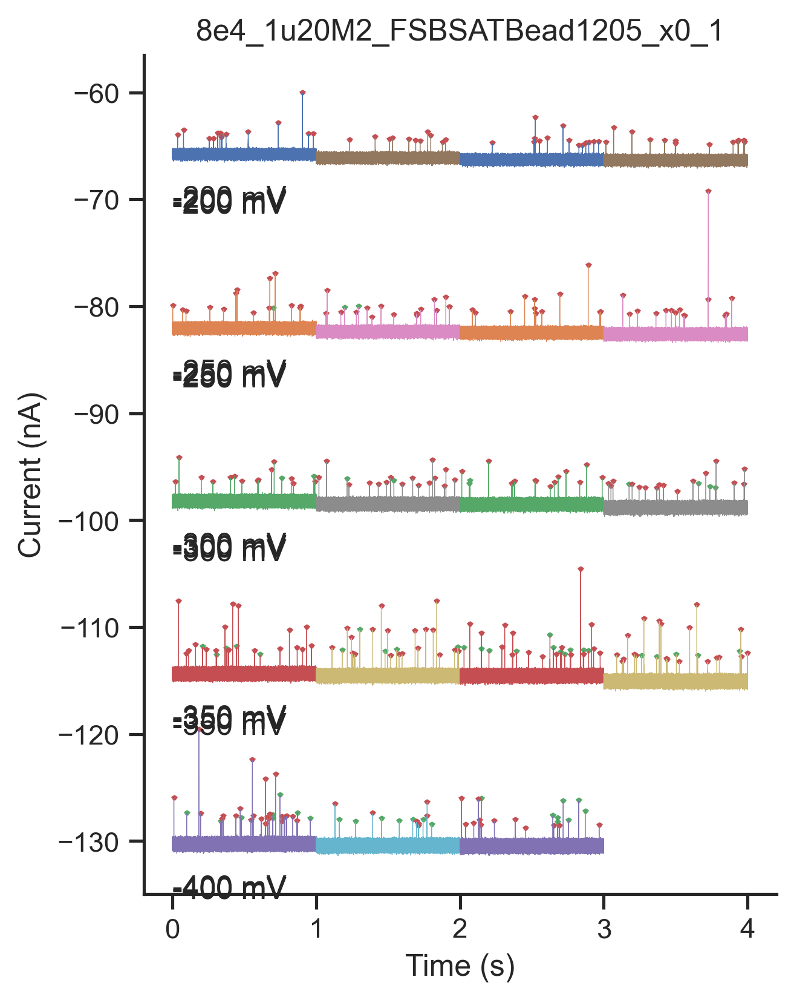

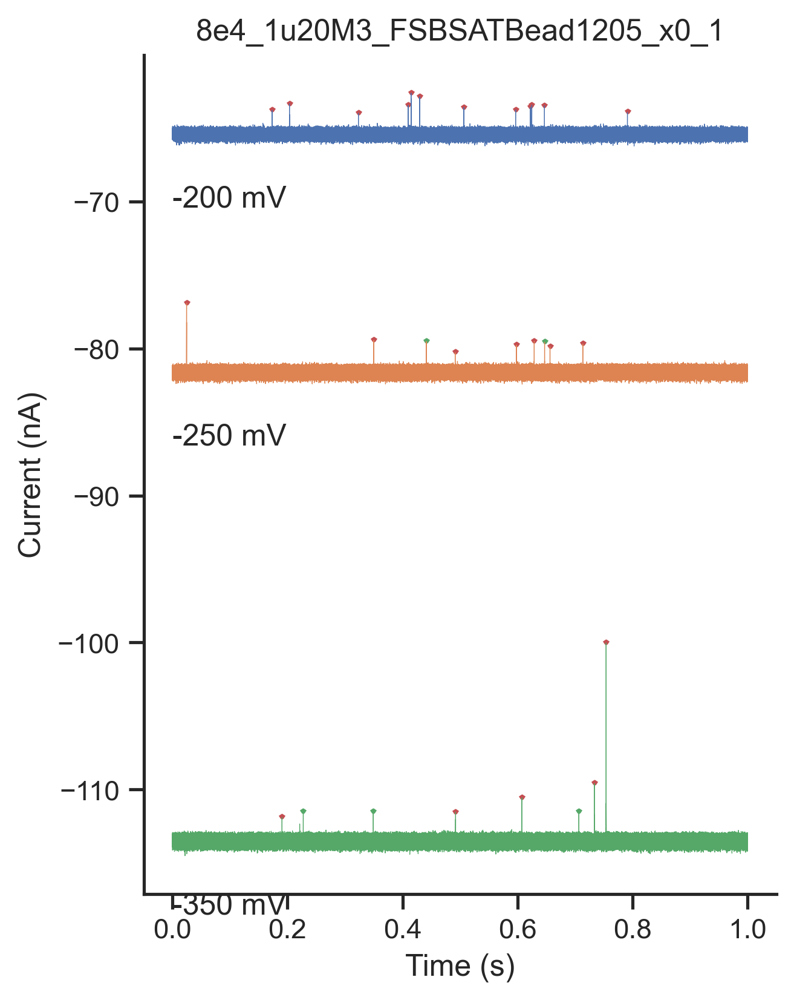

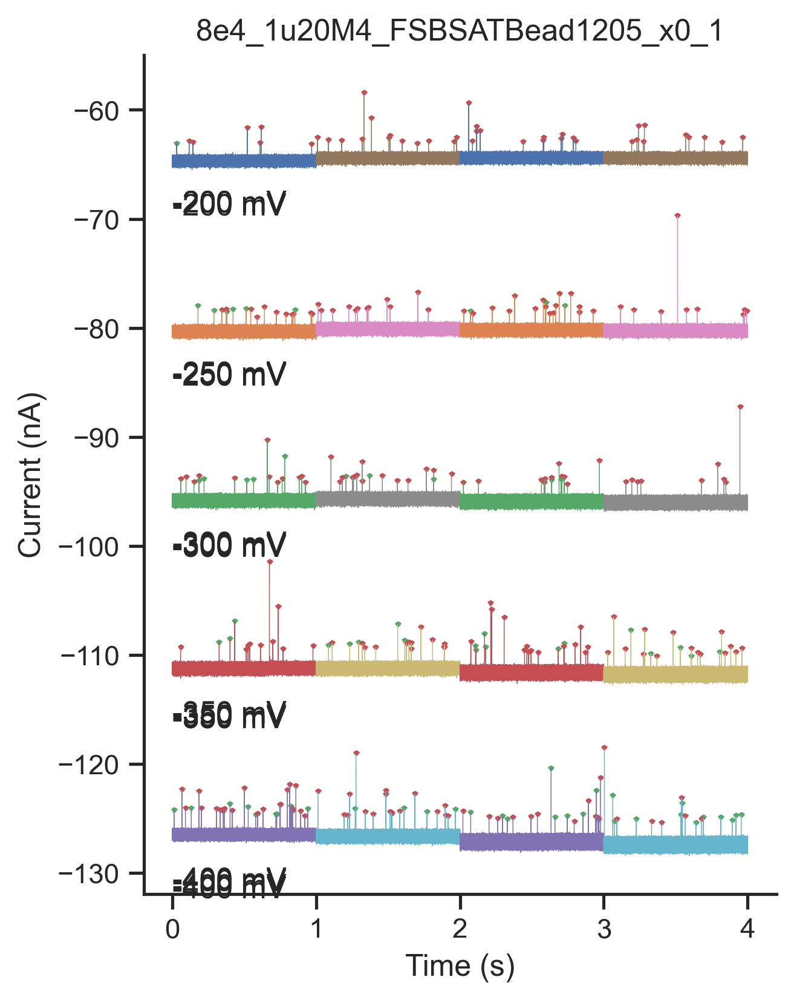

In [138]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]

for tf in sfm.traverse_to_rank("file"):
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=1
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    plt.figure(figsize=(4.5,6),dpi=300)
    x=-1
    for segment in selection:
        try:
            # print(segment.get_feature('voltage') , np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False))
            if np.isclose(segment.get_feature('voltage'), -0.2, rtol=1e-05, atol=1e-08, equal_nan=False):
                x+=1
            plt.plot(t+x,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            plt.text(0,segment.mean*1e9-5 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            idx_rel_0=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length  and event.duration<22e-6])
            idx_rel_1=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
            if len(idx_rel_0)>0 or len(idx_rel_1)>0:    
                try:
                    t_rel_0=segment.t[idx_rel_0]-segment.t[0]-start+x
                    peak_vals_0=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration<22e-6])
                
                    plt.scatter(t_rel_0, 1e9*peak_vals_0,marker=7,c='g',s=2)
                except: 
                    pass
                t_rel_1=segment.t[idx_rel_1]-segment.t[0]-start+x
                
                peak_vals_1=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length and event.duration>=22e-6])
                
                plt.scatter(t_rel_1, 1e9*peak_vals_1,marker=7,c='r',s=2)
            # x+=1
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
    plt.title(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
# plt.savefig("EDR\\export_example_traces_T317M2.svg",bbox_inches="tight")


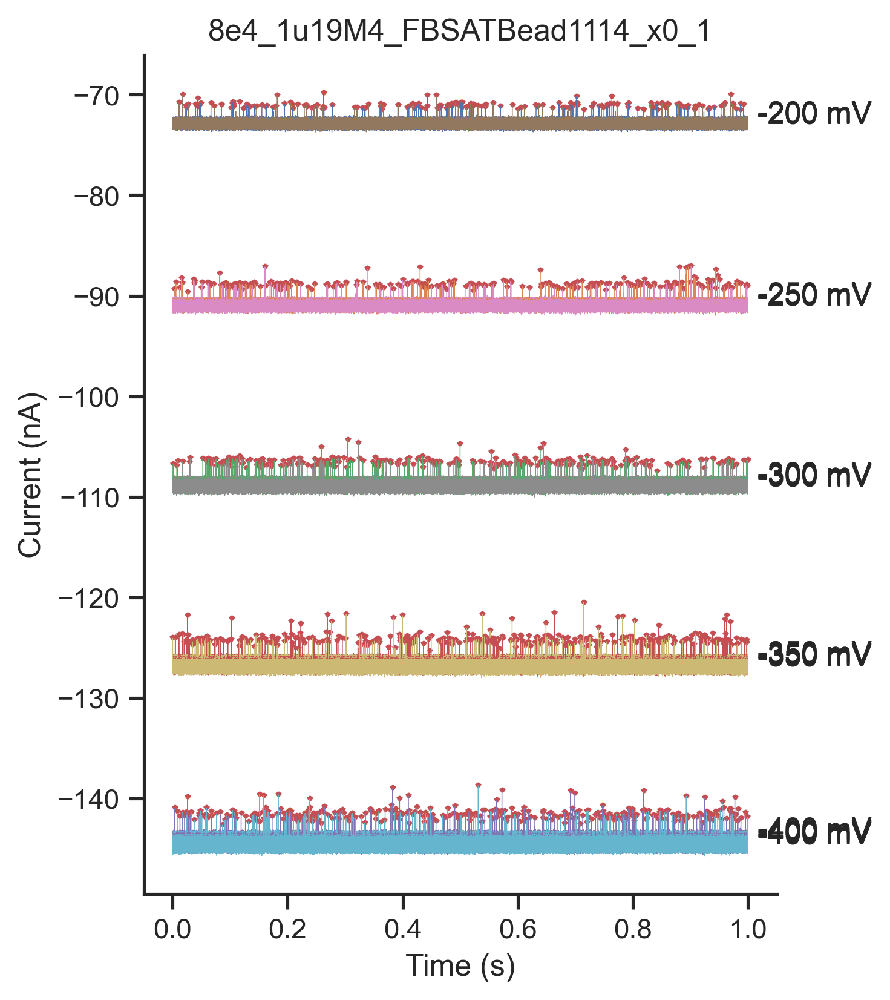

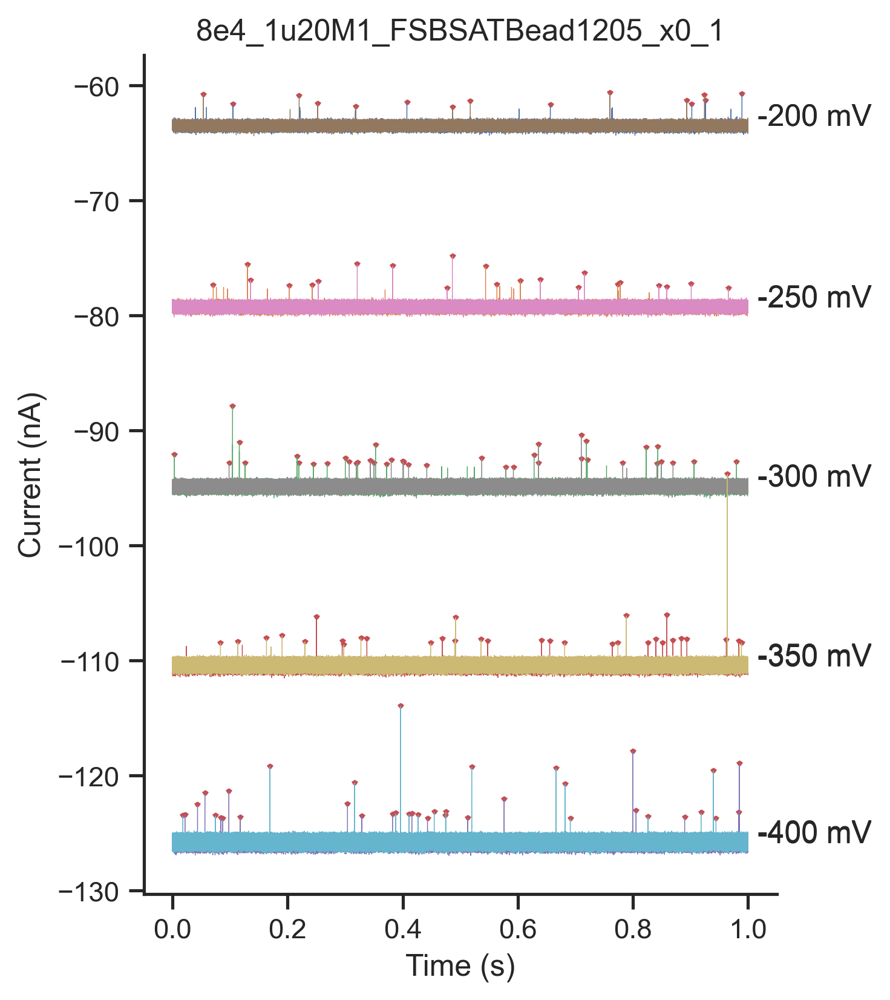

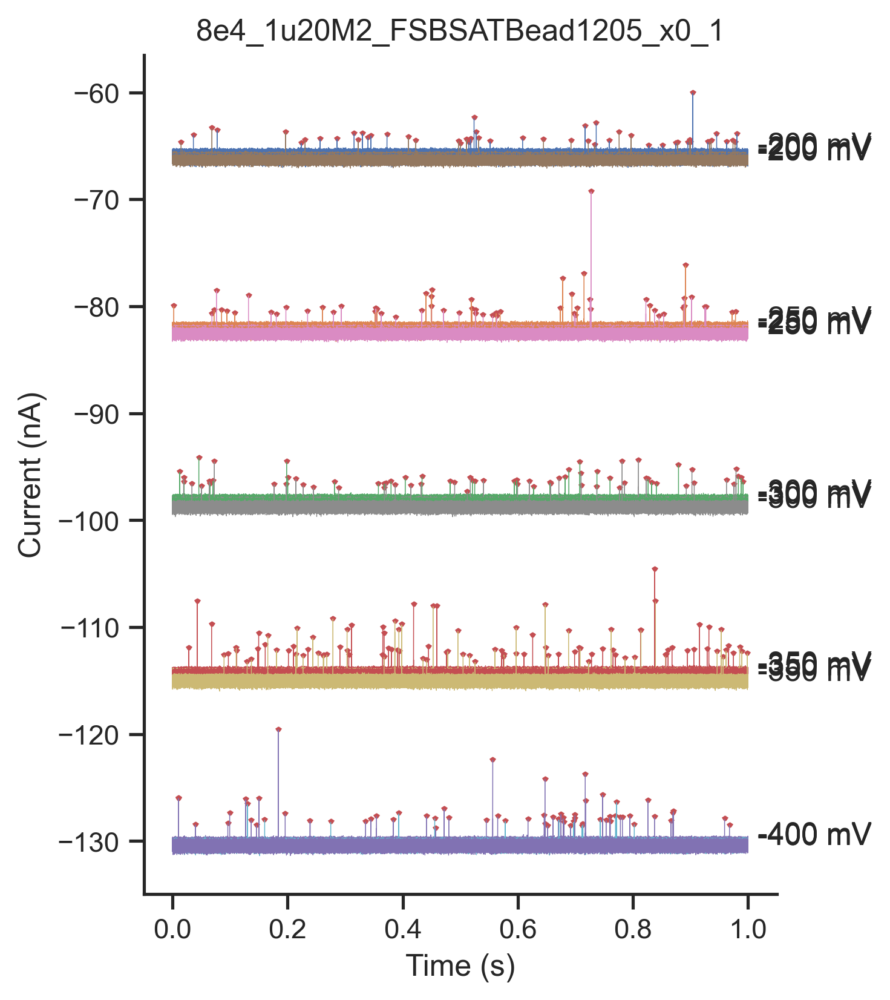

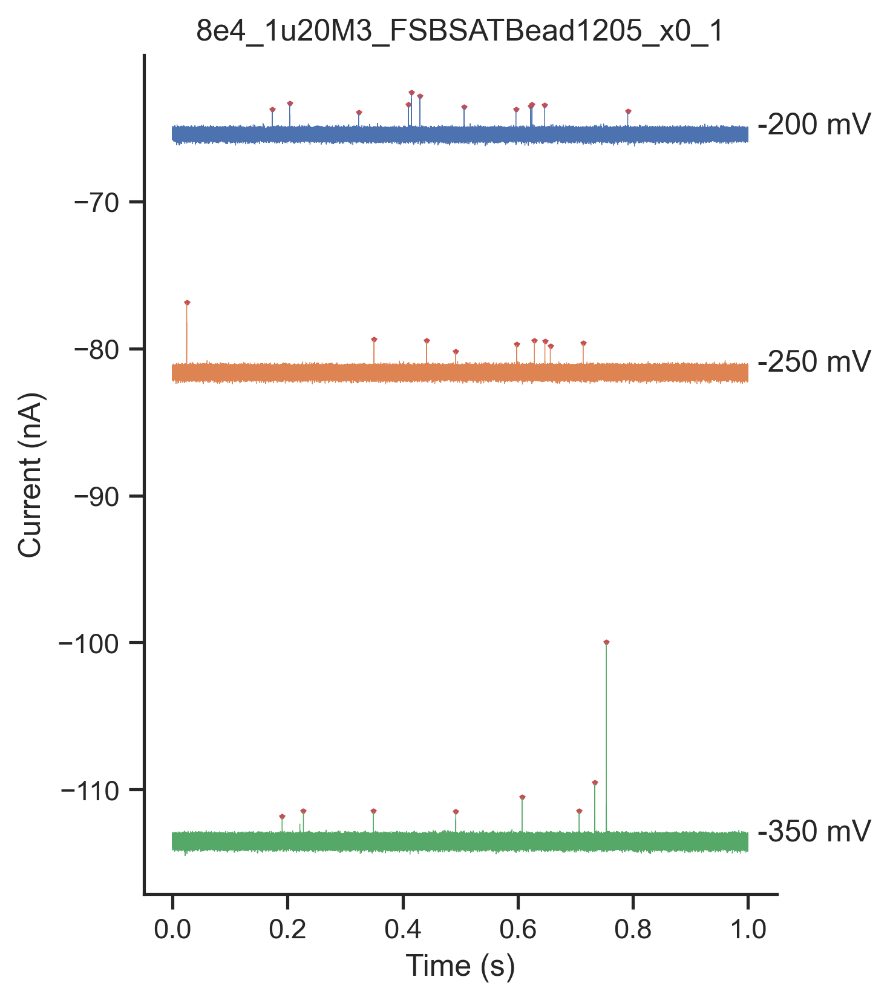

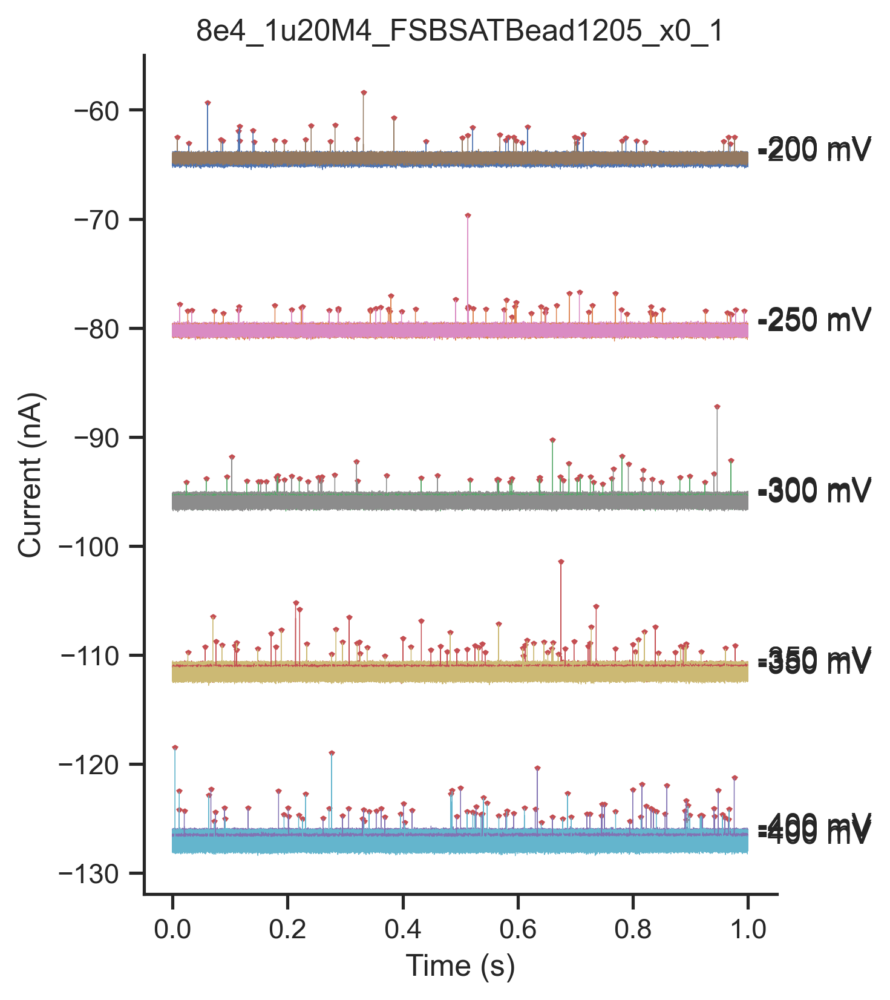

In [105]:
# %matplotlib qt
plt.rcParams["axes.labelsize"] = 12
# tf=experiment[1]

for tf in sfm.traverse_to_rank("file"):
    selection=[step for step in tf.traverse_to_rank("vstepgap")  if -0.41<=step.get_feature("voltage")<=-0.099 and 4.9<step.duration<40.1 and step.children !=[]]#.sort(key=lambda x:x.start)
    start=2
    length=1
    sampling_freq=200000
    t=np.arange(0,length*sampling_freq)/sampling_freq
    plt.figure(figsize=(4.5,6),dpi=300)
    for segment in selection:
        try:
            plt.plot(t,1e9*segment.current[start*sampling_freq:start*sampling_freq+int(length*sampling_freq)],lw=0.3)
            plt.text(1.017*length,segment.mean*1e9 , f"{segment.get_feature('voltage')*1000:.0f} mV")
                
            # plt.scatter()
            idx_rel=np.array([event.get_feature('idx_rel') for event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length])
            
            if len(idx_rel)>0:    
                t_rel=segment.t[idx_rel]-segment.t[0]-start
                peak_vals=np.array([event.get_feature('peak_val') for  event in segment.children if start+segment.t[0]<segment.t[event.get_feature('idx_rel')]<start+segment.t[0]+length])
                
                plt.scatter(t_rel, 1e9*peak_vals,marker=7,c='r',s=2)
            # t+=length/2
            # plt.text()
                
        except Exception as e:
            raise (e)
    plt.gca().spines["right"].set_visible(False)
    plt.gca().spines["top"].set_visible(False)
    plt.ylabel("Current (nA)")
    plt.xlabel("Time (s)")


        
        
    # plt.xlim(-0.05*length,1.19*length)
    # plt.constrained_layout()
    plt.title(tf.get_feature('metadata')['HeaderFile'].split('\\')[-2])
# plt.savefig("EDR\\export_example_traces_T317M2.svg",bbox_inches="tight")


In [13]:
%matplotlib qt
plt.figure()
experiment[0].traverse_to_rank("vstepgap")[10].children
step=experiment[0].traverse_to_rank("vstepgap")[10]
plt.plot(step.t,step.current,lw=0.7)
for child in step.children:
    # print (child.start,child.end)
    plt.plot(child.t,child.current,color='r',lw=0.5)
    # print(child.get_feature('idx_abs'),child.t)
    plt.plot([step.t[child.get_feature('idx_rel')]],[child.get_feature("peak_val")],'x',c="r")

# plt.xlim(210,216.1)
# plt.ylim(-7.5e-8,-7.1e-8)

In [11]:
%matplotlib qt
for tf in sfm.children:
    plt.figure()
    plt.plot(tf.t,tf.current,c='k',lw=0.2)
    for event in tf.traverse_to_rank('event'):
        # plt.plot(event.t,event.current,c='r',lw='0.2')
        plt.plot([event.parent.t[event.get_feature('idx_rel')]], [event.get_feature("peak_val")],'x',c='r')
    # break

In [12]:
# export to csv
feature_list=['voltage','deli','dwell','dt']
selection=[step for step in sfm.children[3].traverse_to_rank("vstepgap") if -0.41<=step.get_feature("voltage")<=-0.099 and 9.9<step.duration<10.1 and step.std<1.2e-9]
_d={key: [] for key in feature_list+['baseline','file']}
for tf in selection:
    for event in tf.traverse_to_rank('event'):
        _d["file"].append(tf.get_feature('metadata')["HeaderFile"])
        
        for feature in feature_list:
            _d[feature].append(event.get_feature(feature))
        _d['baseline']=event.parent.mean

dff=pd.DataFrame(_d)
# dff.to_csv("EVENTS_EXPORT.csv")

In [1]:
# import pandas as pd
# dff=pd.read_csv("EVENTS_EXPORT.csv")

In [5]:
# dff.tail(20)

In [63]:
def plot_example_trace(tracefile:ct.AnySegment, at_rank="vstepgap",start=None,length=None,title=None):
    sampling_freq=tracefile.get_feature('sampling_freq')
    t=np.arange(0,length*sampling_freq)/sampling_freq
    for segment in tracefile.traverse_to_rank(at_rank):
        try:
            plt.plot(t,segment.current[start:start+int(length*sampling_freq)],lw=0.5)
            t+=length/2
        except:
            pass
        
plot_example_trace(experiment[0],at_rank='vstepgap',start=1,length=0.4)    

In [11]:
import gc
print(gc.collect())
print(*gc.get_stats())




29
{'collections': 5698, 'collected': 3050, 'uncollectable': 0} {'collections': 517, 'collected': 1033, 'uncollectable': 0} {'collections': 18, 'collected': 69, 'uncollectable': 0}


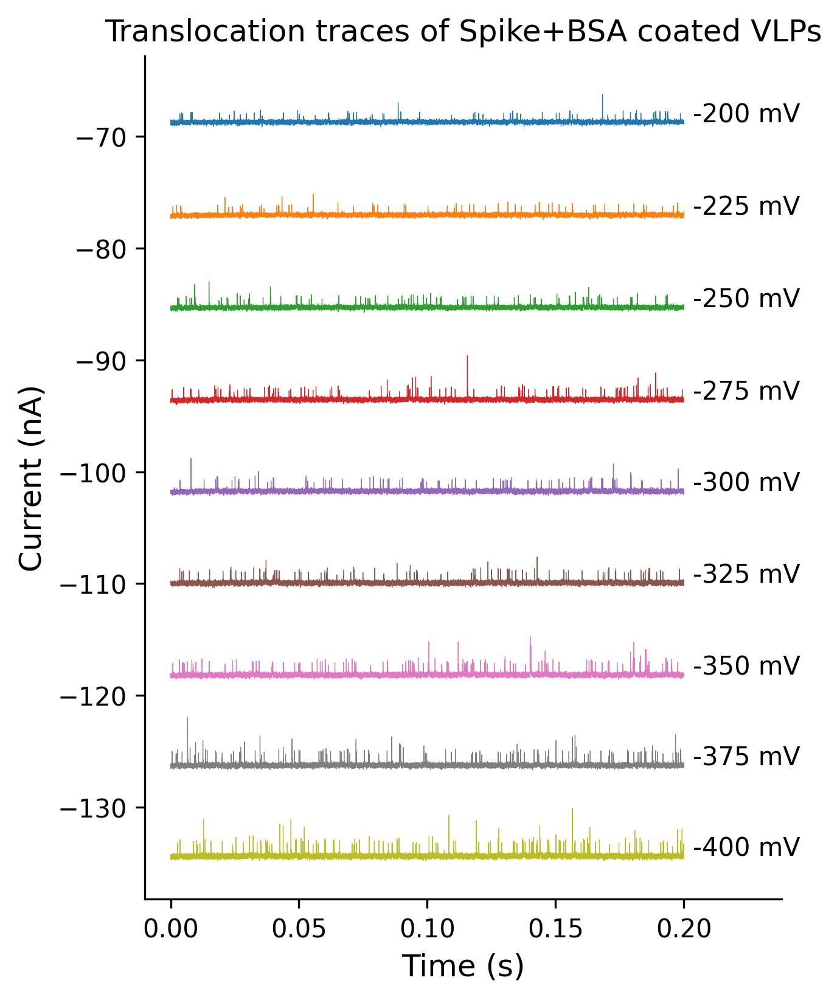

In [8]:
%matplotlib inline
plt.rcParams["axes.labelsize"] = 12
tf=experiment[1]
selection=[step for step in tf.traverse_to_rank("vstepgap") if 137<step.t[0]<260 and -0.41<=step.get_feature("voltage")<=-0.2]#.sort(key=lambda x:x.start)
start=2
length=0.2
sampling_freq=200000
t=np.arange(0,length*sampling_freq)/sampling_freq
plt.figure(figsize=(4.5,6),dpi=300)
for segment in selection:
    try:
        plt.plot(t,1e9*segment.current[start:start+int(length*sampling_freq)],lw=0.3)
        # t+=length/2
        # plt.text()
        plt.text(1.017*length,segment.mean*1e9 , f"{segment.get_feature('voltage')*1000:.0f} mV")
    except:
        pass
plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)
plt.ylabel("Current (nA)")
plt.xlabel("Time (s)")


    
    
plt.xlim(-0.05*length,1.19*length)
# plt.constrained_layout()
plt.title("Translocation traces of Spike+BSA coated VLPs")
plt.savefig("EDR\\export_example_traces_T317M2.svg",bbox_inches="tight")


Text(0.5, 1.0, 'Translocation traces of Spike+BSA coated VLPs')

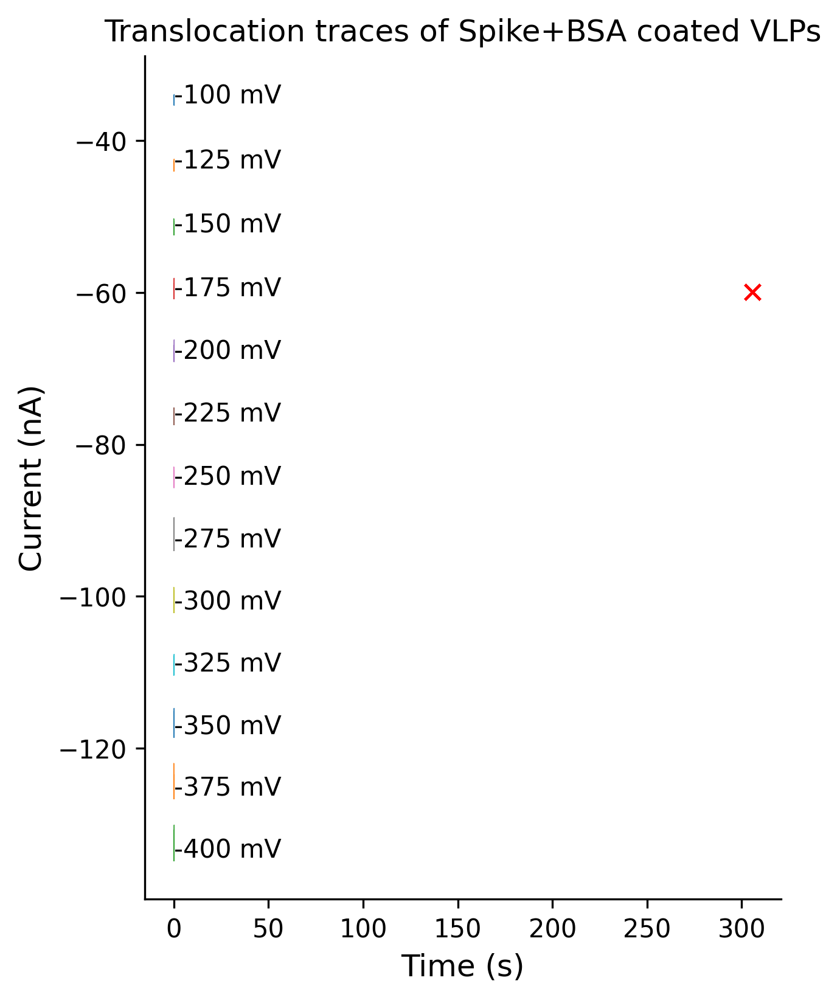

In [18]:
%matplotlib inline
plt.rcParams["axes.labelsize"] = 12
tf=experiment[1]
selection=[step for step in tf.traverse_to_rank("vstepgap") if 137<step.t[0]<260 and -0.41<=step.get_feature("voltage")<=-0.1]#.sort(key=lambda x:x.start)
start=2
length=0.2
sampling_freq=200000
t=np.arange(0,length*sampling_freq)/sampling_freq
plt.figure(figsize=(4.5,6),dpi=300)
for segment in selection:
    try:
        
        plt.plot(t,1e9*segment.current[start:start+int(length*sampling_freq)],lw=0.3)
        events=[event for event in segment.children if start<event.get_feature("idx_rel")<start+int(length*sampling_freq)]
        plt.plot([event.parent.t[event.get_feature('idx_rel')]-start], [event.get_feature("peak_val")*1e9],'x',c='r')
        # t+=length/2
        # plt.text()
        plt.text(1.017*length,segment.mean*1e9 , f"{segment.get_feature('voltage')*1000:.0f} mV")
    except:
        pass
plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)
plt.ylabel("Current (nA)")
plt.xlabel("Time (s)")


    
    
# plt.xlim(-0.05*length,1.19*length)
# plt.constrained_layout()
plt.title("Translocation traces of Spike+BSA coated VLPs")
# plt.savefig("EDR\\export_example_traces_T317M2.svg",bbox_inches="tight")


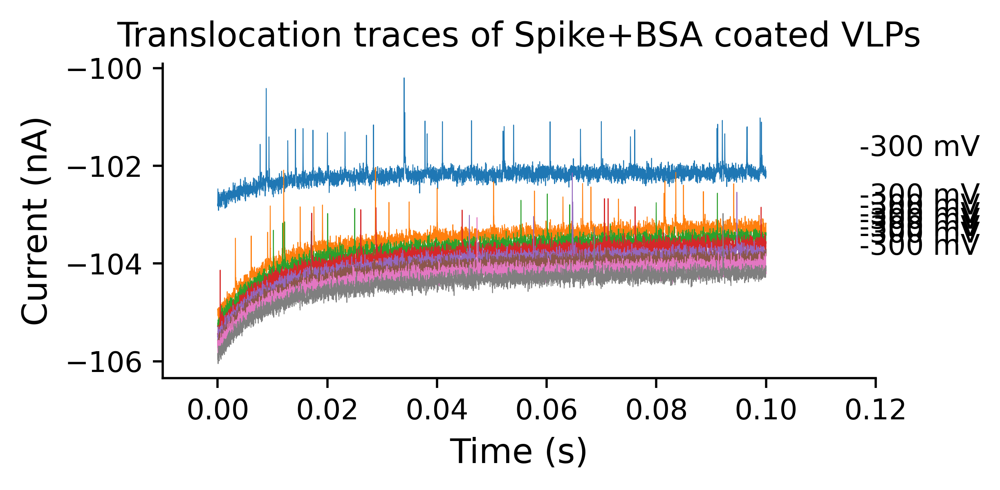

In [21]:
# %matplotlib inline
plt.rcParams["axes.labelsize"] = 12
tf=experiment[1]
selection=[step for step in tf.traverse_to_rank("vstepgap") if step.t[0]>360 and -0.31<=step.get_feature("voltage")<=-0.3]
start=2
length=0.1
sampling_freq=200000
t=np.arange(0,length*sampling_freq)/sampling_freq
plt.figure(figsize=(4.5,2),dpi=500)

for segment in selection:
    try:
        plt.plot(t,1e9*segment.current[start:start+int(length*sampling_freq)],lw=0.3)
        # t+=length/2
        # plt.text()
        plt.text(0.117,segment.mean*1e9 , f"{segment.get_feature('voltage')*1000:.0f} mV")
    except:
        pass
plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)
plt.ylabel("Current (nA)")
plt.xlabel("Time (s)")


    
    
plt.xlim(-0.01,0.12)
# plt.constrained_layout()
plt.title("Translocation traces of Spike+BSA coated VLPs")
plt.savefig("EDR\\export_example_traces_R506M2.svg",bbox_inches="tight")


In [13]:
import pandas as pd
import seaborn as sns


In [101]:
feature_list=['voltage','deli','dwell','dt']
# tf=experiment[
selection=[step for step in sfm.traverse_to_rank("vstepgap") if -0.41<=step.get_feature("voltage")<=-0.1 and 6<step.duration<40.1 and step.std<1.8e-9]

# selection=[step for step in sfm.traverse_to_rank("vstepgap") if -0.31<=step.get_feature("voltage")<=-0.29 and step.duration>1 and step.std<1.2e-9]
_d={key: [] for key in feature_list+['file','dil','frac','tpeak']}
for tf in selection_for_plot:
    for event in tf.traverse_to_rank('event'):
        if event.get_feature("deli")>1.2e-9:
            _d["file"].append(tf.get_feature('metadata')["HeaderFile"])
            _d["dil"]=_d["file"][-1].split("\\")[-1].split('.')[0].split('x')[-1].replace('_','.')
            _d["tpeak"]=event.parent.t[event.get_feature('idx_rel')]
            for feature in feature_list:
                _d[feature].append(event.get_feature(feature))
            _d["frac"].append(-event.get_feature("deli")/event.parent.mean)

df=pd.DataFrame(_d)
df['voltage']= df['voltage'].round(3)

df["pore_id"]=df["file"].apply(lambda x: "".join(x.split('\\')[-2].split('_')[0:2]))
df=df.loc[df['pore_id']!='8e41u20M3']
df["chip_id"]=df["pore_id"].apply(lambda x: x.split("M")[0])
df.tail()


,voltage,deli,dwell,dt,file,dil,frac,tpeak,pore_id,chip_id
35062,-0.4,1.946759e-09,33.925574,0.020160,C:\Users\alito\OneDrive - Northeastern Univers...,0.3,0.013340,532.893195,8e41u22M2,8e41u22
35063,-0.4,1.768498e-09,35.212986,0.000585,C:\Users\alito\OneDrive - Northeastern Univers...,0.3,0.012119,532.893195,8e41u22M2,8e41u22
35064,-0.4,1.275680e-09,32.727765,0.009480,C:\Users\alito\OneDrive - Northeastern Univers...,0.3,0.008742,532.893195,8e41u22M2,8e41u22
35065,-0.4,1.475428e-09,35.231876,0.002675,C:\Users\alito\OneDrive - Northeastern Univers...,0.3,0.010110,532.893195,8e41u22M2,8e41u22
35066,-0.4,2.471864e-09,16.835935,0.020785,C:\Users\alito\OneDrive - Northeastern Univers...,0.3,0.016939,532.893195,8e41u22M2,8e41u22


In [126]:
df['Voltage (V)']=(df['voltage'].round(3)).astype(str)

In [52]:
_selection=[step for step in sfm.traverse_to_rank("vstepgap") if -0.41<=step.get_feature("voltage")<=-0.1 and step.duration>5 and step.std<1.2e-9]
plt.figure()
plt.scatter([x.std for x in _selection],[x.duration for x in _selection])
plt.loglog()

[]

In [10]:
import matplotlib as mpl
print (mpl.rcParams['backend'])

module://matplotlib_inline.backend_inline


In [21]:
from scipy.optimize import curve_fit
def single_exp(t,A,Rt):
    return A*np.exp(-Rt*t)
def linear(t,B,Rt):
    return B-Rt*t
def single_exponential_fit(x_data,y_data):
    r=np.argwhere(y_data==0)
    if len(r)==0:
        r=len(y_data)
    else:
        r=r.ravel()[0]
    print(r)
    popt, pcov = curve_fit(linear, x_data[:r], np.log(y_data[:r]),bounds=([-4,0],[0.1,2000]))
    popt[0]=np.exp(popt[0])
    return popt


In [22]:
%matplotlib inline
import matplotlib
VR=[]
plt.close('all')
plt.rcParams["axes.labelsize"] = 12
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(5,5),dpi=250)
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(15,350)
    plt.ylim(0.5,7)
    plt.xscale('log')
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    # plt.savefig(f"EDR/scatter_plot_{file[-20:]}_output.svg",bbox_inches="tight")
    plt.figure(figsize=(5,5),dpi=250)
    ax=sns.scatterplot(_df,x='dwell',y='frac',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(15,350)
    # plt.ylim(0.5,7)
    plt.xscale('log')
    
    plt.figure(figsize=(5,5),dpi=250)
    # sns.histplot(_df,x='dt',hue="Voltage (V)",hue_order=hueorder)
    plt.xlim(0,0.1)
    ax=sns.histplot(data=_df,hue="Voltage (V)",hue_order=hueorder,x="dt",stat="proportion",common_norm=False,palette="rainbow",element="poly",
             binwidth=0.004,binrange=(0,0.1),fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)
    # ax.colorbar()
    cax = plt.axes([0.15, 0.15, 0.05, 0.25])
    plt.colorbar(matplotlib.cm.ScalarMappable(cmap="rainbow_r",norm=matplotlib.colors.Normalize(vmin=-400,vmax=-100)),cax=cax,ticks=[-400,-100])
    cax.text(0,-70,"Voltage (mV)",horizontalalignment='left')
    # cax = ax.figure.add_axes([.85, .9, .02, .2])
    # ax.grid()
    hists=ax.get_lines()[::-1]
    legs=ax.get_legend().texts
    for i,line in enumerate(hists):
        x_data,y_data=line.get_data()
        c=line.get_color()
        print(y_data)
        popt=single_exponential_fit(x_data,y_data)
        y_fit=single_exp(x_data,*popt)
        #     print(y_fit)
#         print(popt[1])
#         print(legs[i].get_text().split(" "))
        VR.append({"file":file,"Voltage":legs[i].get_text().split(" ")[0],"rate":popt[1]})
        ax.plot(x_data,y_fit,c=c ,label=legs[i].get_text().split(" ")[0]+f" V | {popt[1]:.1f}"+r" $ s^{-1}$")
    
    ax.legend(title="Voltage $\,$| $R_c$").set_visible(False)
    ax.set_xlim(ax.get_xlim())
    ax.set_ylim(1e-5,1)
    ax.set_xlabel("Inter-event time $\partial t$ (s)")
    ax.set_ylabel("Log$_{10}$ (Normalized Count)")
    ax.set_title(r"")
    ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
    ax.minorticks_off()
    # plt.savefig(f"EDR/event_rate_log_{file[-20:]}_output.svg",bbox_inches="tight")
    # plt.tick_params('both',which="minor")
    # ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    # ax.set_xticks( np.geomspace(30, 300 ,9).round() )
    # plt.legend(loc='upper right')
    # plt.figure

NameError: name 'df' is not defined

['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']
[0.1294 0.1104 0.0906 ... 0.0089 0.006  0.0049]
25
[0.1414 0.127  0.1173 ... 0.0021 0.0046 0.0032]
25
[0.175  0.1475 0.1236 ... 0.0021 0.0017 0.0011]
25
[0.1905 0.1573 0.1334 ... 0.0009 0.0003 0.0007]
25
[0.2187 0.185  0.1467 ... 0.0001 0.     0.    ]
23
['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']
[0.0654 0.028  0.0514 ... 0.0187 0.0234 0.0093]
25
[0.0411 0.0788 0.0685 ... 0.0068 0.024  0.0205]
25
[0.0659 0.0918 0.0776 ... 0.0165 0.0235 0.0047]
25
[0.0923 0.0692 0.0962 ... 0.0115 0.0154 0.0096]
25
[0.0968 0.0952 0.079  ... 0.0226 0.0113 0.0065]
25
['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


C:\Users\alito\AppData\Local\Temp\ipykernel_26684\2795024769.py:69: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
C:\Users\alito\AppData\Local\Temp\ipykernel_26684\2795024769.py:69: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])


[0.059  0.056  0.0708 ... 0.028  0.0265 0.0236]
25
[0.0783 0.087  0.0587 ... 0.0207 0.0174 0.0141]
25
[0.0689 0.0753 0.0666 ... 0.0135 0.0158 0.0143]
25
[0.0785 0.081  0.086  ... 0.0069 0.0056 0.01  ]
25
[0.097  0.1124 0.1047 ... 0.0035 0.0056 0.0042]
25
['-0.2' '-0.25' '-0.35']
[0.0547 0.0703 0.0547 ... 0.0469 0.0312 0.0234]
25
[0.053  0.0397 0.0861 ... 0.0199 0.0132 0.0199]
25
[0.0818 0.0633 0.0396 ... 0.029  0.0185 0.0132]
25
['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


C:\Users\alito\AppData\Local\Temp\ipykernel_26684\2795024769.py:69: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
C:\Users\alito\AppData\Local\Temp\ipykernel_26684\2795024769.py:69: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])


[0.0749 0.0709 0.0749 ... 0.0223 0.0223 0.0202]
25
[0.0766 0.0502 0.0476 ... 0.0238 0.0145 0.0119]
25
[0.0756 0.0726 0.0687 ... 0.0149 0.0159 0.008 ]
25
[0.0865 0.073  0.0778 ... 0.0135 0.0071 0.0063]
25
[0.1026 0.126  0.1071 ... 0.0065 0.0045 0.0039]
25


C:\Users\alito\AppData\Local\Temp\ipykernel_26684\2795024769.py:69: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])


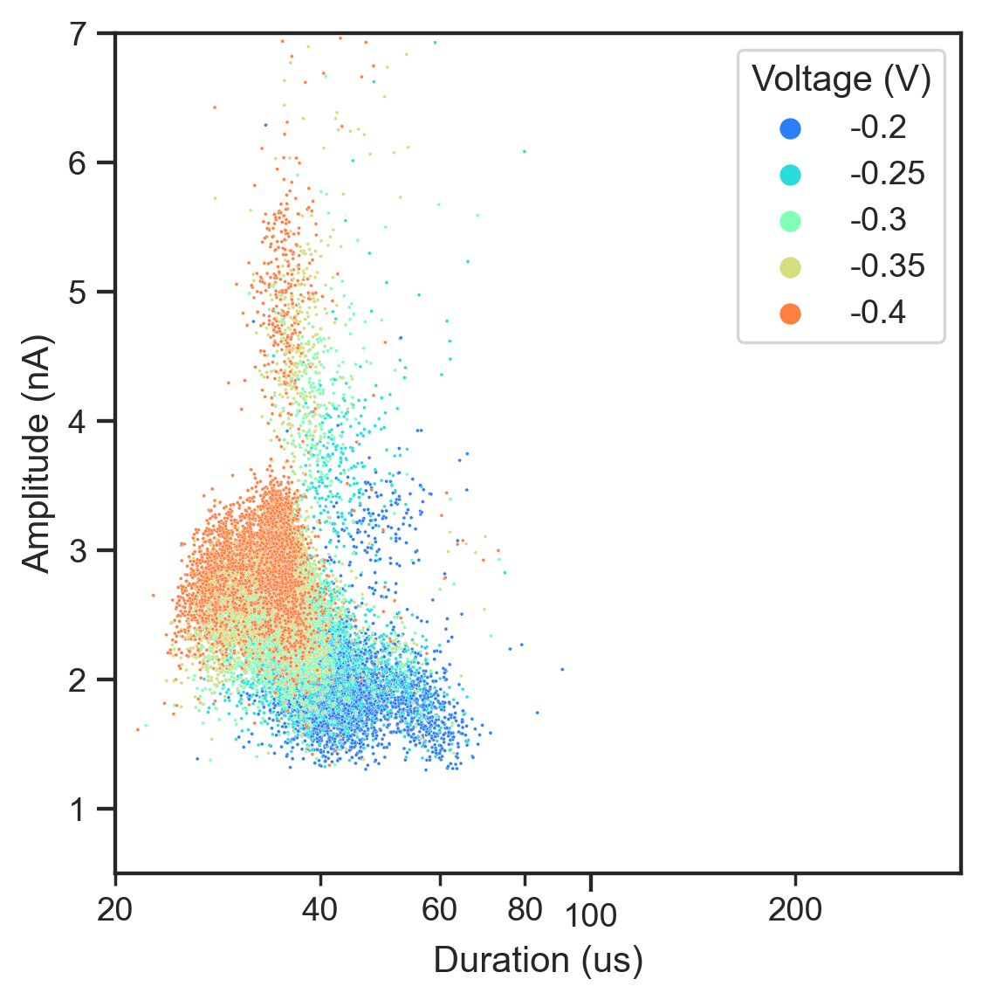

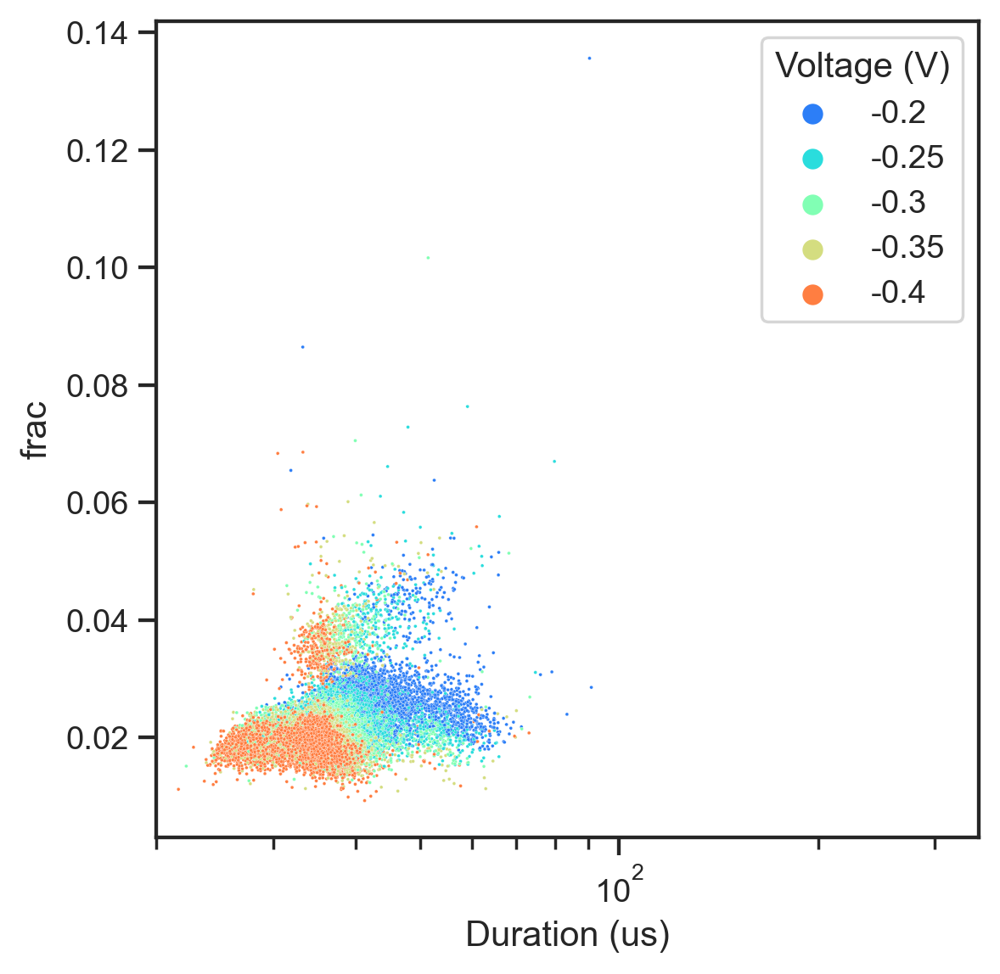

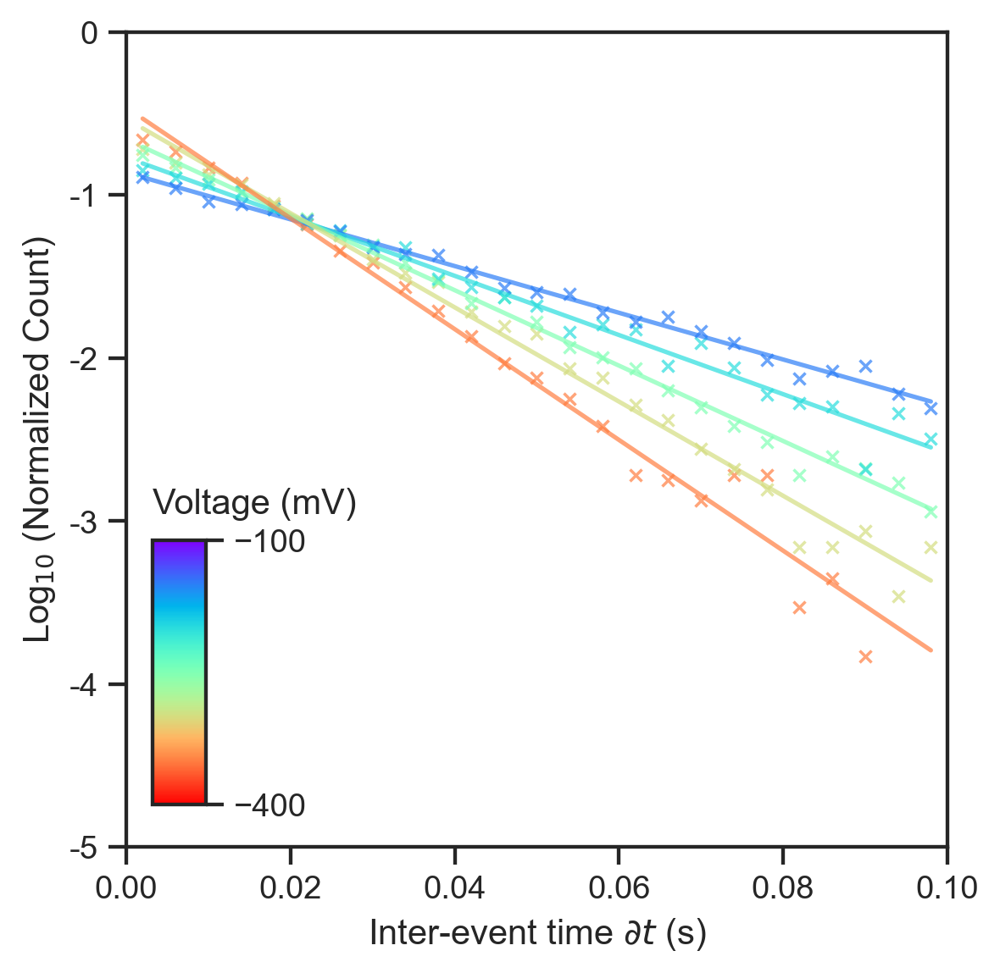

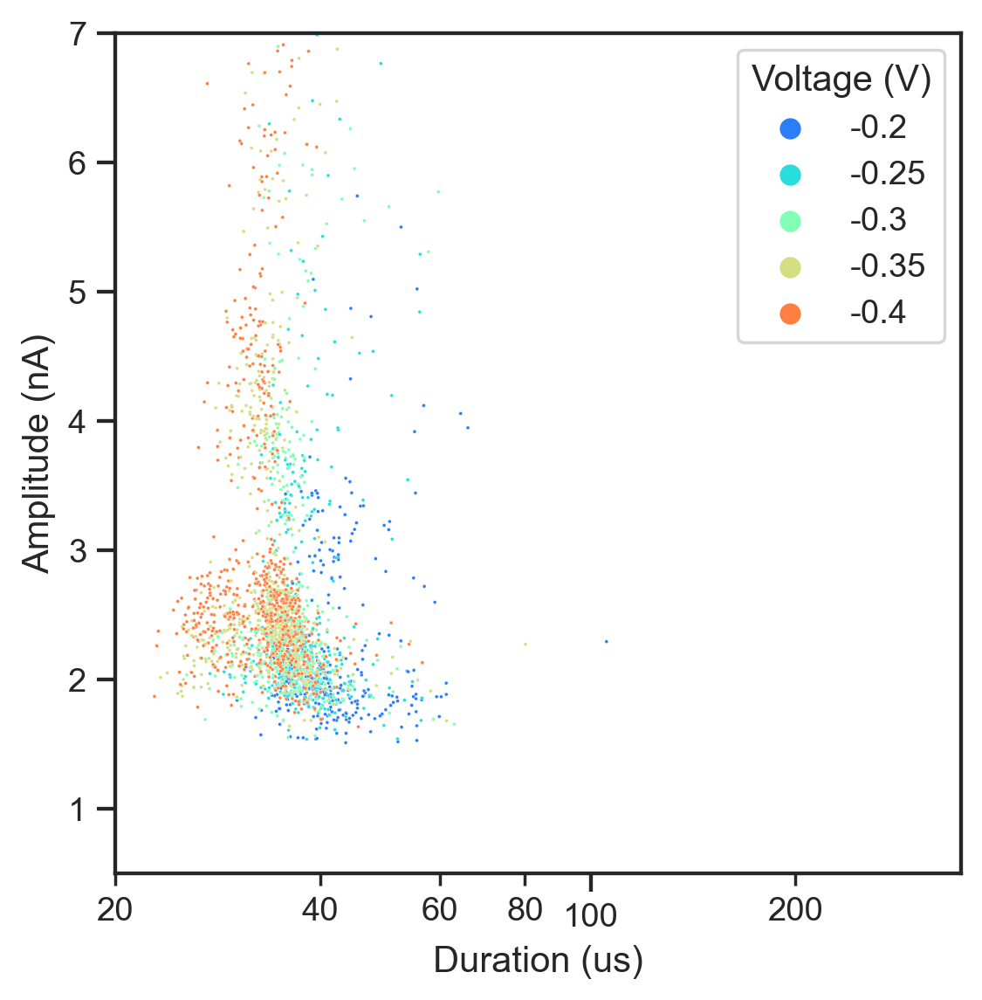

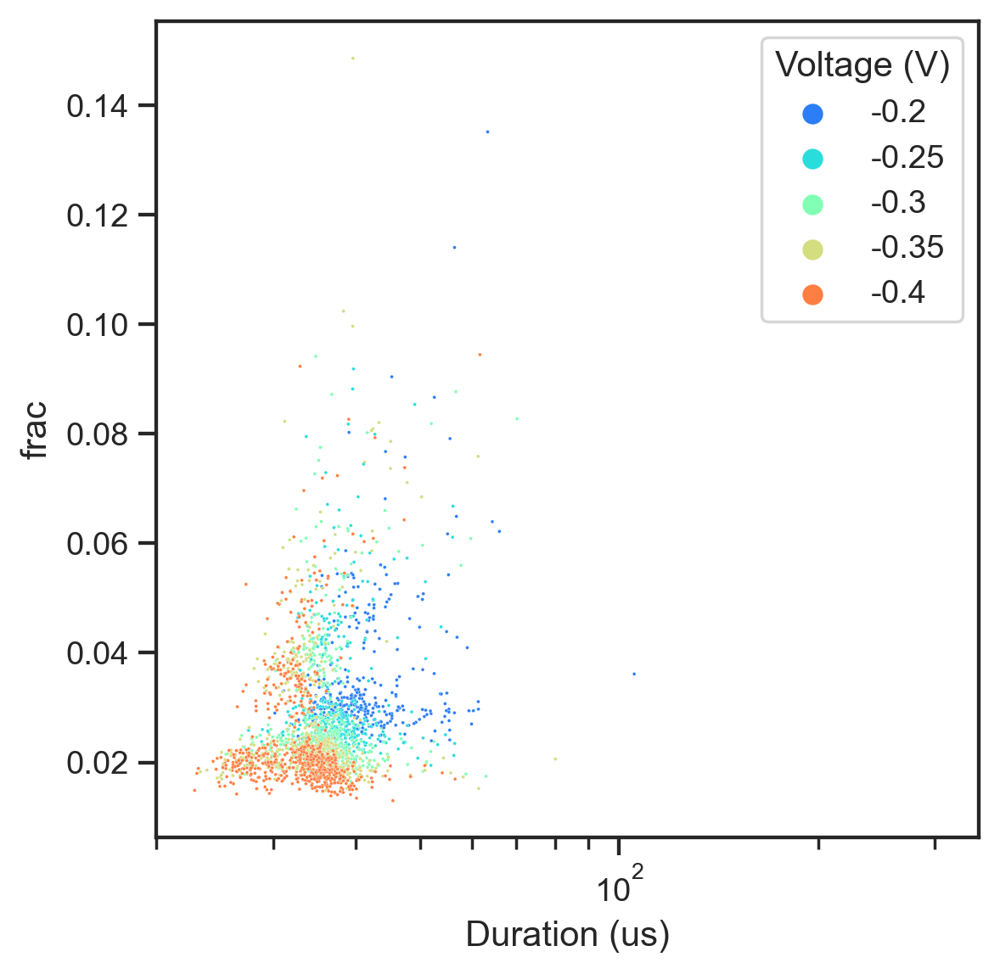

...

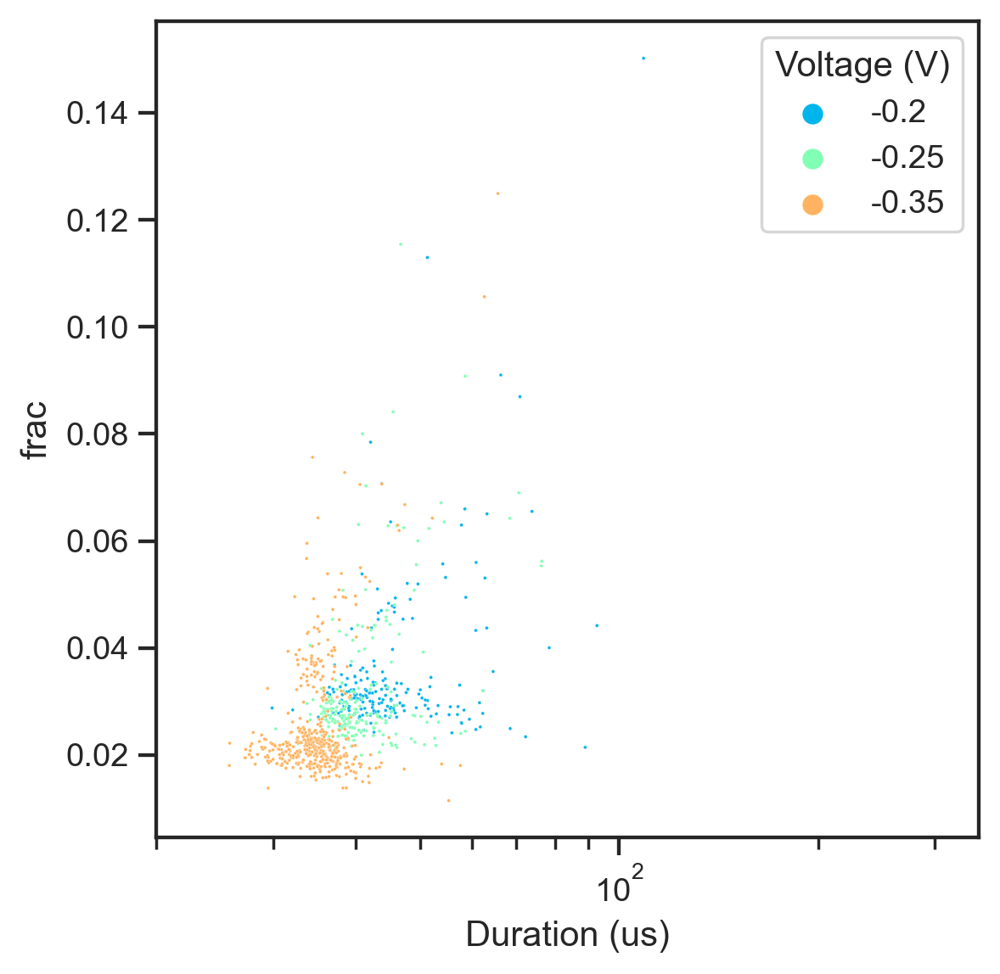

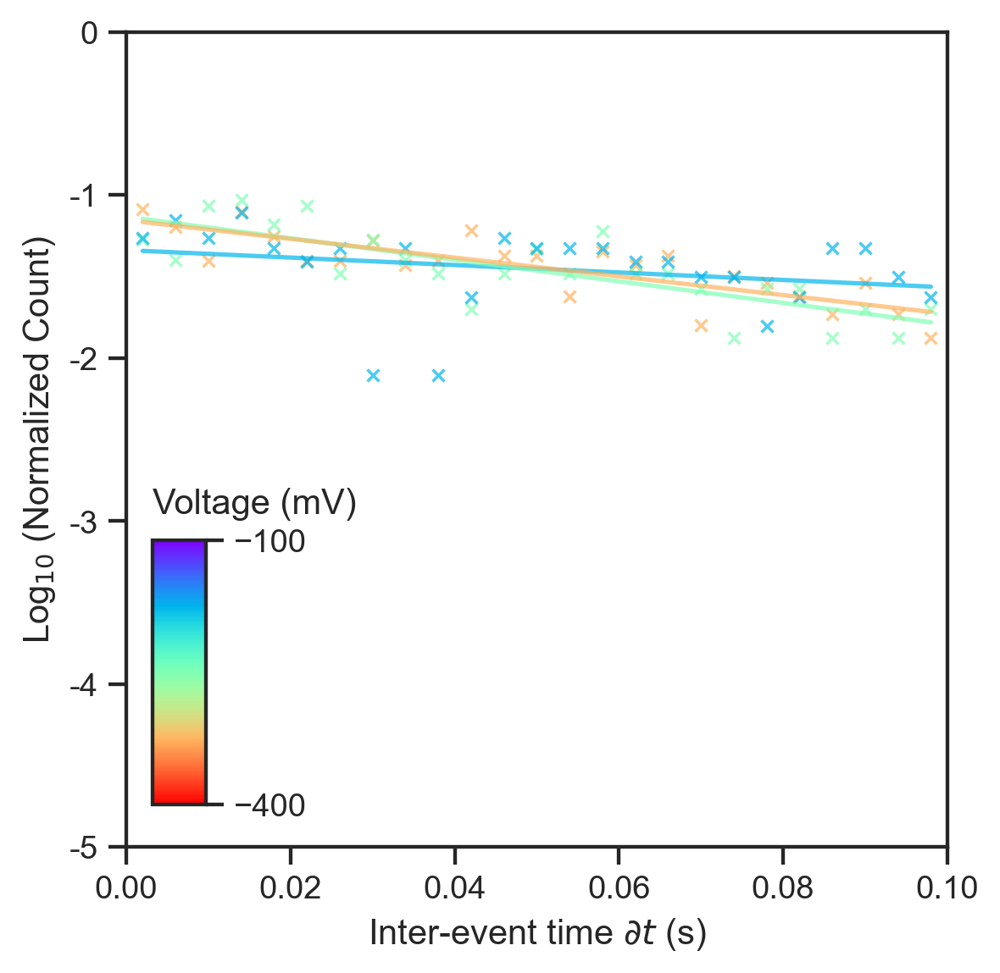

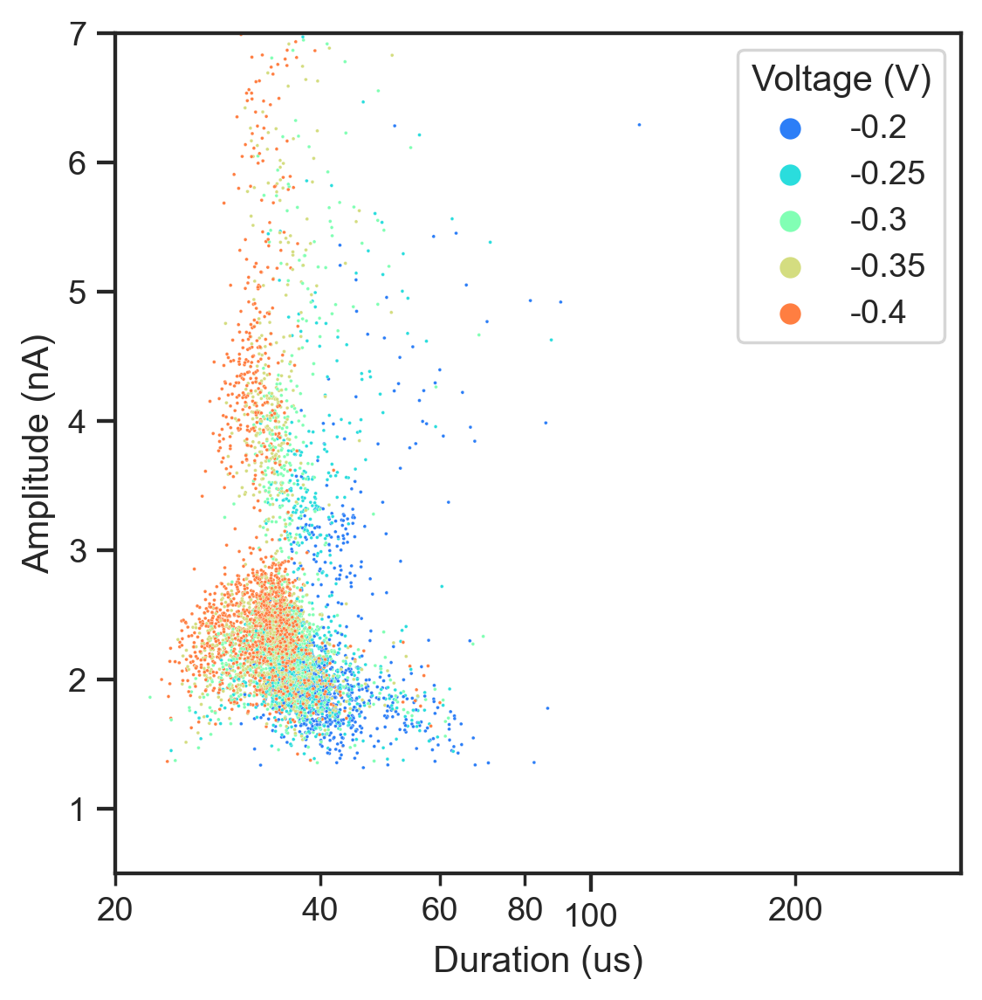

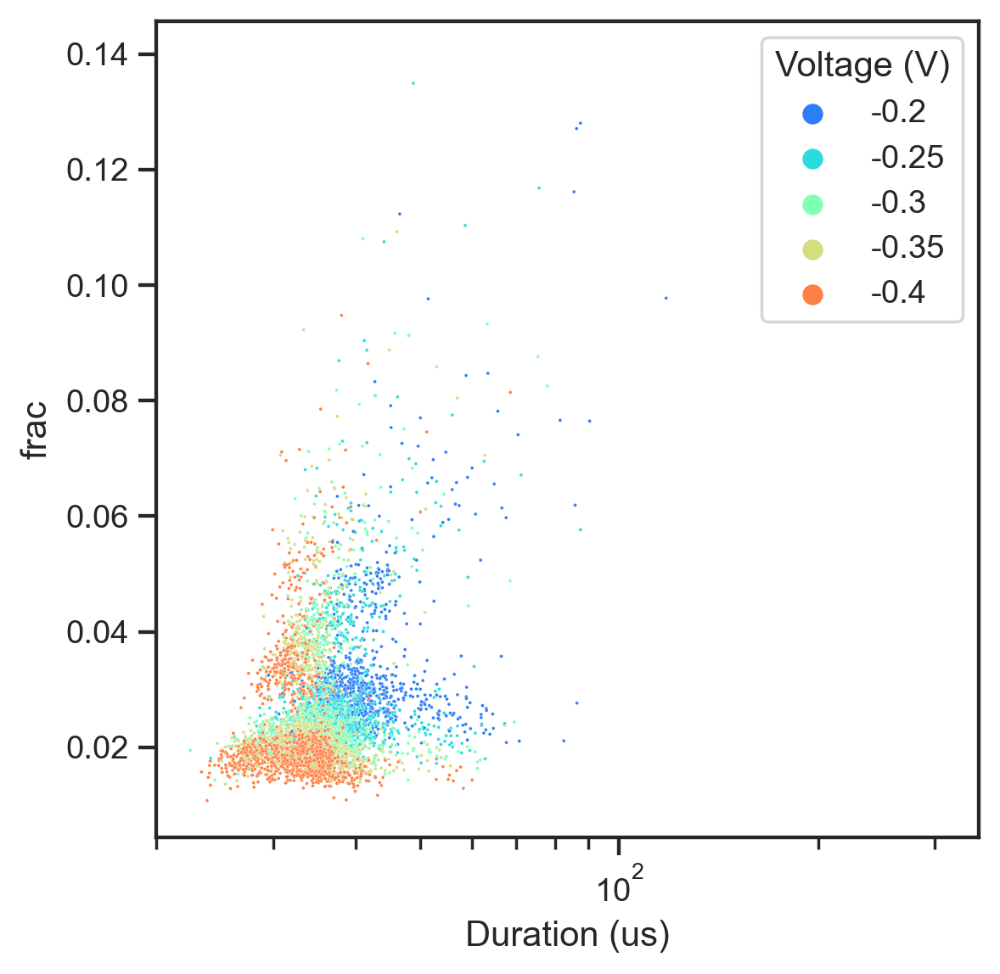

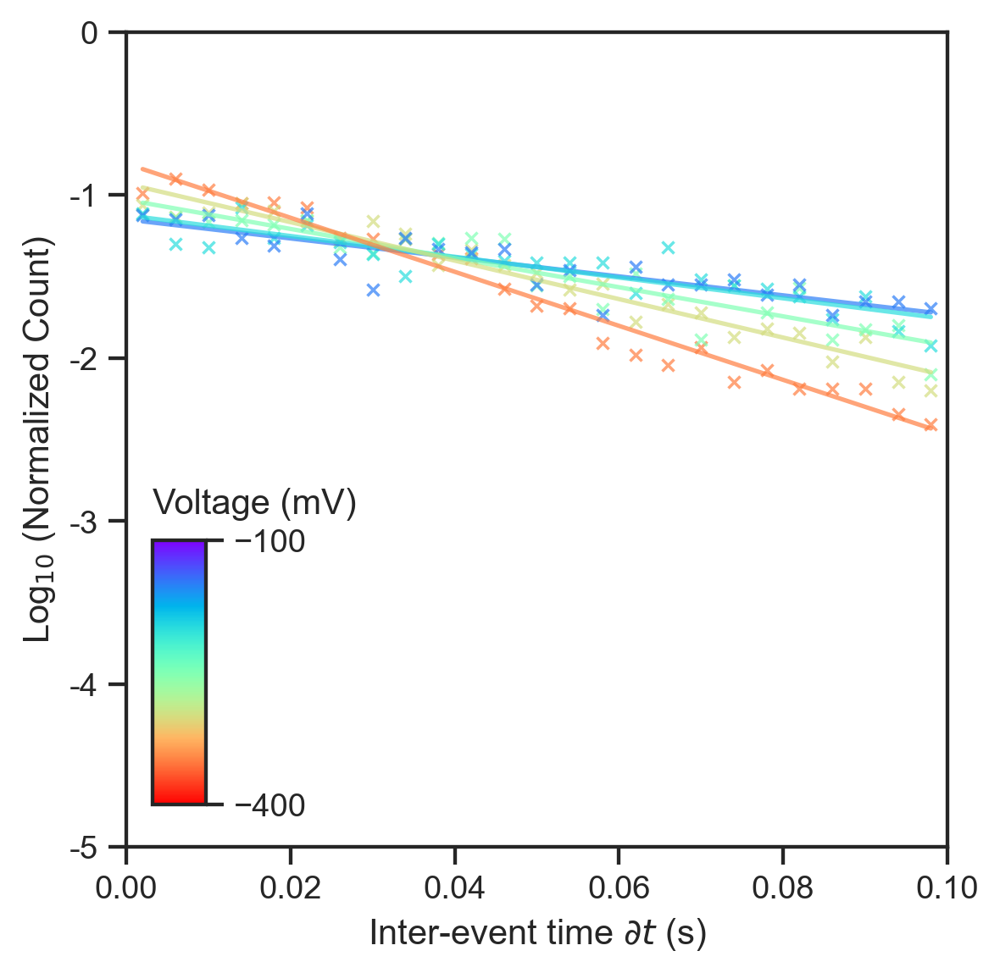

In [90]:
%matplotlib inline
import matplotlib
VR=[]
plt.rcParams["axes.labelsize"] = 12
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(5,5),dpi=250)
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(20,350)
    plt.ylim(0.5,7)
    plt.xscale('log')
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    # plt.savefig(f"EDR/scatter_plot_{file[-20:]}_output.svg",bbox_inches="tight")
    plt.figure(figsize=(5,5),dpi=250)
    ax=sns.scatterplot(_df,x='dwell',y='frac',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='rainbow')
    plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(20,350)
    # plt.ylim(0.5,7)
    plt.xscale('log')
    
    plt.figure(figsize=(5,5),dpi=250)
    # sns.histplot(_df,x='dt',hue="Voltage (V)",hue_order=hueorder)
    plt.xlim(0,0.1)
    ax=sns.histplot(data=_df,hue="Voltage (V)",hue_order=hueorder,x="dt",stat="proportion",common_norm=False,palette="rainbow",element="poly",
             binwidth=0.004,binrange=(0,0.1),fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)
    # ax.colorbar()
    cax = plt.axes([0.15, 0.15, 0.05, 0.25])
    plt.colorbar(matplotlib.cm.ScalarMappable(cmap="rainbow_r",norm=matplotlib.colors.Normalize(vmin=-400,vmax=-100)),cax=cax,ticks=[-400,-100])
    cax.text(0,-70,"Voltage (mV)",horizontalalignment='left')
    # cax = ax.figure.add_axes([.85, .9, .02, .2])
    # ax.grid()
    hists=ax.get_lines()[::-1]
    legs=ax.get_legend().texts
    for i,line in enumerate(hists):
        x_data,y_data=line.get_data()
        c=line.get_color()
        print(y_data)
        popt=single_exponential_fit(x_data,y_data)
        y_fit=single_exp(x_data,*popt)
        #     print(y_fit)
#         print(popt[1])
#         print(legs[i].get_text().split(" "))
        VR.append({"file":file,"Voltage":legs[i].get_text().split(" ")[0],"rate":popt[1]})
        ax.plot(x_data,y_fit,c=c ,label=legs[i].get_text().split(" ")[0]+f" V | {popt[1]:.1f}"+r" $ s^{-1}$")
    
    ax.legend(title="Voltage $\,$| $R_c$").set_visible(False)
    ax.set_xlim(ax.get_xlim())
    ax.set_ylim(1e-5,1)
    ax.set_xlabel("Inter-event time $\partial t$ (s)")
    ax.set_ylabel("Log$_{10}$ (Normalized Count)")
    ax.set_title(r"")
    ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
    ax.minorticks_off()
    # plt.savefig(f"EDR/event_rate_log_{file[-20:]}_output.svg",bbox_inches="tight")
    # plt.tick_params('both',which="minor")
    # ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    # ax.set_xticks( np.geomspace(30, 300 ,9).round() )
    # plt.legend(loc='upper right')
    # plt.figure

['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']
[0.1294 0.1104 0.0906 ... 0.0089 0.006  0.0049]
25
[0.1414 0.127  0.1173 ... 0.0021 0.0046 0.0032]
25
[0.175  0.1475 0.1236 ... 0.0021 0.0017 0.0011]
25
[0.1905 0.1573 0.1334 ... 0.0009 0.0003 0.0007]
25
[0.2187 0.185  0.1467 ... 0.0001 0.     0.    ]
23
['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']
[0.0654 0.028  0.0514 ... 0.0187 0.0234 0.0093]
25
[0.0411 0.0788 0.0685 ... 0.0068 0.024  0.0205]
25
[0.0659 0.0918 0.0776 ... 0.0165 0.0235 0.0047]
25
[0.0923 0.0692 0.0962 ... 0.0115 0.0154 0.0096]
25


C:\Users\alito\AppData\Local\Temp\ipykernel_26684\245872935.py:62: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
C:\Users\alito\AppData\Local\Temp\ipykernel_26684\245872935.py:62: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
C:\Users\alito\AppData\Local\Temp\ipykernel_26684\245872935.py:62: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])


[0.0968 0.0952 0.079  ... 0.0226 0.0113 0.0065]
25
['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']
[0.059  0.056  0.0708 ... 0.028  0.0265 0.0236]
25
[0.0783 0.087  0.0587 ... 0.0207 0.0174 0.0141]
25
[0.0689 0.0753 0.0666 ... 0.0135 0.0158 0.0143]
25
[0.0785 0.081  0.086  ... 0.0069 0.0056 0.01  ]
25
[0.097  0.1124 0.1047 ... 0.0035 0.0056 0.0042]
25
['-0.2' '-0.25' '-0.35']
[0.0547 0.0703 0.0547 ... 0.0469 0.0312 0.0234]
25
[0.053  0.0397 0.0861 ... 0.0199 0.0132 0.0199]
25
[0.0818 0.0633 0.0396 ... 0.029  0.0185 0.0132]
25


C:\Users\alito\AppData\Local\Temp\ipykernel_26684\245872935.py:62: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
C:\Users\alito\AppData\Local\Temp\ipykernel_26684\245872935.py:62: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']
[0.0749 0.0709 0.0749 ... 0.0223 0.0223 0.0202]
25
[0.0766 0.0502 0.0476 ... 0.0238 0.0145 0.0119]
25
[0.0756 0.0726 0.0687 ... 0.0149 0.0159 0.008 ]
25
[0.0865 0.073  0.0778 ... 0.0135 0.0071 0.0063]
25
[0.1026 0.126  0.1071 ... 0.0065 0.0045 0.0039]
25


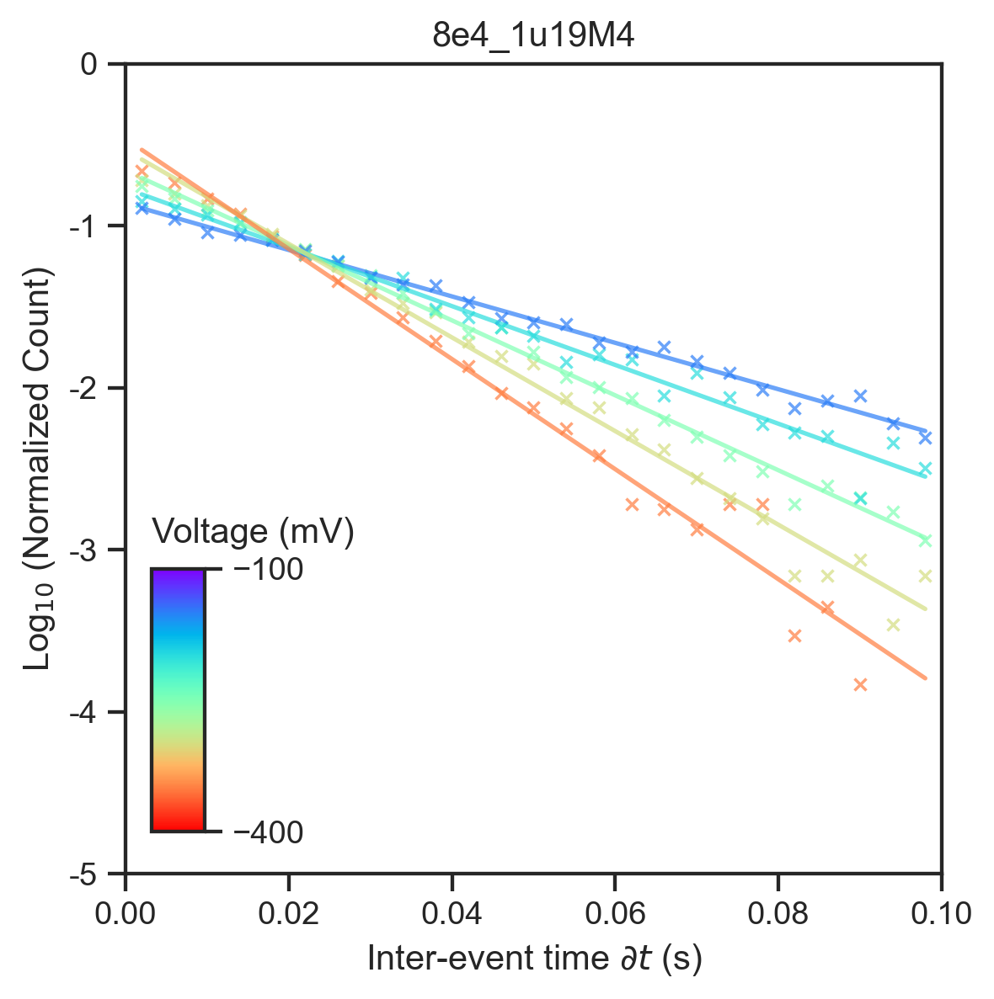

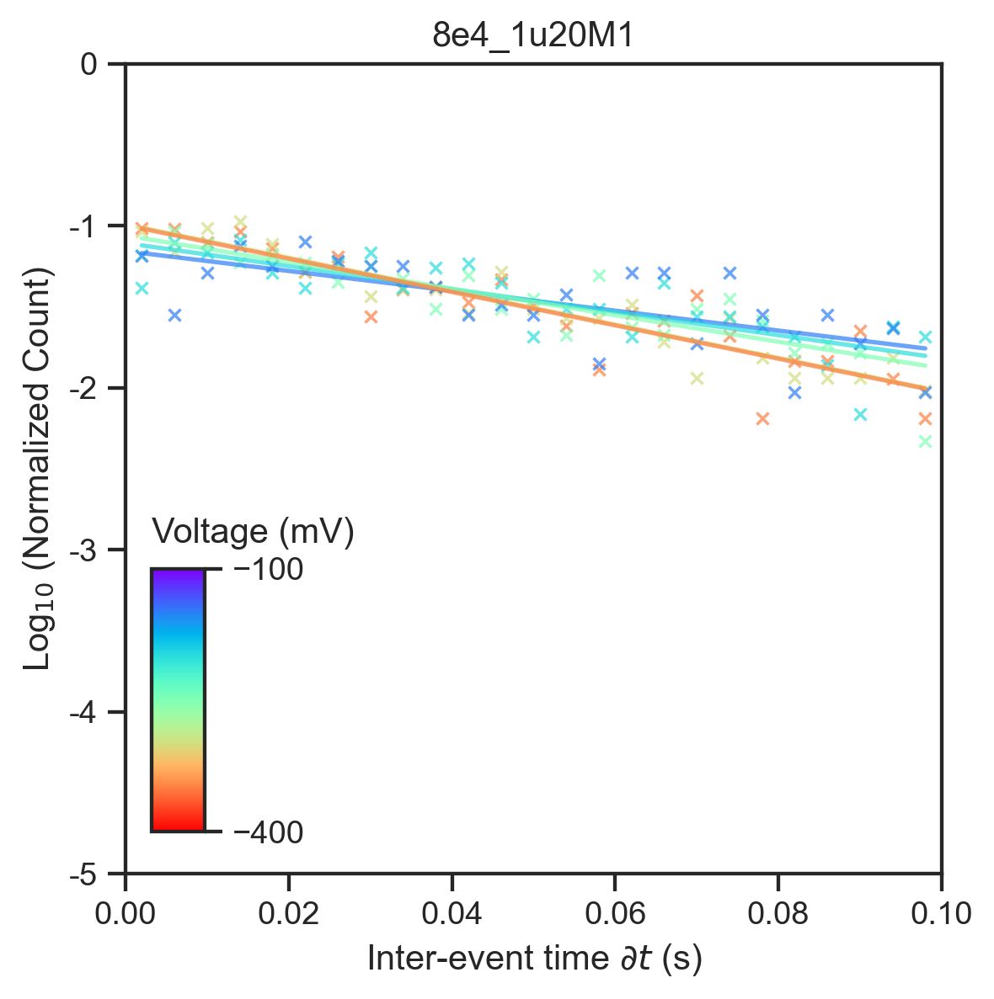

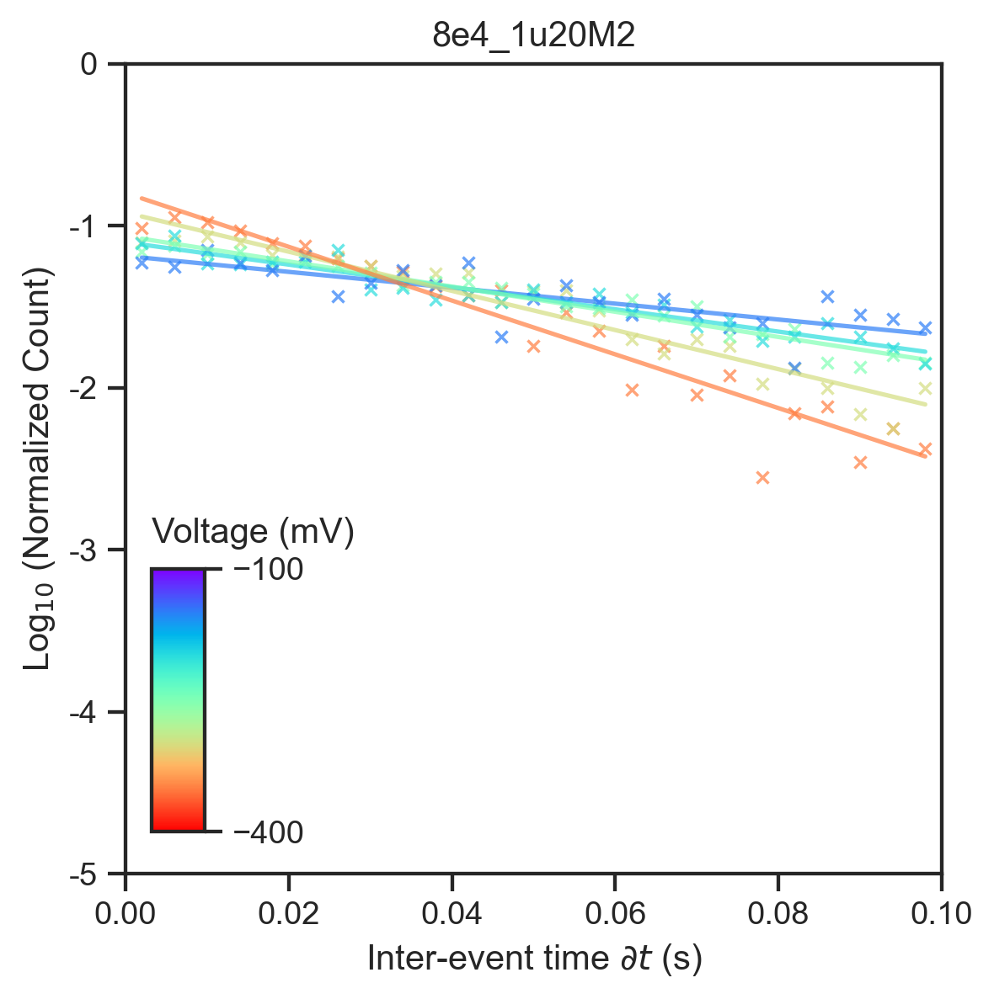

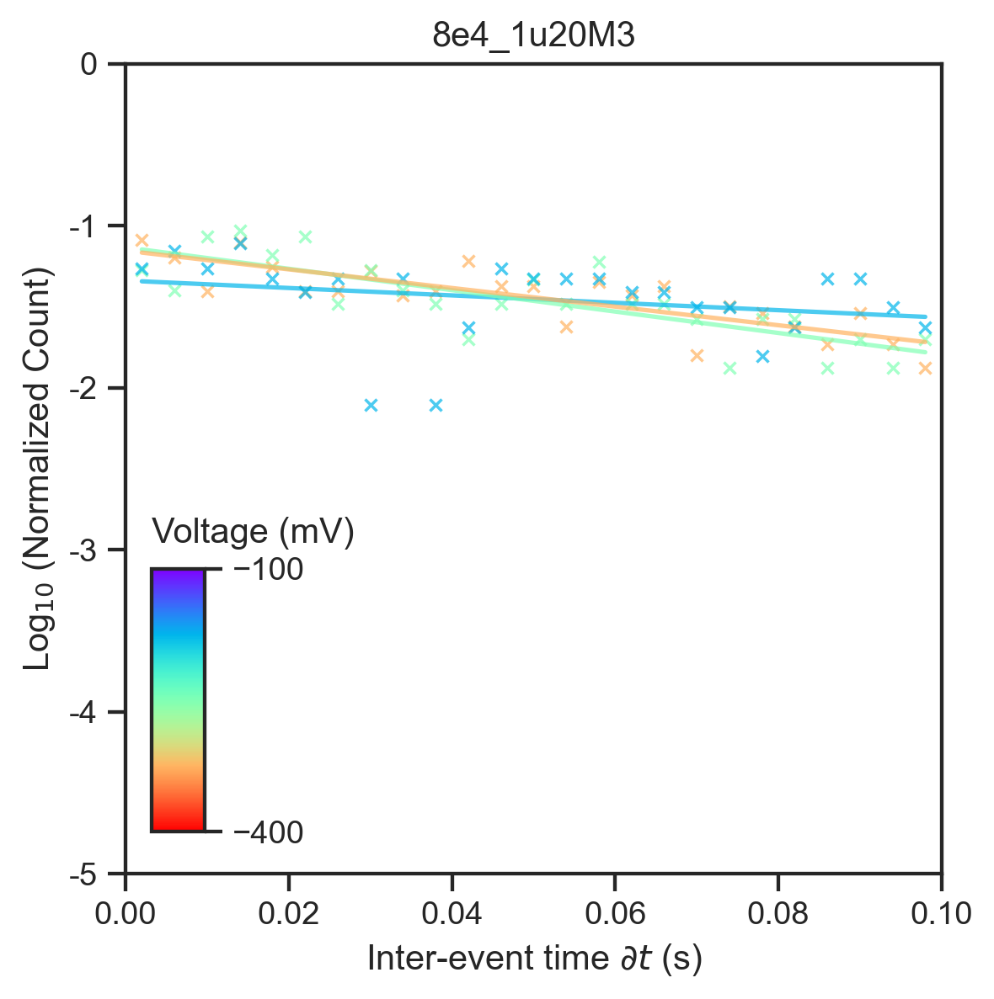

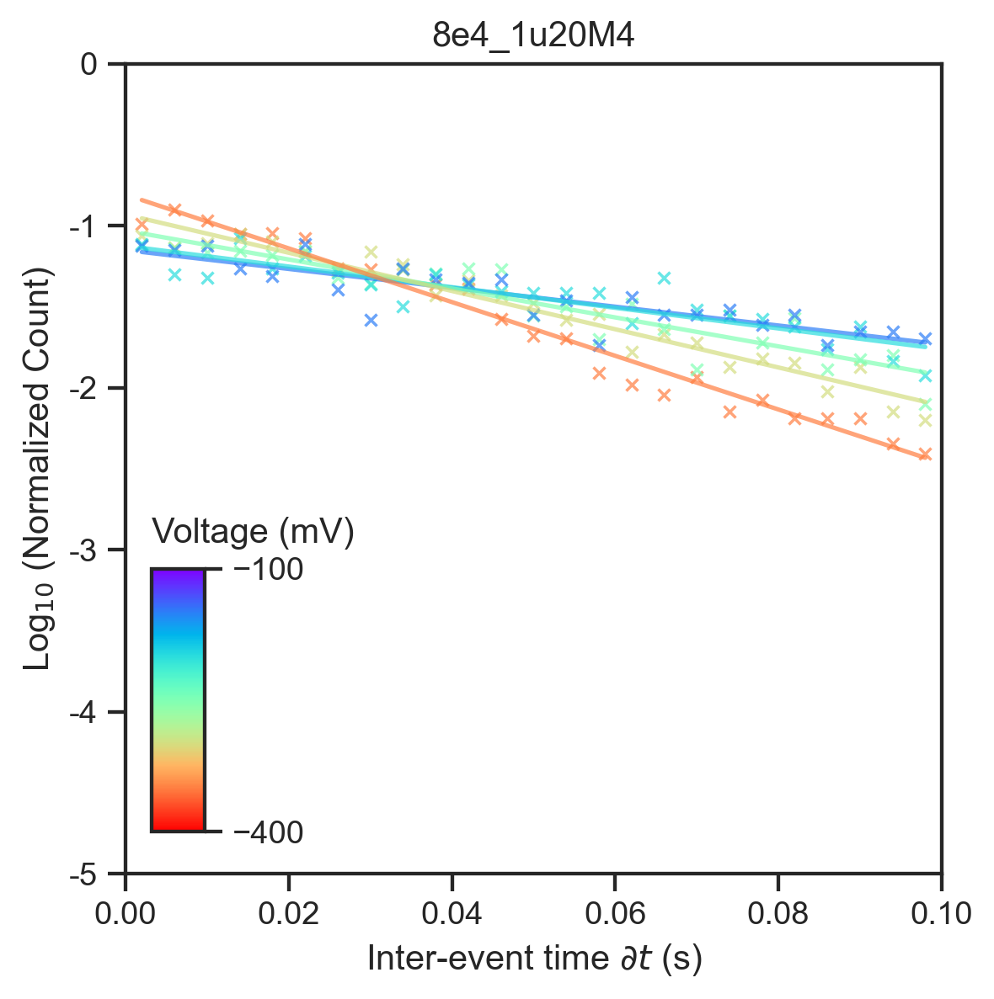

In [57]:
%matplotlib inline
import matplotlib
VR=[]
plt.rcParams["axes.labelsize"] = 12
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    # plt.figure(figsize=(5,5),dpi=250)
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    # ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1.3,palette='winter')
    # plt.legend(frameon=True,title="Voltage (V)",loc="upper right",)
    # plt.xlabel("Duration (us)")
    # plt.xlim(30,350)
    # plt.ylim(0.5,7)
    # plt.xscale('log')
    # # ax.grid()
    # ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    # ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    # locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    # ax.xaxis.set_minor_locator(locmin)
    # # plt.savefig(f"EDR/scatter_plot_{file[-20:]}_output.svg",bbox_inches="tight")
    plt.figure(figsize=(5,5),dpi=250)
    # sns.histplot(_df,x='dt',hue="Voltage (V)",hue_order=hueorder)
    plt.xlim(0,0.1)
    ax=sns.histplot(data=_df,hue="Voltage (V)",hue_order=hueorder,x="dt",stat="proportion",common_norm=False,palette="rainbow",element="poly",
             binwidth=0.004,binrange=(0,0.1),fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)
    plt.title(file.split('\\')[-1][:10])
    # ax.colorbar()
    cax = plt.axes([0.15, 0.15, 0.05, 0.25])
    plt.colorbar(matplotlib.cm.ScalarMappable(cmap="rainbow_r",norm=matplotlib.colors.Normalize(vmin=-400,vmax=-100)),cax=cax,ticks=[-400,-100])
    cax.text(0,-70,"Voltage (mV)",horizontalalignment='left')
    # cax = ax.figure.add_axes([.85, .9, .02, .2])
    # ax.grid()
    hists=ax.get_lines()[::-1]
    legs=ax.get_legend().texts
    for i,line in enumerate(hists):
        x_data,y_data=line.get_data()
        c=line.get_color()
        print(y_data)
        popt=single_exponential_fit(x_data,y_data)
        y_fit=single_exp(x_data,*popt)
        #     print(y_fit)
#         print(popt[1])
#         print(legs[i].get_text().split(" "))
        VR.append({"file":file,"Voltage":legs[i].get_text().split(" ")[0],"rate":popt[1],'dil':float(file.split("\\")[-1].split('.')[0].split("x")[-1].replace("_",'.'))})
        ax.plot(x_data,y_fit,c=c ,label=legs[i].get_text().split(" ")[0]+f" V | {popt[1]:.1f}"+r" $ s^{-1}$")
    
    ax.legend(title="Voltage $\,$| $R_c$").set_visible(False)
    ax.set_xlim(ax.get_xlim())
    ax.set_ylim(1e-5,1)
    ax.set_xlabel("Inter-event time $\partial t$ (s)")
    ax.set_ylabel("Log$_{10}$ (Normalized Count)")
    # ax.set_title(r"")
    ax.set_yticklabels([-6,-5,-4,-3,-2,-1,0])
    ax.minorticks_off()
    # plt.savefig(f"EDR/event_rate_log_{file[-20:]}_output.svg",bbox_inches="tight")
    # plt.tick_params('both',which="minor")
    # ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    # ax.set_xticks( np.geomspace(30, 300 ,9).round() )
    # plt.legend(loc='upper right')
    # plt.figure

In [81]:
_df


,voltage,deli,dwell,dt,file,Voltage (V),Voltage (mV),Amplitude (nA)
1837531,-0.10,1.413976e-09,37.117394,0.000000,C:\Users\alito\OneDrive - Northeastern Univers...,-0.1,-0.1,1.413976
1837532,-0.10,1.601826e-09,110.872218,0.155295,C:\Users\alito\OneDrive - Northeastern Univers...,-0.1,-0.1,1.601826
1837533,-0.10,1.835218e-09,147.370245,0.394630,C:\Users\alito\OneDrive - Northeastern Univers...,-0.1,-0.1,1.835218
1837534,-0.10,1.690633e-09,145.947936,0.153470,C:\Users\alito\OneDrive - Northeastern Univers...,-0.1,-0.1,1.690633
1837535,-0.10,1.480917e-09,136.607205,0.129630,C:\Users\alito\OneDrive - Northeastern Univers...,-0.1,-0.1,1.480917
...,...,...,...,...,...,...,...,...
2082312,-0.35,2.622386e-09,37.307597,0.000310,C:\Users\alito\OneDrive - Northeastern Univers...,-0.35,-0.35,2.622386
2082313,-0.35,2.699451e-09,41.637649,0.001045,C:\Users\alito\OneDrive - Northeastern Univers...,-0.35,-0.35,2.699451
2082314,-0.35,4.553314e-09,40.053390,0.003790,C:\Users\alito\OneDrive - Northeastern Univers...,-0.35,-0.35,4.553314
2082315,-0.35,2.967823e-09,40.648443,0.002610,C:\Users\alito\OneDrive - Northeastern Univers...,-0.35,-0.35,2.967823


In [80]:
gc.collect()

245913

[-400 -350 -300 -250 -200]
23
25
25
25
25
[-400 -350 -300 -250 -200]
25
25
25
25
25
[-400 -350 -300 -250 -200]
25
25
25
25
25
[-350 -250 -200]
25
25
25
[-400 -350 -300 -250 -200]
25
25
25
25
25


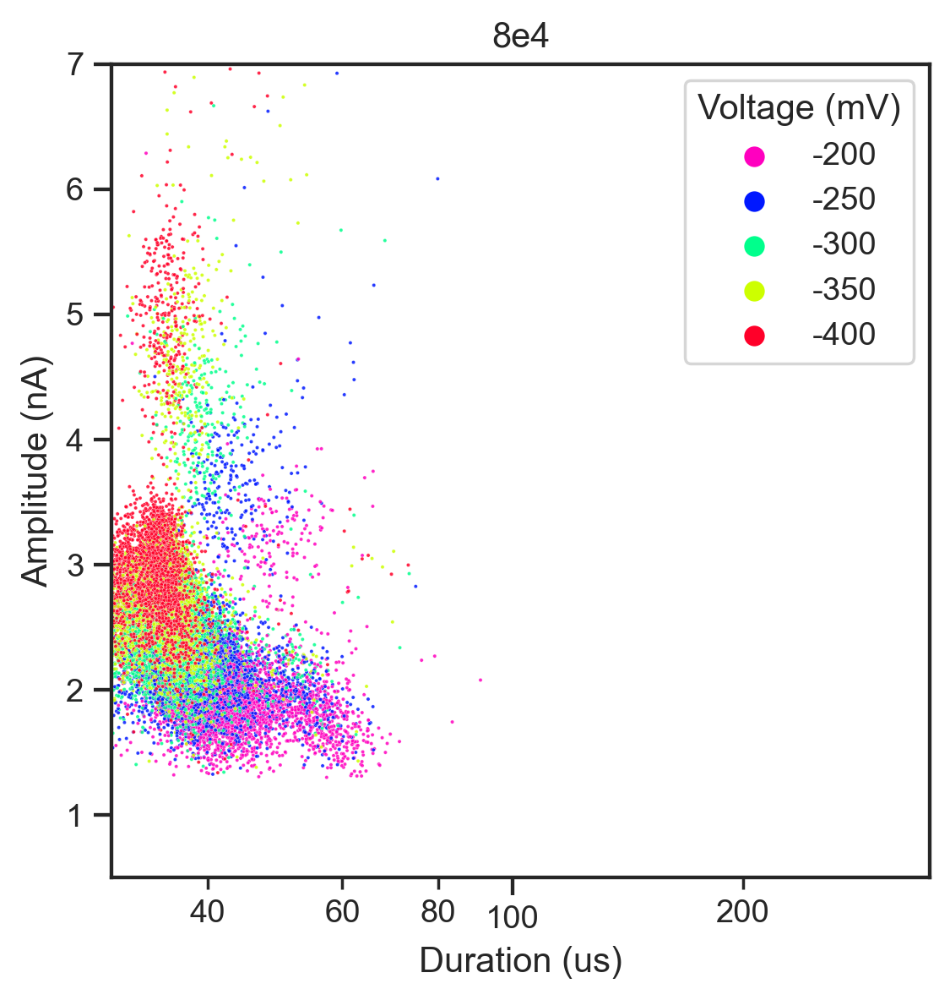

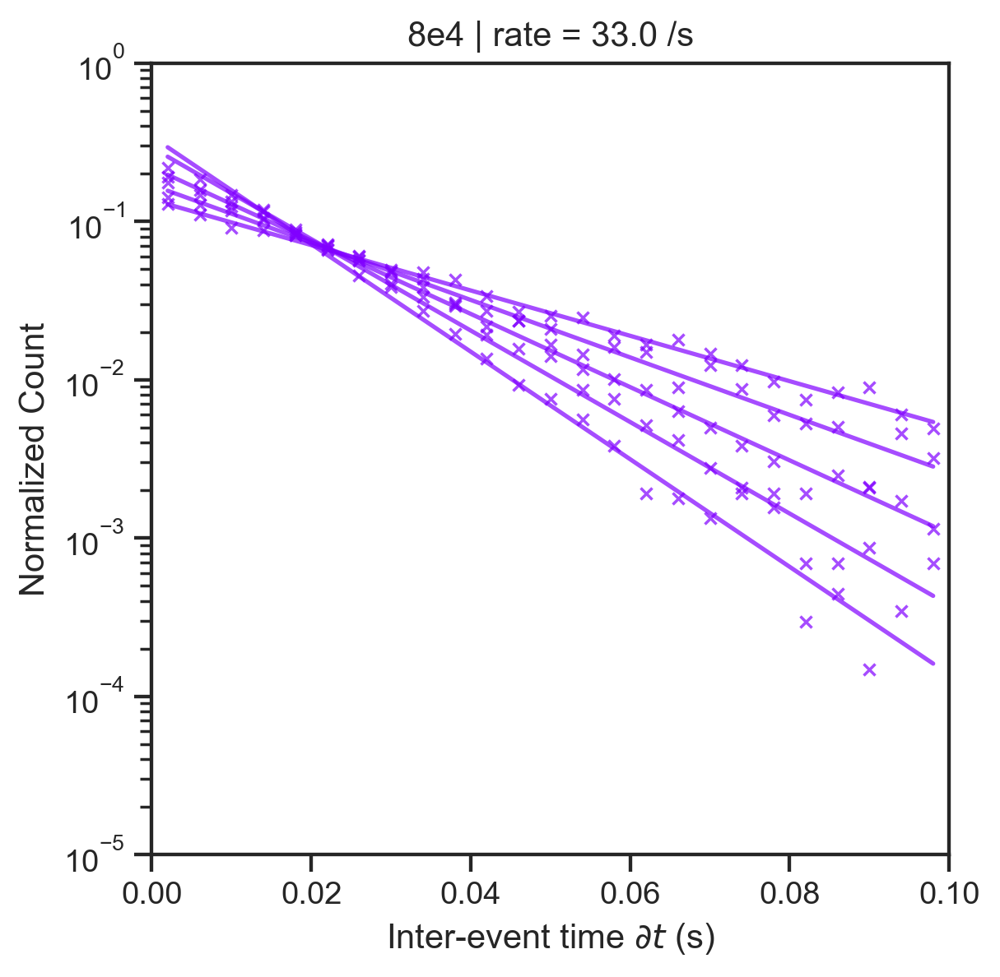

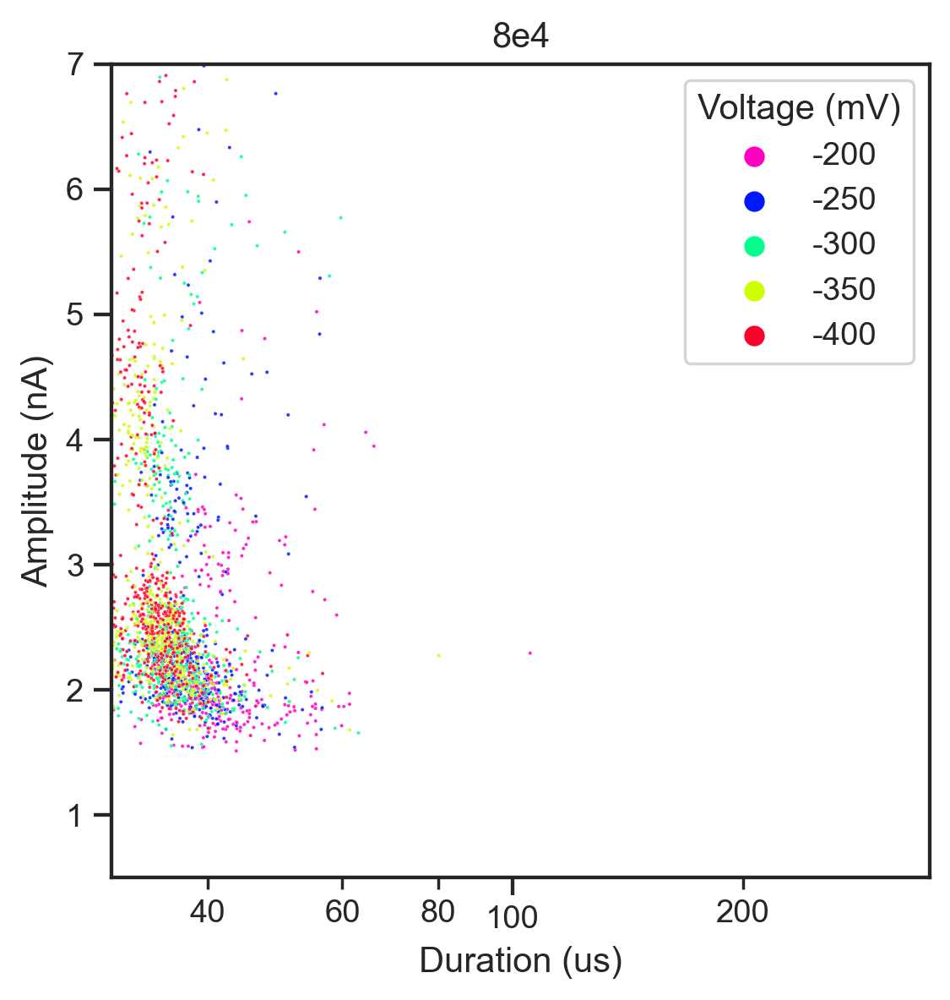

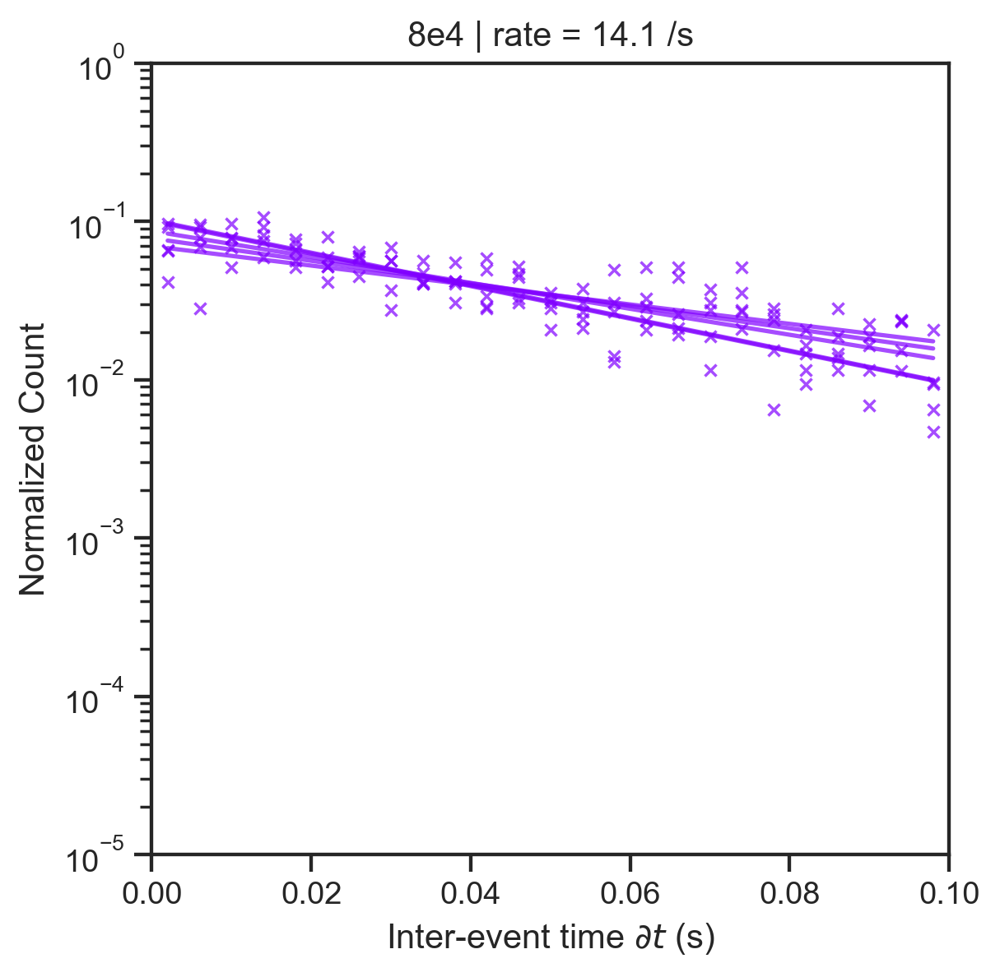

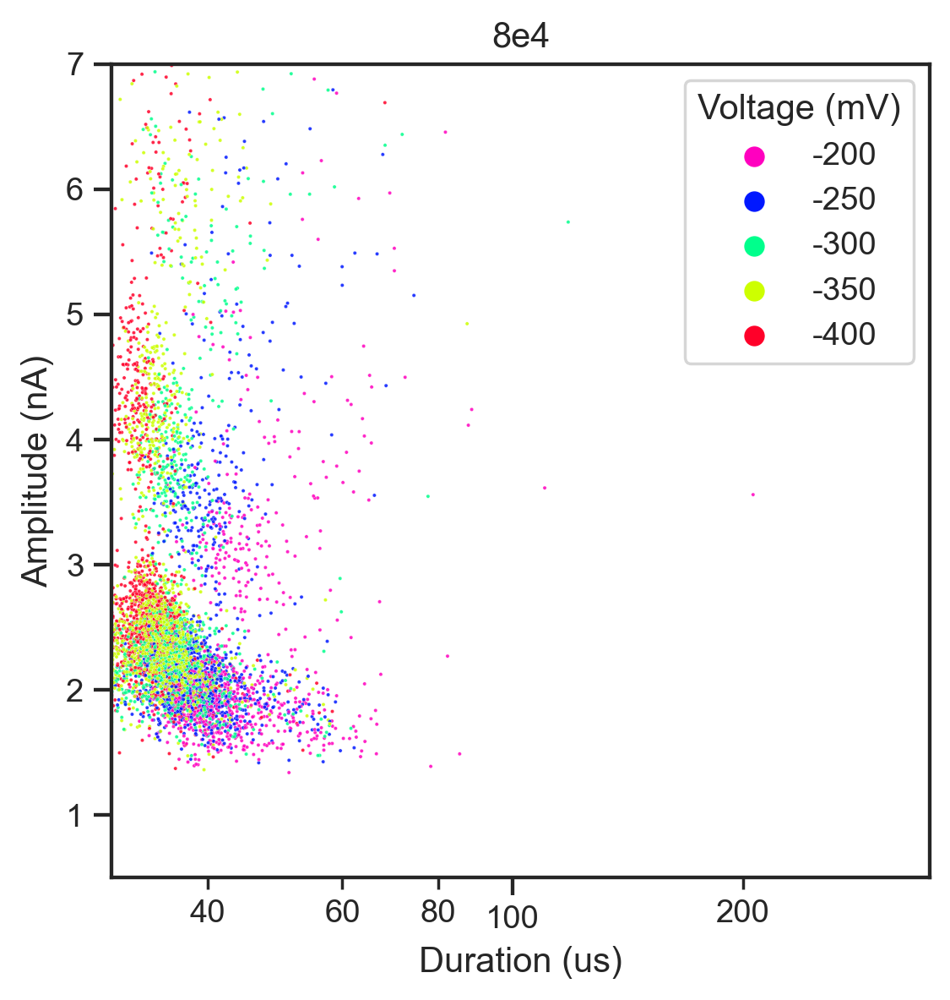

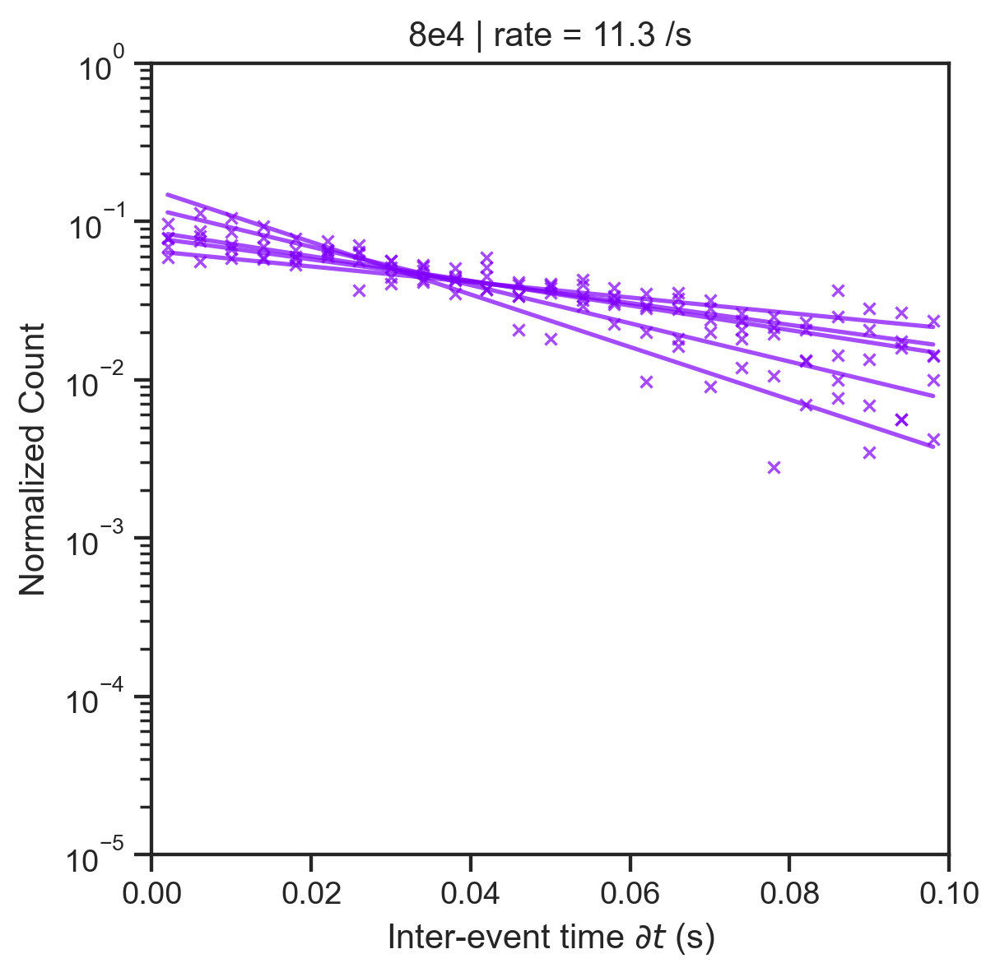

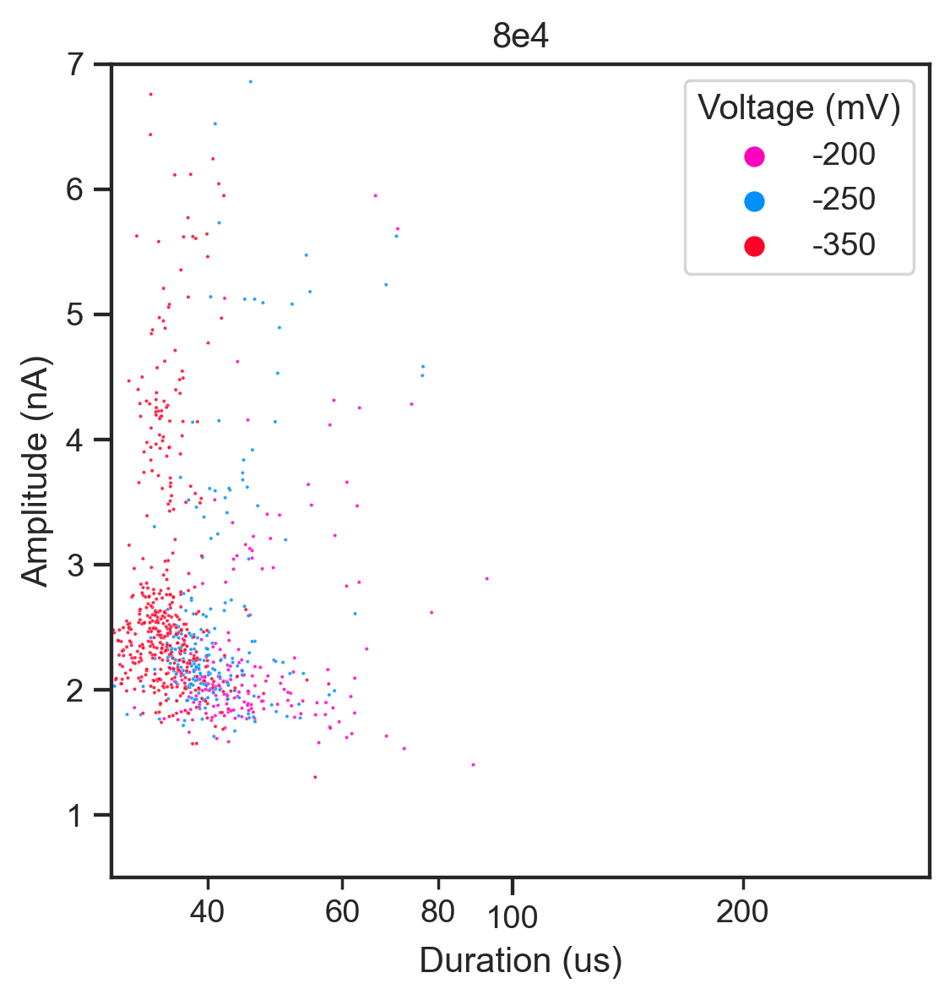

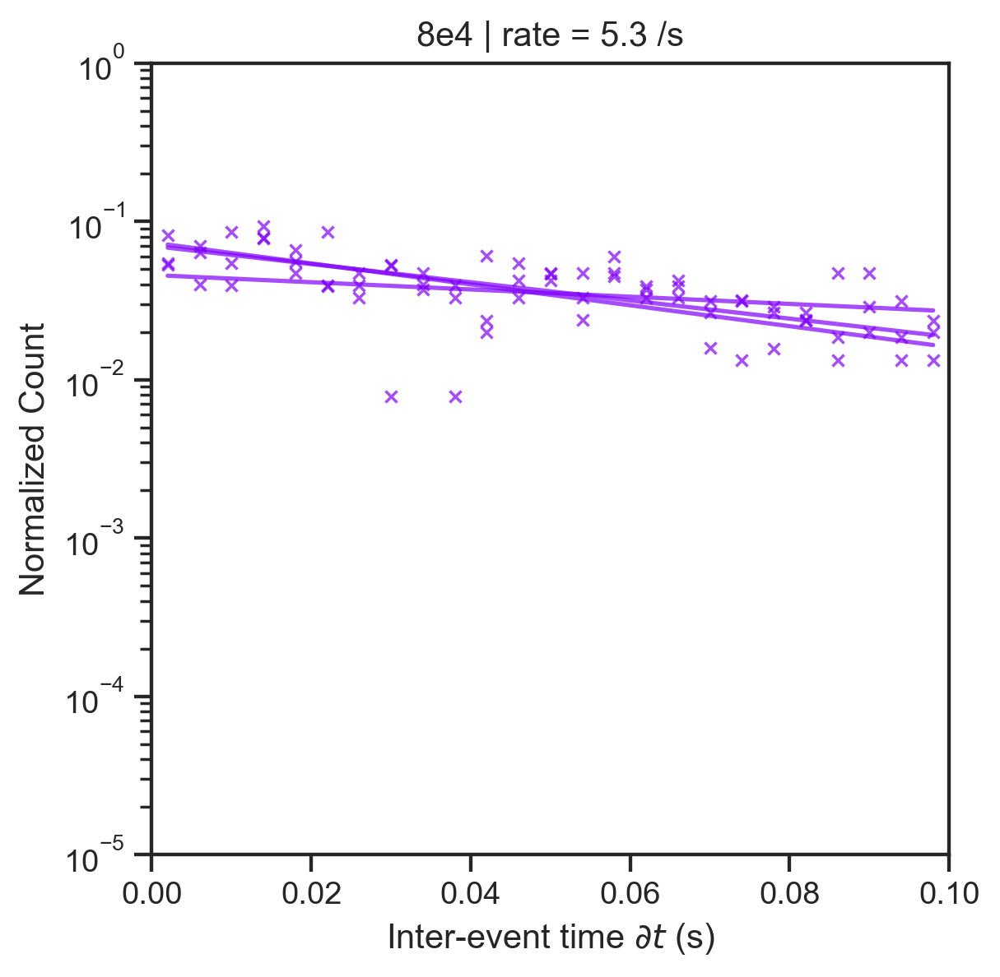

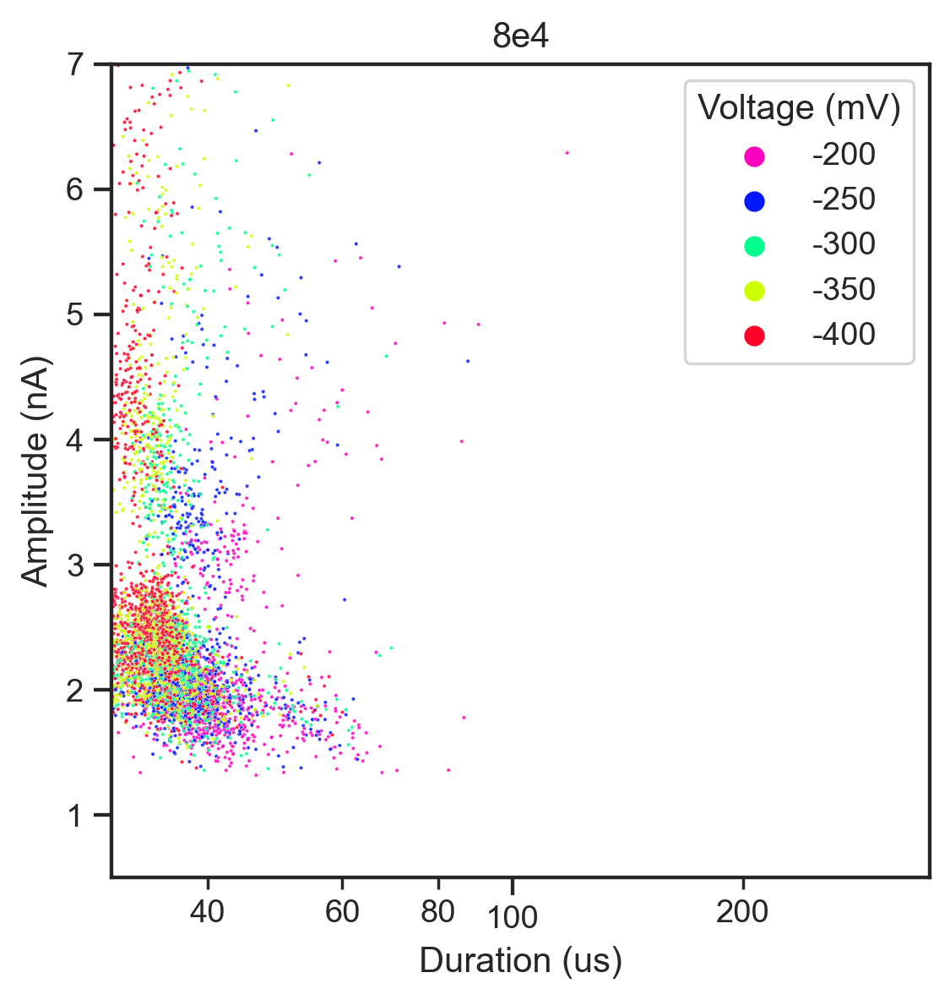

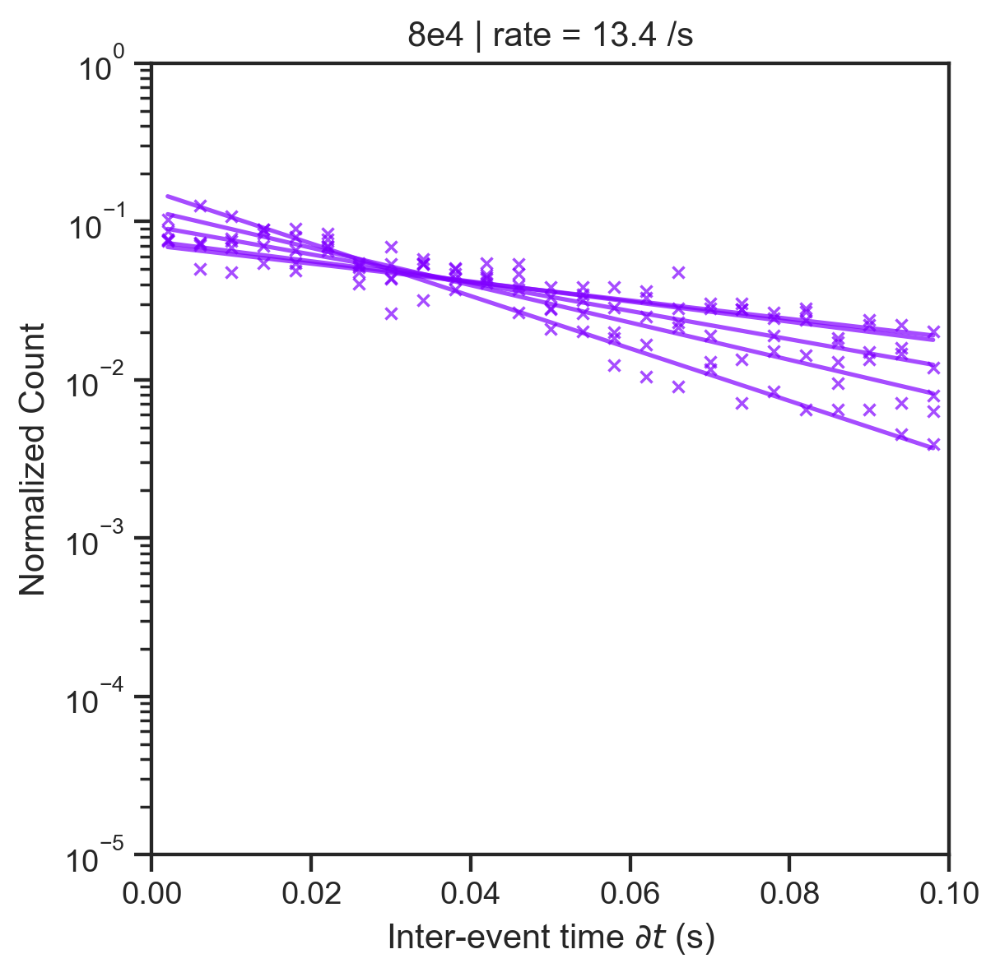

In [44]:
%matplotlib inline
import matplotlib
# selection=[step for step in sfm.traverse_to_rank("vstepgap") if round(step.get_feature("voltage"),1) in [-0.1,-0.2,-0.3,-0.4] and step.duration>1 and step.std<1.2e-9]
# _d={key: [] for key in feature_list+['file']}
# for tf in selection:
#     for event in tf.traverse_to_rank('event'):
#         _d["file"].append(tf.get_feature('metadata')["HeaderFile"])
        
#         for feature in feature_list:
#             _d[feature].append(event.get_feature(feature))

# df=pd.DataFrame(_d)
# df.tail()
_dftemp=df.loc[df['voltage'].round(3).isin(np.array([-0.1,-0.15,-0.2,-0.25,-0.3,-0.35,-0.4],dtype=np.float32))]
# print(df['voltage'].round(3).isin().head(90))
VR=[]
plt.rcParams["axes.labelsize"] = 12
for file,_df in _dftemp.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(5,5),dpi=250)
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['voltage (mV)']=_df['voltage']*1000
    _df['voltage (mV)']=_df['voltage (mV)'].astype(int)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['voltage (mV)'].unique()
    hueorder.sort()
    # hueorder=hueorder[::-1]
    print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='voltage (mV)',hue_order=hueorder,s=1.5,palette='gist_rainbow',alpha=0.85)
    handler, label = ax.get_legend_handles_labels()
    
    ax.legend(handler[::-1],label[::-1],frameon=True,title="Voltage (mV)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(30,350)
    plt.ylim(0.5,7)
    plt.xscale('log')
    fname=file.split('\\')[-1]
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    ax.set_title(fname.split('\\')[-1].split('_')[0])
    # plt.savefig(f"EDR/scatter_plot_100mV_{fname}_output.svg",bbox_inches="tight")
    plt.figure(figsize=(5,5),dpi=250)
    # sns.histplot(_df,x='dt',hue="Voltage (V)",hue_order=hueorder)
    plt.xlim(0,0.1)
    ax=sns.histplot(data=_df,hue="voltage (mV)",hue_order=hueorder,x="dt",stat="proportion",hue_norm=(-0.41,-0.09),common_norm=False,palette="rainbow",element="poly",
             binwidth=0.004,binrange=(0,0.1),fill=False,alpha=0.7,log_scale=(False,True),marker="x",markersize=4,lw=0)
    # ax.colorbar()
    
    # cax = plt.axes([0.15, 0.15, 0.05, 0.25])
    # plt.colorbar(matplotlib.cm.ScalarMappable(cmap="rainbow_r",norm=matplotlib.colors.Normalize(vmin=-400,vmax=-100)),cax=cax,ticks=[-400,-100])
    # cax.text(0,-70,"Voltage (mV)",horizontalalignment='left')
    
    
    
    # cax = ax.figure.add_axes([.85, .9, .02, .2])
    # ax.grid()
    hists=ax.get_lines()[::-1]
    legs=ax.get_legend().texts
    for i,line in enumerate(hists):
        x_data,y_data=line.get_data()
        c=line.get_color()
        popt=single_exponential_fit(x_data,y_data)
        y_fit=single_exp(x_data,*popt)
        #     print(y_fit)
#         print(popt[1])
#         print(legs[i].get_text().split(" "))
        VR.append({"file":file,"Voltage":legs[i].get_text().split(" ")[0],"rate":popt[1]})
        ax.plot(x_data,y_fit,c=c ,label=legs[i].get_text().split(" ")[0]+f" V | {popt[1]:.1f}"+r" $ s^{-1}$")
    
    ax.legend(title="Voltage $\,$| $R_c$").set_visible(False)
    ax.set_xlim(ax.get_xlim())
    ax.set_ylim(1e-5,1)
    ax.set_xlabel("Inter-event time $\partial t$ (s)")
    ax.set_ylabel("Normalized Count")
    # ax.set_title(r"")
    ax.set_title(fname.split('\\')[-1].split('_')[0]+ f" | rate = {VR[-1]['rate']:.1f} /s")
    
    # plt.savefig(f"EDR/event_rate_100mV_{fname}_output.svg",bbox_inches="tight")
    # plt.tick_params('both',which="minor")
    # ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    # ax.set_xticks( np.geomspace(30, 300 ,9).round() )
    # plt.legend(loc='upper right')
    # plt.figure

[-300]
[-300]
[-300]
[-300]
[-300]
[-300]


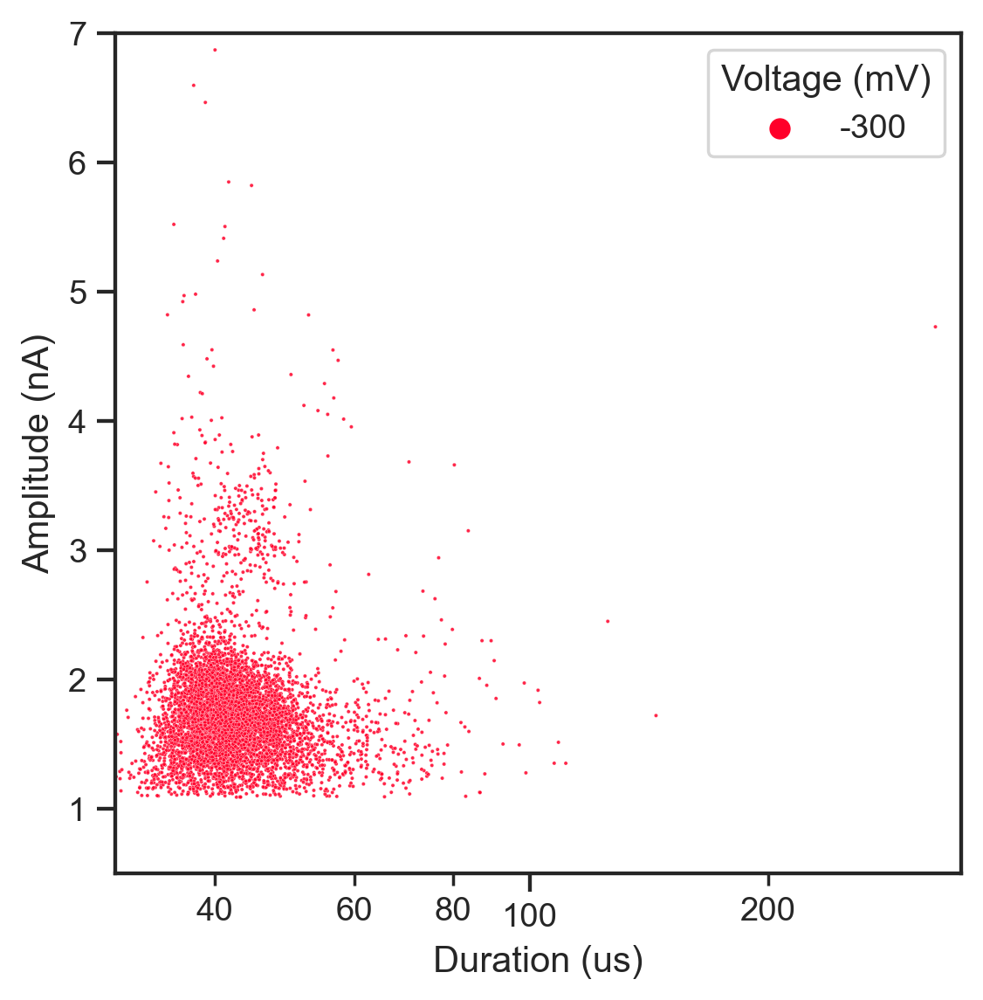

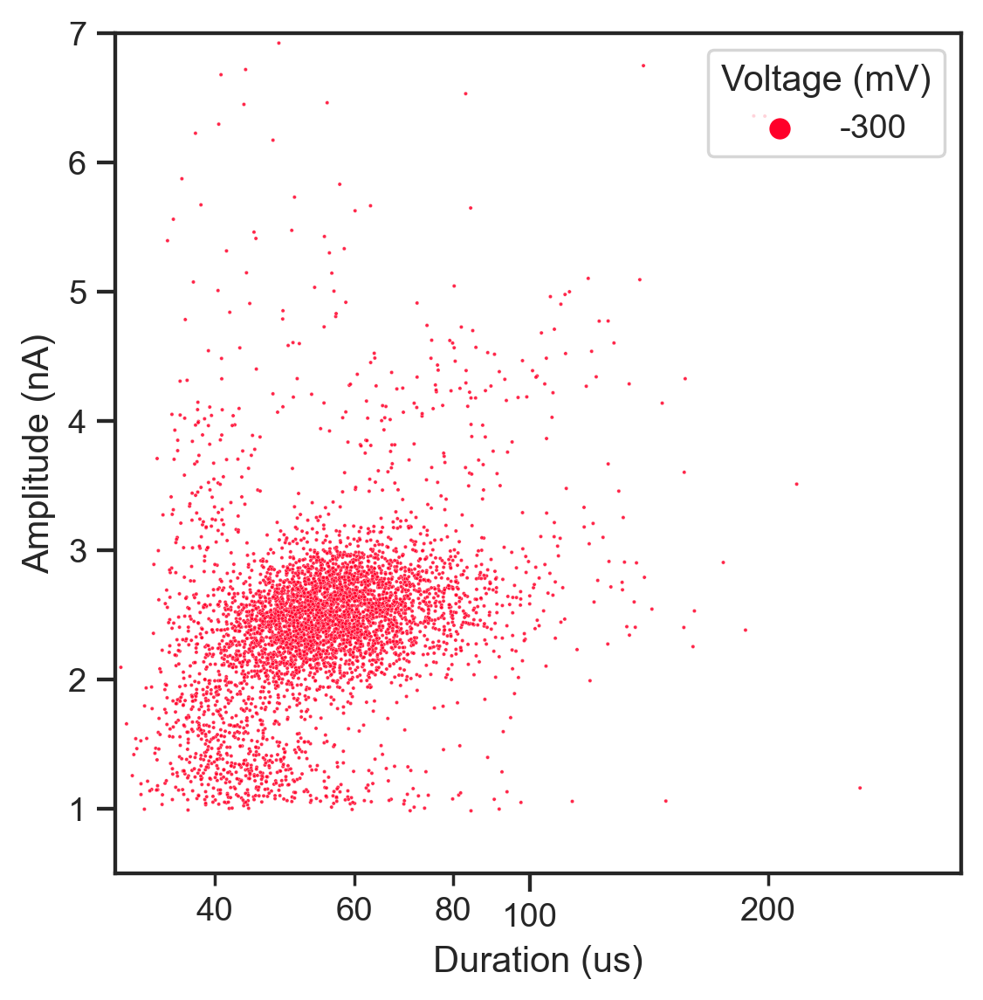

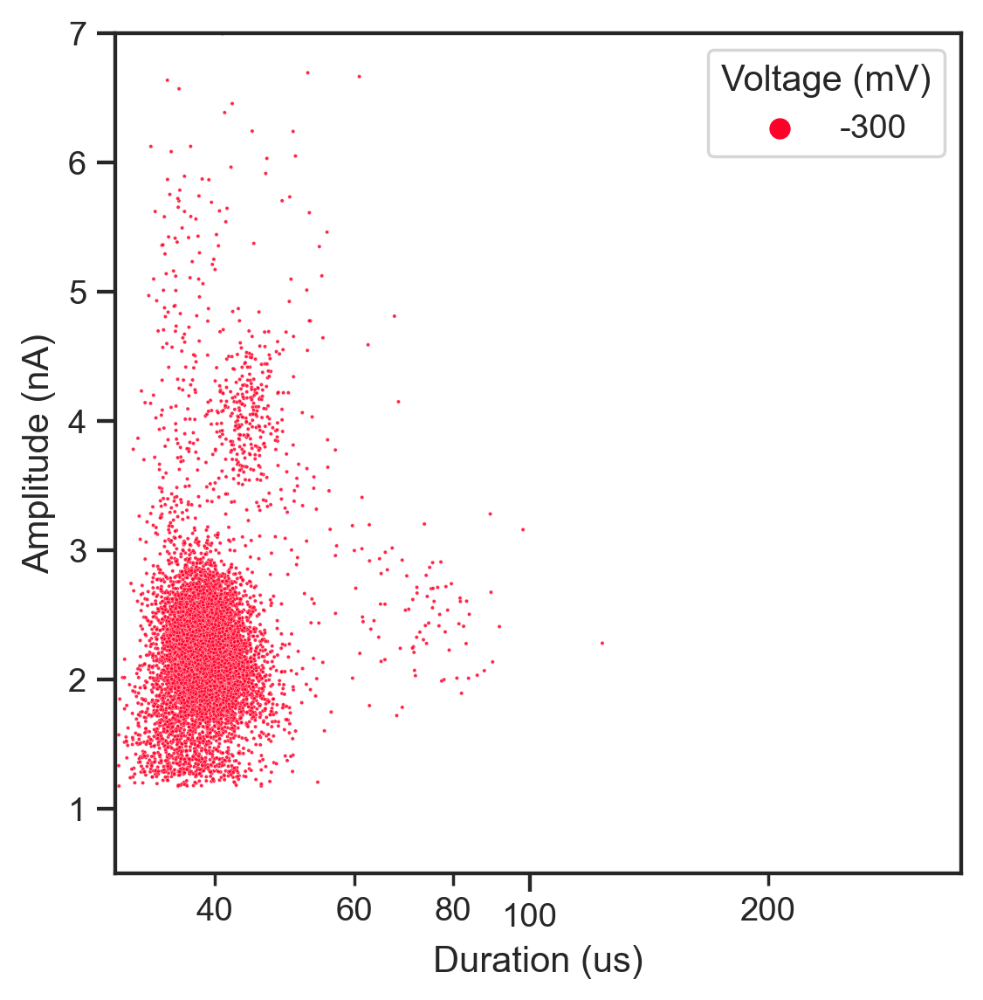

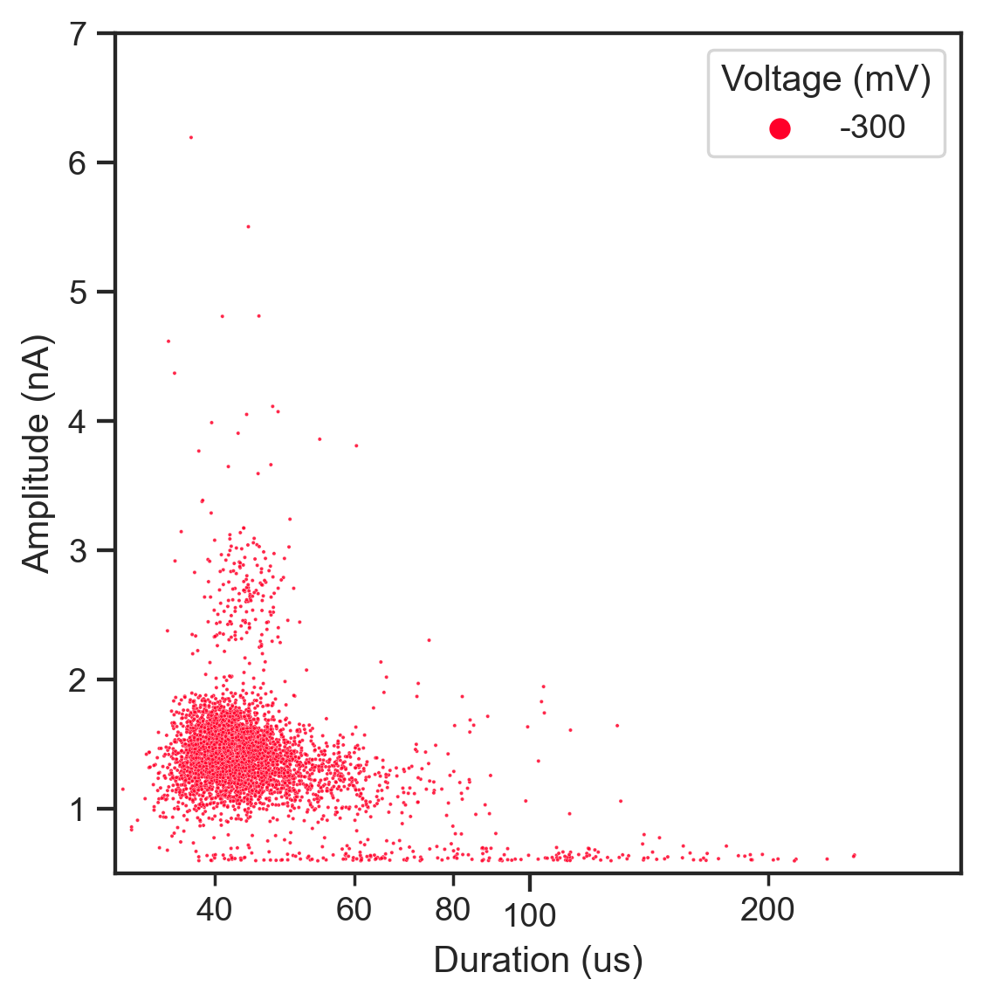

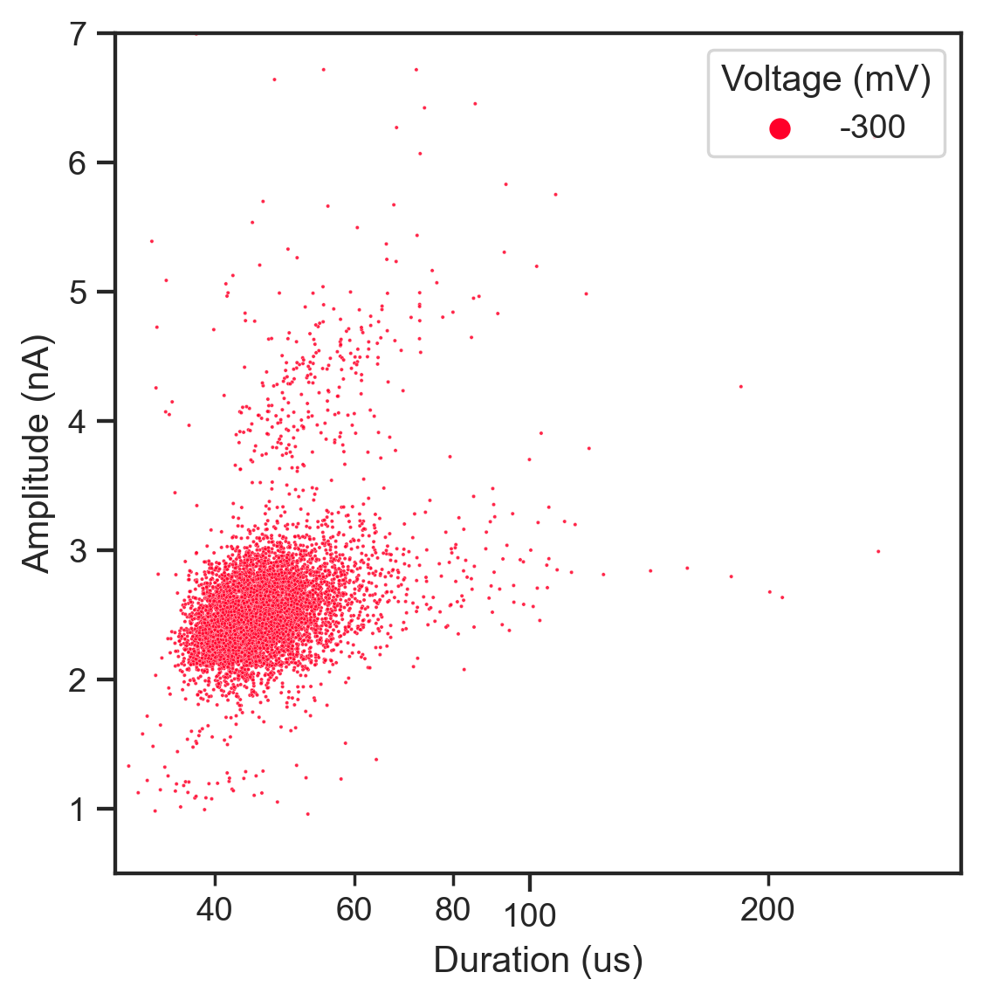

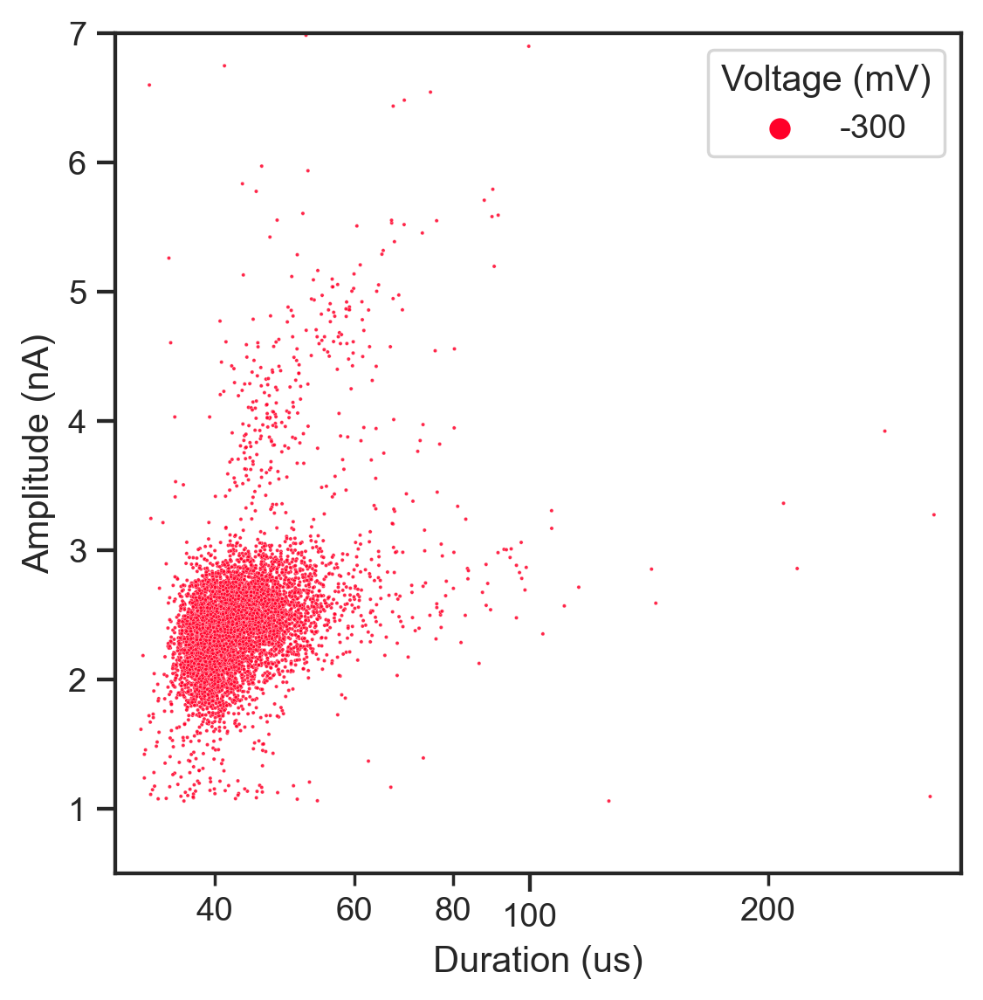

In [18]:
%matplotlib inline
import matplotlib
# selection=[step for step in sfm.traverse_to_rank("vstepgap") if round(step.get_feature("voltage"),1) in [-0.1,-0.2,-0.3,-0.4] and step.duration>1 and step.std<1.2e-9]
# _d={key: [] for key in feature_list+['file']}
# for tf in selection:
#     for event in tf.traverse_to_rank('event'):
#         _d["file"].append(tf.get_feature('metadata')["HeaderFile"])
        
#         for feature in feature_list:
#             _d[feature].append(event.get_feature(feature))

# df=pd.DataFrame(_d)
# df.tail()
_dftemp=df.loc[df['voltage'].round(3).isin(np.array([-0.1,-0.2,-0.3,-0.4],dtype=np.float32))]
# print(df['voltage'].round(3).isin().head(90))
VR=[]
plt.rcParams["axes.labelsize"] = 12
for file,_df in _dftemp.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    sns.set_style("ticks")
    plt.figure(figsize=(5,5),dpi=250)
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Voltage (mV)']=(_df['voltage'].round(3)).astype(str)
    _df['voltage (mV)']=_df['voltage']*1000
    _df['voltage (mV)']=_df['voltage (mV)'].astype(int)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['voltage (mV)'].unique()
    hueorder.sort()
    # hueorder=hueorder[::-1]
    print(hueorder)
    # print(huedf)
    ax=sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='voltage (mV)',hue_order=hueorder,s=1.5,palette='gist_rainbow',alpha=0.85)
    handler, label = ax.get_legend_handles_labels()
    
    ax.legend(handler[::-1],label[::-1],frameon=True,title="Voltage (mV)",loc="upper right",)
    plt.xlabel("Duration (us)")
    plt.xlim(30,350)
    plt.ylim(0.5,7)
    plt.xscale('log')
    # ax.grid()
    ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    
    ax.xaxis.set_minor_formatter(matplotlib.ticker.ScalarFormatter())
    
    locmin = matplotlib.ticker.LogLocator(base=10.0,subs=(0.2,0.4,0.6,0.8),numticks=12)
    ax.xaxis.set_minor_locator(locmin)
    # plt.savefig(f"EDR/scatter_plot_100mV_{file[-20:]}_output.svg",bbox_inches="tight")
    
    # plt.tick_params('both',which="minor")
    # ax.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
    # ax.set_xticks( np.geomspace(30, 300 ,9).round() )
    # plt.legend(loc='upper right')
    # plt.figure

In [62]:
rate_df=pd.DataFrame(VR)

rate_df["pore_id"]=rate_df["file"].apply(lambda x: "".join(x.split('\\')[-2].split('_')[0:2]))
rate_df=rate_df.loc[rate_df['pore_id']!='8e41u20M3']
rate_df["chip_id"]=rate_df["pore_id"].apply(lambda x: x.split("M")[0])
rate_df["Voltage (mV)"] = rate_df["Voltage"].astype(float) *1000
rate_df.tail(20)
# rate_df=rate_df[rate_df["file"] !="c:\\Users\\alito\\EDR\\T101M3_SBSATBead3k1k\\T101M3_SBSATBead3k1k.edh"]

,file,Voltage,rate,pore_id,chip_id,Voltage (mV)
0,C:\Users\alito\OneDrive - Northeastern Univers...,-0.2,32.945741,8e41u19M4,8e41u19,-200.0
1,C:\Users\alito\OneDrive - Northeastern Univers...,-0.25,41.244300,8e41u19M4,8e41u19,-250.0
2,C:\Users\alito\OneDrive - Northeastern Univers...,-0.3,54.419723,8e41u19M4,8e41u19,-300.0
3,C:\Users\alito\OneDrive - Northeastern Univers...,-0.35,67.609113,8e41u19M4,8e41u19,-350.0
4,C:\Users\alito\OneDrive - Northeastern Univers...,-0.4,77.936296,8e41u19M4,8e41u19,-400.0
5,C:\Users\alito\OneDrive - Northeastern Univers...,-0.2,13.006889,8e41u20M1,8e41u20,-200.0
6,C:\Users\alito\OneDrive - Northeastern Univers...,-0.25,15.537574,8e41u20M1,8e41u20,-250.0
7,C:\Users\alito\OneDrive - Northeastern Univers...,-0.3,19.596270,8e41u20M1,8e41u20,-300.0
8,C:\Users\alito\OneDrive - Northeastern Univers...,-0.35,23.217534,8e41u20M1,8e41u20,-350.0
9,C:\Users\alito\OneDrive - Northeastern Univers...,-0.4,22.367988,8e41u20M1,8e41u20,-400.0


In [122]:

df["pore_id"]=df["file"].apply(lambda x: "".join(x.split('\\')[-2].split('_')[0:2]))
df=df.loc[df['pore_id']!='8e41u20M3']
df["chip_id"]=df["pore_id"].apply(lambda x: x.split("M")[0])
df.tail()

,file,Voltage,rate,pore_id,chip_id,Voltage (mV)
18,C:\Users\alito\OneDrive - Northeastern Univers...,-0.2,13.204275,8e41u20M4,8e41u20,-200.0
19,C:\Users\alito\OneDrive - Northeastern Univers...,-0.25,15.092078,8e41u20M4,8e41u20,-250.0
20,C:\Users\alito\OneDrive - Northeastern Univers...,-0.3,21.085408,8e41u20M4,8e41u20,-300.0
21,C:\Users\alito\OneDrive - Northeastern Univers...,-0.35,26.749592,8e41u20M4,8e41u20,-350.0
22,C:\Users\alito\OneDrive - Northeastern Univers...,-0.4,34.410561,8e41u20M4,8e41u20,-400.0


                           rate
chip_id Voltage (mV)           
8e41u19 -400.0        77.936296
        -350.0        67.609113
        -300.0        54.419723
        -250.0        41.244300
        -200.0        32.945741
8e41u20 -400.0        29.498228
        -350.0        25.240006
        -300.0        19.133518
        -250.0        15.526279
        -200.0        12.613934


C:\Users\alito\AppData\Local\Temp\ipykernel_7532\3833749744.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  rate_df_means=rate_df.groupby(["chip_id","Voltage (mV)"]).mean()
C:\Users\alito\AppData\Local\Temp\ipykernel_7532\3833749744.py:18: MatplotlibDeprecationWarning: An artist whose label starts with an underscore was passed to legend(); such artists will no longer be ignored in the future.  To suppress this warning, explicitly filter out such artists, e.g. with `[art for art in artists if not art.get_label().startswith('_')]`.
  plt.legend(legends_list,title="Pore ID",frameon=False)
C:\Users\alito\AppData\Local\Temp\ipykernel_7532\3833749744.py:35: MatplotlibDeprecationWarning: An artist whose label starts with an underscore was passed to legend(); such artists will no longer be ignored in

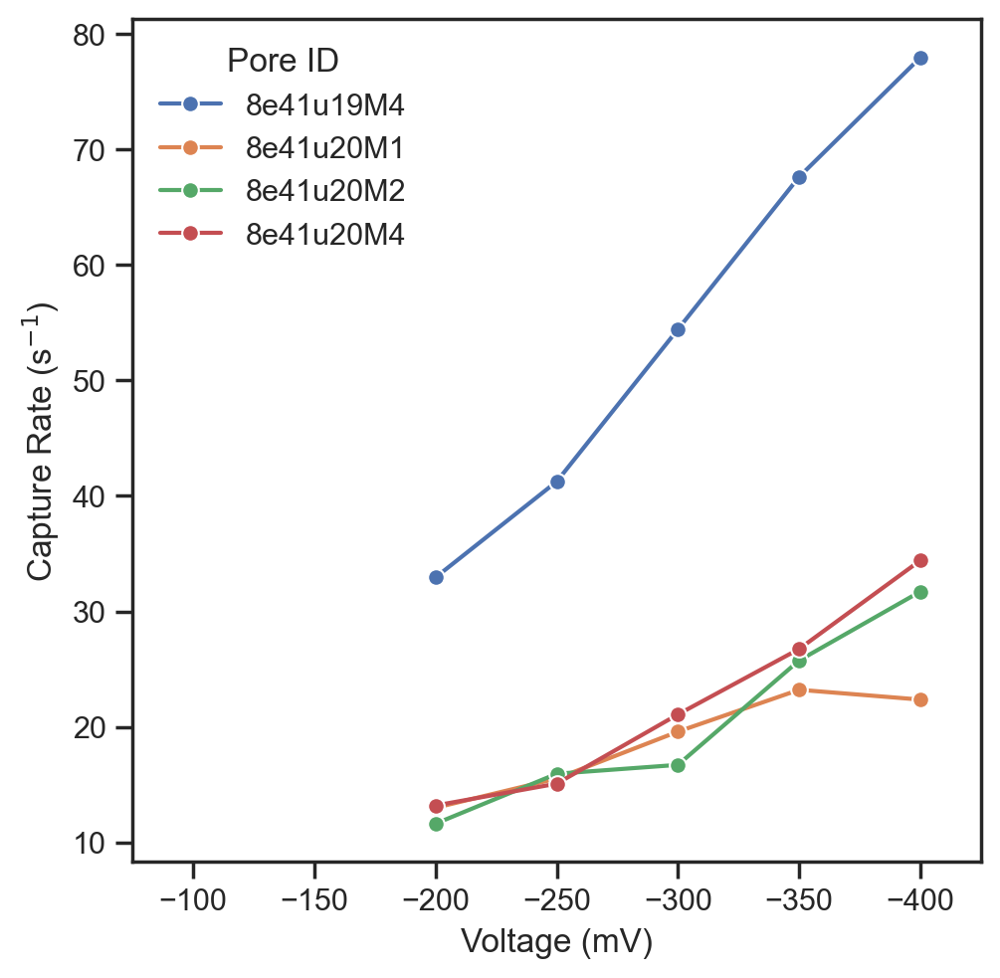

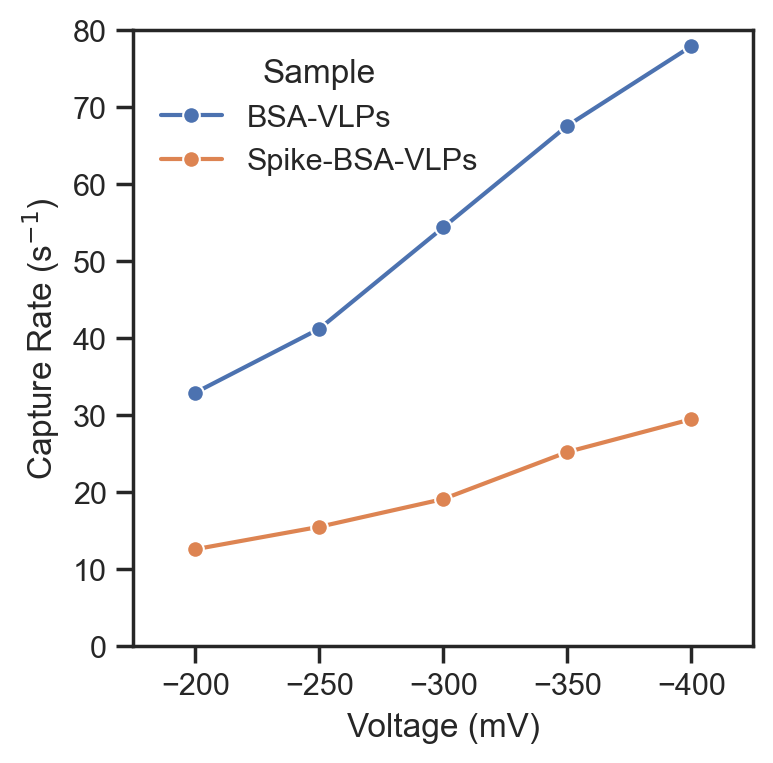

In [63]:
plt.figure(figsize=(5.5,5.5),dpi=200)
sns.set_style("ticks")
rate_df_means=rate_df.groupby(["chip_id","Voltage (mV)"]).mean()
print(rate_df_means.head(20))
sns.lineplot(rate_df,y='rate',x="Voltage (mV)",marker='o',hue="file")#,legend=["Trial1","_Trial1","Trial2","Trial3"])
plt.legend().set_visible(False)
# plt.ylim(0,700)
plt.xlim(-75,-425)
plt.ylabel("Capture Rate (s$^{-1}$)")
plt.xlabel("Voltage (mV)")
legends=["{}".format("".join(pore_id.split('\\')[-2].split('_')[0:2])) for pore_id in rate_df['file'].unique()]
legends_list=[]
for l in legends:
    legends_list.append(l)
    legends_list.append("_")

# print(legend_list)
plt.legend(legends_list,title="Pore ID",frameon=False)

plt.figure(figsize=(4,4),dpi=200)

sns.lineplot(rate_df_means,y='rate',x="Voltage (mV)",marker='o',hue="chip_id")#,legend=["Trial1","_Trial1","Trial2","Trial3"])
plt.legend().set_visible(False)
# plt.ylim(0,700)
plt.xlim(-175,-425)
plt.ylabel("Capture Rate (s$^{-1}$)")
plt.xlabel("Voltage (mV)")
legends=["BSA-VLPs", "Spike-BSA-VLPs"]
legends_list=[]
for l in legends:
    legends_list.append(l)
    legends_list.append("_")
plt.ylim(0,80)
# print(legend_list)
plt.legend(legends_list,title="Sample",frameon=False)
# plt.savefig("EDR\\\T321-324_rate.svg",bbox_inches="tight")

In [32]:
plt.figure(figsize=(5.5,5.5),dpi=350)

concentrations={0.022:17051298508.576563,  
                0.046:51794715279.48159, 
                0.1:106515615564.72127,
                0.22: 170000686790.50345,
                0.46:409346698567.78217,  
                1.0:904218595343.2827}
rate_dff=rate_df.copy()

rate_dff["conc"]=rate_dff["dil"].apply(lambda x:concentrations[x])
print(rate_dff.head())
rate_dff["chip"]=rate_dff["file"].apply(lambda x: x.split("\\")[-1].split("F")[0][:-1])
rate_dff=rate_dff.drop(rate_dff.index[rate_dff["rate"]<0.5])
for file,_df in rate_dff.groupby("chip"):
    sns.lineplot(_df,y='rate',x="conc",marker='o',hue="Voltage (mV)",palette="gist_rainbow")#,legend=["Trial1","_Trial1","Trial2","Trial3"])
    
plt.legend().set_visible(False)
# plt.ylim(0,700)
# plt.xlim(-75,-425)
plt.ylabel("Capture Rate (s$^{-1}$)")
plt.loglog()
plt.xlabel("Concentration (particles / mL)")
legends=["{}".format(voltage) for voltage in rate_df['Voltage (mV)'].unique()][::-1]
legends_list=[]
for l in legends:
    legends_list.append(l)
    legends_list.append("_")
    

print(legends_list)
plt.legend(legends_list,title="Voltage (mV)",frameon=False)

# plt.title("Capture rate ")
plt.savefig("1110_capture_rate.svg")

KeyError: 'dil'

<Figure size 1925x1925 with 0 Axes>

C:\Users\alito\AppData\Local\Temp\ipykernel_49028\1806098036.py:17: UserWarning: The label '_' of <matplotlib.collections.PolyCollection object at 0x0000028401B0FB50> starts with '_'. It is thus excluded from the legend.
  plt.legend(legends_list,title="Pore ID",frameon=False,bbox_to_anchor=(1.1, 1.05))
C:\Users\alito\AppData\Local\Temp\ipykernel_49028\1806098036.py:17: UserWarning: The label '_' of <matplotlib.collections.PolyCollection object at 0x000002840285CD10> starts with '_'. It is thus excluded from the legend.
  plt.legend(legends_list,title="Pore ID",frameon=False,bbox_to_anchor=(1.1, 1.05))
C:\Users\alito\AppData\Local\Temp\ipykernel_49028\1806098036.py:17: UserWarning: The label '_' of <matplotlib.collections.PolyCollection object at 0x000002840285E6D0> starts with '_'. It is thus excluded from the legend.
  plt.legend(legends_list,title="Pore ID",frameon=False,bbox_to_anchor=(1.1, 1.05))
C:\Users\alito\AppData\Local\Temp\ipykernel_49028\1806098036.py:17: UserWarning: The 

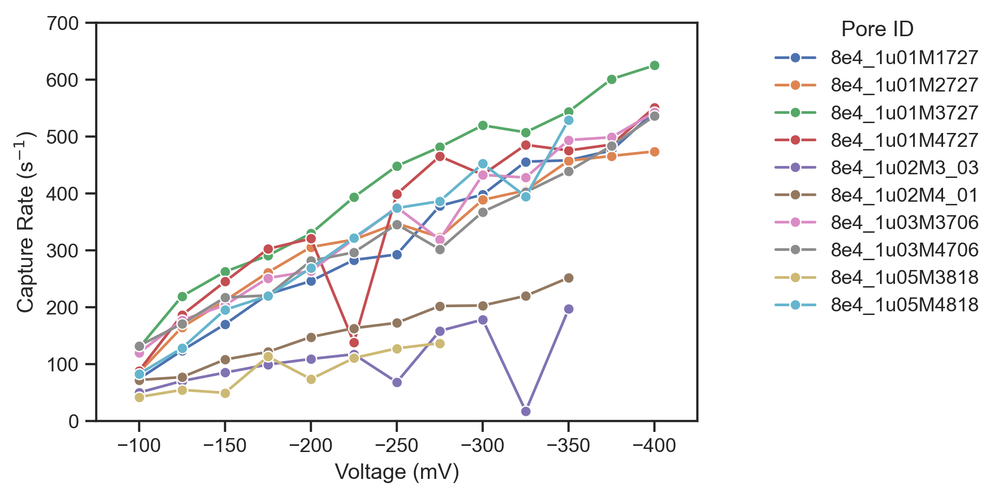

In [84]:
plt.figure(figsize=(6,4),dpi=250)
rate_df=rate_df.drop(rate_df.index[rate_df['file']==r'C:\Users\alito\OneDrive - Northeastern University\Wanunu Lab\ViralNPQ\Data\Wanunu_optical_pc\EDR\8e4_1u02M3_FBSATBead706\8e4_1u02M3_FBSATBead706.edh'])
# gp=rate_df.groupby(['chip_id','Voltage']).mean(level=1)
sns.lineplot(rate_df,y='rate',x="Voltage (mV)",marker='o',hue="file")#,legend=["Trial1","_Trial1","Trial2","Trial3"])
plt.legend().set_visible(False)
plt.ylim(0,700)
plt.xlim(-75,-425)
plt.ylabel("Capture Rate (s$^{-1}$)")
plt.xlabel("Voltage (mV)")
legends=["{}{}".format(pore_id.split('\\')[-1][:10],pore_id.split('\\')[-2][-3:]) for pore_id in rate_df['file'].unique()]
legends_list=[]
for l in legends:
    legends_list.append(l)
    legends_list.append("_")

# print(legend_list)
plt.legend(legends_list,title="Pore ID",frameon=False,bbox_to_anchor=(1.1, 1.05))
# plt.savefig("EDR\\\T321-324_rate.svg",bbox_inches="tight")

In [85]:
def get_id(file):
    return file.split('\\')[-2][:10]
def get_chip(ID):
    return ID.split('M')[0]
rate_df["pore_id"]=rate_df["file"].apply(get_id)
rate_df["chip_id"]=rate_df['pore_id'].apply(get_chip)
rate_df.head()
print(rate_df.loc[rate_df['Voltage (mV)'] == -300.0])
print(rate_df.loc[rate_df['Voltage (mV)'] == -300.0].groupby("chip_id")['rate'].mean())
# print(rate300mV)

                                                  file Voltage        rate  \
8    C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  398.039797   
21   C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  388.751825   
34   C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  519.834769   
47   C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  433.011404   
71   C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  178.317408   
82   C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  203.162225   
93   C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  432.782853   
106  C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  367.820120   
127  C:\Users\alito\OneDrive - Northeastern Univers...    -0.3  452.418387   

     Voltage (mV)     pore_id   chip_id  
8          -300.0  8e4_1u01M1  8e4_1u01  
21         -300.0  8e4_1u01M2  8e4_1u01  
34         -300.0  8e4_1u01M3  8e4_1u01  
47         -300.0  8e4_1u01M4  8e4_1u01  
71       

['-0.05' '-0.075' '-0.1' ... '-0.35' '-0.375' '-0.4']
['-0.05' '-0.075' '-0.1' ... '-0.35' '-0.375' '-0.4']


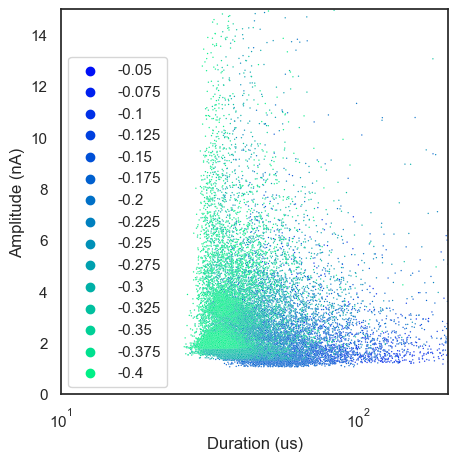

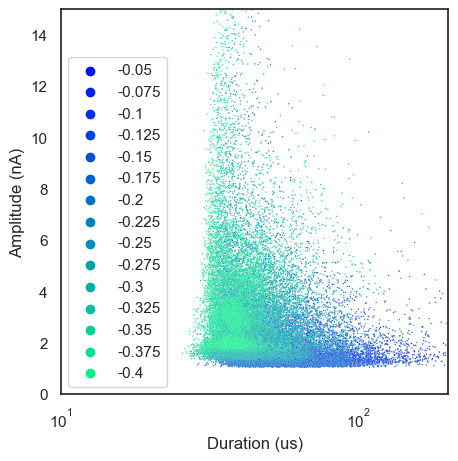

In [ ]:
%matplotlib inline
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (1, 1, 1, 1)})
    plt.figure(figsize=(5,5))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    plt.semilogx()
    plt.xlabel("Duration (us)")
    plt.xlim(10,200)
    plt.ylim(0,15)
    plt.legend(loc='lower left')
    plt.figure
    # plt.figure()
    # sns.histplot(_df,x='dt',hue='voltage')


In [ ]:
%matplotlib inline
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False, palette='winter')
    g.map(sns.kdeplot, "dwell",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1,common_norm=True)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
    g.map(sns.kdeplot, "dwell", clip_on=False, color="w", lw=2, bw_adjust=.5,common_norm=True)
    plt.semilogx()
    g.refline(y=0, linewidth=0.2, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'dwell')
    g.figure.subplots_adjust(hspace=-0.25)
    g.set_titles("")
    g.set(yticks=[], ylabel="")
    g.despine(bottom=True, left=True)
    plt.tight_layout()
    # plt.xlabel("Duration (us)")
    # plt.xlim(10,200)
    # plt.ylim(0,15)
    # plt.legend(loc='lower left')
    # plt.figure

['-0.05' '-0.075' '-0.1' ... '-0.35' '-0.375' '-0.4']


C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, 

['-0.05' '-0.075' '-0.1' ... '-0.35' '-0.375' '-0.4']


C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
C:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, 

ValueError: Image size of 160810x743 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 500x750 with 15 Axes>

ValueError: Image size of 184316x743 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 500x750 with 15 Axes>

['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


<class 'pandas.core.frame.DataFrame'>
Int64Index: 40669 entries, 0 to 41543
Data columns (total 11 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   voltage      40669 non-null  float32
 1   deli         40669 non-null  float64
 2   dwell        40669 non-null  float64
 3   dt           40669 non-null  float64
 4   file         40669 non-null  object 
 5   dil          40669 non-null  object 
 6   frac         40669 non-null  float64
 7   pore_id      40669 non-null  object 
 8   chip_id      40669 non-null  object 
 9   Voltage (V)  40669 non-null  object 
 10  dwell_log    40669 non-null  float64
dtypes: float32(1), float64(5), object(5)
memory usage: 3.6+ MB


Text(0, 0.5, 'Log$_{10}$ dwell time ($\\mu$s)')

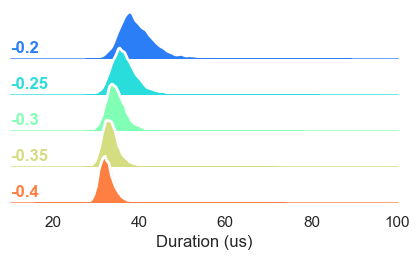

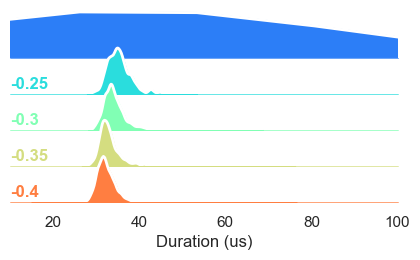

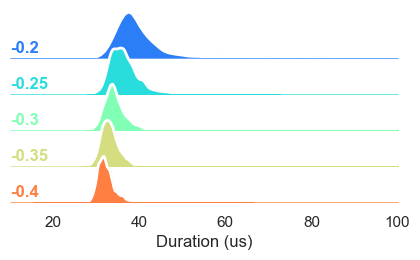

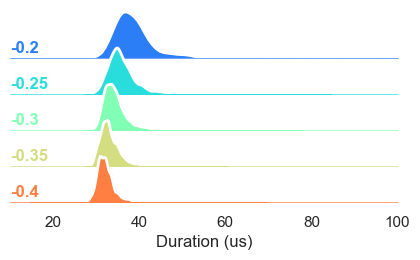

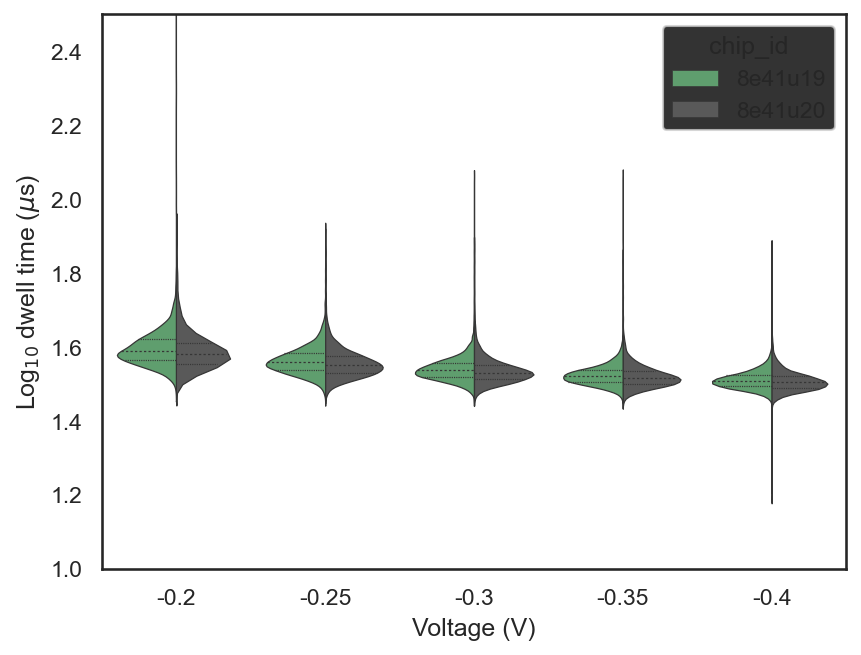

In [153]:
%matplotlib inline
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=(10,100))
    g.map(sns.kdeplot, "dwell",
      bw_adjust=.5, clip_on=True,
      fill=True, alpha=1, linewidth=1,common_norm=True)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
    g.map(sns.kdeplot, "dwell", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0, linewidth=0.5, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'dwell')
    g.figure.subplots_adjust(hspace=-0.25)
    g.set_titles("")
    g.set(yticks=[], ylabel="",xlabel="Duration (us)")
    g.despine(bottom=True, left=True)
# df['chip_id']=df['chip_id'].astype(str)
df.info()
plt.figure(dpi=150)
df['dwell_log']=np.log10(df['dwell'])
sns.violinplot(data=df, x="Voltage (V)", y="dwell_log", hue="chip_id",
               split=True, inner="quart", fill=False, linewidth=0.6,
               palette={"8e41u19": "g", "8e41u20": ".35"})
plt.ylim(1,2.5)
plt.ylabel(r"Log$_{10}$ dwell time ($\mu$s)")
# for voltage,_df in df.groupby('Voltage (V)'):
#     plt.figure(voltage)
#     sns.histplot(_df,row="dwell",hue="chip_id",binwidth=4)
    
    

['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.35']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


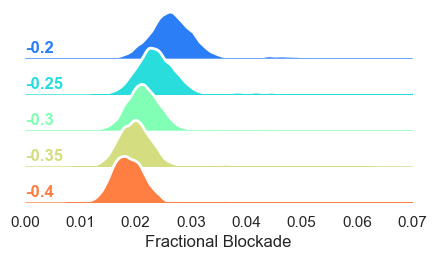

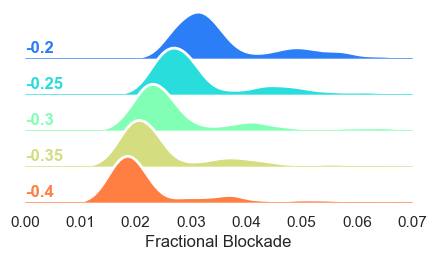

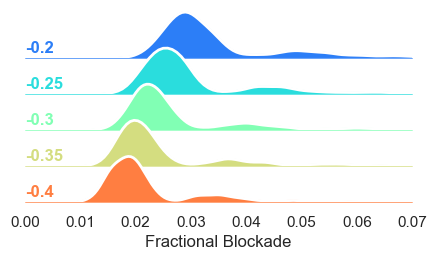

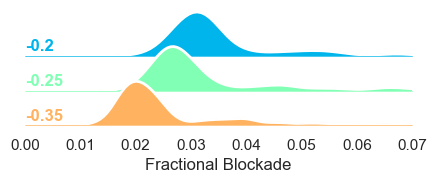

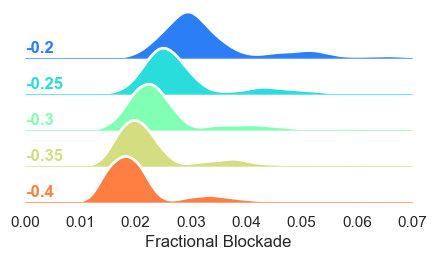

In [65]:
%matplotlib inline
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=(0,0.07))
    g.map(sns.kdeplot, "frac",
      bw_adjust=.5, clip_on=True,
      fill=True, alpha=1, linewidth=1,common_norm=True)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
    g.map(sns.kdeplot, "frac", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0, linewidth=0.5, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'Amplitude (nA)')
    g.figure.subplots_adjust(hspace=-0.25)
    g.set_titles("")
    g.set(yticks=[], ylabel="",xlabel="Fractional Blockade")
    g.despine(bottom=True, left=True)

In [161]:
# from scipy.optimize import curve_fit
def single_gauss(x,A,mean,sigma):
    return A*np.exp(-0.5*(x-mean)**2/sigma**2)
def bimodal_gauss(x,A1,mean1,sigma1,A2,mean2,sigma2):
    return single_gauss(x,A1,mean1,sigma1)+single_gauss(x,A2,mean2,sigma2)
def trimodal_gauss(x,A1,mean1,sigma1,A2,mean2,sigma2,A3,mean3,sigma3):
    return single_gauss(x,A1,mean1,sigma1)+single_gauss(x,A2,mean2,sigma2)+single_gauss(x,A3,mean3,sigma3)

def bimodal_fit(arr,binwidth,binrange):
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    me1=np.mean(arr)
    me2=me1*1.6
    me2low=me1*1.4
    me2high=me1*2.3
    sigma1low=np.std(arr)*0.2
    sigma1high=np.std(arr)*1.1
    sigma2low=np.std(arr)*0.2
    sigma2high=np.std(arr)*5
    
    y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=True)
    y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
      
    popt, pcov = curve_fit(bimodal_gauss, x_vals, y_vals,bounds=([0,me1*0.5,sigma1low,0,me2low,sigma2low],[1,1.3*me1,sigma1high,0.5,me2high,sigma2high]))

    return popt

def trimodal_fit(arr,binwidth,binrange):
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    me1=np.mean(arr)
    me2=me1*1.6
    me2low=me1*1.4
    me2high=me1*2.3
    sigma1low=np.std(arr)*0.2
    sigma1high=np.std(arr)*1.1
    sigma2low=np.std(arr)*0.2
    sigma2high=np.std(arr)*1
    me3low=me1*1.9
    me3high=me1*4.5
    sigma3low=np.std(arr)*0.2
    sigma3high=0.01
    
    y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=True)
    y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
      
    popt, pcov = curve_fit(trimodal_gauss, x_vals, y_vals,bounds=([0,me1*0.5,sigma1low,0,me2low,sigma2low,0,me3low,sigma3low],[1,1.3*me1,sigma1high,0.5,me2high,sigma2high,0.5,me3high,sigma3high]))

    return popt

In [128]:
df.head()

,voltage,deli,dwell,dt,file,dil,frac,pore_id,chip_id,Voltage (V)
0,-0.2,1.642356e-09,41.664390,0.000000,C:\Users\alito\OneDrive - Northeastern Univers...,0.1,0.022547,8e41u19M4,8e41u19,-0.2
1,-0.2,2.168598e-09,35.641219,0.064650,C:\Users\alito\OneDrive - Northeastern Univers...,0.1,0.029772,8e41u19M4,8e41u19,-0.2
2,-0.2,2.017757e-09,38.598565,0.007485,C:\Users\alito\OneDrive - Northeastern Univers...,0.1,0.027701,8e41u19M4,8e41u19,-0.2
3,-0.2,2.175597e-09,36.247590,0.024465,C:\Users\alito\OneDrive - Northeastern Univers...,0.1,0.029868,8e41u19M4,8e41u19,-0.2
4,-0.2,1.792273e-09,32.573542,0.009870,C:\Users\alito\OneDrive - Northeastern Univers...,0.1,0.024605,8e41u19M4,8e41u19,-0.2


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


   voltage          deli      dwell        dt  \
0     -0.2  1.642356e-09  41.664390  0.000000   
1     -0.2  2.168598e-09  35.641219  0.064650   
2     -0.2  2.017757e-09  38.598565  0.007485   
3     -0.2  2.175597e-09  36.247590  0.024465   
4     -0.2  1.792273e-09  32.573542  0.009870   

                                                file  dil      frac  \
0  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.022547   
1  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.029772   
2  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.027701   
3  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.029868   
4  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.024605   

     pore_id  chip_id Voltage (V)  dwell_log  
0  8e41u19M4  8e41u19        -0.2   1.619765  
1  8e41u19M4  8e41u19        -0.2   1.551953  
2  8e41u19M4  8e41u19        -0.2   1.586571  
3  8e41u19M4  8e41u19        -0.2   1.559279  
4  8e41u19M4  8e41u19        -0.2   1.51286

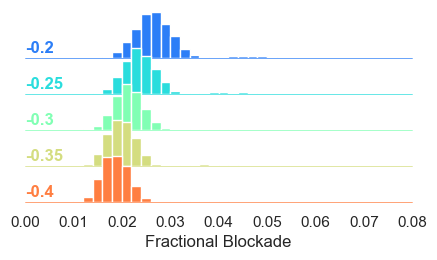

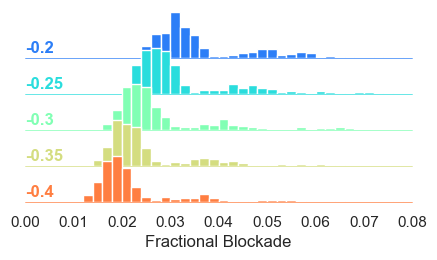

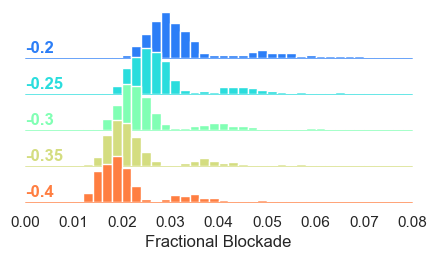

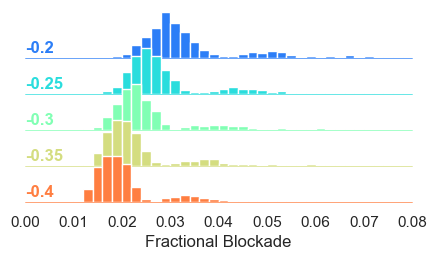

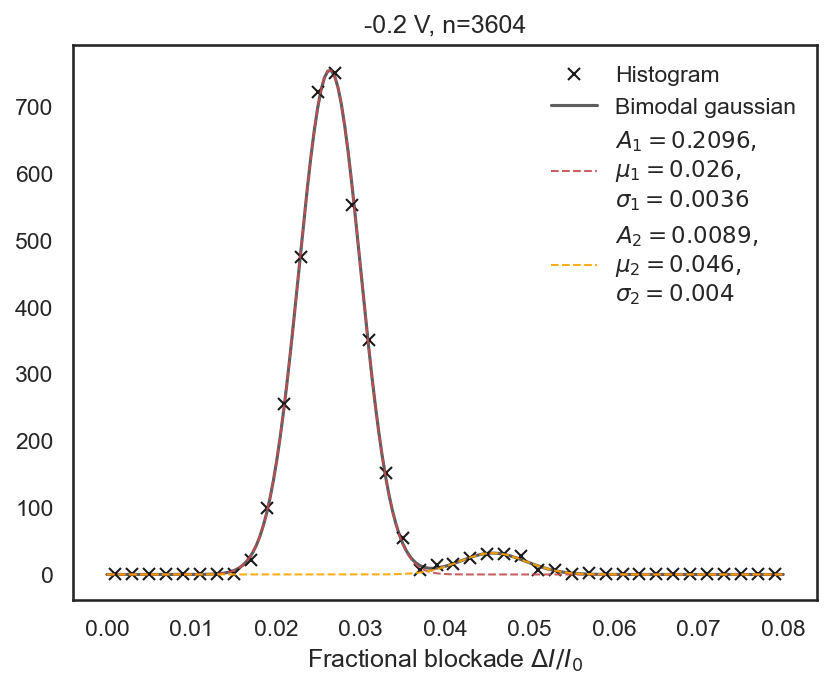

...

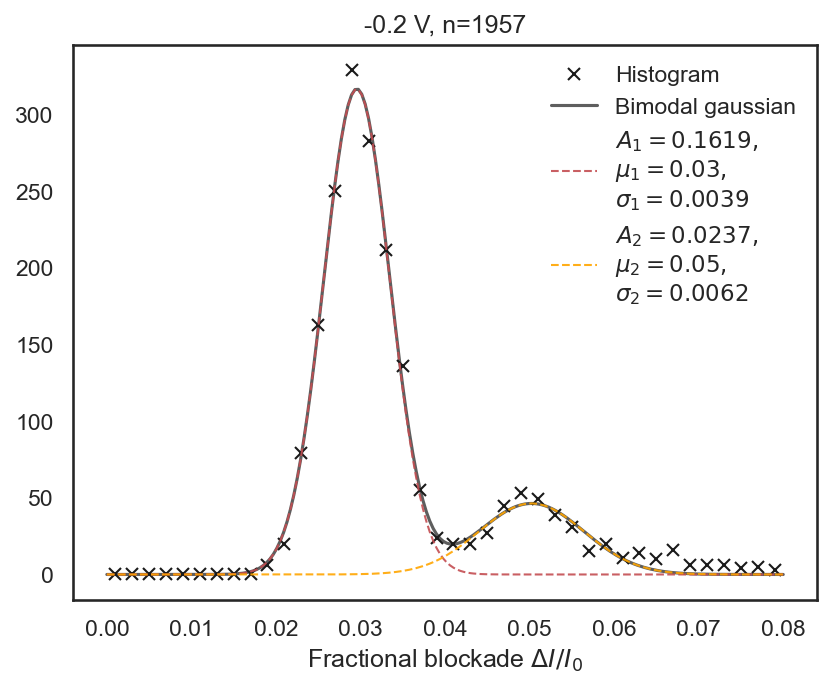

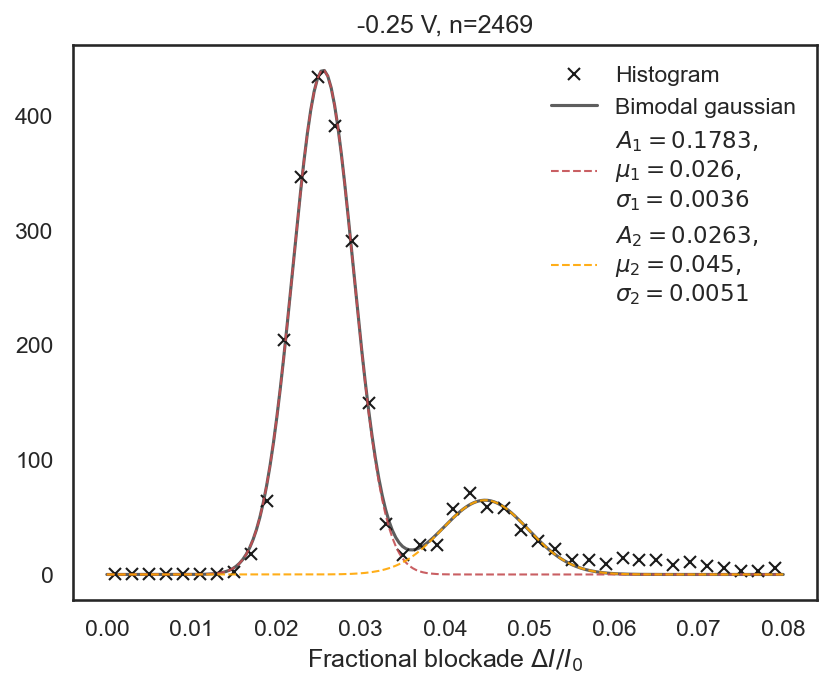

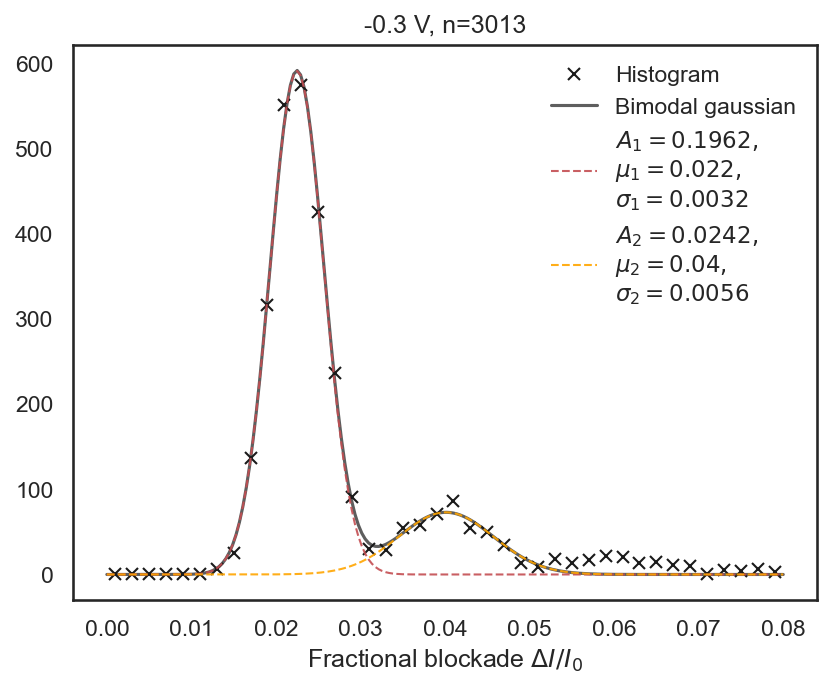

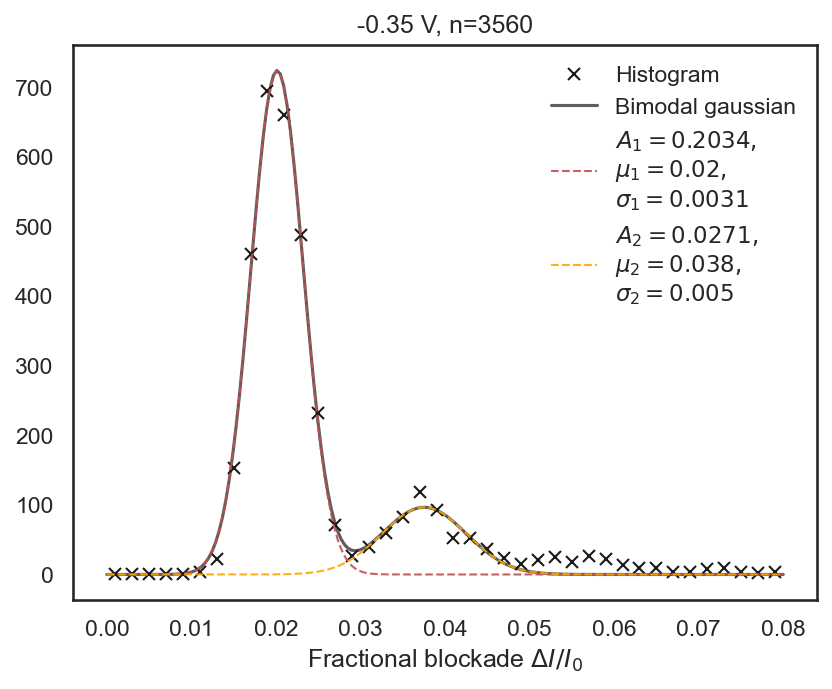

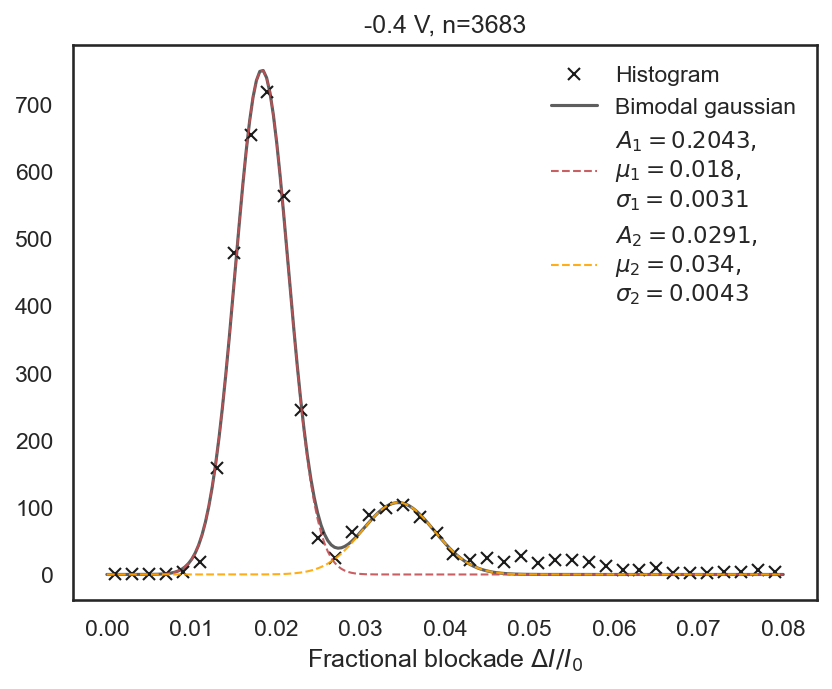

In [155]:
# %matplotlib inline
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    binrange=[0,0.08]
    binwidth=0.002
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=binrange)
    g.map(sns.histplot, "frac",
      binwidth=binwidth,binrange=binrange, clip_on=True,
      fill=True, alpha=1, linewidth=1,common_norm=True)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
    # g.map(sns.histplot, "frac", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0, linewidth=0.5, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'Amplitude (nA)')
    g.figure.subplots_adjust(hspace=-0.25)
    g.set_titles("")
    g.set(yticks=[], ylabel="",xlabel="Fractional Blockade")
    g.despine(bottom=True, left=True)
print(df.head())
for [chip_id,voltage],_dff in df.groupby(["chip_id","Voltage (V)"]):   
     
    popt=bimodal_fit(_dff["frac"].values,binwidth=binwidth,binrange=binrange)
    y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=False)
    # y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
    plt.figure(dpi=150)
    ns=int(np.sum(y_vals))
    plt.plot(x_vals,y_vals,'kx',label="Histogram")
    
    xfine=np.linspace(binrange[0],binrange[1],200)
    plt.plot(xfine,ns*bimodal_gauss(xfine,*popt),lw=1.5,alpha=0.7,c='k',label="Bimodal gaussian")
    plt.plot(xfine,ns*single_gauss(xfine,*popt[:3]),'r--',alpha=0.9,lw=1,label=f"$A_1={popt[0]:.4f},$\n$ \mu_1 = {popt[1]:.2g},$\n$ \sigma_1 = {popt[2]:.2g}$")
    
    
    plt.plot(xfine,ns*single_gauss(xfine,*popt[3:]),'--',c='orange',alpha=0.9,lw=1,label=f"$A_2={popt[3]:.4f},$\n$ \mu_2 = {popt[4]:.2g},$\n$ \sigma_2 = {popt[5]:.2g}$")
    
    plt.title(f"{voltage} V, n={ns}")
    plt.xlabel("Fractional blockade $\Delta I/I_0$")
    plt.legend(frameon=False,facecolor="w")
    # print(len(hist_result),len(x_vals))
  

['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


['-0.2' '-0.25' '-0.3' '-0.35' '-0.4']


c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
c:\Users\alito\.conda\envs\pydev311\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)


   voltage          deli      dwell        dt  \
0     -0.2  1.642356e-09  41.664390  0.000000   
1     -0.2  2.168598e-09  35.641219  0.064650   
2     -0.2  2.017757e-09  38.598565  0.007485   
3     -0.2  2.175597e-09  36.247590  0.024465   
4     -0.2  1.792273e-09  32.573542  0.009870   

                                                file  dil      frac  \
0  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.022547   
1  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.029772   
2  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.027701   
3  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.029868   
4  C:\Users\alito\OneDrive - Northeastern Univers...  0.1  0.024605   

     pore_id  chip_id Voltage (V)  dwell_log  
0  8e41u19M4  8e41u19        -0.2   1.619765  
1  8e41u19M4  8e41u19        -0.2   1.551953  
2  8e41u19M4  8e41u19        -0.2   1.586571  
3  8e41u19M4  8e41u19        -0.2   1.559279  
4  8e41u19M4  8e41u19        -0.2   1.51286

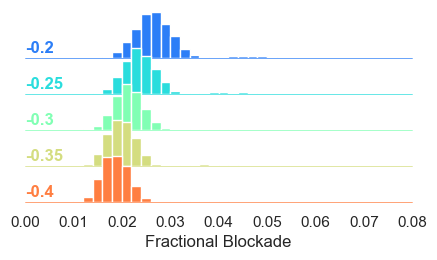

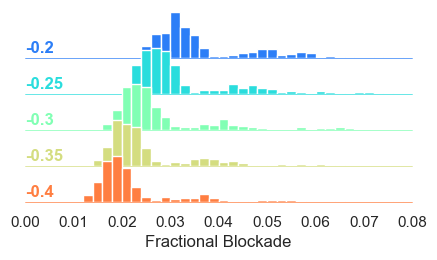

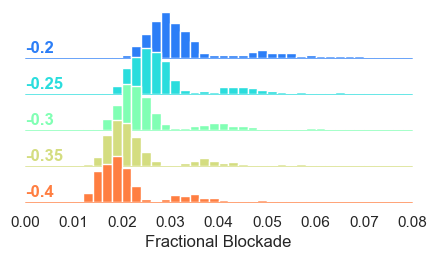

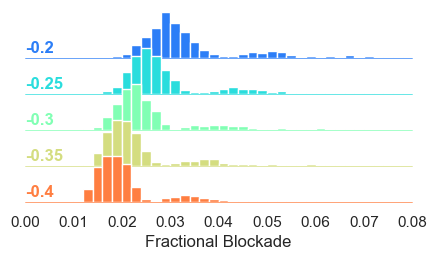

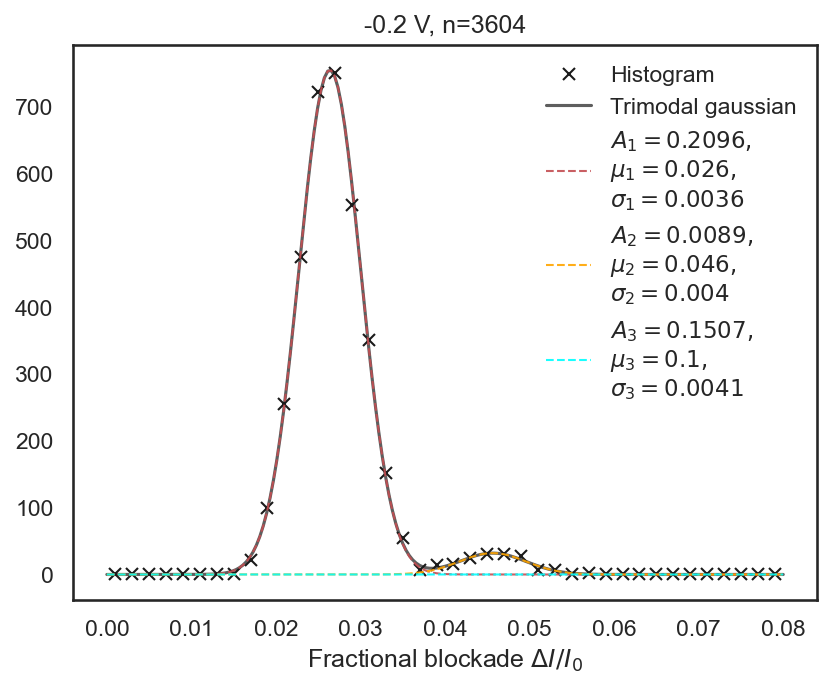

...

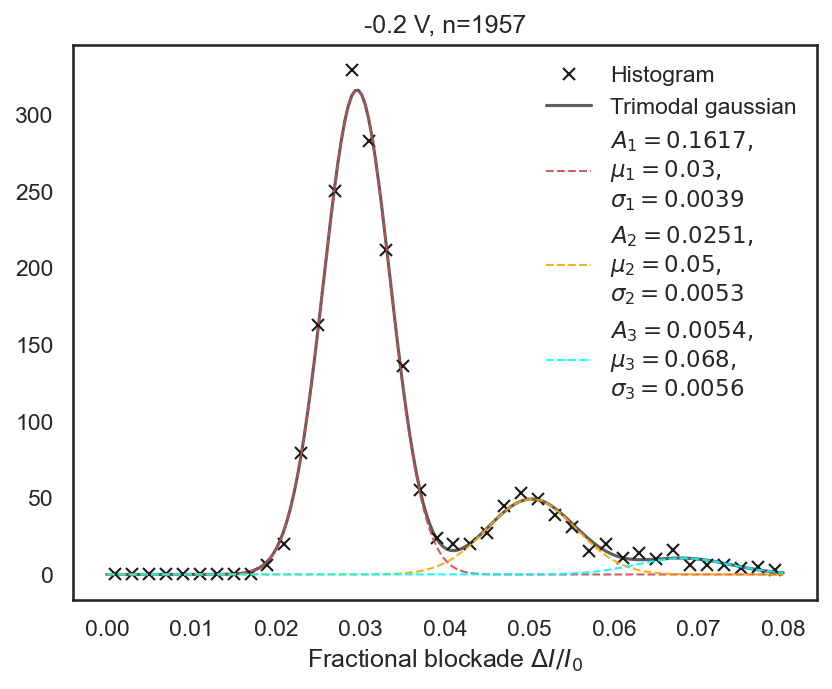

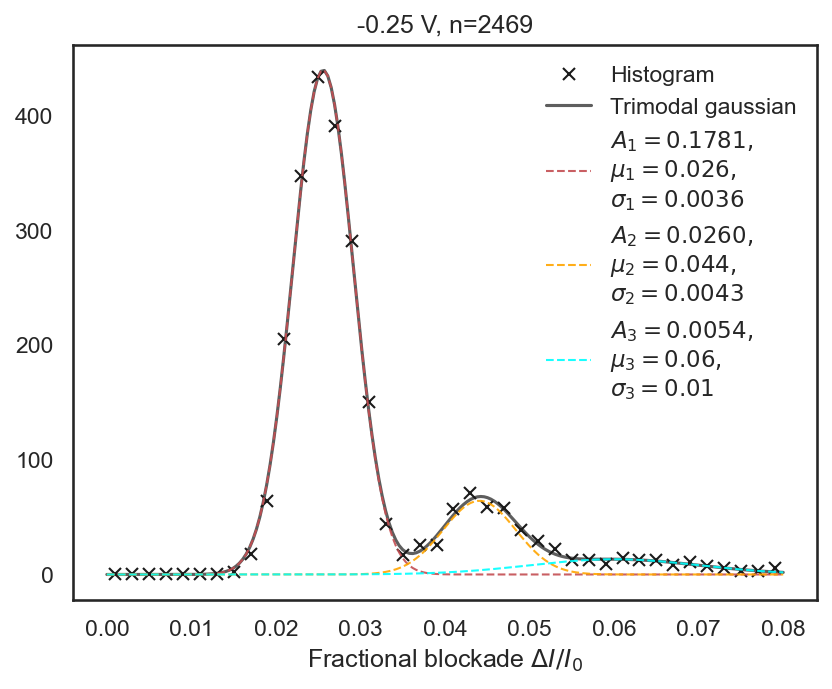

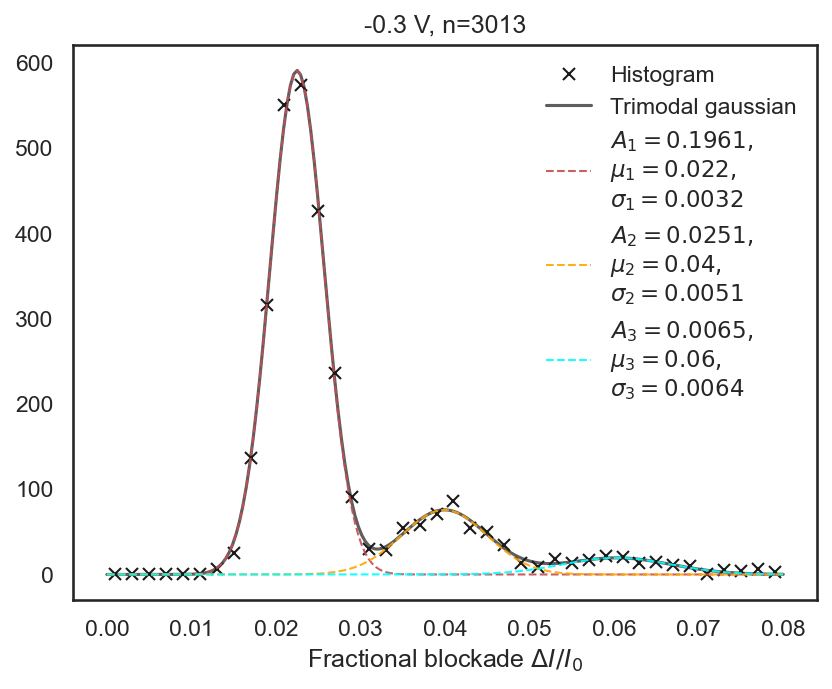

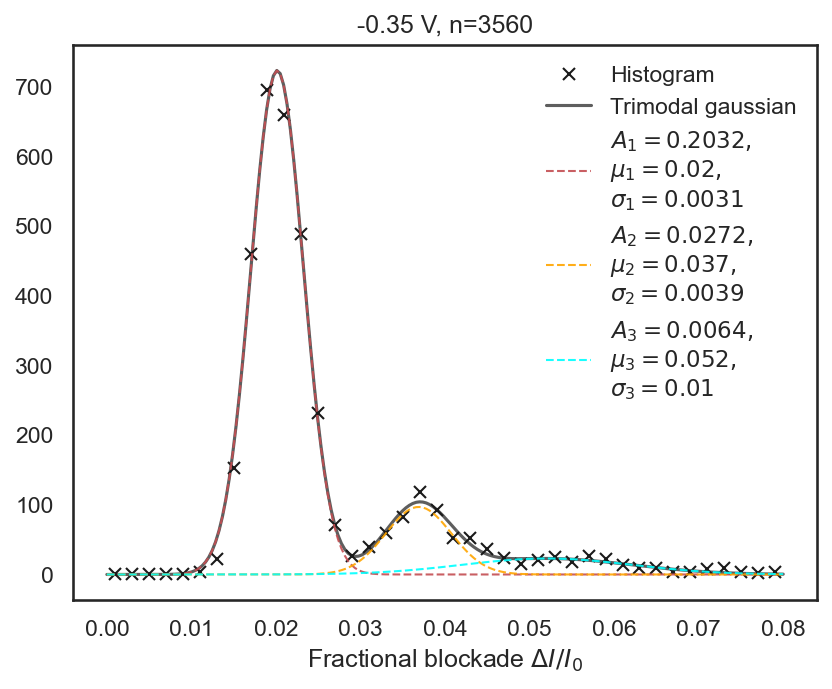

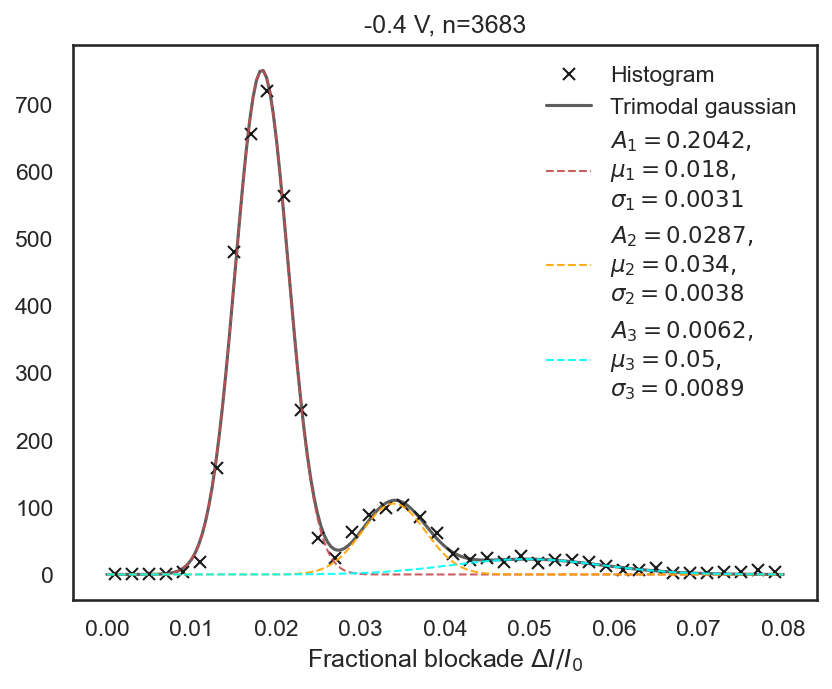

In [162]:
# %matplotlib inline
for file,_df in df.groupby('file'):
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    # plt.figure(figsize=(5,5))
    _df['Voltage (V)']=(_df['voltage'].round(3)).astype(str)
    _df['Amplitude (nA)']=1e9*_df["deli"]
    hueorder=_df['Voltage (V)'].unique()
    hueorder.sort()
    print(hueorder)
    binrange=[0,0.08]
    binwidth=0.002
    bin_count=int((binrange[1]-binrange[0])/binwidth)
    # print(huedf)
    g = sns.FacetGrid(_df, row="Voltage (V)",row_order=hueorder, hue="Voltage (V)", hue_order=hueorder, aspect=10, height=.5,sharey=False,sharex=True, palette='rainbow',xlim=binrange)
    g.map(sns.histplot, "frac",
      binwidth=binwidth,binrange=binrange, clip_on=True,
      fill=True, alpha=1, linewidth=1,common_norm=True)
    # sns.scatterplot(_df,x='dwell',y='Amplitude (nA)',hue='Voltage (V)',hue_order=hueorder,s=1,palette='winter')
    
    # g.map(sns.histplot, "frac", clip_on=True, color="w", lw=2, bw_adjust=.5,common_norm=True)
    # plt.semilogy()
    g.refline(y=0, linewidth=0.5, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)
    g.map(label,'Amplitude (nA)')
    g.figure.subplots_adjust(hspace=-0.25)
    g.set_titles("")
    g.set(yticks=[], ylabel="",xlabel="Fractional Blockade")
    g.despine(bottom=True, left=True)
print(df.head())
for [chip_id,voltage],_dff in df.groupby(["chip_id","Voltage (V)"]):   
     
    popt=trimodal_fit(_dff["frac"].values,binwidth=binwidth,binrange=binrange)
    y_vals, bin_edges=np.histogram(_dff["frac"].values,bins=bin_count,range=binrange,density=False)
    # y_vals/=np.sum(y_vals)
    x_vals=bin_edges[:-1]+(binwidth/2)
    plt.figure(dpi=150)
    ns=int(np.sum(y_vals))
    plt.plot(x_vals,y_vals,'kx',label="Histogram")
    
    xfine=np.linspace(binrange[0],binrange[1],200)
    plt.plot(xfine,ns*trimodal_gauss(xfine,*popt),lw=1.5,alpha=0.7,c='k',label="Trimodal gaussian")
    plt.plot(xfine,ns*single_gauss(xfine,*popt[:3]),'r--',alpha=0.9,lw=1,label=f"$A_1={popt[0]:.4f},$\n$ \mu_1 = {popt[1]:.2g},$\n$ \sigma_1 = {popt[2]:.2g}$")
    
    
    plt.plot(xfine,ns*single_gauss(xfine,*popt[3:6]),'--',c='orange',alpha=0.9,lw=1,label=f"$A_2={popt[3]:.4f},$\n$ \mu_2 = {popt[4]:.2g},$\n$ \sigma_2 = {popt[5]:.2g}$")
    
    plt.plot(xfine,ns*single_gauss(xfine,*popt[6:]),'--',c='cyan',alpha=0.9,lw=1,label=f"$A_3={popt[6]:.4f},$\n$ \mu_3 = {popt[7]:.2g},$\n$ \sigma_3 = {popt[8]:.2g}$")
    
    plt.title(f"{voltage} V, n={ns}")
    plt.xlabel("Fractional blockade $\Delta I/I_0$")
    plt.legend(frameon=False,facecolor="w")
    # print(len(hist_result),len(x_vals))
  

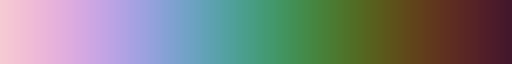

In [ ]:
%matplotlib qt
sns.cubehelix_palette(as_cmap=True,rot=1.5,gamma=1,hue=1)

In [ ]:



def plot(tracefile):
    plt.figure(figsize=[10,5],dpi=250)
    plt.plot(tracefile.t[::file_ds],1e9*tracefile.current[::file_ds],lw=0.3,c='k')
    for child in tracefile.traverse_to_rank("vstepgap"):
        plt.plot(child.t[::ds],1e9*child.current[::ds],lw=0.3)
        plt.xlabel("Time (s)")
        plt.ylabel("Current (nA)")
        plt.title(tracefile.metadata["HeaderFile"])
ds=10
file_ds=50
def plot_stds(tracefile):
    plt.figure(figsize=[10,5],dpi=250)
    for child in tracefile.children:
        plt.plot(child.t,np.ones(len(child.t))*child.std)

for tf in experiment:
    
    plot(tf)
    print(tf.metadata)
    # plot_stds(tf)
    # gc.collect(0)





{'EDH Version': '2.0', 'Channels': '1', 'Range': 2e-07, 'Sampling frequency (SR)': 200000.0, 'Final Bandwidth': 100000.0, 'Oversampling x4': 'disabled', 'Acquisition start time': '05/01/2023 21:10:43.679\n', 'Active channels': '1', 'DataFiles': ['R505M1_FSBSATBead_CH001_000.abf', 'R505M1_FSBSATBead_CH001_001.abf'], 'StorageFormat': '.abf', 'HeaderFile': 'c:\\Users\\alito\\EDR\\R505M1_FSBSATBead\\R505M1_FSBSATBead.edh'}
{'EDH Version': '2.0', 'Channels': '1', 'Range': 2e-07, 'Sampling frequency (SR)': 200000.0, 'Final Bandwidth': 100000.0, 'Oversampling x4': 'disabled', 'Acquisition start time': '05/01/2023 21:26:25.707\n', 'Active channels': '1', 'DataFiles': ['R505M2_FSBSATBead_CH001_000.abf', 'R505M2_FSBSATBead_CH001_001.abf', 'R505M2_FSBSATBead_CH001_002.abf'], 'StorageFormat': '.abf', 'HeaderFile': 'c:\\Users\\alito\\EDR\\R505M2_FSBSATBead\\R505M2_FSBSATBead.edh'}
{'EDH Version': '2.0', 'Channels': '1', 'Range': 2e-07, 'Sampling frequency (SR)': 200000.0, 'Final Bandwidth': 100000.

In [ ]:
def parse_spike(tracefile,rank="vstepgap"):
    for step in tracefile.traverse_to_rank(rank):
        a=signal.find_peaks(

['A', array([1, 2, 3]), 'C', 'D', 'E']

In [ ]:
["A",np.array([1,2,3]),"C"]+["D","E"]

['A', array([1, 2, 3]), 'C', 'D', 'E']

In [ ]:
# import numpy as np

# def test_split_by_voltage():
#     # Test case with a single voltage level
#     current = np.array([1, 2, 3, 4, 5])
#     voltage = np.array([1, 1, 1, 1, 1])
#     expected_splits = [current]
#     assert np.allclose(split_by_voltage(current, voltage), expected_splits)
    
#     # Test case with two voltage levels
#     current = np.array([1, 2, 1, 2, 1, 6, 5, 5, 5])
#     voltage = np.array([1, 1, 1, 1, 2, 2, 2, 2, 2])
#     expected_splits = [current[:5], current[5:]]
#     assert np.allclose(split_by_voltage(current, voltage), expected_splits)
    
#     # Test case with three voltage levels
#     current = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12])
#     voltage = np.array([1, 1, 1, 2, 2, 2, 3, 3, 3, 3, 3, 3])
#     expected_splits = [current[:3], current[3:6], current[6:]]
#     assert np.allclose(split_by_voltage(current, voltage), expected_splits)
    
#     # Test case with empty current array
#     current = np.array([])
#     voltage = np.array([1, 1, 1, 1, 1])
#     expected_splits = []
#     assert np.allclose(split_by_voltage(current, voltage), expected_splits)
    
#     # Test case with empty voltage array
#     current = np.array([1, 2, 3, 4, 5])
#     voltage = np.array([])
#     expected_splits = []
#     assert np.allclose(split_by_voltage(current, voltage), expected_splits)
    
#     # Test case with different lengths of current and voltage arrays
#     current = np.array([1, 2, 3, 4, 5])
#     voltage = np.array([1, 1, 1, 1])
#     try:
#         split_by_voltage(current, voltage)
#     except ValueError as e:
#         assert str(e) == "current and voltage must have the same length"

In [ ]:
def find_optimal_sample_removal(signal):
    # Calculate the standard deviation of the signal
    std = np.std(signal)
    
    # Set the threshold to be 3 times the standard deviation
    threshold = 3 * std
    
    # Initialize a counter to keep track of the number of samples above the threshold
    n_samples = 0
    
    # Iterate over the signal and count the number of samples above the threshold
    for sample in signal:
        if sample > threshold:
            n_samples += 1
        else:
            break
    
    return n_samples

In [ ]:
test_split_by_voltage()

TypeError: ufunc 'isfinite' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

In [ ]:
a=np.arange(10000000)

In [ ]:
# %%timeit
# idx=np.r_[[np.s_[i:i+10] for i in range(0,1000000,1)]]
# print(idx)
# a[idx]
# print(idx)
# a=np.s_[2::2]

# print(a.indices())
# print(a.start)
# print(a.stop)

[slice(0, 10, None) slice(1, 11, None) slice(2, 12, None) ...
 slice(999997, 1000007, None) slice(999998, 1000008, None)
 slice(999999, 1000009, None)]


IndexError: arrays used as indices must be of integer (or boolean) type

In [ ]:
voltage=np.array([1,1,1,2.,2.,2.,2.,3.,3.])
split_indices = np.where(voltage[:-1] != voltage[1:])[0] + 1
print(split_indices)

[3 7]


In [ ]:
%%timeit
# from PythIon.utils import *

voltage=np.array([1,1,1,2.,2.,2.,2.,3.,3.]*2000)
# si,ei=split_voltage_steps(voltage)
# print(si,ei)
i=split_voltage_steps(voltage,as_tuples=True)
# print(i)
# print(voltage)

    # print(voltage[sl])

2.13 ms ± 37.1 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [ ]:
np.s_[::]

slice(None, None, None)

In [ ]:
# np.s_[1:2]
np.s_[0:0]
# np.arange(10)[0:np.pi]

slice(0, 0, None)

In [ ]:
a=[2,3]
b=[1,[2,4]]
b.append(a)
a[1]=5
b

[1, [2, 4], [2, 5]]

In [ ]:
import i

In [ ]:
1/2*(1,2)


TypeError: can't multiply sequence by non-int of type 'float'

In [34]:
(glob.glob(r'C:\Users\alito\Desktop\high_current_data\*Bead*.txt')[0])

array([4.6407e+021, 1.6744e+243, 7.1001e-154, ..., 5.1563e-062,
       2.3157e-052, 1.0329e-047])